In [22]:
import os
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
import os
import torch
from PIL import Image
import cv2
import mediapipe as mp
import numpy as np

mp_drawing = mp.solutions.drawing_utils
mp_drawing_styles = mp.solutions.drawing_styles
mp_pose = mp.solutions.pose

model = None


def initialize_model():
    global model
    model =  mp_pose.Pose(
    static_image_mode=True, min_detection_confidence=0.5, model_complexity=2)


def inference(images, conf_threshold=0.5):
    """
    Perform inference on a batch of images using MediaPipe Pose to detect keypoints.

    Args:
        images (list): List of PIL.Image images.

    Returns:
        list: A list of keypoints for each image. Each element is a list of tuples (x, y, z, visibility).
              The order of keypoints matches the order of the input image list.
    """
    global model
    keypoints_list = []  # To store the keypoints for each image in the same order.

    for idx, image in enumerate(images):
        # Convert PIL.Image to numpy array and then to RGB for MediaPipe processing.
        image_np = np.array(image)
        image_rgb = cv2.cvtColor(image_np, cv2.COLOR_BGR2RGB)

        # Process the image with MediaPipe Pose.
        results = model.process(image_rgb)

#         if results.pose_landmarks:
#             # Extract keypoints as (x, y, z, visibility).
#             keypoints = [
#                 (landmark.x, landmark.y, landmark.z, landmark.visibility)
#                 for landmark in results.pose_landmarks.landmark
#             ]
#             print('keypoints:', np.shape(keypoints))
#         else:
#             keypoints = []  # Empty list if no landmarks are detected.

#         # Append keypoints to maintain order with images
#         keypoints_list.append(keypoints)
        
        if results.pose_landmarks:
            keypoints = []
            for landmark in results.pose_landmarks.landmark:
                x = landmark.x if landmark.visibility > conf_threshold else np.nan
                y = landmark.y if landmark.visibility > conf_threshold else np.nan
                z = landmark.z if landmark.visibility > conf_threshold else np.nan

                keypoints.append([x, y,z])

            keypoints_list.append(keypoints)
        else:
            # Append an empty list if no keypoints are detected
            keypoints_list.append(np.full((33, 3), np.nan))

    return keypoints_list




def readImages(interval, localStoragePath, userId):
  pass

def postureDetect(interval=60):
  """
    Posture detection pipeline. This function reads images from the local storage, performs inference on them, and sends the results to the server.

    Args:
    - interval (int): Interval in seconds to read images from the local storage.

    """
  results = inference(images)
  return results




In [134]:
data_path = "../../AI System Data/Lean Forward/frames"
image_files = [f for f in os.listdir(data_path) if os.path.isfile(os.path.join(data_path, f))]
batch_size = 20
counter = 0
initialize_model()
keypoints_list = []  # To store the keypoints for each image in the same order.
conf_threshold=0.5
images = [Image.open(os.path.join(data_path, image_file)) for image_file in image_files[0:batch_size]]
for idx, image in enumerate(images):
    # Convert PIL.Image to numpy array and then to RGB for MediaPipe processing.
    image_np = np.array(image)
    image_rgb = cv2.cvtColor(image_np, cv2.COLOR_BGR2RGB)

    # Process the image with MediaPipe Pose.
    results = model.process(image_rgb)

#         if results.pose_landmarks:
#             # Extract keypoints as (x, y, z, visibility).
#             keypoints = [
#                 (landmark.x, landmark.y, landmark.z, landmark.visibility)
#                 for landmark in results.pose_landmarks.landmark
#             ]
#             print('keypoints:', np.shape(keypoints))
#         else:
#             keypoints = []  # Empty list if no landmarks are detected.

#         # Append keypoints to maintain order with images
#         keypoints_list.append(keypoints)

    if results.pose_world_landmarks:
        keypoints = []
        for landmark in results.pose_world_landmarks.landmark:
            x = landmark.x if landmark.visibility > conf_threshold else np.nan
            y = landmark.y if landmark.visibility > conf_threshold else np.nan
            z = landmark.z if landmark.visibility > conf_threshold else np.nan

            keypoints.append([x, y,z])

        keypoints_list.append(keypoints)
    else:
        # Append an empty list if no keypoints are detected
        keypoints_list.append(np.full((33, 3), np.nan))

In [133]:
keypoints_list1  = keypoints_list

In [87]:
keypoints_list = np.array(keypoints_list)

In [18]:
keypoints_list = np.array(keypoints_list)

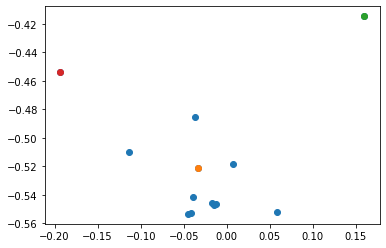

In [89]:
plt.scatter(keypoints_list[6, : ,0], keypoints_list[6, : ,1])
plt.scatter(keypoints_list[6, 0, 0], keypoints_list[6, 0, 1])
plt.scatter(keypoints_list[6, 11, 0], keypoints_list[6, 11, 1])
plt.scatter(keypoints_list[6, 12, 0], keypoints_list[6, 12, 1])

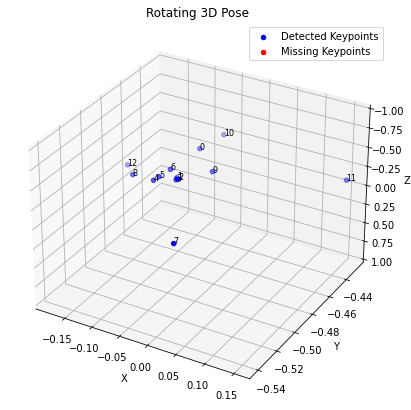

In [71]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation

# Example function to create a rotating 3D scatter plot for one frame
def rotating_3d_frame(keypoints):
    # Create a figure and a 3D axis
    fig = plt.figure(figsize=(10, 7))
    ax = fig.add_subplot(111, projection='3d')

    # Extract keypoints (assuming it's a 2D array of shape (33, 3))
    keypoints = np.array(keypoints)
    x, y, z = keypoints[:, 0], keypoints[:, 1], keypoints[:, 2]

    # Plot the initial frame
    scatter = ax.scatter(x, y, z, c='blue', label='Detected Keypoints')

    # Mark missing points in red
    missing = np.isnan(x)
    ax.scatter(x[missing], y[missing], z[missing], c='red', label='Missing Keypoints')

    # Add annotations for each keypoint index
    for i, (xi, yi, zi) in enumerate(zip(x, y, z)):
        if not np.isnan(xi):
            ax.text(xi, yi, zi, str(i), fontsize=8)

    # Set up the 3D plot
    ax.set_xlabel("X")
    ax.set_ylabel("Y")
    ax.set_zlabel("Z")
    ax.set_zlim(1, -1)
    ax.set_title("Rotating 3D Pose")
    ax.legend()

    # Update function for rotation
    def update(frame):
        ax.view_init(elev=30, azim=frame)  # Change azimuth angle
        return scatter,

    # Create the animation
    ani = FuncAnimation(
        fig,
        update,
        frames=range(0, 360, 2),  # Rotate full circle in steps
        interval=50,  # Interval between frames in milliseconds
        blit=False  # Turn off blitting for compatibility
    )

    # Show the animation
    plt.show()
#     ani.save("rotating_3d_frame.mp4", writer="ffmpeg", fps=30)

    return ani

# Example usage
# Replace 'keypoints' with your actual data for one frame
keypoints = keypoints_list[1]  # Simulate keypoints for demonstration
from IPython.display import HTML

ani = rotating_3d_frame(keypoints)  # Generate the animation
HTML(ani.to_jshtml())  # Display the animation in the notebook

In [23]:
# Testing the function
data_path = "../../AI System Data/Lean Forward/frames"
image_files = [f for f in os.listdir(data_path) if os.path.isfile(os.path.join(data_path, f))]
batch_size = 20
counter = 0
results_forward = []

# Initialize the model
initialize_model()

for i in range(len(image_files) // batch_size):
    # Load a batch of images
    images = [Image.open(os.path.join(data_path, image_file)) for image_file in image_files[counter:counter + batch_size]]
    
    # Perform posture detection on the batch
    batch_results = postureDetect(images)
    
    #Append batch results to the main results list
    results_forward.extend(batch_results)

    # Print keypoints results for the current batch
    for idx, keypoints in enumerate(batch_results):
        print(f"Image {counter + idx}: Keypoints - {keypoints}")
    
    counter += batch_size

#Process remaining images
images = [Image.open(os.path.join(data_path, image_file)) for image_file in image_files[counter:]]
if images:
    batch_results = postureDetect(images)
    results_forward.extend(batch_results)

    # Print keypoints for remaining images
    for idx, keypoints in enumerate(batch_results):
        print(f"Image {counter + idx}: Keypoints - {keypoints}")

# Print final keypoints results
for idx, keypoints in enumerate(results_forward):
    print(f"Image {idx}: Keypoints - {keypoints}")

Image 0: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 1: Keypoints - [[0.424843430519104, 0.6854543685913086, -1.512437343597412], [0.4804750084877014, 0.5016617774963379, -1.4587026834487915], [0.5185883045196533, 0.48659074306488037, -1.4600077867507935], [0.5475643873214722, 0.47507035732269287, -1.4598486423492432], [0.3689865469932556, 0.5216304063796997, -1.435597538948059], [0.3304958939552307, 0.5186764001846313, -1.4379551410675049], [0.29768991470336914, 0.513421893119812, -1.4394558668136597], [0.5940765738487244, 

Image 20: Keypoints - [[0.5147053599357605, 0.5764572620391846, -1.5566329956054688], [0.5460625290870667, 0.48655688762664795, -1.4837480783462524], [0.5744052529335022, 0.48425886034965515, -1.4847503900527954], [0.5913702249526978, 0.4810603857040405, -1.4845638275146484], [0.4791041612625122, 0.48787927627563477, -1.4791158437728882], [0.456015944480896, 0.4829949140548706, -1.4805307388305664], [0.438098281621933, 0.4791122376918793, -1.4815400838851929], [0.6147428154945374, 0.49843478202819824, -0.9619590640068054], [0.4054032564163208, 0.4952247440814972, -0.9404381513595581], [0.555497944355011, 0.6561702489852905, -1.343377947807312], [0.47173377871513367, 0.655102014541626, -1.3451508283615112], [0.7571357488632202, 0.8876698613166809, -0.6200670003890991], [0.25761672854423523, 0.8949291706085205, -0.576332688331604], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan,

Image 40: Keypoints - [[0.521051287651062, 0.5667470693588257, -1.5944082736968994], [0.5580787062644958, 0.4712584912776947, -1.5180718898773193], [0.5814136862754822, 0.4718766212463379, -1.5189694166183472], [0.6003624200820923, 0.4762260913848877, -1.5188570022583008], [0.4834684729576111, 0.4710426330566406, -1.5112574100494385], [0.46174946427345276, 0.4707905352115631, -1.5125149488449097], [0.44294220209121704, 0.4665505588054657, -1.5135676860809326], [0.63116455078125, 0.5053751468658447, -0.9888212084770203], [0.41888976097106934, 0.49664273858070374, -0.956639289855957], [0.5669711828231812, 0.6694676876068115, -1.3782789707183838], [0.4761246144771576, 0.6716264486312866, -1.375519871711731], [0.7692147493362427, 0.8926554918289185, -0.6028702855110168], [0.306244820356369, 0.9326643943786621, -0.5420392751693726], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, n

Image 60: Keypoints - [[0.48316866159439087, 0.5960304737091064, -1.669167399406433], [0.5270048379898071, 0.44280993938446045, -1.6024516820907593], [0.5637420415878296, 0.429794043302536, -1.6037801504135132], [0.5921763181686401, 0.41881263256073, -1.6036306619644165], [0.4346931576728821, 0.46191489696502686, -1.590834140777588], [0.40072476863861084, 0.4638493061065674, -1.5930991172790527], [0.36908864974975586, 0.46383655071258545, -1.5946581363677979], [0.6213172674179077, 0.4060171842575073, -1.0190966129302979], [0.338871568441391, 0.46648991107940674, -0.9583020210266113], [0.5523833632469177, 0.6849100589752197, -1.415927529335022], [0.43296632170677185, 0.7109631299972534, -1.4096415042877197], [0.851191520690918, 0.9510552883148193, -0.6181052923202515], [0.17695730924606323, 0.9323791265487671, -0.5377057790756226], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 80: Keypoints - [[0.5094249844551086, 0.5850903987884521, -1.5435523986816406], [0.5429322123527527, 0.4909590482711792, -1.4682613611221313], [0.570429801940918, 0.48754990100860596, -1.4692643880844116], [0.5881706476211548, 0.4843398630619049, -1.469100832939148], [0.47355136275291443, 0.487209677696228, -1.4624717235565186], [0.4509313106536865, 0.48345208168029785, -1.4639025926589966], [0.4334922134876251, 0.48230817914009094, -1.4649587869644165], [0.6122627258300781, 0.4982788562774658, -0.937335729598999], [0.4030924439430237, 0.4965835511684418, -0.9100025296211243], [0.5546078085899353, 0.6681092977523804, -1.3266853094100952], [0.46353259682655334, 0.6690797805786133, -1.3267924785614014], [0.7746018171310425, 0.9026316404342651, -0.6048100590705872], [0.2471473217010498, 0.9066339731216431, -0.5533969402313232], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 100: Keypoints - [[0.41674238443374634, 0.6067463159561157, -2.2140722274780273], [0.4126236140727997, 0.4604470431804657, -2.1467347145080566], [0.4365309774875641, 0.43160367012023926, -2.1482722759246826], [0.4577450454235077, 0.4065895080566406, -2.1478278636932373], [0.3472779393196106, 0.532309889793396, -2.1246304512023926], [0.32697635889053345, 0.5523872375488281, -2.126905918121338], [0.30758601427078247, 0.571241021156311, -2.128523349761963], [0.5100144147872925, 0.3895472288131714, -1.4784060716629028], [0.31768131256103516, 0.5935951471328735, -1.3671009540557861], [0.4969722628593445, 0.6422756910324097, -1.9221686124801636], [0.4221227765083313, 0.7156774997711182, -1.901856780052185], [0.8750730156898499, 0.7854248285293579, -0.8233009576797485], [0.2506958842277527, 0.9523814916610718, -0.8035696744918823], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 120: Keypoints - [[0.5014007091522217, 0.5679543018341064, -1.547861099243164], [0.5344720482826233, 0.4799157679080963, -1.4607625007629395], [0.5619404315948486, 0.4784429967403412, -1.4616652727127075], [0.5796703696250916, 0.47547590732574463, -1.461469054222107], [0.4679122865200043, 0.4766119420528412, -1.4539986848831177], [0.4446263313293457, 0.47112464904785156, -1.4552439451217651], [0.4272094964981079, 0.46748268604278564, -1.4562040567398071], [0.6084198355674744, 0.4935501515865326, -0.9011994004249573], [0.39811110496520996, 0.4829714298248291, -0.8718372583389282], [0.5485787987709045, 0.6479063034057617, -1.3250432014465332], [0.4616245925426483, 0.6531186103820801, -1.3239065408706665], [0.7684821486473083, 0.8879706859588623, -0.561613917350769], [0.24950307607650757, 0.9072185158729553, -0.5326732993125916], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 140: Keypoints - [[0.5445206761360168, 0.5065299272537231, -1.2637487649917603], [0.5724773406982422, 0.4176728427410126, -1.172667384147644], [0.5915780067443848, 0.4195273220539093, -1.1734027862548828], [0.6146551966667175, 0.42028987407684326, -1.1732094287872314], [0.5063072443008423, 0.4195820391178131, -1.1740189790725708], [0.48195815086364746, 0.4220682382583618, -1.1750705242156982], [0.46168166399002075, 0.4232889413833618, -1.1760029792785645], [0.6417797803878784, 0.46038711071014404, -0.632968544960022], [0.4335455298423767, 0.4555533230304718, -0.6372693181037903], [0.589589536190033, 0.5986509323120117, -1.0501724481582642], [0.4997003972530365, 0.6203566789627075, -1.0576359033584595], [0.8004911541938782, 0.919098973274231, -0.313564658164978], [0.2983417212963104, 0.9376441836357117, -0.34478962421417236], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 160: Keypoints - [[0.4923938810825348, 0.6188818216323853, -1.5163105726242065], [0.5424088835716248, 0.4513152539730072, -1.4567995071411133], [0.5788958668708801, 0.43862199783325195, -1.4581559896469116], [0.6076066493988037, 0.42981529235839844, -1.4580448865890503], [0.43470561504364014, 0.4734313488006592, -1.4407322406768799], [0.395914763212204, 0.4748784303665161, -1.4430924654006958], [0.3623843789100647, 0.4733012616634369, -1.4445096254348755], [0.6422592401504517, 0.42942726612091064, -0.8676503896713257], [0.33451956510543823, 0.4698393642902374, -0.7894467711448669], [0.567063570022583, 0.7289053201675415, -1.254467248916626], [0.4443514049053192, 0.7587525844573975, -1.245302438735962], [0.8865342736244202, 0.9005786180496216, -0.501555323600769], [0.15586498379707336, 0.9315738081932068, -0.30225059390068054], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 180: Keypoints - [[0.4551006853580475, 0.641366720199585, -1.4585222005844116], [0.5148817300796509, 0.45906269550323486, -1.399119257926941], [0.5475547313690186, 0.4512225389480591, -1.4004472494125366], [0.5804637670516968, 0.44386494159698486, -1.4003013372421265], [0.39617788791656494, 0.4661625623703003, -1.375766634941101], [0.3548005223274231, 0.46166813373565674, -1.3782380819320679], [0.31677353382110596, 0.45664262771606445, -1.3797931671142578], [0.6229445338249207, 0.43513014912605286, -0.817836582660675], [0.2796867787837982, 0.44732487201690674, -0.7119339108467102], [0.5251672863960266, 0.7529029250144958, -1.2015858888626099], [0.3947420120239258, 0.7655448913574219, -1.184236764907837], [0.8664093613624573, 0.907043993473053, -0.47625651955604553], [0.11986998468637466, 0.9379398822784424, -0.26252850890159607], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 200: Keypoints - [[0.45053258538246155, 0.6613422632217407, -1.384985327720642], [0.5133474469184875, 0.5160666704177856, -1.3252756595611572], [0.5476664900779724, 0.5145195722579956, -1.326585054397583], [0.5791590809822083, 0.5131038427352905, -1.3263702392578125], [0.4042367935180664, 0.5081385374069214, -1.3021262884140015], [0.366008996963501, 0.4979058504104614, -1.3046902418136597], [0.328754723072052, 0.48507964611053467, -1.3062435388565063], [0.6230120658874512, 0.51636803150177, -0.7594850063323975], [0.2979556620121002, 0.49827542901039124, -0.6541023850440979], [0.5199422240257263, 0.784845232963562, -1.1352925300598145], [0.3889084458351135, 0.7775107622146606, -1.1180293560028076], [0.861565113067627, 0.9266968369483948, -0.41366446018218994], [0.11988687515258789, 0.9228076338768005, -0.23275762796401978], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 220: Keypoints - [[0.5399844646453857, 0.6633257865905762, -1.142405390739441], [0.5584717988967896, 0.5974797010421753, -1.1279634237289429], [0.5730754733085632, 0.5932526588439941, -1.128430724143982], [0.584488034248352, 0.5903928279876709, -1.1284199953079224], [0.5153160095214844, 0.5973009467124939, -1.1274173259735107], [0.5037887692451477, 0.5932785868644714, -1.1279422044754028], [0.4940583109855652, 0.5897847414016724, -1.128387451171875], [0.606645405292511, 0.5808078646659851, -0.901987612247467], [0.47436240315437317, 0.5784874558448792, -0.8951661586761475], [0.5688107013702393, 0.7116923332214355, -1.0420310497283936], [0.5151940584182739, 0.7203030586242676, -1.0426889657974243], [0.6705477833747864, 0.7833589315414429, -0.6515313386917114], [0.40763023495674133, 0.775061309337616, -0.6771832704544067], [0.758386492729187, 0.9986569881439209, -0.6218298077583313], [0.3399718105792999, 1.0081864595413208, -0.7294649481773376], [nan, nan, nan], [nan, nan, nan], [na

Image 240: Keypoints - [[0.5474443435668945, 0.48714157938957214, -1.646697759628296], [0.5799835920333862, 0.39976146817207336, -1.5433235168457031], [0.611209511756897, 0.39995285868644714, -1.5444267988204956], [0.6337906122207642, 0.3992142677307129, -1.5440737009048462], [0.5088094472885132, 0.39428281784057617, -1.548721194267273], [0.48562413454055786, 0.3938331604003906, -1.5504037141799927], [0.46414726972579956, 0.39547228813171387, -1.5516102313995361], [0.6668940782546997, 0.4220695495605469, -0.8922893404960632], [0.4325008988380432, 0.4307990074157715, -0.9161363840103149], [0.6038267016410828, 0.5966821908950806, -1.3840041160583496], [0.5007554888725281, 0.603527307510376, -1.400390625], [0.8340758085250854, 0.9684444665908813, -0.4673035740852356], [0.28928568959236145, 0.9509169459342957, -0.4808198809623718], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, n

Image 260: Keypoints - [[0.5281574726104736, 0.6342262029647827, -0.5137079358100891], [0.5551882386207581, 0.5894067287445068, -0.5037147402763367], [0.565024733543396, 0.5880453586578369, -0.5039505362510681], [0.5732587575912476, 0.5867705345153809, -0.5037937760353088], [0.510400652885437, 0.5713132619857788, -0.5042336583137512], [0.4984791576862335, 0.5643018484115601, -0.504554033279419], [0.4897068738937378, 0.5584670305252075, -0.5047599077224731], [0.5953345894813538, 0.5757170915603638, -0.389812171459198], [0.47766461968421936, 0.5394678711891174, -0.3927187919616699], [0.5548146963119507, 0.6644365191459656, -0.46303465962409973], [0.5081222057342529, 0.6492060422897339, -0.465450644493103], [0.5946884751319885, 0.6379286050796509, -0.2657456696033478], [0.48397862911224365, 0.6099857091903687, -0.31522780656814575], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan,

Image 280: Keypoints - [[0.5291488766670227, 0.5138798952102661, -1.5706735849380493], [0.5617743134498596, 0.4148216247558594, -1.4808861017227173], [0.5894381999969482, 0.4124276340007782, -1.4817873239517212], [0.6064478158950806, 0.413238525390625, -1.4815512895584106], [0.491624653339386, 0.41572844982147217, -1.4791457653045654], [0.4678683876991272, 0.41542184352874756, -1.4804871082305908], [0.44699549674987793, 0.41436469554901123, -1.4814478158950806], [0.6415442824363708, 0.44327306747436523, -0.8948773145675659], [0.42264461517333984, 0.4445509910583496, -0.8835850954055786], [0.58023601770401, 0.616832971572876, -1.3349909782409668], [0.48076796531677246, 0.6242172718048096, -1.3395363092422485], [0.7964825630187988, 0.9069399237632751, -0.5212166905403137], [0.30715060234069824, 0.9189364314079285, -0.5069011449813843], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 300: Keypoints - [[0.5399978160858154, 0.5208480358123779, -1.1176114082336426], [0.5656031370162964, 0.43715739250183105, -1.0364168882369995], [0.5890458226203918, 0.4380040168762207, -1.0370490550994873], [0.6050492525100708, 0.4393233060836792, -1.0368669033050537], [0.5063567161560059, 0.43532273173332214, -1.0321944952011108], [0.4868207573890686, 0.43578195571899414, -1.033117651939392], [0.4681057035923004, 0.43853652477264404, -1.0339105129241943], [0.6375859379768372, 0.46881532669067383, -0.5603785514831543], [0.44027215242385864, 0.47179675102233887, -0.538583517074585], [0.585717499256134, 0.6106147766113281, -0.9288131594657898], [0.49738818407058716, 0.6262416839599609, -0.9281665086746216], [0.7770406007766724, 0.9042448997497559, -0.3002265393733978], [0.3248943090438843, 0.9289430975914001, -0.25894758105278015], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 320: Keypoints - [[0.4820719361305237, 0.7428661584854126, -1.893419861793518], [0.5267964005470276, 0.565493106842041, -1.88191556930542], [0.5625284910202026, 0.5481621026992798, -1.8832824230194092], [0.592516303062439, 0.5345079898834229, -1.883034348487854], [0.40944045782089233, 0.5934046506881714, -1.8686712980270386], [0.37370267510414124, 0.5919719934463501, -1.871108055114746], [0.34198129177093506, 0.5872393846511841, -1.8726147413253784], [0.6399950385093689, 0.49563053250312805, -1.4024021625518799], [0.31397849321365356, 0.5487180948257446, -1.3467763662338257], [0.5530799627304077, 0.8146979212760925, -1.6599795818328857], [0.4453140199184418, 0.8419821262359619, -1.656273603439331], [0.8452489376068115, 0.8322188258171082, -0.9166487455368042], [0.15578868985176086, 0.874931275844574, -0.8120032548904419], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, n

Image 340: Keypoints - [[0.5743917226791382, 0.5170010328292847, -1.7361055612564087], [0.6108561754226685, 0.40691637992858887, -1.6533763408660889], [0.6413906216621399, 0.40280091762542725, -1.6543304920196533], [0.6618041396141052, 0.4019278287887573, -1.6540071964263916], [0.5295737385749817, 0.4134666919708252, -1.6467745304107666], [0.5054547786712646, 0.4159274101257324, -1.6483638286590576], [0.4850830137729645, 0.41218292713165283, -1.6496353149414062], [0.6999540328979492, 0.42609819769859314, -1.0647021532058716], [0.45781511068344116, 0.4469139575958252, -1.0327732563018799], [0.6274149417877197, 0.6257272958755493, -1.4942419528961182], [0.5215010046958923, 0.6424952745437622, -1.492926836013794], [0.8760440945625305, 0.923060417175293, -0.6240699291229248], [0.324756920337677, 0.8828967809677124, -0.602482259273529], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 360: Keypoints - [[0.35758379101753235, 0.3353097438812256, -1.314281940460205], [0.4246821999549866, 0.24589873850345612, -1.2661998271942139], [0.4554961919784546, 0.25080013275146484, -1.2673835754394531], [0.48611488938331604, 0.25699496269226074, -1.2669677734375], [0.3577495217323303, 0.2510840892791748, -1.2294880151748657], [0.33762869238853455, 0.2578420639038086, -1.2316904067993164], [0.32041794061660767, 0.2640340328216553, -1.2331136465072632], [0.5627157092094421, 0.3280510902404785, -0.8448349833488464], [0.3444684147834778, 0.3164198398590088, -0.67924964427948], [0.4258617162704468, 0.4682762622833252, -1.1321940422058105], [0.32700368762016296, 0.4626692533493042, -1.0949565172195435], [0.8451482653617859, 0.8612788915634155, -0.5162356495857239], [0.15063300728797913, 0.8957011103630066, -0.40182825922966003], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 380: Keypoints - [[0.5207922458648682, 0.5780868530273438, -1.7146642208099365], [0.554995059967041, 0.48123037815093994, -1.6396499872207642], [0.5825014710426331, 0.47912243008613586, -1.6407275199890137], [0.5988304018974304, 0.47673550248146057, -1.6406147480010986], [0.4843044579029083, 0.47808635234832764, -1.6354539394378662], [0.46283191442489624, 0.47421231865882874, -1.6368054151535034], [0.44441086053848267, 0.4720032215118408, -1.6378036737442017], [0.6221908330917358, 0.49421098828315735, -1.085771083831787], [0.41364485025405884, 0.4867398738861084, -1.0657192468643188], [0.5651453733444214, 0.6582460403442383, -1.4876501560211182], [0.4773707985877991, 0.6589738130569458, -1.4898170232772827], [0.7708259224891663, 0.8862097859382629, -0.7160775065422058], [0.25314563512802124, 0.9084821939468384, -0.6635634899139404], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 400: Keypoints - [[0.5062590837478638, 0.5640661716461182, -1.6351027488708496], [0.5389435887336731, 0.47276556491851807, -1.5528217554092407], [0.5665845274925232, 0.4696943759918213, -1.553828239440918], [0.584041178226471, 0.46695268154144287, -1.5536528825759888], [0.47368499636650085, 0.46941351890563965, -1.5495442152023315], [0.45144549012184143, 0.46457982063293457, -1.550963044166565], [0.43291568756103516, 0.4612809419631958, -1.5520117282867432], [0.6118856072425842, 0.4833984375, -0.9903493523597717], [0.4025740623474121, 0.479481965303421, -0.9747918248176575], [0.5529986023902893, 0.6432994604110718, -1.4078452587127686], [0.4648135304450989, 0.645498514175415, -1.4110337495803833], [0.7710033059120178, 0.8900096416473389, -0.6212217211723328], [0.25561705231666565, 0.8972422480583191, -0.6011923551559448], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, n

Image 420: Keypoints - [[0.5471432209014893, 0.49246513843536377, -1.5718801021575928], [0.577562153339386, 0.39953184127807617, -1.4623527526855469], [0.6076370477676392, 0.39752256870269775, -1.4633501768112183], [0.6276757717132568, 0.39739832282066345, -1.4629958868026733], [0.5060583353042603, 0.4006986916065216, -1.4715371131896973], [0.48129361867904663, 0.4036223888397217, -1.4731029272079468], [0.46259164810180664, 0.40402305126190186, -1.4742846488952637], [0.6650233864784241, 0.4200681447982788, -0.798337996006012], [0.43524450063705444, 0.44232356548309326, -0.8407027125358582], [0.6008984446525574, 0.596631646156311, -1.30693781375885], [0.4993709921836853, 0.6108542680740356, -1.3278400897979736], [0.825104832649231, 0.9315428733825684, -0.3474236726760864], [0.2952437996864319, 0.9378203749656677, -0.45279303193092346], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 440: Keypoints - [[0.4727628231048584, 0.6891624927520752, -1.6797722578048706], [0.5337461233139038, 0.5367872714996338, -1.6344900131225586], [0.5699862241744995, 0.5344371795654297, -1.635981798171997], [0.6010860204696655, 0.5322432518005371, -1.6358301639556885], [0.4214935302734375, 0.5320055484771729, -1.6144434213638306], [0.3791273236274719, 0.5234792232513428, -1.6170073747634888], [0.3404262065887451, 0.5127582550048828, -1.6186082363128662], [0.6436040997505188, 0.5357856750488281, -1.065172791481018], [0.2992345690727234, 0.5223839282989502, -0.9729770421981812], [0.5407997965812683, 0.8114885091781616, -1.4196397066116333], [0.40587255358695984, 0.8142634630203247, -1.4067349433898926], [0.8693251609802246, 0.9217103123664856, -0.6709824800491333], [0.10859131813049316, 0.9330790042877197, -0.4843108057975769], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 460: Keypoints - [[0.5565394759178162, 0.6982126235961914, -1.1650384664535522], [0.5752806067466736, 0.6286270022392273, -1.1408400535583496], [0.5895452499389648, 0.6207916140556335, -1.1413532495498657], [0.6000443696975708, 0.6140801310539246, -1.1413532495498657], [0.5309751033782959, 0.6339444518089294, -1.1480247974395752], [0.5160167217254639, 0.6295579075813293, -1.1485759019851685], [0.503485381603241, 0.6236467957496643, -1.149016261100769], [0.6166723370552063, 0.590427041053772, -0.8623861074447632], [0.48108184337615967, 0.5998901128768921, -0.8906168341636658], [0.5824735164642334, 0.7444977760314941, -1.043245553970337], [0.5339968204498291, 0.7554886341094971, -1.0547654628753662], [0.6881866455078125, 0.8109853267669678, -0.5926920175552368], [0.39967483282089233, 0.8145790100097656, -0.6516082882881165], [nan, nan, nan], [0.3505967855453491, 1.1357874870300293, -0.7135251760482788], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, 

Image 480: Keypoints - [[0.5042965412139893, 0.5848273038864136, -1.562489628791809], [0.5378503203392029, 0.4893001317977905, -1.4765081405639648], [0.5653152465820312, 0.48545289039611816, -1.4774521589279175], [0.5835432410240173, 0.48266708850860596, -1.4772064685821533], [0.47213688492774963, 0.48793816566467285, -1.4709547758102417], [0.44963034987449646, 0.48478150367736816, -1.4723223447799683], [0.4330606758594513, 0.4817279279232025, -1.473367691040039], [0.6136968731880188, 0.49674180150032043, -0.9033027291297913], [0.404712438583374, 0.5013363361358643, -0.8774965405464172], [0.5517843961715698, 0.6591167449951172, -1.332161784172058], [0.46586400270462036, 0.6650774478912354, -1.3320850133895874], [0.7723077535629272, 0.8896594643592834, -0.5384925007820129], [0.2685014009475708, 0.887965738773346, -0.5116984248161316], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 500: Keypoints - [[0.5494932532310486, 0.6499565839767456, -0.8199313282966614], [0.5707759261131287, 0.5832732915878296, -0.7915166616439819], [0.585832953453064, 0.5795215368270874, -0.7919301390647888], [0.5993331074714661, 0.5758718252182007, -0.7919018268585205], [0.5286338329315186, 0.5779345631599426, -0.7885484099388123], [0.5167248249053955, 0.5715978741645813, -0.7892261147499084], [0.5055366158485413, 0.5628038048744202, -0.7896064519882202], [0.6211012601852417, 0.5652350783348083, -0.5367549061775208], [0.4904974102973938, 0.5458362102508545, -0.5206586122512817], [0.5689383149147034, 0.7051510214805603, -0.7104974985122681], [0.5240004062652588, 0.7062507271766663, -0.7098301649093628], [0.6932328939437866, 0.8250646591186523, -0.35216644406318665], [0.39310142397880554, 0.7774344086647034, -0.30728375911712646], [nan, nan, nan], [0.2533074617385864, 0.9943040609359741, -0.32060506939888], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan

Image 520: Keypoints - [[0.5412483811378479, 0.6794853210449219, -0.9388067126274109], [0.5665737986564636, 0.6134663224220276, -0.9083386659622192], [0.5789891481399536, 0.6083920001983643, -0.9086278080940247], [0.5882588624954224, 0.6034351587295532, -0.9085413217544556], [0.5117766857147217, 0.6108280420303345, -0.912013828754425], [0.5009021759033203, 0.6090956926345825, -0.9123080968856812], [0.49198445677757263, 0.6047539710998535, -0.9125267863273621], [0.6106715798377991, 0.5882372856140137, -0.6858540773391724], [0.47273939847946167, 0.5689053535461426, -0.7034343481063843], [0.5696033835411072, 0.7170552611351013, -0.8478432297706604], [0.5107926726341248, 0.7157864570617676, -0.8545647263526917], [0.617615282535553, 0.7670599222183228, -0.49953505396842957], [0.4193756878376007, 0.7353107929229736, -0.565045177936554], [0.6295141577720642, 0.9556423425674438, -0.4830019772052765], [0.3744381368160248, 0.9274113774299622, -0.6698898077011108], [nan, nan, nan], [nan, nan, nan

Image 540: Keypoints - [[0.5179282426834106, 0.5789569616317749, -1.5998700857162476], [0.5520249009132385, 0.484120637178421, -1.5213218927383423], [0.579960286617279, 0.4816441237926483, -1.522329568862915], [0.596327543258667, 0.4789775609970093, -1.5221467018127441], [0.4830204248428345, 0.47890838980674744, -1.5177247524261475], [0.4604799747467041, 0.47514644265174866, -1.519158124923706], [0.44199150800704956, 0.4725186824798584, -1.5201634168624878], [0.6167774200439453, 0.49822449684143066, -0.9750185608863831], [0.41020306944847107, 0.4874379336833954, -0.9590167999267578], [0.561126172542572, 0.6602280139923096, -1.3772801160812378], [0.47312575578689575, 0.657529354095459, -1.3807212114334106], [0.7685775756835938, 0.8966068029403687, -0.6268932819366455], [0.25237712264060974, 0.9034750461578369, -0.5818285942077637], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 560: Keypoints - [[0.5100873708724976, 0.5749169588088989, -1.4361233711242676], [0.5449362993240356, 0.48220017552375793, -1.367027997970581], [0.5731174349784851, 0.48004162311553955, -1.3679946660995483], [0.5902313590049744, 0.47777804732322693, -1.3678011894226074], [0.4759798049926758, 0.47723472118377686, -1.3598318099975586], [0.45307064056396484, 0.47220802307128906, -1.3612945079803467], [0.43550172448158264, 0.4679749011993408, -1.3623504638671875], [0.6150839328765869, 0.49617359042167664, -0.8813979625701904], [0.4058143198490143, 0.4847409725189209, -0.8500980138778687], [0.5565410256385803, 0.6545932292938232, -1.237362027168274], [0.46744757890701294, 0.6572892665863037, -1.235874056816101], [0.7737064957618713, 0.8992471694946289, -0.5795842409133911], [0.2566138207912445, 0.8992403745651245, -0.5224596261978149], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 580: Keypoints - [[0.45878392457962036, 0.6404919624328613, -1.5638333559036255], [0.5137317180633545, 0.4591883420944214, -1.5003515481948853], [0.5531253814697266, 0.4453340768814087, -1.5016453266143799], [0.5827596783638, 0.436965674161911, -1.5014488697052002], [0.40194132924079895, 0.4844795763492584, -1.4782993793487549], [0.3625674843788147, 0.4874105751514435, -1.4806997776031494], [0.3279503583908081, 0.48820197582244873, -1.4821380376815796], [0.6270057559013367, 0.428852915763855, -0.881711483001709], [0.3076004683971405, 0.47749149799346924, -0.7770289182662964], [0.5391259789466858, 0.7433928847312927, -1.2912482023239136], [0.40912026166915894, 0.7657308578491211, -1.2743669748306274], [0.8829289674758911, 0.9011491537094116, -0.5021010637283325], [0.14142689108848572, 0.9286957383155823, -0.2985913157463074], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 600: Keypoints - [[0.41016846895217896, 0.6633270978927612, -1.7336879968643188], [0.475818932056427, 0.4955862760543823, -1.6643593311309814], [0.5190011858940125, 0.48978662490844727, -1.6658788919448853], [0.5507907867431641, 0.48486435413360596, -1.6654859781265259], [0.3544386625289917, 0.49038755893707275, -1.6267454624176025], [0.31731292605400085, 0.48674535751342773, -1.6290229558944702], [0.28372499346733093, 0.4866461753845215, -1.6307141780853271], [0.5909947752952576, 0.49829956889152527, -1.0336788892745972], [0.2598104178905487, 0.5247474908828735, -0.8613801002502441], [0.4948827624320984, 0.7929689884185791, -1.4589608907699585], [0.35813677310943604, 0.7935292720794678, -1.4211465120315552], [0.8715296983718872, 0.9927323460578918, -0.5113439559936523], [0.15970993041992188, 0.9249420166015625, -0.3782147169113159], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, n

Image 620: Keypoints - [[0.5172121524810791, 0.4872235059738159, -1.5524470806121826], [0.5542829036712646, 0.3826580047607422, -1.4511123895645142], [0.5850995779037476, 0.3826746940612793, -1.4520756006240845], [0.6084492206573486, 0.3845231235027313, -1.4516198635101318], [0.48099255561828613, 0.3857596218585968, -1.4513349533081055], [0.4566729664802551, 0.38954636454582214, -1.45308518409729], [0.4379638731479645, 0.39304444193840027, -1.4542547464370728], [0.6565783619880676, 0.4225461184978485, -0.804702877998352], [0.4159794747829437, 0.44310978055000305, -0.8080592155456543], [0.583473801612854, 0.6032102108001709, -1.2908674478530884], [0.47701844573020935, 0.6139847040176392, -1.301104187965393], [0.8283276557922363, 0.9300498366355896, -0.3567877411842346], [0.28646546602249146, 0.924906849861145, -0.41797828674316406], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 640: Keypoints - [[0.5144496560096741, 0.5719786882400513, -1.8017674684524536], [0.5484606623649597, 0.4765528440475464, -1.7152940034866333], [0.5761508941650391, 0.473685622215271, -1.7164053916931152], [0.5930373668670654, 0.4708443880081177, -1.7162367105484009], [0.4778282642364502, 0.4726874828338623, -1.7176023721694946], [0.4549157917499542, 0.4687436819076538, -1.7191057205200195], [0.4360666275024414, 0.46661555767059326, -1.7202093601226807], [0.6163499355316162, 0.4878823757171631, -1.1083437204360962], [0.40352290868759155, 0.48122909665107727, -1.1186619997024536], [0.5600999593734741, 0.6543823480606079, -1.5554062128067017], [0.46944504976272583, 0.6552091836929321, -1.566732406616211], [0.7703962922096252, 0.8936814069747925, -0.6788305044174194], [0.2465234398841858, 0.9021772146224976, -0.7070627212524414], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 660: Keypoints - [[0.5708709359169006, 0.517553448677063, -1.8766734600067139], [0.605448842048645, 0.4087047576904297, -1.7898632287979126], [0.633691668510437, 0.40556302666664124, -1.7908961772918701], [0.6543400883674622, 0.40309667587280273, -1.790580153465271], [0.5304125547409058, 0.4136195182800293, -1.7826406955718994], [0.5071717500686646, 0.4160327911376953, -1.7842203378677368], [0.4876548647880554, 0.4144943952560425, -1.7856428623199463], [0.6940805315971375, 0.42261505126953125, -1.1768988370895386], [0.4597468376159668, 0.4436699450016022, -1.1423224210739136], [0.6246970295906067, 0.6225314140319824, -1.624936819076538], [0.5195456147193909, 0.6353217363357544, -1.6226615905761719], [0.8593230247497559, 0.9045714735984802, -0.6853723526000977], [0.3228495419025421, 0.8728450536727905, -0.6463983058929443], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 680: Keypoints - [[0.5160037279129028, 0.5636099576950073, -1.6465370655059814], [0.5481573939323425, 0.47162342071533203, -1.5629150867462158], [0.5756244659423828, 0.4679332971572876, -1.5639464855194092], [0.5933097004890442, 0.4634925127029419, -1.5637720823287964], [0.4786806106567383, 0.4719051122665405, -1.563208818435669], [0.45644310116767883, 0.4675157070159912, -1.5645573139190674], [0.4380326569080353, 0.46477246284484863, -1.565550446510315], [0.6161522269248962, 0.48052000999450684, -0.9972358345985413], [0.40611276030540466, 0.47788453102111816, -0.999212920665741], [0.5607680082321167, 0.6429598331451416, -1.418466567993164], [0.4732982814311981, 0.6474640369415283, -1.426682710647583], [0.770049512386322, 0.8826894760131836, -0.6374903321266174], [0.2494337409734726, 0.9078755974769592, -0.6248665452003479], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 700: Keypoints - [[0.4892747700214386, 0.5192124843597412, -1.4746804237365723], [0.5461394190788269, 0.37262654304504395, -1.399911642074585], [0.5805917978286743, 0.36713409423828125, -1.401367425918579], [0.6120479106903076, 0.36232614517211914, -1.4012781381607056], [0.4405412971973419, 0.3670656979084015, -1.3928195238113403], [0.4022713899612427, 0.3570527732372284, -1.3951563835144043], [0.36472100019454956, 0.3458125591278076, -1.3966257572174072], [0.6347059607505798, 0.37548184394836426, -0.7910947203636169], [0.31985270977020264, 0.3596913516521454, -0.754523515701294], [0.5551854968070984, 0.6484670639038086, -1.213818073272705], [0.4282073974609375, 0.6558409929275513, -1.2165069580078125], [0.8663444519042969, 0.9085764288902283, -0.48268353939056396], [0.11397731304168701, 0.9495975971221924, -0.3483056426048279], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 720: Keypoints - [[0.4848516285419464, 0.7566514015197754, -1.663511872291565], [0.5397941470146179, 0.5617742538452148, -1.6251304149627686], [0.5767885446548462, 0.5486253499984741, -1.6263056993484497], [0.6085960268974304, 0.539003849029541, -1.6261093616485596], [0.40945494174957275, 0.5754234790802002, -1.6075923442840576], [0.3718201816082001, 0.5681898593902588, -1.60979163646698], [0.3414050340652466, 0.560330867767334, -1.6111739873886108], [0.6533353328704834, 0.5128253698348999, -1.0926600694656372], [0.3228592872619629, 0.5302635431289673, -1.0082520246505737], [0.56894850730896, 0.8407273292541504, -1.4176872968673706], [0.43473076820373535, 0.8633081912994385, -1.4048398733139038], [0.8867061138153076, 0.9394845962524414, -0.701359748840332], [0.1450190544128418, 0.9081503748893738, -0.5308070182800293], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan,

Image 740: Keypoints - [[0.5284134745597839, 0.6724602580070496, -0.5967950820922852], [0.5508782863616943, 0.6054865717887878, -0.5724457502365112], [0.5668142437934875, 0.6018721461296082, -0.5728124976158142], [0.5809853076934814, 0.597089946269989, -0.5727770328521729], [0.5085100531578064, 0.6008734703063965, -0.569143533706665], [0.4968479871749878, 0.5944480299949646, -0.569813072681427], [0.48632144927978516, 0.5858483910560608, -0.5702261328697205], [0.604970395565033, 0.5860679745674133, -0.359207421541214], [0.4724682569503784, 0.5740485191345215, -0.34347832202911377], [0.5535764098167419, 0.7324977517127991, -0.5039175748825073], [0.5047826766967773, 0.729271650314331, -0.5029208064079285], [0.6844700574874878, 0.8210469484329224, -0.22188618779182434], [0.37569940090179443, 0.8046602010726929, -0.19905564188957214], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan,

Image 760: Keypoints - [[0.4553038477897644, 0.6740754842758179, -1.2617101669311523], [0.5212622880935669, 0.506351113319397, -1.1888964176177979], [0.5578639507293701, 0.4969879686832428, -1.1900122165679932], [0.588476300239563, 0.48959028720855713, -1.1897410154342651], [0.4022098481655121, 0.5176146030426025, -1.1702584028244019], [0.3606241047382355, 0.512250542640686, -1.172641396522522], [0.325347900390625, 0.504802942276001, -1.174042820930481], [0.6328518390655518, 0.48217713832855225, -0.5851314067840576], [0.30848264694213867, 0.48972904682159424, -0.4941934049129486], [0.5398562550544739, 0.790520966053009, -0.9983780384063721], [0.4096900224685669, 0.7984716892242432, -0.9852433800697327], [0.886665940284729, 0.930951714515686, -0.24219346046447754], [0.14885559678077698, 0.9370542168617249, -0.05511338263750076], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, n

Image 780: Keypoints - [[0.547784149646759, 0.4850504696369171, -1.880074143409729], [0.5872724652290344, 0.3857310116291046, -1.768441915512085], [0.6154525876045227, 0.38669323921203613, -1.7696201801300049], [0.6409145593643188, 0.38797450065612793, -1.7692558765411377], [0.5135165452957153, 0.38317060470581055, -1.7737833261489868], [0.48961371183395386, 0.38552311062812805, -1.7754656076431274], [0.4695907533168793, 0.3884012997150421, -1.7768529653549194], [0.6832872033119202, 0.42239999771118164, -1.0634909868240356], [0.44632473587989807, 0.4310667812824249, -1.084612250328064], [0.6069431304931641, 0.6088794469833374, -1.5967180728912354], [0.5076221227645874, 0.5984370708465576, -1.612226128578186], [0.8684776425361633, 0.960360050201416, -0.548555850982666], [0.2939774990081787, 0.94869065284729, -0.6211702227592468], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 800: Keypoints - [[0.5106390118598938, 0.5653903484344482, -1.4718812704086304], [0.5431531071662903, 0.4732612371444702, -1.3892436027526855], [0.5707021355628967, 0.4708758592605591, -1.3902283906936646], [0.588326096534729, 0.46752679347991943, -1.3900047540664673], [0.47650283575057983, 0.47011852264404297, -1.385004997253418], [0.45397502183914185, 0.4655795097351074, -1.3863976001739502], [0.43526870012283325, 0.4623171091079712, -1.3874437808990479], [0.6143223643302917, 0.4852793514728546, -0.8456088304519653], [0.40361014008522034, 0.47730299830436707, -0.8281543254852295], [0.5566257834434509, 0.6435205936431885, -1.2531620264053345], [0.46717390418052673, 0.6472094058990479, -1.2558521032333374], [0.7721795439720154, 0.8931317329406738, -0.5134600400924683], [0.24828778207302094, 0.9063699245452881, -0.48714742064476013], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 820: Keypoints - [[0.5178365111351013, 0.5681670904159546, -1.457012414932251], [0.5513363480567932, 0.47038161754608154, -1.3900105953216553], [0.5788170695304871, 0.46909940242767334, -1.3910431861877441], [0.5948872566223145, 0.4696387052536011, -1.3909209966659546], [0.4839591681957245, 0.46591949462890625, -1.384943962097168], [0.4597085118293762, 0.46330857276916504, -1.386365294456482], [0.4428037703037262, 0.4613535404205322, -1.3874067068099976], [0.6185067296028137, 0.4880668818950653, -0.8968397378921509], [0.41005298495292664, 0.48062852025032043, -0.8731165528297424], [0.5604358315467834, 0.6521468162536621, -1.253522515296936], [0.4724455773830414, 0.6512924432754517, -1.2548041343688965], [0.7808969616889954, 0.8869386911392212, -0.5796166658401489], [0.2520710825920105, 0.9079445600509644, -0.5403065085411072], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 840: Keypoints - [[0.46071088314056396, 0.5364505052566528, -1.471211314201355], [0.5245059728622437, 0.38084912300109863, -1.3954243659973145], [0.5577892661094666, 0.3764834403991699, -1.3967686891555786], [0.5917324423789978, 0.3707263469696045, -1.3965703248977661], [0.4065893888473511, 0.37247729301452637, -1.377886176109314], [0.3641117215156555, 0.3616164028644562, -1.3802380561828613], [0.32696932554244995, 0.3504598140716553, -1.3816819190979004], [0.6295626759529114, 0.37029075622558594, -0.7853260636329651], [0.29816848039627075, 0.355987548828125, -0.7045688629150391], [0.5382099151611328, 0.6583428382873535, -1.2116769552230835], [0.39226675033569336, 0.6617530584335327, -1.2013871669769287], [0.864945113658905, 0.9105788469314575, -0.47502973675727844], [0.10926079750061035, 0.9659676551818848, -0.2870243191719055], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 860: Keypoints - [[0.5304880738258362, 0.5847263336181641, -1.8033775091171265], [0.5829876661300659, 0.4487074613571167, -1.725887656211853], [0.6156837344169617, 0.44584688544273376, -1.7273012399673462], [0.6485510468482971, 0.44194886088371277, -1.7272194623947144], [0.4921893775463104, 0.44309425354003906, -1.7291061878204346], [0.4629189968109131, 0.4364159107208252, -1.731213092803955], [0.4285045862197876, 0.42957714200019836, -1.7326335906982422], [0.6698238849639893, 0.45009830594062805, -1.0997974872589111], [0.38543635606765747, 0.4389403164386749, -1.1065177917480469], [0.5867956876754761, 0.6890115737915039, -1.5349398851394653], [0.47895094752311707, 0.6801772117614746, -1.5487040281295776], [0.8652479648590088, 0.9858503341674805, -0.6377994418144226], [0.18183839321136475, 0.936863899230957, -0.6960762143135071], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 880: Keypoints - [[0.5398825407028198, 0.28954458236694336, -1.5122638940811157], [0.5805156826972961, 0.2034473419189453, -1.3956749439239502], [0.6125054955482483, 0.2121593952178955, -1.3969391584396362], [0.6416959762573242, 0.22191929817199707, -1.3968020677566528], [0.5005967020988464, 0.19474506378173828, -1.403522253036499], [0.4700388014316559, 0.1957235336303711, -1.4053736925125122], [0.4409891963005066, 0.19696688652038574, -1.406714916229248], [0.667618453502655, 0.2795755863189697, -0.7093692421913147], [0.365583598613739, 0.26288747787475586, -0.7464250922203064], [0.5920711755752563, 0.4168581962585449, -1.239388346672058], [0.47822463512420654, 0.40371033549308777, -1.2609819173812866], [0.8630968332290649, 0.8799838423728943, -0.3335209786891937], [0.15245285630226135, 0.8659674525260925, -0.42593467235565186], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 900: Keypoints - [[0.36067771911621094, 0.6847200393676758, -2.03267240524292], [0.35890525579452515, 0.5425847768783569, -1.9384503364562988], [0.3854166865348816, 0.5105092525482178, -1.9400405883789062], [0.4109984040260315, 0.48209309577941895, -1.9394692182540894], [0.2944844365119934, 0.6071124076843262, -1.9178555011749268], [0.27493685483932495, 0.6217265129089355, -1.920003056526184], [0.256280779838562, 0.6340295076370239, -1.9215993881225586], [0.46908771991729736, 0.45794427394866943, -1.225717306137085], [0.27704375982284546, 0.6487393379211426, -1.1378934383392334], [0.45067787170410156, 0.7135227918624878, -1.7336887121200562], [0.3770718574523926, 0.787205696105957, -1.7203437089920044], [0.8726054430007935, 0.7993278503417969, -0.6244983077049255], [0.22883373498916626, 1.0529688596725464, -0.6597598195075989], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 920: Keypoints - [[0.5175561904907227, 0.5774388313293457, -1.597696304321289], [0.5510996580123901, 0.4802052676677704, -1.520380973815918], [0.5797716975212097, 0.4773513376712799, -1.5214699506759644], [0.5959166884422302, 0.475424200296402, -1.5213154554367065], [0.48074400424957275, 0.47762051224708557, -1.5147027969360352], [0.457101970911026, 0.47451674938201904, -1.5161199569702148], [0.4391491413116455, 0.4729936122894287, -1.5171984434127808], [0.618883490562439, 0.4957927465438843, -0.9789978265762329], [0.4067276120185852, 0.48965176939964294, -0.952666163444519], [0.5620670318603516, 0.6628438234329224, -1.377776026725769], [0.4715458154678345, 0.6627452373504639, -1.378230094909668], [0.778541088104248, 0.9027385711669922, -0.6467034220695496], [0.25472694635391235, 0.9053550958633423, -0.5887375473976135], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, na

Image 940: Keypoints - [[0.5220412015914917, 0.47771480679512024, -1.5395725965499878], [0.5566786527633667, 0.37050628662109375, -1.436865210533142], [0.5885738134384155, 0.370575875043869, -1.4379055500030518], [0.6108867526054382, 0.37311792373657227, -1.4374277591705322], [0.48274606466293335, 0.377989798784256, -1.439314842224121], [0.4587256908416748, 0.38355472683906555, -1.441004753112793], [0.4384942948818207, 0.3899882137775421, -1.4421241283416748], [0.6557247638702393, 0.41213464736938477, -0.7848470211029053], [0.4161556363105774, 0.440643310546875, -0.7960566282272339], [0.5846831202507019, 0.5934444665908813, -1.2750941514968872], [0.4806674122810364, 0.6100952625274658, -1.2880334854125977], [0.8248544931411743, 0.94170081615448, -0.33672067523002625], [0.2859649360179901, 0.9221187829971313, -0.39682626724243164], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 960: Keypoints - [[0.4508326053619385, 0.6810961961746216, -1.313826084136963], [0.5131170749664307, 0.5266314744949341, -1.252083420753479], [0.5461066365242004, 0.5224134922027588, -1.2532963752746582], [0.5784177780151367, 0.5192306041717529, -1.2530796527862549], [0.4056084156036377, 0.5245227813720703, -1.2318953275680542], [0.36885756254196167, 0.5148420333862305, -1.2344249486923218], [0.3328961431980133, 0.5031177997589111, -1.2359027862548828], [0.6205917000770569, 0.5145113468170166, -0.6851699948310852], [0.30067121982574463, 0.5032553672790527, -0.5928071737289429], [0.5189337134361267, 0.798251748085022, -1.0631744861602783], [0.39319390058517456, 0.7943669557571411, -1.049655795097351], [0.8625354170799255, 0.9301133155822754, -0.340120404958725], [0.1133202612400055, 0.9266259670257568, -0.17682002484798431], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan,

Image 980: Keypoints - [[0.3607396185398102, 0.34278440475463867, -1.3431758880615234], [0.4304230809211731, 0.25299811363220215, -1.2942217588424683], [0.4592962861061096, 0.26012206077575684, -1.2954492568969727], [0.48832640051841736, 0.2688312530517578, -1.2950366735458374], [0.3711255192756653, 0.24671508371829987, -1.2620453834533691], [0.3544881045818329, 0.24753022193908691, -1.2641990184783936], [0.33803659677505493, 0.24869632720947266, -1.265659213066101], [0.5649199485778809, 0.34116148948669434, -0.8774736523628235], [0.36229103803634644, 0.2971503734588623, -0.734088659286499], [0.4249289333820343, 0.4736889600753784, -1.163997769355774], [0.32993125915527344, 0.46197056770324707, -1.1329916715621948], [0.8480566143989563, 0.891290009021759, -0.5418633818626404], [0.13776060938835144, 0.9166197776794434, -0.4695329964160919], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, n

Image 1000: Keypoints - [[0.5084834694862366, 0.5785349607467651, -1.6820083856582642], [0.5439434051513672, 0.48263368010520935, -1.6030186414718628], [0.572888195514679, 0.4789055585861206, -1.6040847301483154], [0.5894675850868225, 0.47612321376800537, -1.6039170026779175], [0.4739268720149994, 0.47954368591308594, -1.5977345705032349], [0.4514552652835846, 0.474948525428772, -1.5992369651794434], [0.434198796749115, 0.47218167781829834, -1.600360631942749], [0.612980306148529, 0.49172186851501465, -1.0405116081237793], [0.40379565954208374, 0.48618242144584656, -1.0163782835006714], [0.5544992089271545, 0.6615201234817505, -1.4528173208236694], [0.4649356007575989, 0.660031795501709, -1.4541434049606323], [0.7703320980072021, 0.8949693441390991, -0.6621119379997253], [0.2563228905200958, 0.8944351673126221, -0.6221075057983398], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 1020: Keypoints - [[0.5104997158050537, 0.5764418840408325, -1.6982905864715576], [0.5442007184028625, 0.47858598828315735, -1.6126459836959839], [0.5712425112724304, 0.4758588969707489, -1.613732099533081], [0.5882364511489868, 0.4735584259033203, -1.6135904788970947], [0.47505003213882446, 0.4746423661708832, -1.6083595752716064], [0.45224252343177795, 0.47133803367614746, -1.6097421646118164], [0.4341413974761963, 0.4704921245574951, -1.610830307006836], [0.6114208102226257, 0.49090802669525146, -1.0306015014648438], [0.4032658338546753, 0.4871569573879242, -1.0107190608978271], [0.5542715787887573, 0.6541260480880737, -1.4641358852386475], [0.4658200740814209, 0.6583170890808105, -1.4663844108581543], [0.7669237852096558, 0.8855253458023071, -0.6527822017669678], [0.2560232877731323, 0.9022620916366577, -0.6223222017288208], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 1040: Keypoints - [[0.5392658114433289, 0.5116790533065796, -1.3680839538574219], [0.5663208365440369, 0.42058444023132324, -1.2762975692749023], [0.5872546434402466, 0.4207688570022583, -1.2770740985870361], [0.6032277941703796, 0.4224284589290619, -1.2768726348876953], [0.5045329928398132, 0.42419004440307617, -1.2768229246139526], [0.4811278283596039, 0.42656195163726807, -1.2778332233428955], [0.46523338556289673, 0.42799270153045654, -1.2787492275238037], [0.6343182325363159, 0.455194354057312, -0.7247317433357239], [0.44054684042930603, 0.456595778465271, -0.7224339246749878], [0.5842157006263733, 0.5971015691757202, -1.1492042541503906], [0.500479519367218, 0.6159857511520386, -1.1548113822937012], [0.7843441367149353, 0.8894045352935791, -0.3785177171230316], [0.30998823046684265, 0.9249876141548157, -0.3875398337841034], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 1060: Keypoints - [[0.5360254049301147, 0.6764753460884094, -1.0971287488937378], [0.5544395446777344, 0.6064515709877014, -1.0840516090393066], [0.568544328212738, 0.6036074757575989, -1.0845180749893188], [0.5798497796058655, 0.5999099016189575, -1.084497332572937], [0.5119714140892029, 0.5980074405670166, -1.0839407444000244], [0.4992223381996155, 0.5929667353630066, -1.0844273567199707], [0.4888124167919159, 0.5886718034744263, -1.0848422050476074], [0.6029513478279114, 0.5843918919563293, -0.8738594651222229], [0.4640662372112274, 0.5695986747741699, -0.8687376379966736], [0.561235785484314, 0.7251339554786682, -1.0032354593276978], [0.5079283714294434, 0.7255829572677612, -1.0044119358062744], [0.6663512587547302, 0.7915306091308594, -0.6489118933677673], [0.3949575424194336, 0.76966792345047, -0.6737358570098877], [nan, nan, nan], [0.2928568422794342, 1.0079598426818848, -0.749883770942688], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan

Image 1080: Keypoints - [[0.5128809809684753, 0.5633111000061035, -1.5396106243133545], [0.5465865135192871, 0.4687843322753906, -1.4626234769821167], [0.5728897452354431, 0.46516990661621094, -1.4636167287826538], [0.5912601947784424, 0.4614828824996948, -1.4634380340576172], [0.47480034828186035, 0.47266435623168945, -1.4588929414749146], [0.4522944688796997, 0.4691946506500244, -1.4602795839309692], [0.4338325262069702, 0.4671177864074707, -1.4612925052642822], [0.6170637607574463, 0.4803920090198517, -0.9342340230941772], [0.40344956517219543, 0.4792129099369049, -0.9172380566596985], [0.5597095489501953, 0.6461086273193359, -1.3251957893371582], [0.47043299674987793, 0.6498483419418335, -1.3279751539230347], [0.7693181037902832, 0.8798338174819946, -0.6003731489181519], [0.2542465925216675, 0.9011678695678711, -0.5668931007385254], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 1100: Keypoints - [[0.5078722238540649, 0.5735776424407959, -1.620525598526001], [0.5421081781387329, 0.47438737750053406, -1.5432769060134888], [0.5695196986198425, 0.4718329906463623, -1.544312596321106], [0.5865230560302734, 0.471171498298645, -1.5441738367080688], [0.47259604930877686, 0.47201716899871826, -1.537664771080017], [0.4487597346305847, 0.4691483974456787, -1.539044976234436], [0.43201786279678345, 0.46858060359954834, -1.540084719657898], [0.6124160289764404, 0.4880363643169403, -1.006154179573059], [0.4010136127471924, 0.48377251625061035, -0.980795681476593], [0.5550171732902527, 0.6558824777603149, -1.402514100074768], [0.4641997516155243, 0.6604586839675903, -1.4032682180404663], [0.772258996963501, 0.8939780592918396, -0.6618288159370422], [0.2440846562385559, 0.9109122157096863, -0.6203556060791016], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, n

Image 1120: Keypoints - [[0.5275663733482361, 0.6780124306678772, -0.7808150053024292], [0.5513938665390015, 0.6103984117507935, -0.7597779631614685], [0.5667187571525574, 0.6070834398269653, -0.7601115703582764], [0.5794835686683655, 0.6019575595855713, -0.7600530982017517], [0.5099531412124634, 0.6065486073493958, -0.7510039210319519], [0.49859410524368286, 0.6016088128089905, -0.7516533136367798], [0.4875982701778412, 0.5945560336112976, -0.7520543932914734], [0.6069961786270142, 0.5881292819976807, -0.5333442091941833], [0.4754672944545746, 0.585088849067688, -0.4906589388847351], [0.5537536144256592, 0.7352022528648376, -0.6806021332740784], [0.5053555369377136, 0.7331745624542236, -0.6717528104782104], [0.693123459815979, 0.8301247954368591, -0.3686125874519348], [0.39193978905677795, 0.7914142608642578, -0.288436621427536], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 1140: Keypoints - [[0.45615389943122864, 0.6516894102096558, -1.599563479423523], [0.5232105851173401, 0.48964783549308777, -1.5432307720184326], [0.5617416501045227, 0.485655814409256, -1.5446678400039673], [0.5940648317337036, 0.4838743507862091, -1.5445042848587036], [0.4081438183784485, 0.4929597079753876, -1.5156015157699585], [0.36853185296058655, 0.4843316078186035, -1.5182653665542603], [0.3319191336631775, 0.47078561782836914, -1.5199133157730103], [0.6428360342979431, 0.4803891181945801, -0.9683200120925903], [0.3007008731365204, 0.4531540870666504, -0.8442883491516113], [0.526511013507843, 0.7632898688316345, -1.344138503074646], [0.38683921098709106, 0.7711398601531982, -1.3216897249221802], [0.8772651553153992, 0.9368001222610474, -0.58329176902771], [0.1188788115978241, 0.8970054388046265, -0.38724958896636963], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 1160: Keypoints - [[0.3862825334072113, 0.370240181684494, -1.6561970710754395], [0.4500959515571594, 0.2686481475830078, -1.5707026720046997], [0.48068496584892273, 0.27469849586486816, -1.5719460248947144], [0.5118618607521057, 0.28339672088623047, -1.571582555770874], [0.3856058120727539, 0.26680827140808105, -1.5399962663650513], [0.36457929015159607, 0.26988673210144043, -1.5420856475830078], [0.3435542583465576, 0.27311229705810547, -1.5436054468154907], [0.5826891660690308, 0.36127352714538574, -0.9874505996704102], [0.3544449806213379, 0.33715391159057617, -0.845046877861023], [0.4501418173313141, 0.5111091136932373, -1.4179255962371826], [0.3482646942138672, 0.506657600402832, -1.3877463340759277], [0.855728030204773, 0.9280374050140381, -0.5989680886268616], [0.14128217101097107, 0.921547532081604, -0.4823848605155945], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 1180: Keypoints - [[0.4679523706436157, 0.6750403642654419, -1.5012308359146118], [0.5300521850585938, 0.5223537683486938, -1.4399441480636597], [0.5664209127426147, 0.5185201168060303, -1.441278338432312], [0.5958401560783386, 0.5150974988937378, -1.4411225318908691], [0.4195449650287628, 0.5165529251098633, -1.419166088104248], [0.3805420994758606, 0.5062615871429443, -1.421595811843872], [0.3448508679866791, 0.4940234422683716, -1.4230326414108276], [0.6389405131340027, 0.5044387578964233, -0.8457461595535278], [0.3046584725379944, 0.48564621806144714, -0.7511695027351379], [0.5316733717918396, 0.7960376143455505, -1.2381186485290527], [0.40144556760787964, 0.7877928018569946, -1.2240346670150757], [0.8454296588897705, 0.915432333946228, -0.49522626399993896], [0.11148208379745483, 0.9305693507194519, -0.27471625804901123], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 1200: Keypoints - [[0.46724072098731995, 0.6515814065933228, -1.6436225175857544], [0.5264537334442139, 0.4900881052017212, -1.5920380353927612], [0.5624432563781738, 0.48292648792266846, -1.59331214427948], [0.5921781063079834, 0.4778558015823364, -1.5931689739227295], [0.40444010496139526, 0.496504545211792, -1.5776734352111816], [0.3630062937736511, 0.49154603481292725, -1.5796808004379272], [0.3321210741996765, 0.48572301864624023, -1.581091284751892], [0.6388652920722961, 0.47051239013671875, -1.0338866710662842], [0.30089065432548523, 0.4823225736618042, -0.9682183265686035], [0.5391376614570618, 0.7620715498924255, -1.3946222066879272], [0.4076297879219055, 0.7820875644683838, -1.3869621753692627], [0.8443814516067505, 0.9293577671051025, -0.6604783535003662], [0.12359734624624252, 0.9366334080696106, -0.5128547549247742], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 1220: Keypoints - [[0.5026785731315613, 0.5917969942092896, -1.7442506551742554], [0.5425549745559692, 0.4932025372982025, -1.67242431640625], [0.5695809721946716, 0.4888911545276642, -1.6735440492630005], [0.5893503427505493, 0.4852595627307892, -1.6733942031860352], [0.4688705503940582, 0.49241939187049866, -1.6640007495880127], [0.4475509226322174, 0.48744940757751465, -1.6654436588287354], [0.4292150139808655, 0.4814571142196655, -1.6665170192718506], [0.6121383905410767, 0.49754106998443604, -1.1240861415863037], [0.4023875594139099, 0.49764156341552734, -1.0858097076416016], [0.5513226985931396, 0.6693406105041504, -1.5188452005386353], [0.46324431896209717, 0.6714279651641846, -1.5158940553665161], [0.7728174924850464, 0.8966362476348877, -0.7475463151931763], [0.257437527179718, 0.9056151509284973, -0.6860677599906921], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 1240: Keypoints - [[0.5466830134391785, 0.6657281517982483, -0.8330436944961548], [0.5667027235031128, 0.5987647771835327, -0.812764048576355], [0.5816007256507874, 0.5949473977088928, -0.8131875395774841], [0.5925561785697937, 0.5907737016677856, -0.8131900429725647], [0.5233181118965149, 0.5955008864402771, -0.8170006275177002], [0.5109243988990784, 0.5902917385101318, -0.8175771832466125], [0.4998655319213867, 0.5841758251190186, -0.8180269002914429], [0.6110872626304626, 0.576034426689148, -0.5962204337120056], [0.48083481192588806, 0.5690861940383911, -0.6129483580589294], [0.5720202922821045, 0.7163131833076477, -0.737806499004364], [0.5219199657440186, 0.7234686613082886, -0.7456849217414856], [0.6800601482391357, 0.8032097816467285, -0.40627458691596985], [0.3994848132133484, 0.7848121523857117, -0.44384628534317017], [0.7572888135910034, 1.0266096591949463, -0.31178468465805054], [0.3307839334011078, 1.0397019386291504, -0.49827253818511963], [nan, nan, nan], [nan, nan, 

Image 1260: Keypoints - [[0.554168701171875, 0.6716660857200623, -1.0875308513641357], [0.5746409296989441, 0.6082606911659241, -1.0696594715118408], [0.5877270102500916, 0.6041742563247681, -1.070106029510498], [0.5979990363121033, 0.5996232628822327, -1.0700761079788208], [0.5246638655662537, 0.6034942269325256, -1.0749950408935547], [0.5102456212043762, 0.5992012619972229, -1.0754212141036987], [0.4995133578777313, 0.5951560735702515, -1.0757687091827393], [0.617660641670227, 0.576934278011322, -0.8494573831558228], [0.4782613515853882, 0.5756806135177612, -0.86997389793396], [0.5767614245414734, 0.7176350355148315, -0.990484893321991], [0.5264804363250732, 0.724923849105835, -0.998954713344574], [0.6480041146278381, 0.7803012132644653, -0.6161438226699829], [0.4021388590335846, 0.7600603103637695, -0.6813185811042786], [nan, nan, nan], [0.3380488157272339, 0.9854522943496704, -0.7436434030532837], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 1280: Keypoints - [[0.5121490955352783, 0.5702990293502808, -1.6599948406219482], [0.5474674105644226, 0.47814929485321045, -1.5758546590805054], [0.5759248733520508, 0.47555509209632874, -1.5769295692443848], [0.5924685597419739, 0.4726945161819458, -1.576758623123169], [0.47633546590805054, 0.4740680456161499, -1.572087287902832], [0.45361438393592834, 0.46977949142456055, -1.573550820350647], [0.4350033104419708, 0.4674875736236572, -1.5746264457702637], [0.615458607673645, 0.49037644267082214, -1.000298023223877], [0.4057075083255768, 0.4792748987674713, -0.982212483882904], [0.5577542185783386, 0.6549707651138306, -1.4267069101333618], [0.4668436050415039, 0.6529240608215332, -1.4298089742660522], [0.7685624957084656, 0.8944652080535889, -0.6154850721359253], [0.2497059404850006, 0.9032436609268188, -0.5982998013496399], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 1300: Keypoints - [[0.5435874462127686, 0.8358156681060791, -2.8025565147399902], [0.6017429828643799, 0.6743710041046143, -2.80100417137146], [0.6391050815582275, 0.6663225889205933, -2.8027431964874268], [0.6673842072486877, 0.6579755544662476, -2.8025894165039062], [0.48869404196739197, 0.6756420135498047, -2.7986886501312256], [0.45606502890586853, 0.668900728225708, -2.800574779510498], [0.4233027696609497, 0.6585396528244019, -2.8019580841064453], [0.7033819556236267, 0.6106114387512207, -2.268728733062744], [0.3691059350967407, 0.6200531721115112, -2.2538821697235107], [0.6079202890396118, 0.9159969091415405, -2.5414798259735107], [0.48136764764785767, 0.925317108631134, -2.5489182472229004], [0.8670200705528259, 0.8813896179199219, -1.6536515951156616], [0.20224744081497192, 0.91664719581604, -1.5908877849578857], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, n

Image 1320: Keypoints - [[0.42427539825439453, 0.6894636154174805, -2.057537794113159], [0.4926058053970337, 0.5128182172775269, -2.007215738296509], [0.5325059294700623, 0.504367470741272, -2.0089313983917236], [0.5664703845977783, 0.49591565132141113, -2.0086185932159424], [0.361245334148407, 0.5030567646026611, -1.9747034311294556], [0.3206035792827606, 0.4965609312057495, -1.9770914316177368], [0.28523293137550354, 0.4945366382598877, -1.9788720607757568], [0.6018073558807373, 0.5032870769500732, -1.413102626800537], [0.25777214765548706, 0.5210304260253906, -1.2704436779022217], [0.5089783668518066, 0.8054440021514893, -1.7904893159866333], [0.3599832057952881, 0.8010057210922241, -1.7616651058197021], [0.8723552227020264, 0.9900347590446472, -0.9220836162567139], [0.16059967875480652, 0.9051907658576965, -0.7061005234718323], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 1340: Keypoints - [[0.5090440511703491, 0.5710324048995972, -1.4004244804382324], [0.5431340336799622, 0.47931647300720215, -1.3240078687667847], [0.5709589719772339, 0.47685766220092773, -1.3249821662902832], [0.5881307721138, 0.47417116165161133, -1.3247597217559814], [0.47496360540390015, 0.47332441806793213, -1.3195717334747314], [0.45328986644744873, 0.4685629606246948, -1.3208625316619873], [0.4356403052806854, 0.4658024311065674, -1.3218402862548828], [0.6106307506561279, 0.4896663427352905, -0.8158149123191833], [0.40411514043807983, 0.4839547574520111, -0.7965061664581299], [0.5540149807929993, 0.6488789319992065, -1.1957920789718628], [0.4664868116378784, 0.6520731449127197, -1.1977626085281372], [0.7678071856498718, 0.8861256241798401, -0.5157736539840698], [0.2542983591556549, 0.905588686466217, -0.4877857267856598], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 1360: Keypoints - [[0.5440288186073303, 0.6530147790908813, -0.9679644107818604], [0.5661157965660095, 0.5938576459884644, -0.9360328912734985], [0.5783315300941467, 0.5907281041145325, -0.9363606572151184], [0.5868592858314514, 0.588468074798584, -0.9362711310386658], [0.5177485346794128, 0.583543062210083, -0.9411880970001221], [0.505750834941864, 0.5798062086105347, -0.9415002465248108], [0.4948745667934418, 0.5764235854148865, -0.941755473613739], [0.605644166469574, 0.5765666961669922, -0.7035911679267883], [0.4739533066749573, 0.5565056800842285, -0.7266289591789246], [0.5674136281013489, 0.7019435167312622, -0.873068630695343], [0.5145595669746399, 0.6905962228775024, -0.8815971612930298], [0.6172187924385071, 0.7662490010261536, -0.49824199080467224], [0.41197097301483154, 0.747589111328125, -0.5813171863555908], [nan, nan, nan], [0.346826434135437, 0.9548028111457825, -0.6764617562294006], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan

Image 1380: Keypoints - [[0.5053503513336182, 0.5775362253189087, -1.6705609560012817], [0.5378379225730896, 0.486208438873291, -1.593603253364563], [0.5653189420700073, 0.48268094658851624, -1.594663143157959], [0.5835668444633484, 0.47985902428627014, -1.5944514274597168], [0.4719284176826477, 0.4802858829498291, -1.590040683746338], [0.4493221640586853, 0.4760406017303467, -1.5914356708526611], [0.43188101053237915, 0.4739644527435303, -1.5924851894378662], [0.6099905967712402, 0.4940190017223358, -1.0506738424301147], [0.40191712975502014, 0.48923030495643616, -1.0357544422149658], [0.5501877069473267, 0.6575886011123657, -1.450316071510315], [0.46180614829063416, 0.6585125923156738, -1.453646183013916], [0.7695434093475342, 0.895555853843689, -0.6973947286605835], [0.2544950842857361, 0.8955771923065186, -0.6647522449493408], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 1400: Keypoints - [[0.48112475872039795, 0.6431980133056641, -1.372494101524353], [0.5456156134605408, 0.46390822529792786, -1.3003277778625488], [0.5802202224731445, 0.4536864757537842, -1.3016849756240845], [0.6148682832717896, 0.4469155967235565, -1.3014426231384277], [0.4293414056301117, 0.4815256893634796, -1.2862317562103271], [0.3914356231689453, 0.476913720369339, -1.2889264822006226], [0.353847861289978, 0.470887154340744, -1.2905261516571045], [0.6502468585968018, 0.4491539001464844, -0.6858822703361511], [0.32372671365737915, 0.4753546714782715, -0.6187135577201843], [0.5549774169921875, 0.745212197303772, -1.103615403175354], [0.4309592545032501, 0.7622791528701782, -1.098185658454895], [0.8937757015228271, 0.9257169365882874, -0.29204151034355164], [0.14935749769210815, 0.913361132144928, -0.1839437335729599], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 1420: Keypoints - [[0.542924702167511, 0.8477734327316284, -2.8018765449523926], [0.5975738763809204, 0.6821231842041016, -2.8114702701568604], [0.6341871023178101, 0.6705108880996704, -2.8134779930114746], [0.6621848344802856, 0.6610352993011475, -2.8135476112365723], [0.48353174328804016, 0.6888526678085327, -2.80464243888855], [0.44757673144340515, 0.6792834997177124, -2.80656361579895], [0.4148547649383545, 0.6693655252456665, -2.808394432067871], [0.7049084901809692, 0.6064672470092773, -2.3459558486938477], [0.3685385584831238, 0.6225864887237549, -2.3142595291137695], [0.6115396618843079, 0.9192003011703491, -2.565490484237671], [0.4821937382221222, 0.9342835545539856, -2.5663018226623535], [0.8884711861610413, 0.9166041612625122, -1.7621527910232544], [0.1967027187347412, 0.9178364872932434, -1.6451680660247803], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, na

Image 1440: Keypoints - [[0.5088517069816589, 0.5729355812072754, -1.7271121740341187], [0.5435579419136047, 0.4759335517883301, -1.646378993988037], [0.5720784068107605, 0.4728435277938843, -1.6474286317825317], [0.5894935727119446, 0.469828724861145, -1.647275686264038], [0.4740472733974457, 0.47331273555755615, -1.639053463935852], [0.45186567306518555, 0.46978604793548584, -1.6404680013656616], [0.43399572372436523, 0.46776604652404785, -1.6415477991104126], [0.6187129020690918, 0.48775041103363037, -1.0830429792404175], [0.4051639139652252, 0.4809500277042389, -1.0498088598251343], [0.5567226409912109, 0.6560671329498291, -1.4988813400268555], [0.46483176946640015, 0.6574419736862183, -1.4973102807998657], [0.7791385650634766, 0.9083122611045837, -0.7105162143707275], [0.2520071268081665, 0.9006685018539429, -0.6658182144165039], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 1460: Keypoints - [[0.5512827634811401, 0.49492013454437256, -1.6504255533218384], [0.5998539328575134, 0.37813857197761536, -1.565963864326477], [0.635562002658844, 0.37610816955566406, -1.5671591758728027], [0.6657689809799194, 0.3733949363231659, -1.566927194595337], [0.5130677223205566, 0.38158705830574036, -1.5613090991973877], [0.4824048578739166, 0.3821972608566284, -1.5632425546646118], [0.4550045132637024, 0.3832358121871948, -1.5644928216934204], [0.6999788284301758, 0.3990823030471802, -0.945088803768158], [0.4003801941871643, 0.41848325729370117, -0.9215712547302246], [0.6134458780288696, 0.5987290143966675, -1.3909826278686523], [0.4950467050075531, 0.5967682600021362, -1.3939393758773804], [0.8591334819793701, 0.8665898442268372, -0.5806150436401367], [0.20601660013198853, 0.8885073065757751, -0.4944111704826355], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 1480: Keypoints - [[0.5468078255653381, 0.6665023565292358, -0.9163354635238647], [0.5663098096847534, 0.6002795696258545, -0.8939027190208435], [0.5806587338447571, 0.5974277257919312, -0.8942906260490417], [0.5917729139328003, 0.594538688659668, -0.8942964673042297], [0.5222005248069763, 0.5943684577941895, -0.8969730734825134], [0.5097218751907349, 0.5884817242622375, -0.897598147392273], [0.4986698031425476, 0.5828955769538879, -0.8980085849761963], [0.6098440289497375, 0.5815864205360413, -0.658589780330658], [0.4790734052658081, 0.5689285397529602, -0.6701945066452026], [0.5689170360565186, 0.7172589898109436, -0.8137456178665161], [0.5194671750068665, 0.7216202616691589, -0.8200998306274414], [0.6750887632369995, 0.798781156539917, -0.44962504506111145], [0.3938521146774292, 0.7863626480102539, -0.46906328201293945], [0.7591957449913025, 1.0249361991882324, -0.3744116425514221], [0.3450465500354767, 1.101799488067627, -0.4892368018627167], [nan, nan, nan], [nan, nan, nan],

Image 1500: Keypoints - [[0.5035504698753357, 0.5747787952423096, -1.5192774534225464], [0.5390109419822693, 0.48146069049835205, -1.4417190551757812], [0.5672609210014343, 0.4783048927783966, -1.442699909210205], [0.5856359004974365, 0.4754597842693329, -1.4425073862075806], [0.472343772649765, 0.4777173101902008, -1.4331506490707397], [0.4500124454498291, 0.47304654121398926, -1.4345593452453613], [0.4334190785884857, 0.468630313873291, -1.4355995655059814], [0.6111595630645752, 0.4895937442779541, -0.912705659866333], [0.4041948914527893, 0.4874778985977173, -0.8740432262420654], [0.5502600073814392, 0.6508231163024902, -1.304929494857788], [0.4637148678302765, 0.6549413204193115, -1.3015737533569336], [0.772867739200592, 0.8933702707290649, -0.5813128352165222], [0.2534954845905304, 0.9001833200454712, -0.5179624557495117], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, n

Image 1520: Keypoints - [[0.35725948214530945, 0.3138270378112793, -1.1973603963851929], [0.422016978263855, 0.22692465782165527, -1.1430518627166748], [0.4511752128601074, 0.23497843742370605, -1.1441534757614136], [0.4814313054084778, 0.24456381797790527, -1.1437208652496338], [0.3614548444747925, 0.22513771057128906, -1.1038087606430054], [0.3433603048324585, 0.22910046577453613, -1.105867862701416], [0.327706515789032, 0.2317659854888916, -1.1072087287902832], [0.56385338306427, 0.32930541038513184, -0.718655526638031], [0.35865116119384766, 0.2913241386413574, -0.5404144525527954], [0.42213699221611023, 0.46036943793296814, -1.016379714012146], [0.3320612907409668, 0.44376063346862793, -0.9754881858825684], [0.8559123277664185, 0.8799761533737183, -0.3953361213207245], [0.15256980061531067, 0.8879450559616089, -0.2980736196041107], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 1540: Keypoints - [[0.5327175259590149, 0.5592457056045532, -1.6101720333099365], [0.5652318000793457, 0.45546531677246094, -1.5250324010849], [0.5873910188674927, 0.4555571377277374, -1.5259758234024048], [0.6067294478416443, 0.45914459228515625, -1.5258266925811768], [0.4924272894859314, 0.4590061902999878, -1.5311764478683472], [0.46888238191604614, 0.46083128452301025, -1.5324413776397705], [0.44914159178733826, 0.46302032470703125, -1.5334572792053223], [0.6328192353248596, 0.48864102363586426, -0.9590559005737305], [0.41908907890319824, 0.4939095675945282, -0.9852558970451355], [0.5779815316200256, 0.6586951017379761, -1.379920482635498], [0.4848335385322571, 0.6687731742858887, -1.394505262374878], [0.7663192749023438, 0.8824001550674438, -0.5507321953773499], [0.29992902278900146, 0.9364206790924072, -0.573991596698761], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 1560: Keypoints - [[0.567490816116333, 0.6889108419418335, -1.1419094800949097], [0.5882734656333923, 0.6098330020904541, -1.1181031465530396], [0.6009005904197693, 0.6020053625106812, -1.118481993675232], [0.6097092032432556, 0.5946103930473328, -1.1184749603271484], [0.5425116419792175, 0.6210762858390808, -1.1233344078063965], [0.5255547165870667, 0.6212493181228638, -1.1237019300460815], [0.5098875164985657, 0.6168800592422485, -1.1239783763885498], [0.6255868077278137, 0.56731116771698, -0.8784970641136169], [0.4785991609096527, 0.582797646522522, -0.8999354839324951], [0.5888914465904236, 0.7209550142288208, -1.039547324180603], [0.5391845703125, 0.7308578491210938, -1.0476489067077637], [0.6604054570198059, 0.7471705079078674, -0.653547465801239], [0.41205155849456787, 0.7615211009979248, -0.6858720779418945], [0.7054460644721985, 0.9766236543655396, -0.6479212641716003], [0.33917170763015747, 0.9870625734329224, -0.767835795879364], [nan, nan, nan], [0.34573787450790405, 

Image 1580: Keypoints - [[0.46333467960357666, 0.6723902225494385, -1.5969182252883911], [0.5273514986038208, 0.5175060033798218, -1.5391291379928589], [0.5643857717514038, 0.5159780979156494, -1.540542483329773], [0.5944674015045166, 0.5147231817245483, -1.540374517440796], [0.4145312011241913, 0.5083843469619751, -1.5182074308395386], [0.37355130910873413, 0.4963855743408203, -1.5206433534622192], [0.3352922201156616, 0.4806774854660034, -1.5221397876739502], [0.6408817172050476, 0.5043904781341553, -0.9395257830619812], [0.3002990186214447, 0.47958552837371826, -0.8446908593177795], [0.5312085747718811, 0.7905057072639465, -1.3291608095169067], [0.3908793330192566, 0.7894697189331055, -1.3156894445419312], [0.8492047786712646, 0.9138546586036682, -0.5513631701469421], [0.1134757399559021, 0.9140357971191406, -0.35617029666900635], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 1600: Keypoints - [[0.5322579145431519, 0.5055762529373169, -1.6339256763458252], [0.5640791654586792, 0.40216517448425293, -1.5384601354599], [0.5889038443565369, 0.403229683637619, -1.5394607782363892], [0.6106265783309937, 0.40435588359832764, -1.539154291152954], [0.49737921357154846, 0.4003206491470337, -1.5369590520858765], [0.4732699394226074, 0.4015446901321411, -1.5383845567703247], [0.4526132047176361, 0.40462541580200195, -1.5394635200500488], [0.651660144329071, 0.4363682270050049, -0.9257410168647766], [0.4300636351108551, 0.43674933910369873, -0.9186968803405762], [0.5842556357383728, 0.6125123500823975, -1.3878974914550781], [0.4886683523654938, 0.6164395809173584, -1.3942372798919678], [0.8104537725448608, 0.9031811952590942, -0.5192385315895081], [0.3010409474372864, 0.92682945728302, -0.5252789855003357], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 1620: Keypoints - [[0.562762975692749, 0.655724048614502, -1.9282920360565186], [0.61788409948349, 0.5216003656387329, -1.8752241134643555], [0.6506540775299072, 0.5192246437072754, -1.8766345977783203], [0.6763129234313965, 0.519100546836853, -1.8765331506729126], [0.5188592076301575, 0.5225510597229004, -1.866108775138855], [0.48378127813339233, 0.5177625417709351, -1.8679338693618774], [0.448302298784256, 0.5131771564483643, -1.8691245317459106], [0.7068415880203247, 0.5320566892623901, -1.2833993434906006], [0.394968718290329, 0.5225698947906494, -1.2423924207687378], [0.6130576133728027, 0.7728337049484253, -1.6646193265914917], [0.4963594675064087, 0.7787505388259888, -1.6643805503845215], [0.867963433265686, 0.9259607791900635, -0.8407171368598938], [0.20041394233703613, 0.9161051511764526, -0.6996002793312073], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan,

Image 1640: Keypoints - [[0.5444154143333435, 0.5195393562316895, -1.2133780717849731], [0.5752957463264465, 0.426477313041687, -1.1291205883026123], [0.5958044528961182, 0.42730796337127686, -1.1298772096633911], [0.6168029308319092, 0.42669007182121277, -1.12967050075531], [0.5061050653457642, 0.4305758476257324, -1.1277644634246826], [0.48262467980384827, 0.43086695671081543, -1.1289018392562866], [0.4636440873146057, 0.4293661415576935, -1.1298575401306152], [0.6478617191314697, 0.46035075187683105, -0.6122159361839294], [0.43647414445877075, 0.4574718475341797, -0.6031946539878845], [0.5931049585342407, 0.6120373010635376, -1.0070000886917114], [0.5027093887329102, 0.6341893672943115, -1.0112454891204834], [0.8069194555282593, 0.9186841249465942, -0.31313520669937134], [0.3017462193965912, 0.9376686811447144, -0.3090306222438812], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 1660: Keypoints - [[0.5466018319129944, 0.6235347390174866, -0.7040432095527649], [0.5637888312339783, 0.5575997233390808, -0.6775446534156799], [0.5771787762641907, 0.5555728673934937, -0.6779313683509827], [0.5890494585037231, 0.5534204840660095, -0.677866518497467], [0.5230301022529602, 0.5506064891815186, -0.6778298616409302], [0.5108101963996887, 0.5450445413589478, -0.678401529788971], [0.4996185600757599, 0.539790689945221, -0.6788224577903748], [0.6061315536499023, 0.550442636013031, -0.46035152673721313], [0.48318421840667725, 0.5394738912582397, -0.4592619836330414], [0.567116916179657, 0.680614709854126, -0.6115893721580505], [0.5210713744163513, 0.6812962889671326, -0.6141456961631775], [0.6906536221504211, 0.807025671005249, -0.3027702569961548], [0.3864455819129944, 0.7899008989334106, -0.31287881731987], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan,

Image 1680: Keypoints - [[0.5690016746520996, 0.5179941654205322, -1.798681616783142], [0.6049051880836487, 0.4065268933773041, -1.7055753469467163], [0.6344589591026306, 0.40197932720184326, -1.7065502405166626], [0.6540051698684692, 0.4007148742675781, -1.7061998844146729], [0.5265198945999146, 0.4132310152053833, -1.704167366027832], [0.5027328133583069, 0.41426658630371094, -1.7057489156723022], [0.4824152886867523, 0.4115183651447296, -1.7070672512054443], [0.6936272382736206, 0.4239455461502075, -1.0756237506866455], [0.45583802461624146, 0.43490055203437805, -1.067819356918335], [0.6253253221511841, 0.6219401359558105, -1.5420247316360474], [0.5223088264465332, 0.6291000843048096, -1.54775869846344], [0.8677976727485657, 0.9156450033187866, -0.5930112600326538], [0.3181275427341461, 0.8846995830535889, -0.6255801320075989], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 1700: Keypoints - [[0.5443917512893677, 0.6681151390075684, -0.8479669690132141], [0.5628799796104431, 0.5997870564460754, -0.8252211213111877], [0.5778269171714783, 0.5954579710960388, -0.8255648016929626], [0.5895145535469055, 0.590490996837616, -0.8255628943443298], [0.521626889705658, 0.5988926291465759, -0.8257884979248047], [0.508727490901947, 0.5941444039344788, -0.8263794779777527], [0.4971964657306671, 0.5882639288902283, -0.8267713189125061], [0.610419511795044, 0.5765348672866821, -0.5969326496124268], [0.48077380657196045, 0.5734270811080933, -0.5964785218238831], [0.5704560875892639, 0.7197030782699585, -0.7484304308891296], [0.5226545333862305, 0.7268539667129517, -0.7512254118919373], [0.6839719414710999, 0.8032869696617126, -0.4088425040245056], [0.39783763885498047, 0.7923948764801025, -0.4021872580051422], [0.774452269077301, 1.0397131443023682, -0.37312257289886475], [0.34869855642318726, 1.1246637105941772, -0.4239220917224884], [nan, nan, nan], [nan, nan, nan

Image 1720: Keypoints - [[0.5089799165725708, 0.5873575210571289, -1.7664705514907837], [0.5447878837585449, 0.49018582701683044, -1.6881541013717651], [0.5724266767501831, 0.48625195026397705, -1.6892751455307007], [0.590099573135376, 0.4831898510456085, -1.6891568899154663], [0.4771515130996704, 0.4861869513988495, -1.6821837425231934], [0.45450925827026367, 0.48057568073272705, -1.6835761070251465], [0.4362328052520752, 0.47617843747138977, -1.6846652030944824], [0.6137838959693909, 0.4969973564147949, -1.1229749917984009], [0.4059017300605774, 0.49165162444114685, -1.095992922782898], [0.5544966459274292, 0.6684459447860718, -1.5368198156356812], [0.46693453192710876, 0.6678266525268555, -1.5369367599487305], [0.7739368081092834, 0.9048526883125305, -0.7413342595100403], [0.2481549233198166, 0.9125807285308838, -0.7000744938850403], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 1740: Keypoints - [[0.5388348698616028, 0.6684170961380005, -0.6931272149085999], [0.5585072040557861, 0.5991638898849487, -0.6707974672317505], [0.5732177495956421, 0.5948341488838196, -0.6711510419845581], [0.5858837366104126, 0.5908170342445374, -0.6711183190345764], [0.5171124935150146, 0.5945740342140198, -0.6693928241729736], [0.5057283639907837, 0.5886862874031067, -0.6700285077095032], [0.4955170452594757, 0.5826543569564819, -0.6704635620117188], [0.6069489121437073, 0.5825490951538086, -0.45691949129104614], [0.48130491375923157, 0.5762823820114136, -0.4486185610294342], [0.5634297132492065, 0.7185728549957275, -0.5994373559951782], [0.517781674861908, 0.723022997379303, -0.6004157662391663], [0.6861446499824524, 0.8165419101715088, -0.29762813448905945], [0.3959718644618988, 0.7968847751617432, -0.287175714969635], [0.7818720936775208, 1.0532060861587524, -0.28790393471717834], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, n

Image 1760: Keypoints - [[0.45614713430404663, 0.6742150783538818, -1.6651579141616821], [0.5187656879425049, 0.5187411308288574, -1.6142675876617432], [0.5564988851547241, 0.51523756980896, -1.6155916452407837], [0.5866335034370422, 0.5128275156021118, -1.6154171228408813], [0.39971715211868286, 0.5198184251785278, -1.5938619375228882], [0.35518914461135864, 0.510230302810669, -1.5961880683898926], [0.3170231580734253, 0.4976978302001953, -1.5976996421813965], [0.6429901719093323, 0.4996306896209717, -1.0395381450653076], [0.2855321168899536, 0.4777337312698364, -0.948618471622467], [0.5267663598060608, 0.7905420660972595, -1.407400369644165], [0.38424980640411377, 0.8088821172714233, -1.3937344551086426], [0.8411972522735596, 0.92729252576828, -0.6682283282279968], [0.10983949899673462, 0.934639036655426, -0.46220219135284424], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan,

Image 1780: Keypoints - [[0.29776531457901, 0.4212516248226166, -1.263924479484558], [0.3916580080986023, 0.3012816905975342, -1.2210410833358765], [0.43169867992401123, 0.31400442123413086, -1.2219653129577637], [0.4671401381492615, 0.33034777641296387, -1.2215439081192017], [0.30265021324157715, 0.28054964542388916, -1.1539719104766846], [0.28308629989624023, 0.27388525009155273, -1.1554049253463745], [0.26826342940330505, 0.26692259311676025, -1.156599760055542], [0.5707185864448547, 0.4175025224685669, -0.8400583863258362], [0.31482774019241333, 0.32316672801971436, -0.5385160446166992], [0.3711850345134735, 0.5678720474243164, -1.103422999382019], [0.2960551381111145, 0.5669385194778442, -1.0244779586791992], [0.8191734552383423, 0.9097950458526611, -0.5350105166435242], [0.15040311217308044, 0.9142933487892151, -0.3101053237915039], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 1800: Keypoints - [[0.5357426404953003, 0.6616978645324707, -0.6052085757255554], [0.5562078952789307, 0.5911720991134644, -0.5850846171379089], [0.5721321105957031, 0.5862300992012024, -0.5854845643043518], [0.586288332939148, 0.5808610916137695, -0.5854416489601135], [0.5138676762580872, 0.5901217460632324, -0.5793507695198059], [0.5019217133522034, 0.5853142738342285, -0.580012857913971], [0.491791307926178, 0.5793045163154602, -0.5803955793380737], [0.6087179183959961, 0.571230411529541, -0.3849177062511444], [0.47836506366729736, 0.5680748820304871, -0.35726359486579895], [0.5640771985054016, 0.7187836766242981, -0.5164767503738403], [0.5161404013633728, 0.7229381203651428, -0.5122489333152771], [0.6939452290534973, 0.8189184069633484, -0.25678956508636475], [0.38876378536224365, 0.8068767786026001, -0.20753470063209534], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 1820: Keypoints - [[0.5495226383209229, 0.728912353515625, -2.1612226963043213], [0.5981543064117432, 0.5801037549972534, -2.136909008026123], [0.6275371313095093, 0.5776695013046265, -2.138413429260254], [0.6488323211669922, 0.5777590274810791, -2.1383345127105713], [0.5005018711090088, 0.5826170444488525, -2.1308462619781494], [0.4659334421157837, 0.5789562463760376, -2.132453680038452], [0.4342746138572693, 0.5759361982345581, -2.133592128753662], [0.6786321997642517, 0.5746830701828003, -1.659288763999939], [0.38404351472854614, 0.5746043920516968, -1.6328920125961304], [0.6060687303543091, 0.8277814388275146, -1.94019615650177], [0.48320555686950684, 0.8469274044036865, -1.9428844451904297], [0.8615857362747192, 0.9211813807487488, -1.2463449239730835], [0.21179822087287903, 0.930998682975769, -1.1302342414855957], [0.9974762797355652, 1.5031076669692993, -1.126134991645813], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 1840: Keypoints - [[0.5187118053436279, 0.6989850997924805, -2.3495144844055176], [0.5748794674873352, 0.5471353530883789, -2.310617685317993], [0.6089534163475037, 0.5427055358886719, -2.3120670318603516], [0.6351614594459534, 0.5400760173797607, -2.311821699142456], [0.4672725200653076, 0.5471279621124268, -2.2963807582855225], [0.4284886121749878, 0.5392518043518066, -2.2982265949249268], [0.39415958523750305, 0.5332498550415039, -2.2995119094848633], [0.6795012354850769, 0.5314697027206421, -1.7438709735870361], [0.3500465154647827, 0.5405663251876831, -1.6809700727462769], [0.5845159888267517, 0.8060461282730103, -2.094421863555908], [0.45396655797958374, 0.8230095505714417, -2.0865721702575684], [0.8633984327316284, 0.9154698848724365, -1.2455699443817139], [0.18935218453407288, 0.9197241067886353, -1.1262418031692505], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 1860: Keypoints - [[0.5079483985900879, 0.5757279396057129, -1.3738555908203125], [0.5437218546867371, 0.48259973526000977, -1.2923755645751953], [0.5714483261108398, 0.4785992205142975, -1.2932698726654053], [0.5897746086120605, 0.47559988498687744, -1.293000340461731], [0.4761974811553955, 0.4814089834690094, -1.2849987745285034], [0.45342114567756653, 0.47692570090293884, -1.2863776683807373], [0.4372921288013458, 0.47158944606781006, -1.28742253780365], [0.618004560470581, 0.4902811050415039, -0.7623125314712524], [0.4101291000843048, 0.4880407750606537, -0.7311550378799438], [0.5557386875152588, 0.6536716222763062, -1.1611393690109253], [0.4688921868801117, 0.6559798717498779, -1.1595414876937866], [0.7827248573303223, 0.9008014798164368, -0.44062501192092896], [0.2601190209388733, 0.8956197500228882, -0.4126631021499634], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 1880: Keypoints - [[0.5635290145874023, 0.534976601600647, -1.0151851177215576], [0.5856475234031677, 0.46337950229644775, -0.9518736004829407], [0.6053997874259949, 0.46342456340789795, -0.9524484872817993], [0.6197762489318848, 0.464005708694458, -0.9522639513015747], [0.5313436388969421, 0.466436505317688, -0.9454025030136108], [0.5145813226699829, 0.4675111472606659, -0.9462217092514038], [0.4990084767341614, 0.4659435749053955, -0.9469665288925171], [0.6487046480178833, 0.4955935478210449, -0.5661466717720032], [0.4769519865512848, 0.4930855333805084, -0.5358264446258545], [0.6024744510650635, 0.6099326610565186, -0.8600631952285767], [0.528822124004364, 0.6251580715179443, -0.8561712503433228], [0.7665759921073914, 0.8797869086265564, -0.3440026044845581], [0.3618982434272766, 0.8863117694854736, -0.2612721025943756], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan,

Image 1900: Keypoints - [[0.5450333952903748, 0.686259925365448, -0.870753288269043], [0.5641248822212219, 0.617406964302063, -0.850877046585083], [0.578637957572937, 0.6134202480316162, -0.8512468934059143], [0.5895612835884094, 0.6081153750419617, -0.8512386679649353], [0.5206940174102783, 0.6130325794219971, -0.849939227104187], [0.5079132914543152, 0.6063942313194275, -0.8505674600601196], [0.49659350514411926, 0.5984610319137573, -0.8509886264801025], [0.6093025207519531, 0.5896168947219849, -0.6244925856590271], [0.48063379526138306, 0.5806923508644104, -0.6183706521987915], [0.5685247778892517, 0.7360199093818665, -0.7709054350852966], [0.5246676802635193, 0.740900993347168, -0.7721700668334961], [0.6870912909507751, 0.816726803779602, -0.4295949935913086], [0.3934004008769989, 0.8073019981384277, -0.42790886759757996], [0.7606483697891235, 1.0986344814300537, -0.41806644201278687], [0.3488636612892151, 1.1332769393920898, -0.46562713384628296], [nan, nan, nan], [nan, nan, nan],

Image 1920: Keypoints - [[0.4223805069923401, 0.42345571517944336, -1.4866127967834473], [0.48957616090774536, 0.2902381420135498, -1.4153167009353638], [0.5274718999862671, 0.29277682304382324, -1.416620135307312], [0.5603538155555725, 0.29572606086730957, -1.4163974523544312], [0.39570340514183044, 0.28531312942504883, -1.392414927482605], [0.3633015751838684, 0.28376102447509766, -1.3948616981506348], [0.3313685655593872, 0.2842702865600586, -1.396464467048645], [0.6131399273872375, 0.34264421463012695, -0.8382353782653809], [0.31763580441474915, 0.3285400867462158, -0.7309878468513489], [0.49617937207221985, 0.5762380361557007, -1.2408108711242676], [0.3669919967651367, 0.5616110563278198, -1.2222864627838135], [0.8730639815330505, 0.8982425928115845, -0.4915556311607361], [0.12792927026748657, 0.9024192094802856, -0.34720221161842346], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, 

Image 1940: Keypoints - [[0.5430401563644409, 0.7020437717437744, -0.8009347319602966], [0.5648134350776672, 0.6234351396560669, -0.782378613948822], [0.5794843435287476, 0.6192149519920349, -0.7827422618865967], [0.5902215242385864, 0.6155195832252502, -0.7827053070068359], [0.5201712250709534, 0.6222233772277832, -0.7824243307113647], [0.5074560642242432, 0.6173480153083801, -0.7830095291137695], [0.4965815246105194, 0.6114413738250732, -0.7834176421165466], [0.6108068227767944, 0.5967452526092529, -0.5661489963531494], [0.479705274105072, 0.5925907492637634, -0.5640089511871338], [0.5693022608757019, 0.7484004497528076, -0.7047436237335205], [0.5205978155136108, 0.74580317735672, -0.7073580026626587], [0.6901111602783203, 0.8139370679855347, -0.3824608027935028], [0.40007483959198, 0.7916971445083618, -0.39324501156806946], [0.775745689868927, 1.0469530820846558, -0.3821040093898773], [0.3350788354873657, 1.0321924686431885, -0.44734087586402893], [nan, nan, nan], [nan, nan, nan], [

Image 1960: Keypoints - [[0.5530086755752563, 0.6922890543937683, -0.9015365839004517], [0.5696787238121033, 0.6189154386520386, -0.8806564807891846], [0.5836272835731506, 0.6137266159057617, -0.8810417056083679], [0.5937007069587708, 0.6070875525474548, -0.8810523152351379], [0.5273064374923706, 0.6236511468887329, -0.8842800259590149], [0.5133160352706909, 0.6201533675193787, -0.8849046230316162], [0.5023614764213562, 0.6159307360649109, -0.8853232860565186], [0.6094258427619934, 0.5847604870796204, -0.6414198279380798], [0.4806998074054718, 0.5930172204971313, -0.6546410322189331], [0.5783258080482483, 0.7401912808418274, -0.795652449131012], [0.53043532371521, 0.7486215829849243, -0.8027070760726929], [0.6857357621192932, 0.8086419701576233, -0.428388386964798], [0.40039095282554626, 0.7935254573822021, -0.4483981430530548], [0.7758257985115051, 1.048642635345459, -0.37189728021621704], [0.3461991250514984, 1.1262800693511963, -0.4909864068031311], [nan, nan, nan], [nan, nan, nan],

Image 1980: Keypoints - [[0.5044189691543579, 0.5729570388793945, -1.5789260864257812], [0.5372686386108398, 0.47962328791618347, -1.491152286529541], [0.5650237798690796, 0.47634685039520264, -1.492113709449768], [0.5828469395637512, 0.4741852283477783, -1.4919174909591675], [0.4711923599243164, 0.47582414746284485, -1.4867818355560303], [0.4486241042613983, 0.47175586223602295, -1.4881128072738647], [0.4316999018192291, 0.4681122303009033, -1.4891501665115356], [0.6114869117736816, 0.48838937282562256, -0.9247400164604187], [0.4027555584907532, 0.48753711581230164, -0.9049644470214844], [0.5502886176109314, 0.6494884490966797, -1.3526177406311035], [0.46446168422698975, 0.6524659395217896, -1.3544752597808838], [0.7738513946533203, 0.8969044089317322, -0.5735725164413452], [0.24907535314559937, 0.8992019295692444, -0.5445340275764465], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan

Image 2000: Keypoints - [[0.47559866309165955, 0.6028822660446167, -1.6379307508468628], [0.526610255241394, 0.4482027292251587, -1.5703132152557373], [0.5589328408241272, 0.4377870261669159, -1.5715731382369995], [0.5882043838500977, 0.4277283847332001, -1.5713783502578735], [0.42285698652267456, 0.45534443855285645, -1.5563125610351562], [0.38445550203323364, 0.44859886169433594, -1.5585843324661255], [0.3493799865245819, 0.44287049770355225, -1.5600677728652954], [0.6277586221694946, 0.41635677218437195, -0.9861972332000732], [0.3189393877983093, 0.44486987590789795, -0.9214757680892944], [0.5407228469848633, 0.7054219245910645, -1.3860604763031006], [0.4160771369934082, 0.7247501611709595, -1.3786420822143555], [0.848035454750061, 0.9392035007476807, -0.6050019860267639], [0.16137605905532837, 0.9618695378303528, -0.47984427213668823], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, n

Image 2020: Keypoints - [[0.540493905544281, 0.5184853076934814, -1.269121527671814], [0.566362202167511, 0.43516382575035095, -1.1881687641143799], [0.5878865122795105, 0.43601107597351074, -1.188887596130371], [0.6044763326644897, 0.4366905689239502, -1.1887691020965576], [0.5051475763320923, 0.42886626720428467, -1.184178352355957], [0.48668184876441956, 0.4289654493331909, -1.1852084398269653], [0.4668846130371094, 0.43211817741394043, -1.1860765218734741], [0.6353151798248291, 0.4575917422771454, -0.6856096386909485], [0.4458889961242676, 0.4619789123535156, -0.665679395198822], [0.5841557383537292, 0.6062334775924683, -1.068780779838562], [0.49696022272109985, 0.6170880794525146, -1.0688209533691406], [0.7729981541633606, 0.8864255547523499, -0.3847872018814087], [0.32626408338546753, 0.9057877659797668, -0.3527994751930237], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 2040: Keypoints - [[0.36488205194473267, 0.7414695024490356, -1.9276301860809326], [0.3665931224822998, 0.5968352556228638, -1.8579092025756836], [0.391549289226532, 0.5653871297836304, -1.8595894575119019], [0.4148992896080017, 0.5380879640579224, -1.859010100364685], [0.30338990688323975, 0.6651232242584229, -1.8246455192565918], [0.2845699191093445, 0.6792730093002319, -1.826782464981079], [0.26641279458999634, 0.6905733346939087, -1.8283791542053223], [0.4774051904678345, 0.5003477334976196, -1.2619469165802002], [0.288953959941864, 0.6856186389923096, -1.112849473953247], [0.46408700942993164, 0.760750412940979, -1.6700409650802612], [0.3861902356147766, 0.8353973627090454, -1.6392135620117188], [0.8939253687858582, 0.8236420750617981, -0.7437295317649841], [0.30500805377960205, 1.1721254587173462, -0.6641956567764282], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 2060: Keypoints - [[0.5086143016815186, 0.5740339756011963, -1.5559238195419312], [0.54412841796875, 0.48382461071014404, -1.477291464805603], [0.5699355602264404, 0.4804096221923828, -1.4783207178115845], [0.5892126560211182, 0.47729966044425964, -1.4781545400619507], [0.4769477844238281, 0.4786558449268341, -1.4704904556274414], [0.45532602071762085, 0.4736666679382324, -1.4718365669250488], [0.4379384219646454, 0.46855854988098145, -1.472890853881836], [0.608829915523529, 0.49192488193511963, -0.948462188243866], [0.4082413911819458, 0.48966777324676514, -0.9180996417999268], [0.5540341138839722, 0.6529377698898315, -1.3430942296981812], [0.4701087474822998, 0.6533138751983643, -1.342072606086731], [0.7734568119049072, 0.8988179564476013, -0.6304126381874084], [0.2572050988674164, 0.9020890593528748, -0.578448474407196], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan,

Image 2080: Keypoints - [[0.5405028462409973, 0.6694133877754211, -0.8960546255111694], [0.56015545129776, 0.5987026691436768, -0.8725561499595642], [0.574854850769043, 0.5950959324836731, -0.8729214072227478], [0.5867050290107727, 0.5910842418670654, -0.8728948831558228], [0.5171301960945129, 0.5968210101127625, -0.8711415529251099], [0.5046749711036682, 0.5908989906311035, -0.8717747330665588], [0.49322664737701416, 0.5840701460838318, -0.8721861243247986], [0.6057593822479248, 0.5813886523246765, -0.6275062561035156], [0.4787079393863678, 0.5691803693771362, -0.6186776757240295], [0.5636080503463745, 0.7198548316955566, -0.7888375520706177], [0.5201301574707031, 0.7244569063186646, -0.7896093726158142], [0.6834977269172668, 0.8074450492858887, -0.42807716131210327], [0.3922063708305359, 0.7984232306480408, -0.3996598422527313], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 2100: Keypoints - [[0.4558442234992981, 0.7330877780914307, -1.5913375616073608], [0.5158842206001282, 0.5724860429763794, -1.538507342338562], [0.5535693764686584, 0.5620146989822388, -1.5397404432296753], [0.5847896933555603, 0.5540547370910645, -1.5395100116729736], [0.40493106842041016, 0.584334135055542, -1.5273189544677734], [0.3687970042228699, 0.5757268667221069, -1.5297565460205078], [0.3314938247203827, 0.5648276805877686, -1.5312371253967285], [0.6316311955451965, 0.5274343490600586, -0.9571987390518188], [0.2930890917778015, 0.5392125844955444, -0.9033467173576355], [0.5288025736808777, 0.833886444568634, -1.3278435468673706], [0.40015774965286255, 0.8488138914108276, -1.325224757194519], [0.844235897064209, 0.9110721349716187, -0.5682028532028198], [0.11833781003952026, 0.9235754013061523, -0.41942131519317627], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 2120: Keypoints - [[0.5300949811935425, 0.5746461153030396, -1.2831244468688965], [0.5644711852073669, 0.4791821241378784, -1.2099897861480713], [0.5865181684494019, 0.47976064682006836, -1.210723876953125], [0.6058938503265381, 0.4819527864456177, -1.2106043100357056], [0.4947938323020935, 0.47643399238586426, -1.2042057514190674], [0.4742594361305237, 0.47332680225372314, -1.2052481174468994], [0.4562607407569885, 0.46961891651153564, -1.2061187028884888], [0.6356897950172424, 0.5070861577987671, -0.7276242971420288], [0.4304054379463196, 0.4942275285720825, -0.701484203338623], [0.5775346159934998, 0.6703081130981445, -1.0879316329956055], [0.4853432774543762, 0.677818775177002, -1.0862646102905273], [0.7575753927230835, 0.879973828792572, -0.4232301115989685], [0.31935226917266846, 0.9187241196632385, -0.40156641602516174], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 2140: Keypoints - [[0.35969972610473633, 0.33340954780578613, -1.4642698764801025], [0.4264390170574188, 0.24319005012512207, -1.4079689979553223], [0.45762521028518677, 0.2493736743927002, -1.4092215299606323], [0.4900510013103485, 0.25815773010253906, -1.408872365951538], [0.36526262760162354, 0.24120736122131348, -1.3734006881713867], [0.3468845784664154, 0.24419236183166504, -1.3756415843963623], [0.3292028605937958, 0.24791717529296875, -1.377202033996582], [0.5689082741737366, 0.33340978622436523, -0.9453882575035095], [0.3512255847454071, 0.30601048469543457, -0.7896414995193481], [0.43226155638694763, 0.47091615200042725, -1.2676386833190918], [0.32900574803352356, 0.4607301950454712, -1.233408808708191], [0.8465861082077026, 0.8928288221359253, -0.5842631459236145], [0.13524580001831055, 0.9138109683990479, -0.49451616406440735], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, n

Image 2160: Keypoints - [[0.5052129626274109, 0.5915656089782715, -1.4923068284988403], [0.5404813289642334, 0.49371469020843506, -1.410349726676941], [0.5688338875770569, 0.4897233247756958, -1.4112443923950195], [0.5867986083030701, 0.4865133762359619, -1.4110090732574463], [0.4741782248020172, 0.49050602316856384, -1.4075053930282593], [0.45137321949005127, 0.48579683899879456, -1.4089090824127197], [0.4346018433570862, 0.48167335987091064, -1.4098602533340454], [0.6135855317115784, 0.49949923157691956, -0.8558217883110046], [0.4048181176185608, 0.4982876777648926, -0.8418431878089905], [0.5521791577339172, 0.6688439846038818, -1.267331600189209], [0.4645598530769348, 0.6693124771118164, -1.2710555791854858], [0.7744437456130981, 0.897022008895874, -0.5138136148452759], [0.2501881718635559, 0.9021782279014587, -0.48735374212265015], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 2180: Keypoints - [[0.5512006878852844, 0.646964430809021, -0.9608656764030457], [0.5758432745933533, 0.5883672833442688, -0.9337117075920105], [0.5880641937255859, 0.5877817869186401, -0.9340488910675049], [0.5973089337348938, 0.5870286226272583, -0.9339715242385864], [0.5254441499710083, 0.5761305093765259, -0.9360219836235046], [0.5124136209487915, 0.5739994645118713, -0.9363396763801575], [0.5031284689903259, 0.5728090405464172, -0.9365581274032593], [0.6135912537574768, 0.5835594534873962, -0.7165151238441467], [0.48047348856925964, 0.5590988397598267, -0.7243524193763733], [0.5736334919929504, 0.6985248327255249, -0.8708729147911072], [0.5209243297576904, 0.6830534934997559, -0.8751174807548523], [0.6330577731132507, 0.7536734342575073, -0.5217463374137878], [0.41198357939720154, 0.7427495121955872, -0.5797359347343445], [0.6750097870826721, 0.9532290697097778, -0.5221186280250549], [0.35189566016197205, 0.9739542603492737, -0.6733558177947998], [nan, nan, nan], [nan, nan, 

Image 2200: Keypoints - [[0.6345007419586182, 0.587587833404541, -1.6154874563217163], [0.692621111869812, 0.48415231704711914, -1.5498567819595337], [0.7211695909500122, 0.49783292412757874, -1.5512694120407104], [0.7468426823616028, 0.511745810508728, -1.5513440370559692], [0.5999173521995544, 0.441042423248291, -1.5545657873153687], [0.5656024217605591, 0.4252539873123169, -1.5565961599349976], [0.535542905330658, 0.40920722484588623, -1.557802438735962], [0.7464437484741211, 0.5506548881530762, -0.969968318939209], [0.48227500915527344, 0.4147071838378906, -0.9925582408905029], [0.6566475629806519, 0.7102112770080566, -1.3616973161697388], [0.5518864393234253, 0.6577063798904419, -1.3802982568740845], [0.8502053022384644, 0.9067860841751099, -0.5853930711746216], [0.1868084818124771, 0.8600260615348816, -0.5171583890914917], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 2220: Keypoints - [[0.39666980504989624, 0.7203947901725769, -2.1608071327209473], [0.40422773361206055, 0.5767567157745361, -2.0768375396728516], [0.43418556451797485, 0.5489248037338257, -2.0785231590270996], [0.46004927158355713, 0.5269901752471924, -2.077970504760742], [0.32937002182006836, 0.6390848159790039, -2.053776502609253], [0.3052169680595398, 0.6545720100402832, -2.0558769702911377], [0.28286945819854736, 0.6660248041152954, -2.0574331283569336], [0.5099937319755554, 0.5048986673355103, -1.3809117078781128], [0.292344331741333, 0.6734004020690918, -1.27945077419281], [0.4915097951889038, 0.7613828182220459, -1.864579439163208], [0.40515273809432983, 0.8208351731300354, -1.846765398979187], [0.8895576000213623, 0.8218128681182861, -0.7537307143211365], [0.23136550188064575, 1.0400396585464478, -0.775650680065155], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 2240: Keypoints - [[0.5473477244377136, 0.6608789563179016, -0.8484136462211609], [0.5678109526634216, 0.598100483417511, -0.8266342878341675], [0.5819793343544006, 0.597065806388855, -0.8270593285560608], [0.5942836999893188, 0.5953204035758972, -0.8270753622055054], [0.5243806838989258, 0.5894917845726013, -0.8277760148048401], [0.5121955871582031, 0.5834785103797913, -0.82843017578125], [0.5009968876838684, 0.576052188873291, -0.8288499712944031], [0.6124775409698486, 0.5861781239509583, -0.5959344506263733], [0.4858534634113312, 0.5614902973175049, -0.5991464853286743], [0.5662993788719177, 0.7161188721656799, -0.7469953894615173], [0.5209078788757324, 0.7133745551109314, -0.7512848377227783], [0.6857726573944092, 0.8130767345428467, -0.4035070538520813], [0.39022931456565857, 0.8021785020828247, -0.4114612638950348], [0.7763025760650635, 1.0581095218658447, -0.3684694468975067], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, n

Image 2260: Keypoints - [[0.5441010594367981, 0.5159449577331543, -1.302376627922058], [0.5774105191230774, 0.42009708285331726, -1.2096548080444336], [0.5958856344223022, 0.4203227460384369, -1.2104729413986206], [0.6190959811210632, 0.41896355152130127, -1.2102240324020386], [0.5057363510131836, 0.42796003818511963, -1.2091995477676392], [0.4827921390533447, 0.4299980700016022, -1.2103198766708374], [0.46233677864074707, 0.42971348762512207, -1.2112832069396973], [0.6439713835716248, 0.45546388626098633, -0.6551595330238342], [0.4353291392326355, 0.4556058645248413, -0.6491482257843018], [0.5903844237327576, 0.6062681674957275, -1.0823522806167603], [0.5037739276885986, 0.6276329755783081, -1.087592363357544], [0.798974335193634, 0.9015675783157349, -0.3281623423099518], [0.30042436718940735, 0.94394850730896, -0.32231277227401733], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 2280: Keypoints - [[0.5606194138526917, 0.5298311710357666, -1.123805046081543], [0.5866567492485046, 0.4585314989089966, -1.0574504137039185], [0.6053982973098755, 0.458463191986084, -1.058074712753296], [0.6196576952934265, 0.45830318331718445, -1.0578999519348145], [0.5297592878341675, 0.4635976552963257, -1.0506561994552612], [0.5129578709602356, 0.4653991162776947, -1.051483154296875], [0.4984755516052246, 0.4640223979949951, -1.0522643327713013], [0.6468206644058228, 0.4899078905582428, -0.6484273076057434], [0.47838836908340454, 0.4911123514175415, -0.6167868971824646], [0.602356493473053, 0.6064280271530151, -0.9601996541023254], [0.5271643400192261, 0.61910080909729, -0.9559894800186157], [0.7653558850288391, 0.8788333535194397, -0.4033260941505432], [0.3644551634788513, 0.8860566020011902, -0.3302193880081177], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, na

Image 2300: Keypoints - [[0.5106973052024841, 0.5785627365112305, -1.6757915019989014], [0.5432384014129639, 0.4842340052127838, -1.6029558181762695], [0.5713526010513306, 0.48087063431739807, -1.6040617227554321], [0.5881922245025635, 0.4784407317638397, -1.6039178371429443], [0.4772284924983978, 0.4796341359615326, -1.5988121032714844], [0.453808456659317, 0.4748241901397705, -1.6003191471099854], [0.43582797050476074, 0.4715540409088135, -1.6014505624771118], [0.6133514642715454, 0.49622270464897156, -1.0659091472625732], [0.4056408405303955, 0.48355531692504883, -1.0467004776000977], [0.5543574690818787, 0.6612652540206909, -1.455156683921814], [0.46653565764427185, 0.6593505144119263, -1.4578171968460083], [0.7740480303764343, 0.9008245468139648, -0.7057158350944519], [0.24596932530403137, 0.9040043354034424, -0.6594901084899902], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 2320: Keypoints - [[0.5373345017433167, 0.6630507111549377, -0.6690647602081299], [0.5593904852867126, 0.5945086479187012, -0.6420584917068481], [0.5752971172332764, 0.5908340215682983, -0.6423912644386292], [0.5885953903198242, 0.5864248275756836, -0.6423825621604919], [0.5159376859664917, 0.5901957154273987, -0.6368940472602844], [0.5038770437240601, 0.5846326351165771, -0.6375599503517151], [0.4932868778705597, 0.57828688621521, -0.6379683613777161], [0.6120870113372803, 0.5793633460998535, -0.40940359234809875], [0.47896453738212585, 0.5722867846488953, -0.38285452127456665], [0.562860906124115, 0.722282350063324, -0.5675720572471619], [0.5149372220039368, 0.7209910154342651, -0.5635858178138733], [0.6919453740119934, 0.8164514899253845, -0.2634032368659973], [0.38548538088798523, 0.8129146695137024, -0.19773823022842407], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 2340: Keypoints - [[0.562388002872467, 0.48242127895355225, -1.857635259628296], [0.5950974225997925, 0.3803651034832001, -1.7461903095245361], [0.6267830729484558, 0.37945032119750977, -1.7473453283309937], [0.6476418375968933, 0.3787977993488312, -1.7469974756240845], [0.5205513834953308, 0.3791086971759796, -1.7475335597991943], [0.49645572900772095, 0.38182568550109863, -1.749243974685669], [0.47595351934432983, 0.3850116729736328, -1.7506881952285767], [0.6874749660491943, 0.4159352481365204, -1.041663408279419], [0.4507558345794678, 0.42578598856925964, -1.0446349382400513], [0.6171742081642151, 0.6022270917892456, -1.5727667808532715], [0.5168503522872925, 0.6002192497253418, -1.582964301109314], [0.8714350461959839, 0.9529674053192139, -0.5164653658866882], [0.2960197925567627, 0.9224421977996826, -0.5260699987411499], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 2360: Keypoints - [[0.5261318683624268, 0.5796996355056763, -1.607110619544983], [0.5576198697090149, 0.4871913194656372, -1.5294767618179321], [0.5829272270202637, 0.48500609397888184, -1.5305722951889038], [0.5990299582481384, 0.4839462339878082, -1.5304795503616333], [0.4907536506652832, 0.48042964935302734, -1.5273194313049316], [0.46730971336364746, 0.4753575026988983, -1.528645634651184], [0.44907230138778687, 0.47113919258117676, -1.5296858549118042], [0.6207036972045898, 0.5008724927902222, -0.9854022860527039], [0.41688963770866394, 0.48050248622894287, -0.9759783744812012], [0.5674806833267212, 0.6614956855773926, -1.385777473449707], [0.48148393630981445, 0.6574400663375854, -1.3911710977554321], [0.7780328989028931, 0.8976255059242249, -0.6417252421379089], [0.24091115593910217, 0.9166182279586792, -0.6111823320388794], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan

Image 2380: Keypoints - [[0.5273526906967163, 0.5859502553939819, -1.6788212060928345], [0.5603851675987244, 0.4918102025985718, -1.6074912548065186], [0.586222231388092, 0.4896281063556671, -1.6086022853851318], [0.6016541123390198, 0.487015962600708, -1.6085608005523682], [0.4915926456451416, 0.4865959882736206, -1.6055279970169067], [0.46948346495628357, 0.48177993297576904, -1.6070119142532349], [0.450893372297287, 0.4772418439388275, -1.6081256866455078], [0.6175007224082947, 0.5029253959655762, -1.0625298023223877], [0.4159018099308014, 0.48506927490234375, -1.0510430335998535], [0.5681316256523132, 0.6729795932769775, -1.4528130292892456], [0.4790445566177368, 0.6657167673110962, -1.4578025341033936], [0.7762891054153442, 0.8981386423110962, -0.6801342368125916], [0.24693754315376282, 0.9065379500389099, -0.6512051224708557], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 2400: Keypoints - [[0.5067709684371948, 0.5670610666275024, -1.7176506519317627], [0.53990638256073, 0.47302794456481934, -1.6430373191833496], [0.5669870376586914, 0.47030794620513916, -1.6441237926483154], [0.5839764475822449, 0.4672814607620239, -1.643979787826538], [0.4706496000289917, 0.47068238258361816, -1.6349791288375854], [0.448230504989624, 0.4666067361831665, -1.6364471912384033], [0.430458664894104, 0.4638540744781494, -1.6375751495361328], [0.6136511564254761, 0.48281657695770264, -1.0955909490585327], [0.40059131383895874, 0.4804418981075287, -1.0598113536834717], [0.5536343455314636, 0.6456218957901001, -1.493963599205017], [0.4646972417831421, 0.6519105434417725, -1.4920215606689453], [0.7729763984680176, 0.8915014863014221, -0.7190141081809998], [0.2493865191936493, 0.8944843411445618, -0.6664935946464539], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 2420: Keypoints - [[0.5068439245223999, 0.7220579981803894, -2.2778520584106445], [0.5643712878227234, 0.5344979763031006, -2.2580952644348145], [0.5985588431358337, 0.5222710371017456, -2.259734630584717], [0.6287150382995605, 0.5143442153930664, -2.259634017944336], [0.45571425557136536, 0.5585852861404419, -2.251136302947998], [0.4185500741004944, 0.5553585290908813, -2.2533318996429443], [0.38192933797836304, 0.5483758449554443, -2.2548463344573975], [0.6624042987823486, 0.4903843402862549, -1.691307544708252], [0.3327590227127075, 0.5130889415740967, -1.6539727449417114], [0.578410804271698, 0.8140938878059387, -2.0042312145233154], [0.455718070268631, 0.844281792640686, -2.006901264190674], [0.8940201997756958, 0.9087246656417847, -1.1600655317306519], [0.14686021208763123, 0.9264059066772461, -1.0258644819259644], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, na

Image 2440: Keypoints - [[0.5030797719955444, 0.573113203048706, -1.6430612802505493], [0.5352008938789368, 0.48088136315345764, -1.5682836771011353], [0.5632689595222473, 0.4771544933319092, -1.569326639175415], [0.5803428888320923, 0.4731408357620239, -1.5691633224487305], [0.4686700403690338, 0.47958770394325256, -1.562432885169983], [0.44616812467575073, 0.47518113255500793, -1.5637555122375488], [0.42917564511299133, 0.471484899520874, -1.5648138523101807], [0.609230101108551, 0.48615750670433044, -1.0410107374191284], [0.39966538548469543, 0.48614534735679626, -1.0134985446929932], [0.5500668883323669, 0.6465826034545898, -1.4294328689575195], [0.464526891708374, 0.6537256240844727, -1.4288923740386963], [0.7685635685920715, 0.8775730133056641, -0.7020923495292664], [0.2515513300895691, 0.897865891456604, -0.658668041229248], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 2460: Keypoints - [[0.5259832739830017, 0.5699676275253296, -1.5570068359375], [0.5610285401344299, 0.47531285881996155, -1.4765104055404663], [0.5834627747535706, 0.47560086846351624, -1.4773874282836914], [0.6012923121452332, 0.4797156751155853, -1.4772486686706543], [0.48806625604629517, 0.47494328022003174, -1.4745904207229614], [0.46559229493141174, 0.4753924608230591, -1.4758577346801758], [0.44588762521743774, 0.4722428321838379, -1.476823091506958], [0.6315392851829529, 0.5058172941207886, -0.927065372467041], [0.42089882493019104, 0.4977225065231323, -0.9181196093559265], [0.5722875595092773, 0.6750884056091309, -1.334143042564392], [0.4769958555698395, 0.6757696866989136, -1.3383690118789673], [0.7649027109146118, 0.8811750411987305, -0.5295194983482361], [0.3087022602558136, 0.9142395257949829, -0.5397146940231323], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 2480: Keypoints - [[0.5376990437507629, 0.6852920055389404, -0.7725972533226013], [0.5601233243942261, 0.609217643737793, -0.7495912909507751], [0.5749151706695557, 0.6071754097938538, -0.7499302625656128], [0.5869126915931702, 0.6050204038619995, -0.7498831152915955], [0.5167187452316284, 0.6051656603813171, -0.7480849027633667], [0.5045198202133179, 0.6004490256309509, -0.7487050890922546], [0.4940386712551117, 0.5941432118415833, -0.749128520488739], [0.608826756477356, 0.593893826007843, -0.5245916247367859], [0.4792017340660095, 0.5823586583137512, -0.5159941911697388], [0.5638733506202698, 0.7393327951431274, -0.67476487159729], [0.5147432088851929, 0.7378934621810913, -0.6753164529800415], [0.6876331567764282, 0.8162600994110107, -0.33819425106048584], [0.39987170696258545, 0.7920899391174316, -0.34675702452659607], [0.7671091556549072, 1.0994977951049805, -0.3189488649368286], [0.33244234323501587, 1.0437108278274536, -0.36698827147483826], [nan, nan, nan], [nan, nan, nan

Image 2500: Keypoints - [[0.5071206092834473, 0.5751453638076782, -1.5134602785110474], [0.540733277797699, 0.4782543182373047, -1.4293071031570435], [0.5668688416481018, 0.476187139749527, -1.4302531480789185], [0.5842291116714478, 0.4729921817779541, -1.43007493019104], [0.47035783529281616, 0.4770549535751343, -1.424954891204834], [0.4475078582763672, 0.4736049175262451, -1.4261997938156128], [0.42979615926742554, 0.47207140922546387, -1.4271838665008545], [0.612272322177887, 0.48980453610420227, -0.8802851438522339], [0.40018314123153687, 0.4892216920852661, -0.8604531288146973], [0.5548036694526672, 0.6533149480819702, -1.2936593294143677], [0.46352773904800415, 0.66086745262146, -1.2951425313949585], [0.7664419412612915, 0.8802540302276611, -0.5562558174133301], [0.25561705231666565, 0.9017181396484375, -0.5213340520858765], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 2520: Keypoints - [[0.5184137225151062, 0.5728229284286499, -1.6729004383087158], [0.549728274345398, 0.48112013936042786, -1.584373950958252], [0.5767223238945007, 0.4784359931945801, -1.585378646850586], [0.5939390063285828, 0.47437047958374023, -1.5852326154708862], [0.48197314143180847, 0.4766737222671509, -1.585572600364685], [0.45886367559432983, 0.4707188606262207, -1.5869276523590088], [0.43978679180145264, 0.4665985107421875, -1.5879193544387817], [0.6151518225669861, 0.49139997363090515, -0.9985191226005554], [0.4050978422164917, 0.48046672344207764, -1.0030004978179932], [0.5607603192329407, 0.6545906066894531, -1.4369956254959106], [0.4725891351699829, 0.6556658744812012, -1.4463402032852173], [0.7687195539474487, 0.8963764309883118, -0.626229465007782], [0.24268627166748047, 0.9130625128746033, -0.6176238059997559], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 2540: Keypoints - [[0.568474292755127, 0.4756340980529785, -1.5868161916732788], [0.5965250730514526, 0.37954092025756836, -1.4829853773117065], [0.6261736750602722, 0.37947627902030945, -1.4841617345809937], [0.648075520992279, 0.37877464294433594, -1.4838427305221558], [0.5231903195381165, 0.3825869560241699, -1.503056287765503], [0.49728432297706604, 0.38756823539733887, -1.5047168731689453], [0.4750303328037262, 0.39308691024780273, -1.505990982055664], [0.6794101595878601, 0.4064521789550781, -0.8376680612564087], [0.44369468092918396, 0.43012189865112305, -0.927516758441925], [0.6232702136039734, 0.5793168544769287, -1.3247042894363403], [0.5252427458763123, 0.6021995544433594, -1.3600977659225464], [0.8398724794387817, 0.9353581666946411, -0.3977196514606476], [0.2944464683532715, 0.9458007216453552, -0.5407176613807678], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 2560: Keypoints - [[0.5055381059646606, 0.5702159404754639, -1.593304991722107], [0.5385883450508118, 0.4784286916255951, -1.5077396631240845], [0.566626250743866, 0.4760288894176483, -1.508703351020813], [0.5836849808692932, 0.4737861156463623, -1.5085055828094482], [0.47454386949539185, 0.47428464889526367, -1.505114197731018], [0.45192012190818787, 0.4690028429031372, -1.5065518617630005], [0.4333239197731018, 0.46575427055358887, -1.5075818300247192], [0.6122816801071167, 0.4902571439743042, -0.9369150996208191], [0.40355247259140015, 0.4793044626712799, -0.9238883256912231], [0.5514509081840515, 0.6518294811248779, -1.3623117208480835], [0.4634460210800171, 0.6514856815338135, -1.366659164428711], [0.7685422301292419, 0.892900288105011, -0.5624846816062927], [0.2541448175907135, 0.8974586725234985, -0.5466347336769104], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 2580: Keypoints - [[0.5365747213363647, 0.5618513822555542, -1.240705966949463], [0.569686770439148, 0.4718360900878906, -1.1711838245391846], [0.5912690162658691, 0.4720851182937622, -1.1718753576278687], [0.6066710948944092, 0.4773188829421997, -1.171731948852539], [0.50042724609375, 0.47207319736480713, -1.1644086837768555], [0.4795028567314148, 0.47221723198890686, -1.1654376983642578], [0.46111369132995605, 0.46906960010528564, -1.166236400604248], [0.6350361108779907, 0.5056006908416748, -0.7107332348823547], [0.4363630414009094, 0.49581456184387207, -0.677839457988739], [0.5807477831840515, 0.6559096574783325, -1.0537338256835938], [0.4904780387878418, 0.6664965152740479, -1.050095796585083], [0.7620660066604614, 0.8911573886871338, -0.43692392110824585], [0.32260140776634216, 0.9123537540435791, -0.3625068962574005], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 2600: Keypoints - [[0.5103048086166382, 0.5680093765258789, -1.555266261100769], [0.5452994108200073, 0.47418275475502014, -1.4735881090164185], [0.5743544101715088, 0.4716085195541382, -1.4745713472366333], [0.590670645236969, 0.46935737133026123, -1.4743783473968506], [0.4750022292137146, 0.4709126949310303, -1.4657710790634155], [0.45325034856796265, 0.46768665313720703, -1.4671785831451416], [0.4354395866394043, 0.4657309055328369, -1.4682601690292358], [0.6158775687217712, 0.4875764548778534, -0.9235953688621521], [0.40666016936302185, 0.4788665771484375, -0.8870001435279846], [0.556891143321991, 0.6521936655044556, -1.3332855701446533], [0.46566304564476013, 0.6508661508560181, -1.330495834350586], [0.7814934849739075, 0.9050025939941406, -0.5844200849533081], [0.2520911395549774, 0.8986630439758301, -0.5296968817710876], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 2620: Keypoints - [[0.5322178602218628, 0.4972102642059326, -1.5250433683395386], [0.5659274458885193, 0.39539265632629395, -1.4274725914001465], [0.588453471660614, 0.3964608907699585, -1.4284553527832031], [0.6127362251281738, 0.3961176872253418, -1.4281495809555054], [0.49563664197921753, 0.3960850238800049, -1.430861234664917], [0.4729870855808258, 0.39867183566093445, -1.4323627948760986], [0.4540501534938812, 0.40149998664855957, -1.4335814714431763], [0.6548315286636353, 0.42686545848846436, -0.8266198039054871], [0.43282610177993774, 0.43441227078437805, -0.8433154821395874], [0.5879578590393066, 0.6077653169631958, -1.283976435661316], [0.4892403483390808, 0.6085346937179565, -1.2967878580093384], [0.8077143430709839, 0.8996641635894775, -0.39339688420295715], [0.30406540632247925, 0.9268580675125122, -0.4583056569099426], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan

Image 2640: Keypoints - [[0.5342128276824951, 0.511916995048523, -1.2854132652282715], [0.5607249736785889, 0.42500627040863037, -1.2047796249389648], [0.5846042633056641, 0.4261578321456909, -1.205505132675171], [0.5992463827133179, 0.42830243706703186, -1.2053072452545166], [0.5013672709465027, 0.42080700397491455, -1.2004228830337524], [0.4820409417152405, 0.4211619198322296, -1.2014316320419312], [0.4650298058986664, 0.4237540066242218, -1.2023144960403442], [0.6330013275146484, 0.4549800157546997, -0.7050644755363464], [0.44397181272506714, 0.45139777660369873, -0.684821605682373], [0.5784549713134766, 0.599065899848938, -1.086601734161377], [0.4929423928260803, 0.6103073358535767, -1.086483120918274], [0.774918794631958, 0.8889256715774536, -0.4113154411315918], [0.32807180285453796, 0.892076849937439, -0.38853996992111206], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 2660: Keypoints - [[0.5510019063949585, 0.6372696161270142, -1.5536943674087524], [0.5991795063018799, 0.5027883052825928, -1.5071313381195068], [0.6301867961883545, 0.4972512423992157, -1.508472204208374], [0.6574763655662537, 0.4936463534832001, -1.508371114730835], [0.5014141798019409, 0.5108275413513184, -1.4985724687576294], [0.4666186273097992, 0.509276270866394, -1.5004796981811523], [0.4340115189552307, 0.507858395576477, -1.5017189979553223], [0.6915713548660278, 0.5020397901535034, -0.9869644641876221], [0.3941526412963867, 0.5216710567474365, -0.9443347454071045], [0.6085660457611084, 0.7439371943473816, -1.318783164024353], [0.5000481009483337, 0.7533703446388245, -1.3183821439743042], [0.8776394128799438, 0.9157943725585938, -0.6221832036972046], [0.2143034040927887, 0.912760853767395, -0.48005688190460205], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, na

Image 2680: Keypoints - [[0.3896738588809967, 0.3342165946960449, -1.5332286357879639], [0.44460994005203247, 0.2501833438873291, -1.4494647979736328], [0.47450703382492065, 0.2525944709777832, -1.450693964958191], [0.5037124156951904, 0.25717997550964355, -1.4503387212753296], [0.3778737783432007, 0.25379419326782227, -1.4305213689804077], [0.35496842861175537, 0.25893068313598633, -1.4326070547103882], [0.33289527893066406, 0.26497936248779297, -1.4340806007385254], [0.5639792680740356, 0.31433892250061035, -0.8809314966201782], [0.3319033980369568, 0.3297443389892578, -0.7917734384536743], [0.45226484537124634, 0.45364058017730713, -1.3007742166519165], [0.3507133722305298, 0.45469164848327637, -1.286043405532837], [0.8412705659866333, 0.8997015953063965, -0.5267314314842224], [0.1330108642578125, 0.9210031032562256, -0.4639897048473358], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan,

Image 2700: Keypoints - [[0.48467016220092773, 0.6595340967178345, -2.5557775497436523], [0.5739020705223083, 0.46019625663757324, -2.490945816040039], [0.6236042380332947, 0.4498269259929657, -2.4927093982696533], [0.6643297076225281, 0.43988582491874695, -2.49257755279541], [0.41509872674942017, 0.4568290710449219, -2.4622955322265625], [0.36167365312576294, 0.436690092086792, -2.4650917053222656], [0.31833308935165405, 0.41492244601249695, -2.467064619064331], [0.7392736077308655, 0.39857912063598633, -1.7445950508117676], [0.2862324118614197, 0.3849639892578125, -1.6174196004867554], [0.5801072120666504, 0.7816423773765564, -2.223079204559326], [0.4099680185317993, 0.7831634283065796, -2.2002878189086914], [0.9447687864303589, 0.9484227299690247, -1.122032880783081], [0.1403258740901947, 0.958123505115509, -0.9768284559249878], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 2720: Keypoints - [[0.4616418480873108, 0.3418428897857666, -1.6415845155715942], [0.5225723385810852, 0.22870707511901855, -1.5448921918869019], [0.5598740577697754, 0.2338244915008545, -1.5462766885757446], [0.5925866365432739, 0.2395942211151123, -1.5460913181304932], [0.4240254759788513, 0.22475457191467285, -1.5342495441436768], [0.3923497200012207, 0.22558929026126862, -1.536331057548523], [0.35928845405578613, 0.22651171684265137, -1.5378342866897583], [0.6309637427330017, 0.2898218631744385, -0.9032716751098633], [0.32392871379852295, 0.27550458908081055, -0.8545737266540527], [0.5350499153137207, 0.48877453804016113, -1.381111741065979], [0.39832764863967896, 0.4719747304916382, -1.3784043788909912], [0.8609783053398132, 0.8972232341766357, -0.5649429559707642], [0.12361816316843033, 0.9250237941741943, -0.4833219051361084], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, n

Image 2740: Keypoints - [[0.5252253413200378, 0.5853416919708252, -1.6980589628219604], [0.5575015544891357, 0.4934113025665283, -1.6121220588684082], [0.5838489532470703, 0.4902777671813965, -1.6132131814956665], [0.5997077226638794, 0.4857511818408966, -1.6130735874176025], [0.48929086327552795, 0.48753979802131653, -1.6116653680801392], [0.46703416109085083, 0.48055505752563477, -1.613050937652588], [0.44819360971450806, 0.47577086091041565, -1.6140825748443604], [0.6166682243347168, 0.500368595123291, -1.0219626426696777], [0.4133656322956085, 0.4861844778060913, -1.019804835319519], [0.5655152201652527, 0.6675586700439453, -1.4594810009002686], [0.4796484410762787, 0.6636278629302979, -1.4672446250915527], [0.7726598381996155, 0.9014751315116882, -0.6415422558784485], [0.24698854982852936, 0.9068501591682434, -0.635545015335083], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 2760: Keypoints - [[0.5542362332344055, 0.6844590306282043, -1.0861173868179321], [0.5741552710533142, 0.6144440770149231, -1.0677639245986938], [0.5882128477096558, 0.6081821322441101, -1.0682390928268433], [0.5988077521324158, 0.6025229692459106, -1.0682507753372192], [0.5305778980255127, 0.618872880935669, -1.074126124382019], [0.5165796279907227, 0.6147492527961731, -1.0746811628341675], [0.5049077868461609, 0.6093670725822449, -1.075142502784729], [0.6156243085861206, 0.5808667540550232, -0.8286555409431458], [0.4808546006679535, 0.5837754011154175, -0.8539692759513855], [0.5785338878631592, 0.7316147685050964, -0.9803969860076904], [0.5330840945243835, 0.7389218807220459, -0.9905273914337158], [0.6780456304550171, 0.7932662963867188, -0.5813982486724854], [0.3981137275695801, 0.7933257222175598, -0.6439658403396606], [nan, nan, nan], [0.35912826657295227, 1.1005219221115112, -0.716147780418396], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, 

Image 2780: Keypoints - [[0.5056855082511902, 0.5616332292556763, -1.5576711893081665], [0.5403697490692139, 0.4731130599975586, -1.4730669260025024], [0.569043755531311, 0.470137357711792, -1.474051594734192], [0.5871953368186951, 0.46730875968933105, -1.473856806755066], [0.4726583957672119, 0.46818292140960693, -1.4699093103408813], [0.45107370615005493, 0.46370208263397217, -1.4713438749313354], [0.4332597553730011, 0.4613534212112427, -1.4724452495574951], [0.6148703694343567, 0.48382651805877686, -0.9164592027664185], [0.403582900762558, 0.477657288312912, -0.8995094299316406], [0.551877498626709, 0.6426150798797607, -1.3336831331253052], [0.4645054340362549, 0.6430613994598389, -1.3366345167160034], [0.7789844870567322, 0.8975646495819092, -0.5605681538581848], [0.25527000427246094, 0.8983254432678223, -0.5537260174751282], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 2800: Keypoints - [[0.5612825155258179, 0.5375276803970337, -1.0360528230667114], [0.5862237811088562, 0.46658575534820557, -0.9775916934013367], [0.6060577034950256, 0.4652320146560669, -0.9781567454338074], [0.6203191876411438, 0.46629083156585693, -0.97796231508255], [0.5312077403068542, 0.4702019691467285, -0.9702803492546082], [0.5146223306655884, 0.4715007245540619, -0.9711601138114929], [0.4986349940299988, 0.4698687791824341, -0.9718768000602722], [0.6506772637367249, 0.49355554580688477, -0.6014620661735535], [0.47903376817703247, 0.4975876808166504, -0.5681192874908447], [0.602616548538208, 0.6149348020553589, -0.8838859796524048], [0.5260906219482422, 0.6275080442428589, -0.879311740398407], [0.7714314460754395, 0.8918545842170715, -0.37668731808662415], [0.36078041791915894, 0.8912176489830017, -0.31795409321784973], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 2820: Keypoints - [[0.5134500861167908, 0.578938364982605, -1.6228573322296143], [0.5465515851974487, 0.48546555638313293, -1.5391873121261597], [0.5748454332351685, 0.48234987258911133, -1.5402575731277466], [0.5933490991592407, 0.47892630100250244, -1.5400971174240112], [0.48084068298339844, 0.48319029808044434, -1.5350064039230347], [0.45884087681770325, 0.4788482189178467, -1.5363491773605347], [0.4409901797771454, 0.47492387890815735, -1.537438154220581], [0.6207848191261292, 0.49258649349212646, -0.9750971794128418], [0.4101296067237854, 0.49077853560447693, -0.956389844417572], [0.5591029524803162, 0.6584254503250122, -1.3965144157409668], [0.47252118587493896, 0.6600995063781738, -1.3988628387451172], [0.7793200016021729, 0.896796703338623, -0.6170112490653992], [0.25331440567970276, 0.9132508635520935, -0.599521279335022], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan

Image 2840: Keypoints - [[0.517441987991333, 0.5676506757736206, -1.693735122680664], [0.549639105796814, 0.47143399715423584, -1.6061513423919678], [0.5758684873580933, 0.46823418140411377, -1.607216477394104], [0.5928189754486084, 0.4691396951675415, -1.6070458889007568], [0.48134681582450867, 0.47183990478515625, -1.6043726205825806], [0.45681965351104736, 0.46994292736053467, -1.6056900024414062], [0.43941718339920044, 0.4688936471939087, -1.606737494468689], [0.6157786846160889, 0.4855634868144989, -1.0201891660690308], [0.4084000885486603, 0.4845600128173828, -1.0111700296401978], [0.5631052851676941, 0.6517988443374634, -1.4584600925445557], [0.4729008078575134, 0.6556843519210815, -1.4636914730072021], [0.7755609750747681, 0.9065954089164734, -0.6534677743911743], [0.24347802996635437, 0.9076112508773804, -0.6332292556762695], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 2860: Keypoints - [[0.5453264713287354, 0.5236032009124756, -1.3839352130889893], [0.5734114646911621, 0.4277688264846802, -1.2936447858810425], [0.5921559929847717, 0.42725780606269836, -1.2944631576538086], [0.6143446564674377, 0.42552900314331055, -1.2942789793014526], [0.5044424533843994, 0.43283534049987793, -1.292193055152893], [0.4805499017238617, 0.4337567090988159, -1.2932963371276855], [0.46143198013305664, 0.43309521675109863, -1.294301152229309], [0.6422666311264038, 0.4566643238067627, -0.7399740219116211], [0.43497928977012634, 0.4607201814651489, -0.7288008332252502], [0.5924076437950134, 0.6128164529800415, -1.1628882884979248], [0.5052643418312073, 0.6346676349639893, -1.1661872863769531], [0.8042266964912415, 0.9063460230827332, -0.3947077691555023], [0.30368462204933167, 0.9450129270553589, -0.3859788477420807], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 2880: Keypoints - [[0.4831266701221466, 0.6197144985198975, -1.8314694166183472], [0.5399187803268433, 0.43918871879577637, -1.7957338094711304], [0.579775869846344, 0.428772896528244, -1.7974108457565308], [0.6144042611122131, 0.4217967987060547, -1.797404170036316], [0.42374563217163086, 0.45227551460266113, -1.7720483541488647], [0.38310253620147705, 0.4497380256652832, -1.7746803760528564], [0.3456975817680359, 0.44634655117988586, -1.7764174938201904], [0.6482236981391907, 0.41459035873413086, -1.2329469919204712], [0.3178812265396118, 0.456392765045166, -1.1173995733261108], [0.5559820532798767, 0.7289609909057617, -1.5674512386322021], [0.4342954754829407, 0.7391906976699829, -1.5487533807754517], [0.8944559693336487, 0.8996527194976807, -0.7967076301574707], [0.14762279391288757, 0.9046052694320679, -0.5626358985900879], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 2900: Keypoints - [[0.5444613099098206, 0.6709218621253967, -1.0170661211013794], [0.5662466883659363, 0.6047613024711609, -0.9950121641159058], [0.5809162259101868, 0.6007295846939087, -0.9954304099082947], [0.5916658639907837, 0.5963932871818542, -0.9954376816749573], [0.523105800151825, 0.6006681323051453, -0.995343804359436], [0.5101487636566162, 0.5945987105369568, -0.9959364533424377], [0.4990198016166687, 0.588387131690979, -0.9963840246200562], [0.6133902072906494, 0.5801896452903748, -0.7470373511314392], [0.4817826449871063, 0.5715264678001404, -0.7450400590896606], [0.5721971392631531, 0.7207649946212769, -0.9087332487106323], [0.5218293070793152, 0.7255417704582214, -0.9110971093177795], [0.6780033111572266, 0.7968563437461853, -0.5109944939613342], [0.3987312912940979, 0.7906871438026428, -0.5134809613227844], [0.7601446509361267, 1.0116559267044067, -0.40688106417655945], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan,

Image 2920: Keypoints - [[0.3735690712928772, 0.323244571685791, -1.3320971727371216], [0.43383073806762695, 0.24552440643310547, -1.2733256816864014], [0.46360325813293457, 0.25147390365600586, -1.274506688117981], [0.4938530921936035, 0.25897979736328125, -1.2740892171859741], [0.3744086027145386, 0.24099968373775482, -1.2419384717941284], [0.3557360768318176, 0.2428891658782959, -1.244143009185791], [0.33729636669158936, 0.2451796680688858, -1.245624303817749], [0.5673692226409912, 0.3324558734893799, -0.8179421424865723], [0.3543129861354828, 0.30161309242248535, -0.6784440279006958], [0.4336591958999634, 0.4521346092224121, -1.1398043632507324], [0.33775997161865234, 0.44077932834625244, -1.110018253326416], [0.8473789691925049, 0.8822556138038635, -0.48095443844795227], [0.14825502038002014, 0.892755389213562, -0.40905237197875977], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 2940: Keypoints - [[0.5404079556465149, 0.6681256294250488, -0.8739948868751526], [0.5604490041732788, 0.6093328595161438, -0.8529281616210938], [0.5738838911056519, 0.6079216003417969, -0.853207528591156], [0.5841276049613953, 0.6069387197494507, -0.8531217575073242], [0.5151294469833374, 0.5956205129623413, -0.8574332594871521], [0.5020980834960938, 0.5913259983062744, -0.8577268123626709], [0.49137333035469055, 0.5845140218734741, -0.8579686284065247], [0.6000924706459045, 0.5880942344665527, -0.6660640239715576], [0.4731634557247162, 0.5492281913757324, -0.682300329208374], [0.5650915503501892, 0.7113763093948364, -0.7943167090415955], [0.5163353085517883, 0.6930453777313232, -0.8006951808929443], [0.6123968362808228, 0.7207540273666382, -0.48109129071235657], [0.45711973309516907, 0.693037748336792, -0.5477487444877625], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 2960: Keypoints - [[0.5013370513916016, 0.582811713218689, -1.6053051948547363], [0.5378629565238953, 0.48613491654396057, -1.5310221910476685], [0.5660873651504517, 0.48250794410705566, -1.5320007801055908], [0.5840244889259338, 0.47964608669281006, -1.5318090915679932], [0.46911484003067017, 0.4832044839859009, -1.5226000547409058], [0.4465264678001404, 0.4789567291736603, -1.524010181427002], [0.4295409321784973, 0.474271297454834, -1.5250400304794312], [0.6107943654060364, 0.49329161643981934, -0.998587429523468], [0.4007623791694641, 0.49383607506752014, -0.959528923034668], [0.5480833053588867, 0.6591176986694336, -1.3879250288009644], [0.46042001247406006, 0.6630734205245972, -1.3842124938964844], [0.7725721597671509, 0.893996000289917, -0.6607449650764465], [0.2566339671611786, 0.8977466225624084, -0.5838430523872375], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 2980: Keypoints - [[0.5444576144218445, 0.6668309569358826, -0.8533648252487183], [0.5649188160896301, 0.5984123945236206, -0.8318206071853638], [0.5787913203239441, 0.5940033197402954, -0.8321872353553772], [0.5890832543373108, 0.5892846584320068, -0.8321912884712219], [0.521637499332428, 0.5970469117164612, -0.8339517712593079], [0.5086904764175415, 0.5923539996147156, -0.8345485925674438], [0.49727123975753784, 0.5870620608329773, -0.8349542617797852], [0.6082612872123718, 0.5762220621109009, -0.6090139746665955], [0.4796658754348755, 0.5725049376487732, -0.6154458522796631], [0.5692846179008484, 0.7162133455276489, -0.7560444474220276], [0.521472156047821, 0.7224785685539246, -0.760803759098053], [0.6836297512054443, 0.8113311529159546, -0.41950929164886475], [0.4008331298828125, 0.7931416034698486, -0.438768208026886], [0.7769697904586792, 1.0370649099349976, -0.3832900822162628], [0.34518080949783325, 1.1150528192520142, -0.49897506833076477], [nan, nan, nan], [nan, nan, na

Image 3000: Keypoints - [[0.5230777859687805, 0.7432692050933838, -1.6599594354629517], [0.5724842548370361, 0.5684127807617188, -1.6093310117721558], [0.603424072265625, 0.561370849609375, -1.6104053258895874], [0.6255970001220703, 0.5585639476776123, -1.6101857423782349], [0.47210681438446045, 0.5832856893539429, -1.5988492965698242], [0.435160756111145, 0.5815616846084595, -1.600603699684143], [0.4029013514518738, 0.5793157815933228, -1.6017911434173584], [0.6598824262619019, 0.5464736223220825, -1.0796632766723633], [0.358401358127594, 0.5630213022232056, -1.0292434692382812], [0.5912752747535706, 0.822978138923645, -1.4239227771759033], [0.45993879437446594, 0.8542181849479675, -1.419024109840393], [0.85811448097229, 0.9297311305999756, -0.7112221717834473], [0.19240909814834595, 0.9418922662734985, -0.5588208436965942], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan

Image 3020: Keypoints - [[0.5158220529556274, 0.5854557752609253, -1.6188024282455444], [0.5511034727096558, 0.49040424823760986, -1.5457853078842163], [0.5792649388313293, 0.4871353209018707, -1.546871542930603], [0.5957983136177063, 0.48339036107063293, -1.546751618385315], [0.48240602016448975, 0.48627182841300964, -1.54055917263031], [0.4608522057533264, 0.4808077812194824, -1.5419509410858154], [0.4431025981903076, 0.4766826629638672, -1.543020248413086], [0.6162804365158081, 0.4972008466720581, -1.018290638923645], [0.41223686933517456, 0.4892626702785492, -0.9949219226837158], [0.5599949359893799, 0.6664983034133911, -1.403192162513733], [0.4728716313838959, 0.6625684499740601, -1.4044005870819092], [0.7728694677352905, 0.8935941457748413, -0.6716031432151794], [0.251912385225296, 0.909569263458252, -0.6194954514503479], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, n

Image 3040: Keypoints - [[0.5568715333938599, 0.5315661430358887, -0.8891060948371887], [0.5816494822502136, 0.4619143307209015, -0.8300887942314148], [0.6007931232452393, 0.4623762369155884, -0.8306089639663696], [0.6144238114356995, 0.4628216326236725, -0.8304234743118286], [0.5280593633651733, 0.464402437210083, -0.8245765566825867], [0.5108804702758789, 0.4658116102218628, -0.8253871202468872], [0.49516230821609497, 0.46538782119750977, -0.826055645942688], [0.6428393721580505, 0.49251773953437805, -0.4710516035556793], [0.47183340787887573, 0.4955458641052246, -0.4463321268558502], [0.5968751311302185, 0.6101330518722534, -0.7446416616439819], [0.5200499296188354, 0.6223659515380859, -0.7424569725990295], [0.7662267088890076, 0.8833334445953369, -0.2803591787815094], [0.35866814851760864, 0.8943137526512146, -0.21969929337501526], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 3060: Keypoints - [[0.5343571901321411, 0.6734747290611267, -0.6720985174179077], [0.553600549697876, 0.6066082119941711, -0.6537110805511475], [0.5687863826751709, 0.6021822690963745, -0.6540177464485168], [0.5810402035713196, 0.5971764326095581, -0.6539630889892578], [0.5109378099441528, 0.6030141711235046, -0.6482114195823669], [0.4992164075374603, 0.5965302586555481, -0.6488279700279236], [0.48884230852127075, 0.5894536375999451, -0.6492264270782471], [0.6048738956451416, 0.58487468957901, -0.46029025316238403], [0.4755118489265442, 0.5814629793167114, -0.4333415925502777], [0.5597553849220276, 0.730790913105011, -0.5865263342857361], [0.5127419829368591, 0.7309308648109436, -0.5817262530326843], [0.6882609724998474, 0.8151451349258423, -0.3187728822231293], [0.39483508467674255, 0.8035186529159546, -0.2794948220252991], [0.7857434153556824, 1.0584975481033325, -0.33826813101768494], [0.34506893157958984, 1.1398510932922363, -0.312531977891922], [nan, nan, nan], [nan, nan, na

Image 3080: Keypoints - [[0.40778660774230957, 0.36557552218437195, -1.5173332691192627], [0.4786681532859802, 0.2702829837799072, -1.4456392526626587], [0.5135128498077393, 0.2789645195007324, -1.4469242095947266], [0.5444575548171997, 0.2898404598236084, -1.4466439485549927], [0.4058688282966614, 0.2576735019683838, -1.4140841960906982], [0.3828997015953064, 0.2539186477661133, -1.4163439273834229], [0.35835301876068115, 0.25080347061157227, -1.4178932905197144], [0.6047874093055725, 0.3632082939147949, -0.900475263595581], [0.3535858392715454, 0.30480194091796875, -0.7579140663146973], [0.4698098301887512, 0.5247617959976196, -1.2892190217971802], [0.3615695834159851, 0.49507391452789307, -1.2595725059509277], [0.8558166027069092, 0.9047459363937378, -0.5357992649078369], [0.1434471607208252, 0.8955593705177307, -0.3926660418510437], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 3100: Keypoints - [[0.548967182636261, 0.5004305839538574, -1.5362187623977661], [0.578423798084259, 0.4001152515411377, -1.437599539756775], [0.6053792238235474, 0.4020552635192871, -1.4385929107666016], [0.6245867013931274, 0.4043031930923462, -1.4384618997573853], [0.505646824836731, 0.3978249132633209, -1.4415110349655151], [0.47943443059921265, 0.40012773871421814, -1.4429372549057007], [0.4585147798061371, 0.40160489082336426, -1.443817138671875], [0.6570525765419006, 0.43505313992500305, -0.8197945356369019], [0.43142756819725037, 0.43462324142456055, -0.834333598613739], [0.5956277251243591, 0.612465500831604, -1.2890273332595825], [0.4969923496246338, 0.6198246479034424, -1.3030121326446533], [0.807982325553894, 0.9026212692260742, -0.46491488814353943], [0.29751330614089966, 0.9280129075050354, -0.44591420888900757], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 3120: Keypoints - [[0.5338699817657471, 0.5029799938201904, -1.586093783378601], [0.5706498026847839, 0.3971458971500397, -1.494600772857666], [0.602024257183075, 0.3949260711669922, -1.495600938796997], [0.623667299747467, 0.3941798210144043, -1.4952040910720825], [0.49888092279434204, 0.3975445330142975, -1.494644284248352], [0.47530341148376465, 0.3981817960739136, -1.4963452816009521], [0.45411959290504456, 0.3989478349685669, -1.4976670742034912], [0.6716930270195007, 0.4226797819137573, -0.889385998249054], [0.43034857511520386, 0.4371858835220337, -0.8937970399856567], [0.5955320596694946, 0.6116149425506592, -1.3397667407989502], [0.4911893904209137, 0.6200183629989624, -1.3493021726608276], [0.8443895578384399, 0.9344983696937561, -0.4525832533836365], [0.3031814992427826, 0.9147344827651978, -0.5089678168296814], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 3140: Keypoints - [[0.4485986530780792, 0.41007566452026367, -1.5316743850708008], [0.5085667371749878, 0.25547194480895996, -1.430286169052124], [0.5484537482261658, 0.25246167182922363, -1.431458830833435], [0.5806146264076233, 0.25160717964172363, -1.4312540292739868], [0.4061460494995117, 0.26375269889831543, -1.4191561937332153], [0.3733437657356262, 0.2645864486694336, -1.4210765361785889], [0.33969688415527344, 0.2662780284881592, -1.422526240348816], [0.6241530776023865, 0.2880072593688965, -0.7749878168106079], [0.31001636385917664, 0.31128859519958496, -0.7210705876350403], [0.5315824151039124, 0.5378252267837524, -1.2664755582809448], [0.3970169425010681, 0.5488001108169556, -1.261659026145935], [0.8742613792419434, 0.9020564556121826, -0.4581473171710968], [0.11725038290023804, 0.9383875727653503, -0.3513684570789337], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 3160: Keypoints - [[0.518679678440094, 0.7286438941955566, -1.8654124736785889], [0.575670063495636, 0.5395748615264893, -1.832173228263855], [0.6120604276657104, 0.5306334495544434, -1.8335282802581787], [0.641714870929718, 0.5228650569915771, -1.8333700895309448], [0.44863203167915344, 0.5525683164596558, -1.8231191635131836], [0.40648168325424194, 0.5476438999176025, -1.8253540992736816], [0.3732571601867676, 0.5404071807861328, -1.8267587423324585], [0.6845178008079529, 0.5016605854034424, -1.2821495532989502], [0.3329058885574341, 0.5115783214569092, -1.2366955280303955], [0.5837695598602295, 0.8238294124603271, -1.6071505546569824], [0.4548996686935425, 0.8534009456634521, -1.6062297821044922], [0.8830512762069702, 0.9260056614875793, -0.8504687547683716], [0.1471274495124817, 0.9110848903656006, -0.7018111944198608], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan,

Image 3180: Keypoints - [[0.35890570282936096, 0.40479767322540283, -1.0388013124465942], [0.414323627948761, 0.31130528450012207, -0.9872387647628784], [0.44505903124809265, 0.3133246898651123, -0.98827064037323], [0.4754759669303894, 0.3169264793395996, -0.9878931045532227], [0.3435271084308624, 0.3184382915496826, -0.9421053528785706], [0.32512974739074707, 0.3251539468765259, -0.9441168904304504], [0.3084324598312378, 0.33252930641174316, -0.9455193281173706], [0.5497102737426758, 0.3611959218978882, -0.5872334837913513], [0.3242107331752777, 0.3790370225906372, -0.3802063763141632], [0.4300590753555298, 0.5278041362762451, -0.8678301572799683], [0.33520302176475525, 0.5422613620758057, -0.8191250562667847], [0.8556331396102905, 0.903328001499176, -0.33228299021720886], [0.148458331823349, 0.9191272258758545, -0.15952445566654205], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 3200: Keypoints - [[0.5220527052879333, 0.7263898849487305, -2.0228755474090576], [0.5767697095870972, 0.5765193700790405, -1.9804728031158447], [0.6086577773094177, 0.5679142475128174, -1.9816738367080688], [0.633097767829895, 0.5631994009017944, -1.9814813137054443], [0.4739087224006653, 0.5901494026184082, -1.961732268333435], [0.44031327962875366, 0.5861645936965942, -1.9635652303695679], [0.40806829929351807, 0.5815470218658447, -1.964758038520813], [0.6668435335159302, 0.5539669990539551, -1.4331494569778442], [0.36787116527557373, 0.5728720426559448, -1.344839334487915], [0.5898482799530029, 0.8239915370941162, -1.7766320705413818], [0.4645698070526123, 0.8475496768951416, -1.760955810546875], [0.8685816526412964, 0.9268525838851929, -0.9849035143852234], [0.20200049877166748, 0.9332863092422485, -0.8192449808120728], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 3220: Keypoints - [[0.5661911964416504, 0.5195395946502686, -1.8082265853881836], [0.6024861931800842, 0.41110360622406006, -1.7169034481048584], [0.6326029300689697, 0.4102426767349243, -1.717904806137085], [0.654679000377655, 0.4125339984893799, -1.7175490856170654], [0.527349591255188, 0.4135868549346924, -1.711596131324768], [0.5046212673187256, 0.41449081897735596, -1.7132244110107422], [0.4838818907737732, 0.4156304597854614, -1.7145179510116577], [0.6919273138046265, 0.44052472710609436, -1.0835206508636475], [0.45507559180259705, 0.445343017578125, -1.0563045740127563], [0.6197353601455688, 0.6281446218490601, -1.549452781677246], [0.5187089443206787, 0.6323825120925903, -1.5504909753799438], [0.8676050305366516, 0.9038212895393372, -0.5959742665290833], [0.3231669068336487, 0.881668746471405, -0.5921254754066467], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 3240: Keypoints - [[0.5178329348564148, 0.5837612152099609, -1.7701128721237183], [0.5513702630996704, 0.48741018772125244, -1.6907269954681396], [0.5785953998565674, 0.4848184585571289, -1.6918116807937622], [0.5951651334762573, 0.4818362295627594, -1.6916656494140625], [0.4808681607246399, 0.48324692249298096, -1.6872793436050415], [0.45722275972366333, 0.4792834222316742, -1.6887469291687012], [0.4388980567455292, 0.4769192636013031, -1.6898032426834106], [0.6180161237716675, 0.4994678497314453, -1.1162484884262085], [0.4061274826526642, 0.4909660518169403, -1.0990183353424072], [0.5611758828163147, 0.6710079908370972, -1.5349290370941162], [0.47050780057907104, 0.6665606498718262, -1.5385571718215942], [0.7745444178581238, 0.9120650291442871, -0.7373275756835938], [0.24347011744976044, 0.9141092300415039, -0.6772081255912781], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 3260: Keypoints - [[0.5104543566703796, 0.5881052017211914, -1.5811066627502441], [0.5462191104888916, 0.4919590651988983, -1.5081300735473633], [0.5727446675300598, 0.4884380102157593, -1.5091843605041504], [0.5918851494789124, 0.4853208065032959, -1.5090219974517822], [0.4792000353336334, 0.48820364475250244, -1.5047658681869507], [0.4574238955974579, 0.4833797216415405, -1.506177306175232], [0.4400295615196228, 0.4780499041080475, -1.5072088241577148], [0.6125925779342651, 0.49972522258758545, -0.9852312207221985], [0.40803590416908264, 0.49618422985076904, -0.9687786102294922], [0.5550053715705872, 0.6632024049758911, -1.3668887615203857], [0.47367215156555176, 0.661395788192749, -1.3702588081359863], [0.7749431133270264, 0.8961713314056396, -0.6508484482765198], [0.24658331274986267, 0.9109079837799072, -0.6141400933265686], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 3280: Keypoints - [[0.3745546340942383, 0.34682273864746094, -1.4888259172439575], [0.4382309317588806, 0.2608153820037842, -1.4340728521347046], [0.4702319800853729, 0.26395726203918457, -1.4353039264678955], [0.5027180910110474, 0.2698376178741455, -1.4349294900894165], [0.37067365646362305, 0.2660348415374756, -1.4027273654937744], [0.35000813007354736, 0.27217578887939453, -1.4049354791641235], [0.33006078004837036, 0.2797675132751465, -1.4064403772354126], [0.5711249113082886, 0.335465669631958, -0.9744734168052673], [0.3456464111804962, 0.33513474464416504, -0.8315610289573669], [0.45022761821746826, 0.49356329441070557, -1.2924597263336182], [0.3415943682193756, 0.49606430530548096, -1.2616825103759766], [0.859624981880188, 0.922652542591095, -0.6182113885879517], [0.1418050229549408, 0.9030526876449585, -0.5377848744392395], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 3300: Keypoints - [[0.459301620721817, 0.6630303859710693, -1.4728978872299194], [0.5210950970649719, 0.5087311267852783, -1.4049596786499023], [0.556367814540863, 0.5043501853942871, -1.4062604904174805], [0.5869846940040588, 0.5002771615982056, -1.4060600996017456], [0.40672269463539124, 0.5052592754364014, -1.3861799240112305], [0.36648520827293396, 0.49490976333618164, -1.38861882686615], [0.3285098671913147, 0.4831732511520386, -1.3900724649429321], [0.6272086501121521, 0.4996216297149658, -0.7964785695075989], [0.29582715034484863, 0.49490389227867126, -0.708824098110199], [0.5260469317436218, 0.7786190509796143, -1.206818699836731], [0.39714038372039795, 0.7784637212753296, -1.194643259048462], [0.8567465543746948, 0.9258458614349365, -0.4245048463344574], [0.12133625149726868, 0.9252680540084839, -0.25315284729003906], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 3320: Keypoints - [[0.464752197265625, 0.6677247285842896, -1.5755261182785034], [0.5311156511306763, 0.5103890895843506, -1.5238604545593262], [0.5652798414230347, 0.5061569213867188, -1.5252903699874878], [0.5962905883789062, 0.5025582313537598, -1.525168538093567], [0.4169768989086151, 0.5079314708709717, -1.4998939037322998], [0.3730772137641907, 0.4967670440673828, -1.5025187730789185], [0.33171194791793823, 0.4816865622997284, -1.5041472911834717], [0.6369680166244507, 0.5032141208648682, -0.9616473317146301], [0.2969396114349365, 0.48055338859558105, -0.8521161079406738], [0.5324949622154236, 0.7858414649963379, -1.323322057723999], [0.39411264657974243, 0.7887622117996216, -1.304853916168213], [0.8757723569869995, 0.9460272789001465, -0.5840421915054321], [0.12113087624311447, 0.9196833372116089, -0.4004410207271576], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 3340: Keypoints - [[0.582844614982605, 0.4616870880126953, -1.5542787313461304], [0.6095305681228638, 0.36664247512817383, -1.4510360956192017], [0.6378151774406433, 0.36525633931159973, -1.4522409439086914], [0.6582763195037842, 0.3636207580566406, -1.452014446258545], [0.5373808145523071, 0.3710663318634033, -1.4754486083984375], [0.5113747119903564, 0.3752787411212921, -1.4771642684936523], [0.4873597025871277, 0.37956690788269043, -1.4784256219863892], [0.6832237243652344, 0.394728422164917, -0.8125033378601074], [0.4513722062110901, 0.42190906405448914, -0.9187396168708801], [0.6359057426452637, 0.5687923431396484, -1.2942113876342773], [0.5388226509094238, 0.5864124298095703, -1.335364818572998], [0.8501001596450806, 0.9574811458587646, -0.3805873990058899], [0.2859838008880615, 0.9513030052185059, -0.5506546497344971], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 3360: Keypoints - [[0.5128329396247864, 0.5917502641677856, -1.6983693838119507], [0.54873126745224, 0.4951004087924957, -1.623547911643982], [0.5767381191253662, 0.49164292216300964, -1.624643087387085], [0.5937155485153198, 0.48872053623199463, -1.624478816986084], [0.47875678539276123, 0.49233901500701904, -1.6180733442306519], [0.4567628502845764, 0.4877932071685791, -1.6195622682571411], [0.43921178579330444, 0.4847680628299713, -1.6207126379013062], [0.6177737712860107, 0.5046448707580566, -1.0781224966049194], [0.40878015756607056, 0.49822044372558594, -1.0516533851623535], [0.5591582655906677, 0.6701853275299072, -1.4749737977981567], [0.4661378562450409, 0.670325517654419, -1.4753047227859497], [0.7791957259178162, 0.900524377822876, -0.7136873006820679], [0.2508944869041443, 0.8945099115371704, -0.6682625412940979], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 3380: Keypoints - [[0.5081493854522705, 0.7537845373153687, -2.26019549369812], [0.5659821033477783, 0.5648430585861206, -2.2479939460754395], [0.6021521091461182, 0.5534639358520508, -2.250032424926758], [0.6319454908370972, 0.5438904762268066, -2.250077962875366], [0.4456368684768677, 0.567819356918335, -2.2426164150238037], [0.4053618013858795, 0.5576400756835938, -2.2443909645080566], [0.3702954649925232, 0.5478345155715942, -2.245988607406616], [0.6734328269958496, 0.4943711459636688, -1.7152018547058105], [0.32655075192451477, 0.5061708688735962, -1.6898114681243896], [0.5771548748016357, 0.8506687879562378, -2.002561569213867], [0.44884535670280457, 0.8597914576530457, -2.006624221801758], [0.8853043913841248, 0.9180679321289062, -1.1598345041275024], [0.15184584259986877, 0.9191073775291443, -1.121217131614685], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan

Image 3400: Keypoints - [[0.545322597026825, 0.6603773236274719, -0.7323704957962036], [0.5665012001991272, 0.5946188569068909, -0.7079489231109619], [0.5809088945388794, 0.5933805108070374, -0.7083051204681396], [0.5938733816146851, 0.5914980173110962, -0.7082664370536804], [0.5231276154518127, 0.5854067802429199, -0.7073281407356262], [0.5118512511253357, 0.5789947509765625, -0.7079286575317383], [0.5008386373519897, 0.5720088481903076, -0.7083259224891663], [0.6156294345855713, 0.5832381248474121, -0.48439520597457886], [0.48583999276161194, 0.5635972023010254, -0.4800557494163513], [0.5676307678222656, 0.7172099947929382, -0.6352124810218811], [0.5201167464256287, 0.7137981057167053, -0.6372631192207336], [0.6909425854682922, 0.8166725635528564, -0.326352059841156], [0.3904581367969513, 0.8108078837394714, -0.31030845642089844], [0.7766354084014893, 1.0681780576705933, -0.3163624107837677], [0.3269321620464325, 1.1492905616760254, -0.3549715280532837], [nan, nan, nan], [nan, nan, n

Image 3420: Keypoints - [[0.5077773928642273, 0.582470178604126, -1.958027720451355], [0.5439925193786621, 0.48616480827331543, -1.8679189682006836], [0.571714460849762, 0.483028382062912, -1.8689693212509155], [0.5902389883995056, 0.48042359948158264, -1.868802785873413], [0.4761602282524109, 0.4817558526992798, -1.8618658781051636], [0.45343393087387085, 0.47657594084739685, -1.8631848096847534], [0.4365530014038086, 0.47226667404174805, -1.8642611503601074], [0.6176865100860596, 0.49445974826812744, -1.2507153749465942], [0.4087965488433838, 0.487900972366333, -1.2214542627334595], [0.555234968662262, 0.6608912944793701, -1.7096288204193115], [0.46674594283103943, 0.6628357172012329, -1.7092782258987427], [0.782120943069458, 0.9108511805534363, -0.8376884460449219], [0.24992749094963074, 0.9081545472145081, -0.7859795689582825], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 3440: Keypoints - [[0.5152323246002197, 0.5655727386474609, -1.4927843809127808], [0.5478278994560242, 0.47363150119781494, -1.4080373048782349], [0.5750819444656372, 0.47133421897888184, -1.4089845418930054], [0.5919963121414185, 0.4677705764770508, -1.4087767601013184], [0.4787164628505707, 0.470462441444397, -1.4051772356033325], [0.4553261697292328, 0.4657360315322876, -1.4064770936965942], [0.43722277879714966, 0.46245455741882324, -1.4074345827102661], [0.6137492060661316, 0.48614299297332764, -0.8592832088470459], [0.40558063983917236, 0.47690021991729736, -0.8472248315811157], [0.559787929058075, 0.647106409072876, -1.2730283737182617], [0.4709343910217285, 0.6487215757369995, -1.276903748512268], [0.7637507915496826, 0.8814432621002197, -0.5351819396018982], [0.25206348299980164, 0.9026317000389099, -0.5030184984207153], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 3460: Keypoints - [[0.5260118246078491, 0.5785940885543823, -1.7361379861831665], [0.5571668744087219, 0.4859675168991089, -1.6530189514160156], [0.582900881767273, 0.4837528467178345, -1.6541125774383545], [0.6003769636154175, 0.4801982641220093, -1.6539945602416992], [0.4885105490684509, 0.48338350653648376, -1.6528189182281494], [0.46585166454315186, 0.47883808612823486, -1.6541671752929688], [0.4464951157569885, 0.4752693474292755, -1.6551929712295532], [0.6191179156303406, 0.49696609377861023, -1.0766881704330444], [0.4111464023590088, 0.48644816875457764, -1.0749114751815796], [0.5655907392501831, 0.660783052444458, -1.5028616189956665], [0.47931408882141113, 0.6608388423919678, -1.5105032920837402], [0.769616425037384, 0.895656406879425, -0.7006772756576538], [0.2469133734703064, 0.9087342023849487, -0.673814058303833], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 3480: Keypoints - [[0.5068492889404297, 0.5686383247375488, -1.8419914245605469], [0.5473244786262512, 0.46737802028656006, -1.7596439123153687], [0.5709985494613647, 0.4666644334793091, -1.7606067657470703], [0.5879561305046082, 0.4699309766292572, -1.7604198455810547], [0.4739019274711609, 0.4730180501937866, -1.7529399394989014], [0.4526641368865967, 0.4746805429458618, -1.754302740097046], [0.4335429072380066, 0.4725160300731659, -1.7553727626800537], [0.6235483884811401, 0.5039159059524536, -1.171373724937439], [0.4113777279853821, 0.5022971630096436, -1.1399224996566772], [0.5567822456359863, 0.6729722023010254, -1.602586030960083], [0.46477165818214417, 0.6763222217559814, -1.600884199142456], [0.7646329402923584, 0.8944178819656372, -0.7136078476905823], [0.3037448525428772, 0.9216147661209106, -0.6863092184066772], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan,

Image 3500: Keypoints - [[0.5116958618164062, 0.5655784606933594, -1.5761873722076416], [0.548102080821991, 0.471541166305542, -1.4948283433914185], [0.5725141167640686, 0.4720818102359772, -1.495653510093689], [0.5891367197036743, 0.4727652370929718, -1.4954785108566284], [0.476508766412735, 0.46386289596557617, -1.4886409044265747], [0.45439615845680237, 0.45919930934906006, -1.489874243736267], [0.4355141520500183, 0.45809245109558105, -1.490805745124817], [0.627561092376709, 0.5016992092132568, -0.944979190826416], [0.4141767621040344, 0.4864487648010254, -0.9164623022079468], [0.5628796219825745, 0.6693292856216431, -1.3539490699768066], [0.46655982732772827, 0.6761941909790039, -1.3525564670562744], [0.7689201831817627, 0.8913723230361938, -0.5564486384391785], [0.3089136481285095, 0.9230707883834839, -0.5370240807533264], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 3520: Keypoints - [[0.34825313091278076, 0.34255242347717285, -1.4354549646377563], [0.42385101318359375, 0.24631927907466888, -1.4005546569824219], [0.4538768529891968, 0.2563760280609131, -1.4018529653549194], [0.48556846380233765, 0.2689495086669922, -1.4015529155731201], [0.36992108821868896, 0.23597264289855957, -1.3629179000854492], [0.3570554554462433, 0.23516227304935455, -1.3652114868164062], [0.3438054919242859, 0.23421573638916016, -1.3667912483215332], [0.5660409927368164, 0.3435649871826172, -1.0174214839935303], [0.37993597984313965, 0.2917959690093994, -0.8486588597297668], [0.4113776683807373, 0.4858643710613251, -1.2638314962387085], [0.3267621099948883, 0.47530555725097656, -1.2257938385009766], [0.8514191508293152, 0.9023555517196655, -0.6519533395767212], [0.13802337646484375, 0.9028705358505249, -0.5760062336921692], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, na

Image 3540: Keypoints - [[0.5113138556480408, 0.563582181930542, -1.4327894449234009], [0.5448139309883118, 0.4705188274383545, -1.3547289371490479], [0.5725793838500977, 0.4681910276412964, -1.355741024017334], [0.5890430212020874, 0.46677446365356445, -1.3555409908294678], [0.4771413803100586, 0.4675889015197754, -1.3513081073760986], [0.45501062273979187, 0.46399712562561035, -1.3526897430419922], [0.43770283460617065, 0.46201109886169434, -1.353720784187317], [0.6112567782402039, 0.48451972007751465, -0.8363392949104309], [0.406443327665329, 0.4791477918624878, -0.8217449188232422], [0.5562731027603149, 0.6443734169006348, -1.2238415479660034], [0.46823635697364807, 0.6465976238250732, -1.2273955345153809], [0.7713384032249451, 0.8950705528259277, -0.5272130370140076], [0.2553669810295105, 0.9017322063446045, -0.5084390044212341], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 3560: Keypoints - [[0.5622855424880981, 0.6656821966171265, -1.9046825170516968], [0.6090493202209473, 0.5272409915924072, -1.8705127239227295], [0.6380420327186584, 0.5223280191421509, -1.8719574213027954], [0.6632112264633179, 0.518983006477356, -1.8718537092208862], [0.5153843760490417, 0.5304744243621826, -1.8681665658950806], [0.4784906506538391, 0.5265250205993652, -1.8700248003005981], [0.4432404041290283, 0.5225329399108887, -1.871275782585144], [0.691611647605896, 0.5236594676971436, -1.3536872863769531], [0.3927208185195923, 0.5312824249267578, -1.3411362171173096], [0.6104785203933716, 0.7713541388511658, -1.665334939956665], [0.4999684691429138, 0.7861934900283813, -1.673532247543335], [0.8737878799438477, 0.9128652215003967, -0.9098460078239441], [0.197564035654068, 0.9280111789703369, -0.8232707977294922], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan

Image 3580: Keypoints - [[0.5084866285324097, 0.5839084386825562, -1.7866395711898804], [0.542345404624939, 0.4869070053100586, -1.6972565650939941], [0.5688204765319824, 0.4857022762298584, -1.6982793807983398], [0.5859750509262085, 0.4834780693054199, -1.6981041431427002], [0.472102552652359, 0.483994722366333, -1.6928397417068481], [0.44938650727272034, 0.4800616204738617, -1.694115400314331], [0.4318639636039734, 0.477949857711792, -1.6951298713684082], [0.6154528856277466, 0.499080628156662, -1.0952175855636597], [0.4025622606277466, 0.490549772977829, -1.0746443271636963], [0.5551531314849854, 0.6673876047134399, -1.544801115989685], [0.463548481464386, 0.6696739196777344, -1.5469162464141846], [0.7706760764122009, 0.8851191997528076, -0.7024418115615845], [0.24239489436149597, 0.9106540679931641, -0.6685057878494263], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan,

Image 3600: Keypoints - [[0.5441426634788513, 0.6697002649307251, -0.6837579011917114], [0.5617712736129761, 0.599809467792511, -0.659453809261322], [0.5759509801864624, 0.595126211643219, -0.6597651243209839], [0.5872473120689392, 0.590272068977356, -0.6597509980201721], [0.5199897289276123, 0.5969702005386353, -0.662265956401825], [0.5077701807022095, 0.5921922922134399, -0.6628649234771729], [0.49686968326568604, 0.5874358415603638, -0.6632406115531921], [0.6077005863189697, 0.5783197283744812, -0.4478592574596405], [0.4797280728816986, 0.5758074522018433, -0.45723089575767517], [0.5688965916633606, 0.7197348475456238, -0.5922504663467407], [0.5218467712402344, 0.7285659909248352, -0.5979471802711487], [0.6855430603027344, 0.804817795753479, -0.2890721559524536], [0.40040507912635803, 0.7992746829986572, -0.3065031170845032], [0.7582286596298218, 1.0886763334274292, -0.2517530620098114], [0.35468047857284546, 1.1393688917160034, -0.3311765491962433], [nan, nan, nan], [nan, nan, nan]

Image 3620: Keypoints - [[0.4349339008331299, 0.3085744380950928, -1.370947003364563], [0.4919893145561218, 0.23423241078853607, -1.2868545055389404], [0.5236581563949585, 0.23952437937259674, -1.2880914211273193], [0.556559681892395, 0.24750709533691406, -1.287775993347168], [0.4144219160079956, 0.236128568649292, -1.2793588638305664], [0.38921356201171875, 0.23826073110103607, -1.281471848487854], [0.36471623182296753, 0.23857735097408295, -1.2829042673110962], [0.5975077748298645, 0.31470251083374023, -0.7449151277542114], [0.33105170726776123, 0.29159975051879883, -0.7131809592247009], [0.5011430978775024, 0.43173837661743164, -1.1494414806365967], [0.38230979442596436, 0.4060805141925812, -1.1508530378341675], [0.8406152725219727, 0.885539174079895, -0.4356197118759155], [0.11578914523124695, 0.9005278944969177, -0.42549529671669006], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, n

Image 3640: Keypoints - [[0.5469673871994019, 0.6688383221626282, -1.106542706489563], [0.5676048994064331, 0.6037592887878418, -1.0939339399337769], [0.5826570391654968, 0.5995162129402161, -1.0943875312805176], [0.5943325757980347, 0.5945325493812561, -1.0943905115127563], [0.5247724652290344, 0.5980953574180603, -1.0962353944778442], [0.5108682513237, 0.5916204452514648, -1.096711277961731], [0.49960118532180786, 0.5861138105392456, -1.0970852375030518], [0.6126056909561157, 0.5743401050567627, -0.8795291185379028], [0.4802173674106598, 0.5691349506378174, -0.8864622712135315], [0.5712969899177551, 0.7179627418518066, -1.0104782581329346], [0.525608479976654, 0.7199975252151489, -1.0150482654571533], [0.6668796539306641, 0.7844425439834595, -0.6473628878593445], [0.4055277705192566, 0.7699543833732605, -0.6785134077072144], [0.749703049659729, 0.9939355850219727, -0.6398761868476868], [0.334420770406723, 1.0081398487091064, -0.7390601634979248], [nan, nan, nan], [nan, nan, nan], [na

Image 3660: Keypoints - [[0.542768657207489, 0.6766563653945923, -0.945931613445282], [0.5630954504013062, 0.607017993927002, -0.9252139329910278], [0.5782089233398438, 0.603486180305481, -0.9256114959716797], [0.5899074077606201, 0.5990919470787048, -0.9256104826927185], [0.5209388136863708, 0.6013734340667725, -0.9255858659744263], [0.5078149437904358, 0.5951177477836609, -0.9262115955352783], [0.4963172972202301, 0.588231086730957, -0.9266466498374939], [0.611574113368988, 0.5811548233032227, -0.6876863837242126], [0.47933241724967957, 0.5706835389137268, -0.6869459748268127], [0.5658383965492249, 0.726680338382721, -0.841434895992279], [0.5205071568489075, 0.7317078113555908, -0.8442801237106323], [0.6831309199333191, 0.8075178861618042, -0.47530701756477356], [0.39676767587661743, 0.796673059463501, -0.47652921080589294], [0.7694211602210999, 1.0492123365402222, -0.4313880205154419], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 3680: Keypoints - [[0.5347384810447693, 0.6614264249801636, -0.6277185082435608], [0.5582643747329712, 0.5933428406715393, -0.6035683751106262], [0.5737428665161133, 0.5898163318634033, -0.6039055585861206], [0.5877403020858765, 0.5860759019851685, -0.60385662317276], [0.5149306058883667, 0.5913290977478027, -0.5963939428329468], [0.5028362274169922, 0.5863229632377625, -0.5970389246940613], [0.49256283044815063, 0.5789369940757751, -0.5974692702293396], [0.6116160154342651, 0.580776572227478, -0.3919396698474884], [0.47890931367874146, 0.570992112159729, -0.35768693685531616], [0.5612127780914307, 0.7200635075569153, -0.5359519124031067], [0.5132535099983215, 0.7207140922546387, -0.5295159816741943], [0.6935491561889648, 0.8282305598258972, -0.2650579512119293], [0.3938840925693512, 0.7960385680198669, -0.19644397497177124], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 3700: Keypoints - [[0.46010422706604004, 0.6566308736801147, -1.4552141427993774], [0.5200161933898926, 0.4938918352127075, -1.4009538888931274], [0.5535503625869751, 0.48780572414398193, -1.4023118019104004], [0.5849236845970154, 0.4826763868331909, -1.4021170139312744], [0.41040366888046265, 0.4954015016555786, -1.3783668279647827], [0.3694395124912262, 0.4852406084537506, -1.3809179067611694], [0.3312615752220154, 0.47370898723602295, -1.3824553489685059], [0.6280456781387329, 0.480728417634964, -0.836036741733551], [0.29843392968177795, 0.4751089811325073, -0.7334274649620056], [0.5251615047454834, 0.7798380255699158, -1.2037289142608643], [0.39620915055274963, 0.7909355759620667, -1.1875511407852173], [0.8706263303756714, 0.9317837953567505, -0.5090972185134888], [0.11474177241325378, 0.9403501749038696, -0.30287817120552063], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan

Image 3720: Keypoints - [[0.282283753156662, 0.3924919664859772, -1.3515998125076294], [0.37388455867767334, 0.28093111515045166, -1.32145357131958], [0.41474470496177673, 0.29130327701568604, -1.3226898908615112], [0.4533144533634186, 0.3076232671737671, -1.3226196765899658], [0.28699588775634766, 0.26456427574157715, -1.250787615776062], [0.26589322090148926, 0.25618183612823486, -1.2524902820587158], [0.24872907996177673, 0.24645459651947021, -1.2540900707244873], [0.5650344491004944, 0.40210485458374023, -0.9716833233833313], [0.30110108852386475, 0.30430519580841064, -0.6556282043457031], [0.36021631956100464, 0.5543828010559082, -1.2006982564926147], [0.28078627586364746, 0.5361232757568359, -1.1173287630081177], [0.8205447196960449, 0.9149752259254456, -0.6200881600379944], [0.1505422294139862, 0.9159863591194153, -0.4078100025653839], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan

Image 3740: Keypoints - [[0.5129282474517822, 0.5807129144668579, -1.5887410640716553], [0.5480968356132507, 0.4899134933948517, -1.5090126991271973], [0.5758740901947021, 0.48781082034111023, -1.5100367069244385], [0.5921730995178223, 0.48479902744293213, -1.509882926940918], [0.4791298806667328, 0.48244187235832214, -1.5029942989349365], [0.4563879370689392, 0.476613312959671, -1.5043866634368896], [0.4388115406036377, 0.472412109375, -1.505413293838501], [0.6112980246543884, 0.5007268190383911, -0.9529809355735779], [0.4060143232345581, 0.49078452587127686, -0.9246280789375305], [0.5561804175376892, 0.6617475748062134, -1.3628008365631104], [0.4678207337856293, 0.6598107814788818, -1.362751841545105], [0.7692736983299255, 0.8916816711425781, -0.5992063879966736], [0.25143933296203613, 0.9170544743537903, -0.5489348769187927], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 3760: Keypoints - [[0.5024105310440063, 0.5746729373931885, -1.5073521137237549], [0.5346353054046631, 0.4812341630458832, -1.4340462684631348], [0.5619896054267883, 0.4780449867248535, -1.4350049495697021], [0.5789271593093872, 0.4753535985946655, -1.4348528385162354], [0.4691227972507477, 0.47978639602661133, -1.4289170503616333], [0.4464069604873657, 0.47577762603759766, -1.4302629232406616], [0.4296545088291168, 0.4720168113708496, -1.4312626123428345], [0.6071631908416748, 0.4885667562484741, -0.9208329319953918], [0.4007554054260254, 0.489990234375, -0.8964629173278809], [0.5480561256408691, 0.6484805345535278, -1.2983382940292358], [0.4632025361061096, 0.6551547050476074, -1.298649549484253], [0.7634314894676208, 0.8813635110855103, -0.6001297831535339], [0.2500368058681488, 0.8969240784645081, -0.5544337630271912], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 3780: Keypoints - [[0.5172483921051025, 0.5636583566665649, -1.648655891418457], [0.5496330261230469, 0.4699571132659912, -1.5617049932479858], [0.5753077864646912, 0.46783220767974854, -1.5627416372299194], [0.593679666519165, 0.4661942720413208, -1.5625709295272827], [0.4807926416397095, 0.4680579900741577, -1.5598236322402954], [0.45764222741127014, 0.46612370014190674, -1.5611779689788818], [0.4380163252353668, 0.46407365798950195, -1.562242031097412], [0.6180744171142578, 0.48684704303741455, -0.9871833920478821], [0.40685904026031494, 0.4816441237926483, -0.977824330329895], [0.5619006156921387, 0.6459976434707642, -1.4181042909622192], [0.47268566489219666, 0.6484835147857666, -1.4232598543167114], [0.7790467739105225, 0.8985668420791626, -0.6220934391021729], [0.25170251727104187, 0.8939454555511475, -0.6217124462127686], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 3800: Keypoints - [[0.5683954954147339, 0.5429491996765137, -0.9393882751464844], [0.5923388600349426, 0.46741175651550293, -0.8821223378181458], [0.6119509339332581, 0.46646010875701904, -0.8827265501022339], [0.6262342929840088, 0.4664176404476166, -0.8825696110725403], [0.5321983695030212, 0.47279515862464905, -0.880994975566864], [0.5140942931175232, 0.4749140739440918, -0.8819173574447632], [0.49746984243392944, 0.47397422790527344, -0.8826287984848022], [0.6520979404449463, 0.48968803882598877, -0.5156739950180054], [0.4760989546775818, 0.501140832901001, -0.510631263256073], [0.6094276905059814, 0.6200007200241089, -0.7907589673995972], [0.5281426310539246, 0.6344034671783447, -0.7943795919418335], [0.7719273567199707, 0.899182140827179, -0.31510838866233826], [0.35929158329963684, 0.9034046530723572, -0.28655579686164856], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 3820: Keypoints - [[0.5559731721878052, 0.6782054305076599, -0.8700283169746399], [0.5748342871665955, 0.6085164546966553, -0.8517826795578003], [0.5883163213729858, 0.6024808883666992, -0.8521845936775208], [0.5980201363563538, 0.5962506532669067, -0.8522011637687683], [0.5322984457015991, 0.6113889217376709, -0.8558539748191833], [0.5182022452354431, 0.6073089241981506, -0.8564596176147461], [0.5065319538116455, 0.601640522480011, -0.8568702340126038], [0.6129769086837769, 0.5800976753234863, -0.6304681897163391], [0.485373854637146, 0.581352710723877, -0.6465772986412048], [0.579839289188385, 0.724693238735199, -0.771551251411438], [0.5351630449295044, 0.7392029166221619, -0.7792889475822449], [0.6827957034111023, 0.8073686957359314, -0.4373205006122589], [0.40036025643348694, 0.787876546382904, -0.4490334689617157], [0.7700821757316589, 1.0365678071975708, -0.39455363154411316], [0.3411986529827118, 1.0397080183029175, -0.4780765473842621], [nan, nan, nan], [nan, nan, nan], [

Image 3840: Keypoints - [[0.48197394609451294, 0.5958347320556641, -2.038461208343506], [0.5396661162376404, 0.42415645718574524, -1.9892688989639282], [0.5758029818534851, 0.41733217239379883, -1.9909816980361938], [0.6080265045166016, 0.41322851181030273, -1.9908790588378906], [0.4360397160053253, 0.4307820498943329, -1.9791408777236938], [0.3993209898471832, 0.42759251594543457, -1.981607437133789], [0.35984498262405396, 0.4250600039958954, -1.9832664728164673], [0.631702184677124, 0.42013904452323914, -1.3575798273086548], [0.31739962100982666, 0.44292688369750977, -1.3072762489318848], [0.5414748787879944, 0.6935784816741943, -1.7483329772949219], [0.4343625605106354, 0.7009892463684082, -1.7491157054901123], [0.8702546954154968, 0.8794406652450562, -0.8122128844261169], [0.14900386333465576, 0.9123736619949341, -0.7304661273956299], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 3860: Keypoints - [[0.5133807063102722, 0.5681861639022827, -1.5839654207229614], [0.5504518747329712, 0.47094404697418213, -1.5002470016479492], [0.5750856995582581, 0.47110235691070557, -1.5010873079299927], [0.5923356413841248, 0.4720907509326935, -1.500889539718628], [0.47593697905540466, 0.4659475088119507, -1.4962478876113892], [0.4536319375038147, 0.462600976228714, -1.497483491897583], [0.4346584379673004, 0.46104076504707336, -1.4984644651412964], [0.6296869516372681, 0.5009344816207886, -0.9412690997123718], [0.41351786255836487, 0.4888749122619629, -0.9214493036270142], [0.5635847449302673, 0.6720579862594604, -1.35809326171875], [0.4647877812385559, 0.6790328025817871, -1.3590689897537231], [0.7675018310546875, 0.8929988145828247, -0.543829083442688], [0.3094935119152069, 0.9258161783218384, -0.5301384329795837], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 3880: Keypoints - [[0.4505169093608856, 0.6829966306686401, -1.5330787897109985], [0.5184015035629272, 0.5308017730712891, -1.479892373085022], [0.5542904138565063, 0.5277771949768066, -1.4812813997268677], [0.5849436521530151, 0.5262224674224854, -1.4811484813690186], [0.40466126799583435, 0.5247561931610107, -1.4565285444259644], [0.3621245324611664, 0.5085471868515015, -1.4590153694152832], [0.3233465552330017, 0.48952266573905945, -1.460637092590332], [0.6385054588317871, 0.5174444913864136, -0.9140599370002747], [0.2940865159034729, 0.47263336181640625, -0.8111428022384644], [0.5199568271636963, 0.8023155927658081, -1.279736876487732], [0.3831936717033386, 0.8019349575042725, -1.2633916139602661], [0.8558843731880188, 0.9396634697914124, -0.5373285412788391], [0.11326408386230469, 0.9268029928207397, -0.3640739917755127], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 3900: Keypoints - [[0.5592461824417114, 0.6817681789398193, -1.1222738027572632], [0.575771152973175, 0.6131411790847778, -1.1026902198791504], [0.5879268646240234, 0.6069936752319336, -1.103110671043396], [0.5978282690048218, 0.6009686589241028, -1.1031129360198975], [0.5336175560951233, 0.6162009239196777, -1.1093695163726807], [0.5161306858062744, 0.6131425499916077, -1.109758734703064], [0.503000020980835, 0.6100121736526489, -1.1100958585739136], [0.6156597137451172, 0.5747496485710144, -0.8781675100326538], [0.47480690479278564, 0.5793763399124146, -0.9058689475059509], [0.578240156173706, 0.7213032245635986, -1.0247176885604858], [0.5323110818862915, 0.7294279336929321, -1.034706711769104], [0.6483848094940186, 0.7485092878341675, -0.6385730504989624], [0.40812215209007263, 0.7519986629486084, -0.7064613103866577], [0.6897957921028137, 0.9612365961074829, -0.5737313032150269], [0.3397121727466583, 0.9835677742958069, -0.784458577632904], [nan, nan, nan], [nan, nan, nan], [

Image 3920: Keypoints - [[0.5397172570228577, 0.5070255994796753, -1.5172570943832397], [0.5681660175323486, 0.40491724014282227, -1.4246913194656372], [0.5955942273139954, 0.4050518572330475, -1.4256181716918945], [0.6146253347396851, 0.40558433532714844, -1.4252772331237793], [0.49958038330078125, 0.3997873067855835, -1.4239310026168823], [0.4748169779777527, 0.4004080593585968, -1.425329566001892], [0.4547160267829895, 0.40327656269073486, -1.426323413848877], [0.6520960927009583, 0.4336830675601959, -0.8348428010940552], [0.42974257469177246, 0.43704572319984436, -0.8308380842208862], [0.5886650681495667, 0.6112829446792603, -1.2801176309585571], [0.4911172389984131, 0.6200501918792725, -1.2870213985443115], [0.8065873384475708, 0.906804084777832, -0.4644312262535095], [0.3088235855102539, 0.9168373346328735, -0.46294212341308594], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 3940: Keypoints - [[0.5697802305221558, 0.5045206546783447, -1.6897846460342407], [0.6073326468467712, 0.4014014005661011, -1.6068391799926758], [0.6383783221244812, 0.4003950357437134, -1.6078182458877563], [0.6572965383529663, 0.40048980712890625, -1.6075267791748047], [0.5340420603752136, 0.402587890625, -1.5998533964157104], [0.5102759599685669, 0.4024282693862915, -1.6013939380645752], [0.49129995703697205, 0.39818480610847473, -1.6026827096939087], [0.6955463290214539, 0.42499470710754395, -1.0315269231796265], [0.461672842502594, 0.42693400382995605, -0.9971540570259094], [0.6228498816490173, 0.6135756969451904, -1.4540361166000366], [0.519472062587738, 0.6204679012298584, -1.4520258903503418], [0.8603771328926086, 0.9154091477394104, -0.6041399836540222], [0.31992390751838684, 0.8880504369735718, -0.5788347125053406], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 3960: Keypoints - [[0.5560392737388611, 0.6815096735954285, -1.1109377145767212], [0.5750333666801453, 0.6083500385284424, -1.0935348272323608], [0.5881009697914124, 0.6035815477371216, -1.0939843654632568], [0.5984205603599548, 0.5978561639785767, -1.0939750671386719], [0.5313723683357239, 0.6096177101135254, -1.0983504056930542], [0.5176079869270325, 0.606317937374115, -1.0988495349884033], [0.5060973167419434, 0.6008103489875793, -1.099254846572876], [0.6162919402122498, 0.5751055479049683, -0.8608595132827759], [0.4785173237323761, 0.5724874138832092, -0.8793085813522339], [0.5771827697753906, 0.720147967338562, -1.0086416006088257], [0.5330826044082642, 0.7247075438499451, -1.0165467262268066], [0.6701946258544922, 0.78008633852005, -0.6141412258148193], [0.4019155204296112, 0.7780002355575562, -0.6667130589485168], [0.7395853400230408, 0.9813572764396667, -0.5998924374580383], [0.3451780378818512, 1.0158112049102783, -0.7263231873512268], [nan, nan, nan], [nan, nan, nan], [

Image 3980: Keypoints - [[0.5676765441894531, 0.5388178825378418, -1.07124662399292], [0.5935027003288269, 0.46611693501472473, -1.0047417879104614], [0.6101119518280029, 0.46731916069984436, -1.005315899848938], [0.627315878868103, 0.470361590385437, -1.0051345825195312], [0.5364816188812256, 0.47024810314178467, -0.9995492100715637], [0.5184622406959534, 0.471632719039917, -1.0004044771194458], [0.5041493773460388, 0.47104933857917786, -1.0011314153671265], [0.6512805223464966, 0.497177392244339, -0.5981395840644836], [0.4823150038719177, 0.4942042827606201, -0.5740839242935181], [0.6068527698516846, 0.6171582937240601, -0.9086352586746216], [0.531955361366272, 0.6274458169937134, -0.9066874384880066], [0.7712140083312988, 0.8952354192733765, -0.3673096001148224], [0.3643747568130493, 0.8883542418479919, -0.2988808751106262], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, n

Image 4000: Keypoints - [[0.558190107345581, 0.5138009786605835, -1.8504407405853271], [0.593919575214386, 0.4078253507614136, -1.7567675113677979], [0.6245732307434082, 0.404333233833313, -1.757812738418579], [0.6468932628631592, 0.40284407138824463, -1.757503867149353], [0.5194903016090393, 0.41472843289375305, -1.7511104345321655], [0.49624770879745483, 0.4153512716293335, -1.7527291774749756], [0.47475719451904297, 0.4130169451236725, -1.7540557384490967], [0.6916863322257996, 0.4312657117843628, -1.1158561706542969], [0.4506670832633972, 0.4405829906463623, -1.0892711877822876], [0.6160309314727783, 0.6184159517288208, -1.5895761251449585], [0.5122168660163879, 0.6299721002578735, -1.590482473373413], [0.855117678642273, 0.9157092571258545, -0.6177413463592529], [0.3183246850967407, 0.8944875001907349, -0.629235029220581], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, n

Image 4020: Keypoints - [[0.5495529174804688, 0.6808468103408813, -1.0964118242263794], [0.5707114338874817, 0.6133601069450378, -1.085257887840271], [0.5845409631729126, 0.6076775193214417, -1.0857009887695312], [0.5945972800254822, 0.6022258996963501, -1.0856770277023315], [0.5216243863105774, 0.6115356683731079, -1.086398720741272], [0.507613480091095, 0.606562614440918, -1.0868239402770996], [0.4970915913581848, 0.6017860770225525, -1.0871846675872803], [0.6130251288414001, 0.5785853862762451, -0.8841469287872314], [0.47539207339286804, 0.5782795548439026, -0.8861914873123169], [0.5753241181373596, 0.7222645282745361, -1.0057107210159302], [0.5253129601478577, 0.7278282642364502, -1.0086865425109863], [0.6618853807449341, 0.7703261375427246, -0.6499269008636475], [0.40596267580986023, 0.7606529593467712, -0.6882392168045044], [0.7079352736473083, 1.01544189453125, -0.5838738083839417], [0.3477732241153717, 0.9899371266365051, -0.7537532448768616], [nan, nan, nan], [nan, nan, nan], 

Image 4040: Keypoints - [[0.4746200442314148, 0.6642733812332153, -1.5823936462402344], [0.5366014242172241, 0.5016522407531738, -1.5190179347991943], [0.57541424036026, 0.49767041206359863, -1.520448088645935], [0.6052291989326477, 0.49405696988105774, -1.5202863216400146], [0.4175189137458801, 0.4974052906036377, -1.503770351409912], [0.37602028250694275, 0.4893827736377716, -1.5063941478729248], [0.33869194984436035, 0.4787776470184326, -1.5079538822174072], [0.6446488499641418, 0.4853205680847168, -0.9127404689788818], [0.29802173376083374, 0.46799376606941223, -0.8431321382522583], [0.5408472418785095, 0.7826088666915894, -1.313831090927124], [0.39520901441574097, 0.7885440587997437, -1.3068253993988037], [0.8611896634101868, 0.9050920009613037, -0.5381526350975037], [0.11006450653076172, 0.9158099889755249, -0.3737855851650238], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 4060: Keypoints - [[0.44859814643859863, 0.6927739381790161, -1.5603265762329102], [0.5145387649536133, 0.535873532295227, -1.497156023979187], [0.5513461232185364, 0.5302205085754395, -1.4984359741210938], [0.581750214099884, 0.52689528465271, -1.4981865882873535], [0.39341670274734497, 0.5372421741485596, -1.4752124547958374], [0.3490345776081085, 0.5263813734054565, -1.4776690006256104], [0.3117676377296448, 0.5151301622390747, -1.4791984558105469], [0.6367639303207397, 0.5205973386764526, -0.8945324420928955], [0.2857579290866852, 0.5107194185256958, -0.7969850301742554], [0.5254614949226379, 0.8098282814025879, -1.295932412147522], [0.3814049959182739, 0.8211758732795715, -1.2808133363723755], [0.8650002479553223, 0.9565813541412354, -0.5138348340988159], [0.11090153455734253, 0.9377233982086182, -0.34429994225502014], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan,

Image 4080: Keypoints - [[0.3621166944503784, 0.3435995578765869, -1.4713397026062012], [0.4312753677368164, 0.2559208869934082, -1.419740915298462], [0.4611029624938965, 0.2635190486907959, -1.4209685325622559], [0.490951806306839, 0.2726109027862549, -1.420616626739502], [0.37056925892829895, 0.24970199167728424, -1.383623719215393], [0.3537363111972809, 0.2515277862548828, -1.3857998847961426], [0.3369908630847931, 0.2539973258972168, -1.3872612714767456], [0.5644325613975525, 0.3417484760284424, -0.97122722864151], [0.3573804795742035, 0.30805516242980957, -0.808510959148407], [0.4284004867076874, 0.47910261154174805, -1.2786234617233276], [0.3309229910373688, 0.46866464614868164, -1.2422852516174316], [0.8453088402748108, 0.8808333277702332, -0.6309125423431396], [0.13537365198135376, 0.9197897911071777, -0.5034303665161133], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 4100: Keypoints - [[0.461692214012146, 0.6878763437271118, -1.5531514883041382], [0.5218865871429443, 0.5418134927749634, -1.5008466243743896], [0.5576190948486328, 0.5375540256500244, -1.502197265625], [0.5867016315460205, 0.5354275703430176, -1.5019984245300293], [0.4169664978981018, 0.542350172996521, -1.4839931726455688], [0.3777102530002594, 0.5333589315414429, -1.486474633216858], [0.3424987494945526, 0.5224164724349976, -1.4879660606384277], [0.6269852519035339, 0.5302944183349609, -0.9367789626121521], [0.30185723304748535, 0.5123564004898071, -0.8601644039154053], [0.5248597264289856, 0.808667778968811, -1.2999099493026733], [0.3988860249519348, 0.8089631795883179, -1.2905395030975342], [0.8493413925170898, 0.937440037727356, -0.5648854970932007], [0.11875426769256592, 0.8970314264297485, -0.42574870586395264], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan

Image 4120: Keypoints - [[0.47270089387893677, 0.6443461179733276, -1.5445048809051514], [0.5356727838516235, 0.4795248806476593, -1.4826252460479736], [0.5720444321632385, 0.4748322665691376, -1.4840316772460938], [0.6048722863197327, 0.4722104072570801, -1.4838515520095825], [0.4225426912307739, 0.4765315055847168, -1.4641636610031128], [0.3839656710624695, 0.4672892391681671, -1.4667482376098633], [0.3485886752605438, 0.4565284252166748, -1.4682528972625732], [0.6428474187850952, 0.47058916091918945, -0.8943796157836914], [0.3129981756210327, 0.4500155448913574, -0.8086361289024353], [0.5389119386672974, 0.7607867121696472, -1.2839579582214355], [0.4058511555194855, 0.7664572596549988, -1.2724778652191162], [0.8621123433113098, 0.9124171137809753, -0.5294780731201172], [0.12343168258666992, 0.925256073474884, -0.35838672518730164], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 4140: Keypoints - [[0.516952395439148, 0.5769972801208496, -1.690926432609558], [0.5475854873657227, 0.48303020000457764, -1.6099697351455688], [0.5750274658203125, 0.4802905023097992, -1.6110252141952515], [0.5921540260314941, 0.4774511754512787, -1.6109050512313843], [0.4795544147491455, 0.4827914237976074, -1.6067326068878174], [0.4575396180152893, 0.4792303144931793, -1.608193278312683], [0.43881723284721375, 0.4768560826778412, -1.6092666387557983], [0.6177397966384888, 0.49517500400543213, -1.0442487001419067], [0.40783989429473877, 0.48765885829925537, -1.0301369428634644], [0.5610311627388, 0.6575260162353516, -1.4609947204589844], [0.47269943356513977, 0.6608887910842896, -1.465229868888855], [0.768592119216919, 0.8877134919166565, -0.6572098135948181], [0.25103533267974854, 0.9106144309043884, -0.6299741268157959], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 4160: Keypoints - [[0.5295163989067078, 0.6576569080352783, -0.6768895983695984], [0.551598846912384, 0.5855619311332703, -0.6440258622169495], [0.5686286091804504, 0.5818940997123718, -0.644387423992157], [0.5805454850196838, 0.5770485401153564, -0.6443597674369812], [0.5054945349693298, 0.5807408690452576, -0.6395077109336853], [0.49232017993927, 0.5746443271636963, -0.6401700377464294], [0.4804537892341614, 0.5687960982322693, -0.640586256980896], [0.6040250658988953, 0.5690125823020935, -0.3963753879070282], [0.46667101979255676, 0.568183422088623, -0.3730124235153198], [0.5567981004714966, 0.7250281572341919, -0.5711305737495422], [0.5038859248161316, 0.7238526940345764, -0.568192183971405], [0.6997891068458557, 0.8247913122177124, -0.2528523802757263], [0.3693351149559021, 0.831066906452179, -0.1913294643163681], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan,

Image 4180: Keypoints - [[0.5155749917030334, 0.5934954881668091, -1.6633466482162476], [0.5486103296279907, 0.49699318408966064, -1.584647297859192], [0.5766633749008179, 0.4935239553451538, -1.5856983661651611], [0.5931296944618225, 0.4900972843170166, -1.5855355262756348], [0.4788660407066345, 0.49189305305480957, -1.5855817794799805], [0.455844521522522, 0.4875434637069702, -1.587121605873108], [0.43774083256721497, 0.485330194234848, -1.5882282257080078], [0.6152762770652771, 0.505142331123352, -1.0215771198272705], [0.4057292342185974, 0.498140811920166, -1.0253632068634033], [0.559813916683197, 0.6756430864334106, -1.4326820373535156], [0.4688624143600464, 0.6758767366409302, -1.4418785572052002], [0.7757768630981445, 0.8961713314056396, -0.6260631680488586], [0.2503722906112671, 0.9039556980133057, -0.6299858689308167], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, n

Image 4200: Keypoints - [[0.5472294092178345, 0.6747838258743286, -1.0350284576416016], [0.5682793855667114, 0.6076900362968445, -1.0096466541290283], [0.5800589919090271, 0.6028791666030884, -1.0100409984588623], [0.5895392298698425, 0.5987929701805115, -1.010024070739746], [0.5177052021026611, 0.6064835786819458, -1.0121499300003052], [0.5055680274963379, 0.6045418381690979, -1.0125551223754883], [0.49724674224853516, 0.6025238037109375, -1.0129129886627197], [0.6103402972221375, 0.5817790031433105, -0.7810879349708557], [0.47360095381736755, 0.5789724588394165, -0.792267382144928], [0.5700356364250183, 0.7168582677841187, -0.9382773041725159], [0.5201376080513, 0.7157350778579712, -0.9434751868247986], [0.6451613903045654, 0.7598997950553894, -0.5368515849113464], [0.4087563157081604, 0.757708728313446, -0.6046060919761658], [0.679059624671936, 0.9170434474945068, -0.35805824398994446], [0.3367629647254944, 0.9722458720207214, -0.6226593852043152], [nan, nan, nan], [nan, nan, nan], 

Image 4220: Keypoints - [[0.4812065362930298, 0.7866417169570923, -1.8385777473449707], [0.5360521674156189, 0.6044856309890747, -1.7956022024154663], [0.5759707689285278, 0.5872076749801636, -1.796803593635559], [0.6082893013954163, 0.5735583305358887, -1.796568751335144], [0.41789060831069946, 0.622488260269165, -1.783706545829773], [0.381959468126297, 0.6149306297302246, -1.785902500152588], [0.34970539808273315, 0.6040951013565063, -1.7872822284698486], [0.6510438323020935, 0.5271905660629272, -1.1949363946914673], [0.31417691707611084, 0.5508108139038086, -1.1324833631515503], [0.5604734420776367, 0.8614046573638916, -1.5607547760009766], [0.43338754773139954, 0.8844481706619263, -1.5550202131271362], [0.8742833733558655, 0.9172390699386597, -0.7285650372505188], [0.15427494049072266, 0.9180834293365479, -0.5567355155944824], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 4240: Keypoints - [[0.5291303992271423, 0.587666392326355, -1.648241639137268], [0.5614007711410522, 0.4948548972606659, -1.5697792768478394], [0.5853288173675537, 0.49197980761528015, -1.5707494020462036], [0.6048163771629333, 0.48831799626350403, -1.5706231594085693], [0.4906122386455536, 0.4938035309314728, -1.5684354305267334], [0.467307448387146, 0.48711642622947693, -1.5698171854019165], [0.44812914729118347, 0.4825872480869293, -1.5707800388336182], [0.6226778030395508, 0.5057634115219116, -1.0071512460708618], [0.4134180545806885, 0.4867244064807892, -0.9999902844429016], [0.5700997710227966, 0.6738005876541138, -1.4179277420043945], [0.48396986722946167, 0.6689051389694214, -1.423897624015808], [0.7764965891838074, 0.9006064534187317, -0.6404837965965271], [0.241397887468338, 0.91108638048172, -0.605955183506012], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 4260: Keypoints - [[0.5237205624580383, 0.5702846050262451, -1.5416381359100342], [0.560467541217804, 0.47034311294555664, -1.4613454341888428], [0.5819054841995239, 0.4704355001449585, -1.4622220993041992], [0.6019343733787537, 0.47245872020721436, -1.4620665311813354], [0.4854711890220642, 0.47539186477661133, -1.4580681324005127], [0.4637116491794586, 0.4768340587615967, -1.4592894315719604], [0.4459019601345062, 0.47495388984680176, -1.4602314233779907], [0.6302149891853333, 0.49985015392303467, -0.9131964445114136], [0.4207919239997864, 0.5027329921722412, -0.895936131477356], [0.5723214745521545, 0.670050859451294, -1.3194738626480103], [0.478446900844574, 0.67899489402771, -1.3214492797851562], [0.7644447088241577, 0.874633252620697, -0.5261031985282898], [0.3102090358734131, 0.9136495590209961, -0.5312686562538147], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan,

Image 4280: Keypoints - [[0.5347472429275513, 0.5818994045257568, -1.5669314861297607], [0.5673139095306396, 0.49073275923728943, -1.4843181371688843], [0.591464102268219, 0.4878346621990204, -1.4853259325027466], [0.6105029582977295, 0.4848603904247284, -1.4851996898651123], [0.49478811025619507, 0.487382173538208, -1.4857972860336304], [0.4714668095111847, 0.4819604456424713, -1.4871807098388672], [0.45188048481941223, 0.4768597185611725, -1.4882055521011353], [0.6247854828834534, 0.4996858835220337, -0.9217050075531006], [0.4156116545200348, 0.48200687766075134, -0.9301596283912659], [0.5736660361289978, 0.6693829298019409, -1.338201880455017], [0.48723363876342773, 0.6682437658309937, -1.3488454818725586], [0.7785926461219788, 0.904393196105957, -0.5635887384414673], [0.23532851040363312, 0.9156185388565063, -0.5663463473320007], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 4300: Keypoints - [[0.5152760744094849, 0.5632034540176392, -1.5328445434570312], [0.5483322143554688, 0.4709737300872803, -1.4586594104766846], [0.5761370658874512, 0.46887922286987305, -1.4596937894821167], [0.5930724143981934, 0.4655059576034546, -1.4594942331314087], [0.4795437157154083, 0.46857237815856934, -1.459372639656067], [0.45800039172172546, 0.4636223316192627, -1.4607981443405151], [0.43891674280166626, 0.4609740972518921, -1.4618265628814697], [0.6145331263542175, 0.4843709170818329, -0.9484550356864929], [0.40675458312034607, 0.4754815995693207, -0.9510184526443481], [0.5600910186767578, 0.6424646377563477, -1.324501872062683], [0.4719691872596741, 0.642697811126709, -1.3331884145736694], [0.766631007194519, 0.8889665603637695, -0.6258877515792847], [0.2528471052646637, 0.901085376739502, -0.6072224378585815], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 4320: Keypoints - [[0.5345243215560913, 0.5051347017288208, -1.709185242652893], [0.5640850067138672, 0.4007587432861328, -1.6083307266235352], [0.590721845626831, 0.4025089740753174, -1.6093403100967407], [0.6113929748535156, 0.4047069549560547, -1.6090562343597412], [0.49494487047195435, 0.3994061052799225, -1.6029088497161865], [0.4715108871459961, 0.4022228717803955, -1.604291558265686], [0.45035940408706665, 0.40716850757598877, -1.6053617000579834], [0.6521044373512268, 0.4387516975402832, -0.9629274606704712], [0.4278516173362732, 0.4426860809326172, -0.9348245859146118], [0.5872905254364014, 0.6153846979141235, -1.4508624076843262], [0.48924368619918823, 0.6226232051849365, -1.4512630701065063], [0.8108646273612976, 0.908435583114624, -0.5368673801422119], [0.30630409717559814, 0.9222869277000427, -0.5115473866462708], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 4340: Keypoints - [[0.5400037169456482, 0.514021635055542, -1.2871134281158447], [0.5717470645904541, 0.42238306999206543, -1.202011227607727], [0.5935849547386169, 0.42371034622192383, -1.2027677297592163], [0.6134338974952698, 0.42456725239753723, -1.2025976181030273], [0.5034917593002319, 0.42829716205596924, -1.1978025436401367], [0.48021942377090454, 0.4298454821109772, -1.198917031288147], [0.462308794260025, 0.42901551723480225, -1.1998611688613892], [0.648348331451416, 0.46114954352378845, -0.679966926574707], [0.43677401542663574, 0.4566475450992584, -0.6569655537605286], [0.5917046666145325, 0.6072001457214355, -1.0786017179489136], [0.4991104006767273, 0.6304827928543091, -1.0787161588668823], [0.8049142956733704, 0.9172360897064209, -0.37691596150398254], [0.30181801319122314, 0.9338974952697754, -0.3465774953365326], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 4360: Keypoints - [[0.5064430236816406, 0.7225954532623291, -1.7499961853027344], [0.5590035915374756, 0.533793568611145, -1.7062631845474243], [0.5966901183128357, 0.5252155065536499, -1.7075419425964355], [0.6270015239715576, 0.5178868770599365, -1.7073487043380737], [0.43163949251174927, 0.5431562662124634, -1.6959606409072876], [0.390009343624115, 0.5400493144989014, -1.6981295347213745], [0.3579917252063751, 0.5366489887237549, -1.6994941234588623], [0.6712409257888794, 0.4921785593032837, -1.142582893371582], [0.32581377029418945, 0.5138126611709595, -1.092391014099121], [0.5789428353309631, 0.8162170648574829, -1.4910879135131836], [0.4467620551586151, 0.8417352437973022, -1.4887926578521729], [0.8784418106079102, 0.9163198471069336, -0.7397704124450684], [0.14634087681770325, 0.9190586805343628, -0.59396892786026], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 4380: Keypoints - [[0.5250179767608643, 0.2996070384979248, -1.5484017133712769], [0.5758382678031921, 0.22791266441345215, -1.4415748119354248], [0.6090503931045532, 0.24050666391849518, -1.4430005550384521], [0.636540412902832, 0.25470805168151855, -1.4428787231445312], [0.49308308959007263, 0.21598388254642487, -1.4534668922424316], [0.46551328897476196, 0.21621298789978027, -1.4553630352020264], [0.4384686350822449, 0.21619224548339844, -1.4568192958831787], [0.6609032154083252, 0.3182356357574463, -0.7955066561698914], [0.3723995089530945, 0.28072214126586914, -0.850813090801239], [0.5866925120353699, 0.43590834736824036, -1.2901345491409302], [0.46573054790496826, 0.4095858335494995, -1.3168928623199463], [0.8657798767089844, 0.8898309469223022, -0.43493732810020447], [0.1409567892551422, 0.9133168458938599, -0.5384389162063599], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan,

Image 4400: Keypoints - [[0.5128705501556396, 0.568683385848999, -1.4740456342697144], [0.5442396998405457, 0.4758608341217041, -1.4003347158432007], [0.5725853443145752, 0.4734358787536621, -1.4013822078704834], [0.5893653631210327, 0.4715907573699951, -1.40120530128479], [0.47739294171333313, 0.4719611406326294, -1.399559497833252], [0.45416060090065, 0.4690282344818115, -1.4010107517242432], [0.436716765165329, 0.4671361446380615, -1.4021015167236328], [0.6137351393699646, 0.4911365509033203, -0.8892471790313721], [0.40592509508132935, 0.4829704463481903, -0.8875239491462708], [0.5572839975357056, 0.652258038520813, -1.2661542892456055], [0.4695146679878235, 0.6517579555511475, -1.2732833623886108], [0.7710907459259033, 0.8930296897888184, -0.5650578141212463], [0.24382776021957397, 0.9087916612625122, -0.5682493448257446], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, na

Image 4420: Keypoints - [[0.5421290993690491, 0.5219939947128296, -1.3941969871520996], [0.5724860429763794, 0.42514336109161377, -1.3049192428588867], [0.5911337733268738, 0.4256739616394043, -1.3057539463043213], [0.6127606630325317, 0.4245196580886841, -1.305586814880371], [0.5039311647415161, 0.4288370907306671, -1.3028044700622559], [0.481085866689682, 0.4298959970474243, -1.3038926124572754], [0.4623742699623108, 0.42953360080718994, -1.3048944473266602], [0.6398535966873169, 0.45846760272979736, -0.7574794888496399], [0.4382472038269043, 0.4581800699234009, -0.7431525588035583], [0.5893458724021912, 0.6105610132217407, -1.1758073568344116], [0.5031690001487732, 0.6269251108169556, -1.1781468391418457], [0.8000365495681763, 0.907364547252655, -0.4173066020011902], [0.3006066083908081, 0.9426340460777283, -0.4042004644870758], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 4440: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 4441: Keypoints - [[0.5431547164916992, 0.48548269271850586, -1.646654486656189], [0.575592577457428, 0.3944821357727051, -1.538710355758667], [0.6035375595092773, 0.39364123344421387, -1.5398367643356323], [0.6273998618125916, 0.3936645984649658, -1.5394725799560547], [0.5072740316390991, 0.3921830356121063, -1.5424631834030151], [0.4840160012245178, 0.39431288838386536, -1.5441216230392456], [0.4637746810913086, 0.39762088656425476, -1.5454707145690918], [0.6699355244

Image 4460: Keypoints - [[0.5753873586654663, 0.46864748001098633, -1.5665878057479858], [0.6042903065681458, 0.3733949363231659, -1.4636019468307495], [0.635978102684021, 0.3722563087940216, -1.464801549911499], [0.656182587146759, 0.372347354888916, -1.4645088911056519], [0.5301131010055542, 0.3759753704071045, -1.4823660850524902], [0.5062429904937744, 0.3780076205730438, -1.4840317964553833], [0.4831462502479553, 0.3811931610107422, -1.4853332042694092], [0.6781468987464905, 0.39775967597961426, -0.8300369381904602], [0.4470110833644867, 0.4161238670349121, -0.9151819348335266], [0.6290590167045593, 0.5780520439147949, -1.3106375932693481], [0.5331792235374451, 0.5898675918579102, -1.3446288108825684], [0.8418604731559753, 0.9234537482261658, -0.4239254593849182], [0.29468852281570435, 0.9416254758834839, -0.5381393432617188], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 4480: Keypoints - [[0.5544000864028931, 0.698601484298706, -0.8885456919670105], [0.5725601315498352, 0.6248502731323242, -0.8690854907035828], [0.5869542360305786, 0.6209335327148438, -0.8695148229598999], [0.5973829627037048, 0.616339385509491, -0.8695127367973328], [0.5310293436050415, 0.625635027885437, -0.8742865920066833], [0.5169622302055359, 0.6207602024078369, -0.8748915791511536], [0.5059070587158203, 0.6153010129928589, -0.8753178715705872], [0.6156657934188843, 0.5938674807548523, -0.6390542984008789], [0.4857232868671417, 0.5905486345291138, -0.6608984470367432], [0.5783174633979797, 0.7484773993492126, -0.7862942218780518], [0.5330171585083008, 0.753696084022522, -0.7959664463996887], [0.6890127062797546, 0.8177168369293213, -0.4370216131210327], [0.39410659670829773, 0.8041934967041016, -0.4809848964214325], [0.7782025933265686, 1.0584449768066406, -0.4128565192222595], [0.3348468244075775, 1.1484386920928955, -0.556663453578949], [nan, nan, nan], [nan, nan, nan], 

Image 4500: Keypoints - [[0.533432126045227, 0.6210784912109375, -1.8338875770568848], [0.5736517906188965, 0.4663538932800293, -1.766493320465088], [0.6049079895019531, 0.45582592487335205, -1.7679544687271118], [0.6328310966491699, 0.447407603263855, -1.7678790092468262], [0.48371005058288574, 0.48704731464385986, -1.7763617038726807], [0.4517526924610138, 0.48835456371307373, -1.7783169746398926], [0.4213626980781555, 0.48870575428009033, -1.779697060585022], [0.6486048698425293, 0.4408978223800659, -1.1659332513809204], [0.3790576756000519, 0.49452638626098633, -1.2038705348968506], [0.5916422605514526, 0.7146612405776978, -1.570728063583374], [0.4935091435909271, 0.7382214069366455, -1.5936533212661743], [0.8667187690734863, 0.9668884873390198, -0.7010282278060913], [0.18803656101226807, 0.9775140285491943, -0.7825142741203308], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 4520: Keypoints - [[0.47112682461738586, 0.591935396194458, -1.5460596084594727], [0.5335768461227417, 0.42036867141723633, -1.476136565208435], [0.5722154974937439, 0.4133341610431671, -1.477483868598938], [0.6079656481742859, 0.41028547286987305, -1.4771209955215454], [0.42458271980285645, 0.4338691234588623, -1.4615787267684937], [0.39215460419654846, 0.43256306648254395, -1.464479923248291], [0.35673701763153076, 0.43189647793769836, -1.466216802597046], [0.6472194790840149, 0.42256593704223633, -0.852606475353241], [0.3300677537918091, 0.44547533988952637, -0.7820228934288025], [0.5506259799003601, 0.7050492763519287, -1.270486831665039], [0.4234386682510376, 0.7089414596557617, -1.2640197277069092], [0.9073421955108643, 0.9015127420425415, -0.4156188368797302], [0.15856650471687317, 0.8564845323562622, -0.3040819466114044], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 4540: Keypoints - [[0.5336832404136658, 0.6592479348182678, -0.7191539406776428], [0.5572614073753357, 0.5857497453689575, -0.6814743280410767], [0.5752478837966919, 0.5816918611526489, -0.6818395256996155], [0.5880472660064697, 0.5765491724014282, -0.6818015575408936], [0.510661244392395, 0.5815016627311707, -0.6778527498245239], [0.49808546900749207, 0.5771037936210632, -0.6785333156585693], [0.4859398305416107, 0.5698696374893188, -0.6789089441299438], [0.6100156903266907, 0.571072518825531, -0.40718477964401245], [0.47058790922164917, 0.566341757774353, -0.38772904872894287], [0.5609004497528076, 0.7230644226074219, -0.6032009124755859], [0.5078327655792236, 0.7249858975410461, -0.6017113327980042], [0.6976162195205688, 0.8297662138938904, -0.2558564841747284], [0.36629584431648254, 0.8367701172828674, -0.18687152862548828], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 4560: Keypoints - [[0.5058082938194275, 0.5852569341659546, -1.678419828414917], [0.5425100922584534, 0.48844942450523376, -1.6008028984069824], [0.5698395371437073, 0.4843360185623169, -1.601869821548462], [0.5894460678100586, 0.48088598251342773, -1.6017273664474487], [0.47357651591300964, 0.4857776165008545, -1.5984394550323486], [0.45128995180130005, 0.48088666796684265, -1.599892258644104], [0.43407392501831055, 0.47558948397636414, -1.6009985208511353], [0.6121732592582703, 0.4944056272506714, -1.0469774007797241], [0.4037407636642456, 0.49457624554634094, -1.0350990295410156], [0.5528443455696106, 0.6657407283782959, -1.4525216817855835], [0.46500101685523987, 0.6659063100814819, -1.4569838047027588], [0.7743086218833923, 0.8946690559387207, -0.674236536026001], [0.24930086731910706, 0.9115281701087952, -0.6560472249984741], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan

Image 4580: Keypoints - [[0.4952957034111023, 0.7269148826599121, -1.4469552040100098], [0.5538851022720337, 0.5494300127029419, -1.3906751871109009], [0.5911857485771179, 0.5410065650939941, -1.3918514251708984], [0.6220778226852417, 0.5349271297454834, -1.391588568687439], [0.4277689456939697, 0.557062029838562, -1.3734526634216309], [0.38207921385765076, 0.5469179153442383, -1.3756990432739258], [0.34627172350883484, 0.5363658666610718, -1.377075433731079], [0.6704336404800415, 0.5190174579620361, -0.8299955725669861], [0.31954461336135864, 0.5153684616088867, -0.749521791934967], [0.570760190486908, 0.8310700058937073, -1.1971765756607056], [0.4325110912322998, 0.8439833521842957, -1.1862126588821411], [0.8895452618598938, 0.9559904336929321, -0.4802207052707672], [0.14664775133132935, 0.9334243535995483, -0.30981919169425964], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 4600: Keypoints - [[0.331328809261322, 0.41202592849731445, -1.2452632188796997], [0.39854738116264343, 0.3070356845855713, -1.1951605081558228], [0.43111729621887207, 0.30874204635620117, -1.196291446685791], [0.461647093296051, 0.31171631813049316, -1.1958657503128052], [0.32519233226776123, 0.3104102611541748, -1.1503549814224243], [0.3083854019641876, 0.312746524810791, -1.1524946689605713], [0.29295629262924194, 0.31539952754974365, -1.1539771556854248], [0.540262758731842, 0.3528401851654053, -0.7720673680305481], [0.3184182941913605, 0.3552497625350952, -0.5692421793937683], [0.40325289964675903, 0.5296288728713989, -1.0641568899154663], [0.3113917112350464, 0.5407758951187134, -1.0166829824447632], [0.8517976999282837, 0.9119320511817932, -0.4766298532485962], [0.13329088687896729, 0.9239447116851807, -0.31449490785598755], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan

Image 4620: Keypoints - [[0.5136815905570984, 0.5715979337692261, -1.8432422876358032], [0.5472673177719116, 0.47489961981773376, -1.7528152465820312], [0.5752683877944946, 0.47241294384002686, -1.7539349794387817], [0.59091717004776, 0.47061121463775635, -1.753785490989685], [0.4767916798591614, 0.472131609916687, -1.7522461414337158], [0.45363062620162964, 0.4687298536300659, -1.7536921501159668], [0.4353675842285156, 0.4669142961502075, -1.7548202276229858], [0.6140727996826172, 0.48959413170814514, -1.1358723640441895], [0.4036024808883667, 0.48072826862335205, -1.1319397687911987], [0.5590145587921143, 0.6569174528121948, -1.5946260690689087], [0.46909791231155396, 0.6578643321990967, -1.6019362211227417], [0.7751932144165039, 0.9009495973587036, -0.7177940607070923], [0.24710798263549805, 0.908711314201355, -0.7203847765922546], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 4640: Keypoints - [[0.4546191692352295, 0.6749608516693115, -1.4790712594985962], [0.5136967301368713, 0.5123153924942017, -1.4237817525863647], [0.5516824722290039, 0.5091012716293335, -1.4250400066375732], [0.5812555551528931, 0.5077917575836182, -1.424819827079773], [0.4056500196456909, 0.5162780284881592, -1.4051858186721802], [0.36215513944625854, 0.5089880228042603, -1.4076602458953857], [0.3239487111568451, 0.49685919284820557, -1.4092313051223755], [0.6399301886558533, 0.49604785442352295, -0.8553425669670105], [0.289387583732605, 0.47032272815704346, -0.7755882143974304], [0.5244413018226624, 0.785453200340271, -1.226240873336792], [0.3871937394142151, 0.8113788366317749, -1.2156660556793213], [0.8591238260269165, 0.9364477396011353, -0.5009022951126099], [0.11045661568641663, 0.9316136837005615, -0.3503575325012207], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 4660: Keypoints - [[0.5262635350227356, 0.5881247520446777, -1.855055809020996], [0.5578887462615967, 0.4932081401348114, -1.7848869562149048], [0.5851832628250122, 0.49068140983581543, -1.7860558032989502], [0.6011133193969727, 0.4875023066997528, -1.7859270572662354], [0.4897874891757965, 0.48699328303337097, -1.7835018634796143], [0.46723735332489014, 0.481717586517334, -1.7849482297897339], [0.44887447357177734, 0.4776010513305664, -1.785996437072754], [0.6195911169052124, 0.5013275146484375, -1.2332125902175903], [0.4137241840362549, 0.486320823431015, -1.2270443439483643], [0.5668256282806396, 0.6747157573699951, -1.6256616115570068], [0.4801288843154907, 0.6698672771453857, -1.6324113607406616], [0.7732809782028198, 0.8943270444869995, -0.8308449983596802], [0.23734155297279358, 0.9103350639343262, -0.8019201159477234], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 4680: Keypoints - [[0.5326626300811768, 0.49586689472198486, -1.6849561929702759], [0.5651301145553589, 0.38841596245765686, -1.5800858736038208], [0.5898878574371338, 0.39043986797332764, -1.5811437368392944], [0.6139117479324341, 0.39189958572387695, -1.5808230638504028], [0.49553123116493225, 0.38694512844085693, -1.5822041034698486], [0.47115230560302734, 0.39005470275878906, -1.5836999416351318], [0.4518265724182129, 0.3934452533721924, -1.5848414897918701], [0.656167209148407, 0.42728009819984436, -0.9284984469413757], [0.42735156416893005, 0.4324827492237091, -0.9373403787612915], [0.5884316563606262, 0.6087015867233276, -1.424967885017395], [0.4869849681854248, 0.6122277975082397, -1.4362428188323975], [0.8283735513687134, 0.9192324876785278, -0.4922463297843933], [0.290146142244339, 0.9330640435218811, -0.5468001961708069], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 4700: Keypoints - [[0.5104838013648987, 0.4837207794189453, -1.5737314224243164], [0.5666014552116394, 0.3602890968322754, -1.492661476135254], [0.5996618270874023, 0.35665249824523926, -1.4940862655639648], [0.6305368542671204, 0.3540048599243164, -1.493972897529602], [0.47557786107063293, 0.35434889793395996, -1.4941859245300293], [0.44404372572898865, 0.3456137180328369, -1.496506690979004], [0.4126726984977722, 0.3351023197174072, -1.4979795217514038], [0.6522040963172913, 0.3699515163898468, -0.8672645092010498], [0.35721009969711304, 0.34397077560424805, -0.8685855865478516], [0.5711230635643005, 0.5939762592315674, -1.3083840608596802], [0.4553075432777405, 0.5780042409896851, -1.3208088874816895], [0.8663941621780396, 0.9243135452270508, -0.5118363499641418], [0.11748841404914856, 0.93723464012146, -0.45734667778015137], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 4720: Keypoints - [[0.512629508972168, 0.5708450078964233, -1.520354151725769], [0.5452379584312439, 0.47734132409095764, -1.4441797733306885], [0.5740483403205872, 0.47347593307495117, -1.4451326131820679], [0.5908879637718201, 0.46992552280426025, -1.444895625114441], [0.47676900029182434, 0.4756118357181549, -1.4382123947143555], [0.45468437671661377, 0.4719322919845581, -1.439611792564392], [0.43639838695526123, 0.4697355031967163, -1.4406088590621948], [0.6159968972206116, 0.48725569248199463, -0.9223003387451172], [0.4053747057914734, 0.4833594560623169, -0.8961994051933289], [0.5584055781364441, 0.6558449268341064, -1.308253288269043], [0.4688261151313782, 0.6542145013809204, -1.308738112449646], [0.7781869173049927, 0.9043257236480713, -0.6051928400993347], [0.25488439202308655, 0.8993091583251953, -0.5520826578140259], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 4740: Keypoints - [[0.33795875310897827, 0.35041332244873047, -1.1669204235076904], [0.4105954170227051, 0.26251494884490967, -1.118158221244812], [0.4432586431503296, 0.26830077171325684, -1.1192002296447754], [0.47412148118019104, 0.27502942085266113, -1.1188253164291382], [0.3380322754383087, 0.26572465896606445, -1.0671173334121704], [0.32019802927970886, 0.27112317085266113, -1.0691107511520386], [0.3045404851436615, 0.2752953767776489, -1.0704431533813477], [0.5531231760978699, 0.34081709384918213, -0.7169909477233887], [0.32853400707244873, 0.3300427198410034, -0.4865632653236389], [0.4167596101760864, 0.49611473083496094, -0.9968457221984863], [0.314382940530777, 0.4929673373699188, -0.941179633140564], [0.8610144853591919, 0.9118630886077881, -0.4675854742527008], [0.13680052757263184, 0.921723484992981, -0.22672908008098602], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan,

Image 4760: Keypoints - [[0.5150759220123291, 0.583226203918457, -1.7034682035446167], [0.5501003861427307, 0.4883069097995758, -1.6243749856948853], [0.5774521231651306, 0.4857327938079834, -1.6254578828811646], [0.5942471623420715, 0.48264944553375244, -1.6253098249435425], [0.48112961649894714, 0.48481783270835876, -1.624151349067688], [0.4590409994125366, 0.478267639875412, -1.625604271888733], [0.44051265716552734, 0.47426795959472656, -1.6266480684280396], [0.6131713390350342, 0.49797844886779785, -1.059958577156067], [0.4078347384929657, 0.48796844482421875, -1.058985710144043], [0.5592281222343445, 0.6633908748626709, -1.4730905294418335], [0.4716419279575348, 0.6621721982955933, -1.4812119007110596], [0.7691932916641235, 0.8897140026092529, -0.6773692965507507], [0.24865011870861053, 0.9075482487678528, -0.6658663749694824], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 4780: Keypoints - [[0.505821943283081, 0.5858974456787109, -1.6975857019424438], [0.5408359169960022, 0.49019527435302734, -1.621668815612793], [0.5681905746459961, 0.48629793524742126, -1.62274169921875], [0.5869325995445251, 0.48332491517066956, -1.6225652694702148], [0.47361427545547485, 0.48696091771125793, -1.6154112815856934], [0.4509267807006836, 0.4821122884750366, -1.616826057434082], [0.43302854895591736, 0.47794246673583984, -1.617915391921997], [0.6099036931991577, 0.4974275827407837, -1.076369047164917], [0.4025803804397583, 0.49621614813804626, -1.0477665662765503], [0.5515373945236206, 0.6629190444946289, -1.475516438484192], [0.4642220437526703, 0.6651835441589355, -1.4753303527832031], [0.7753816843032837, 0.8999545574188232, -0.7077126502990723], [0.2541482448577881, 0.9012026786804199, -0.6719921827316284], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 4800: Keypoints - [[0.5182364583015442, 0.6767944097518921, -2.157987117767334], [0.5670507550239563, 0.510340690612793, -2.13334321975708], [0.5993251204490662, 0.4952700436115265, -2.135378122329712], [0.6266579627990723, 0.4809457063674927, -2.1352901458740234], [0.45840638875961304, 0.5318132638931274, -2.134281873703003], [0.4175121784210205, 0.5283609628677368, -2.136120080947876], [0.3781839609146118, 0.5204640626907349, -2.137749671936035], [0.6504672765731812, 0.44139933586120605, -1.5638165473937988], [0.32655102014541626, 0.4846987724304199, -1.5674877166748047], [0.5788528919219971, 0.7822788953781128, -1.8866586685180664], [0.45666176080703735, 0.8089641332626343, -1.9000670909881592], [0.8818697929382324, 0.8991097211837769, -0.975243330001831], [0.13683703541755676, 0.934540867805481, -1.0407284498214722], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, na

Image 4820: Keypoints - [[0.44750863313674927, 0.6853146553039551, -1.4952977895736694], [0.5130146145820618, 0.5374661684036255, -1.4326834678649902], [0.5463031530380249, 0.5322309732437134, -1.433938980102539], [0.5777131915092468, 0.5287415981292725, -1.4337226152420044], [0.40109217166900635, 0.5366685390472412, -1.4180283546447754], [0.36246562004089355, 0.5269246101379395, -1.420477032661438], [0.32507503032684326, 0.5167654752731323, -1.4219114780426025], [0.6106709837913513, 0.5274463891983032, -0.8496614694595337], [0.29050740599632263, 0.5158048868179321, -0.7834714651107788], [0.5141717195510864, 0.8064076900482178, -1.238774061203003], [0.3885418772697449, 0.7982608079910278, -1.2322148084640503], [0.8292005062103271, 0.9359124302864075, -0.49258163571357727], [0.1204848513007164, 0.9033689498901367, -0.3437381386756897], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 4840: Keypoints - [[0.5305058360099792, 0.4707927703857422, -1.528446912765503], [0.5635475516319275, 0.3631300926208496, -1.4167109727859497], [0.5939221382141113, 0.3620140552520752, -1.4177372455596924], [0.6166674494743347, 0.3624543845653534, -1.4173047542572021], [0.4903317093849182, 0.3668794333934784, -1.4283519983291626], [0.46509861946105957, 0.3711833953857422, -1.4300323724746704], [0.44435495138168335, 0.3759646415710449, -1.4312193393707275], [0.6612100601196289, 0.40212157368659973, -0.7378600239753723], [0.4208669066429138, 0.42587780952453613, -0.7921328544616699], [0.5892113447189331, 0.5866459608078003, -1.2553139925003052], [0.48537883162498474, 0.5979862213134766, -1.2805633544921875], [0.8218203783035278, 0.9451848268508911, -0.27945834398269653], [0.28040507435798645, 0.93471360206604, -0.40374755859375], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 4860: Keypoints - [[0.543914794921875, 0.4914594888687134, -1.7224775552749634], [0.5758576989173889, 0.3985999524593353, -1.608777403831482], [0.6060985326766968, 0.39831483364105225, -1.6098188161849976], [0.6271916627883911, 0.3987677991390228, -1.6094491481781006], [0.5072924494743347, 0.3972329795360565, -1.614073395729065], [0.48328226804733276, 0.39774560928344727, -1.6156173944473267], [0.463373601436615, 0.3987233340740204, -1.616807222366333], [0.6646543741226196, 0.4247562885284424, -0.912502646446228], [0.43670597672462463, 0.4318806827068329, -0.9370161294937134], [0.5983449816703796, 0.601960301399231, -1.4450042247772217], [0.5010420680046082, 0.6058083772659302, -1.4610083103179932], [0.8239132165908813, 0.9467234015464783, -0.4390973150730133], [0.3012026250362396, 0.9371888637542725, -0.5121284127235413], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 4880: Keypoints - [[0.5313597321510315, 0.4880642890930176, -1.5191423892974854], [0.5623814463615417, 0.375975638628006, -1.4171152114868164], [0.5908851027488708, 0.3756434917449951, -1.4181631803512573], [0.6148378849029541, 0.37569236755371094, -1.4177688360214233], [0.491051584482193, 0.37483760714530945, -1.4303051233291626], [0.4658612608909607, 0.37891480326652527, -1.4320838451385498], [0.44620281457901, 0.3840773403644562, -1.4333800077438354], [0.6565284729003906, 0.4119689464569092, -0.7744600772857666], [0.4191622734069824, 0.43439292907714844, -0.8392199277877808], [0.5895583629608154, 0.5959932804107666, -1.2586827278137207], [0.4910181164741516, 0.6081851720809937, -1.286738395690918], [0.8261004686355591, 0.9248569011688232, -0.30922070145606995], [0.27696356177330017, 0.9384569525718689, -0.48389095067977905], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 4900: Keypoints - [[0.445742666721344, 0.6854312419891357, -1.6008601188659668], [0.5101373791694641, 0.536253809928894, -1.5447837114334106], [0.5416566133499146, 0.529111385345459, -1.5460374355316162], [0.5741944313049316, 0.5226309299468994, -1.5458506345748901], [0.3942869305610657, 0.5384299755096436, -1.5251860618591309], [0.3529185354709625, 0.5294780731201172, -1.5275936126708984], [0.31866252422332764, 0.5197079181671143, -1.5291026830673218], [0.6105126142501831, 0.5070021152496338, -0.9659945964813232], [0.28699299693107605, 0.5093604326248169, -0.8773766160011292], [0.5108783841133118, 0.8018666505813599, -1.343564510345459], [0.38647985458374023, 0.8035390377044678, -1.3301377296447754], [0.8407762050628662, 0.9263414144515991, -0.5804889798164368], [0.11023154854774475, 0.9385687112808228, -0.4191458225250244], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 4920: Keypoints - [[0.49574804306030273, 0.6453546285629272, -1.9734221696853638], [0.549651563167572, 0.46886634826660156, -1.9382773637771606], [0.5841000080108643, 0.45485353469848633, -1.9399172067642212], [0.6166506409645081, 0.44281986355781555, -1.9397838115692139], [0.43498992919921875, 0.4870706796646118, -1.9231092929840088], [0.39455080032348633, 0.48504555225372314, -1.9251413345336914], [0.3572061061859131, 0.4809380769729614, -1.9265103340148926], [0.6561017632484436, 0.41619884967803955, -1.3681519031524658], [0.31109321117401123, 0.46184682846069336, -1.2963429689407349], [0.568075954914093, 0.7578811049461365, -1.706660509109497], [0.4372851550579071, 0.7818701267242432, -1.6998391151428223], [0.8973065614700317, 0.9314534664154053, -0.8933421969413757], [0.14267101883888245, 0.9404699802398682, -0.726777195930481], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 4940: Keypoints - [[0.571732223033905, 0.5231025218963623, -1.9114021062850952], [0.6033734083175659, 0.4174652099609375, -1.8269565105438232], [0.633053183555603, 0.41612789034843445, -1.827998161315918], [0.655720591545105, 0.4163241386413574, -1.8277699947357178], [0.528932511806488, 0.41700851917266846, -1.8198318481445312], [0.5060313940048218, 0.41797685623168945, -1.8213609457015991], [0.4842101037502289, 0.41531646251678467, -1.8227148056030273], [0.6943698525428772, 0.4378317594528198, -1.2156245708465576], [0.45473676919937134, 0.44698846340179443, -1.18254554271698], [0.622692883014679, 0.6336883306503296, -1.661158800125122], [0.5203980803489685, 0.6415004730224609, -1.6592814922332764], [0.8659583330154419, 0.901772141456604, -0.7333565950393677], [0.3239831328392029, 0.8870506882667542, -0.7269647121429443], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, n

Image 4960: Keypoints - [[0.5012074112892151, 0.5745481252670288, -1.4010987281799316], [0.5343513488769531, 0.4823720157146454, -1.322999358177185], [0.5614719390869141, 0.4786200523376465, -1.3239400386810303], [0.5792856216430664, 0.47517287731170654, -1.323736548423767], [0.47029852867126465, 0.48063743114471436, -1.3174479007720947], [0.4488510191440582, 0.4765336811542511, -1.318792700767517], [0.43190717697143555, 0.4737563133239746, -1.3198124170303345], [0.6064079999923706, 0.48730146884918213, -0.7970576286315918], [0.4039197266101837, 0.48922860622406006, -0.7736771702766418], [0.5471609234809875, 0.6471703052520752, -1.1892924308776855], [0.46281665563583374, 0.6540982723236084, -1.1896467208862305], [0.7624443173408508, 0.8831344246864319, -0.4730948805809021], [0.2537173330783844, 0.8968492150306702, -0.44839605689048767], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 4980: Keypoints - [[0.5061431527137756, 0.5755537748336792, -1.4735140800476074], [0.5389121770858765, 0.4844781458377838, -1.3929526805877686], [0.5661711096763611, 0.48215076327323914, -1.393917441368103], [0.582942008972168, 0.4794968068599701, -1.3937327861785889], [0.472637414932251, 0.481536865234375, -1.3862665891647339], [0.4505353271961212, 0.47678160667419434, -1.3875856399536133], [0.43262574076652527, 0.47342026233673096, -1.3886280059814453], [0.6116219758987427, 0.4928215742111206, -0.8569048643112183], [0.4020891487598419, 0.48730361461639404, -0.8282961845397949], [0.5516470074653625, 0.6515307426452637, -1.2579361200332642], [0.4663298726081848, 0.6566081047058105, -1.257275104522705], [0.7680021524429321, 0.8903795480728149, -0.5290570259094238], [0.2557109594345093, 0.9007124900817871, -0.4938076138496399], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 5000: Keypoints - [[0.5077065825462341, 0.5688964128494263, -1.4502230882644653], [0.5411701202392578, 0.47593796253204346, -1.36859929561615], [0.5688016414642334, 0.47294795513153076, -1.3695552349090576], [0.5863110423088074, 0.46936774253845215, -1.3693368434906006], [0.47388535737991333, 0.4743112027645111, -1.3674983978271484], [0.45134979486465454, 0.46939265727996826, -1.3689217567443848], [0.4327435791492462, 0.46598827838897705, -1.3699253797531128], [0.6128892302513123, 0.48430073261260986, -0.8237669467926025], [0.40219852328300476, 0.4818018674850464, -0.8189105987548828], [0.554610013961792, 0.6487092971801758, -1.2301349639892578], [0.46528002619743347, 0.6508766412734985, -1.23648202419281], [0.7737036943435669, 0.8845834732055664, -0.49515029788017273], [0.24656462669372559, 0.9015587568283081, -0.4783645570278168], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 5020: Keypoints - [[0.529352068901062, 0.6812506318092346, -0.8726163506507874], [0.5514375567436218, 0.6099852323532104, -0.8456888794898987], [0.5669019222259521, 0.606698751449585, -0.8460798859596252], [0.579433023929596, 0.6035857200622559, -0.8460114002227783], [0.5092107653617859, 0.6096436381340027, -0.8397827744483948], [0.49785682559013367, 0.6044149398803711, -0.8404199481010437], [0.48660463094711304, 0.598995566368103, -0.8408634066581726], [0.605941116809845, 0.5914818644523621, -0.5864748358726501], [0.471215158700943, 0.5882315039634705, -0.55751633644104], [0.5559709668159485, 0.7358419299125671, -0.7601794600486755], [0.5065725445747375, 0.7382204532623291, -0.7554911375045776], [0.6911048889160156, 0.8283312320709229, -0.392026424407959], [0.38720443844795227, 0.7983540892601013, -0.35179150104522705], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, na

Image 5040: Keypoints - [[0.5366325378417969, 0.6632422804832458, -0.600128710269928], [0.5584945678710938, 0.5952454805374146, -0.5754712224006653], [0.5737319588661194, 0.5908482074737549, -0.5758155584335327], [0.5878328680992126, 0.5863446593284607, -0.5757564902305603], [0.5155630707740784, 0.5928321480751038, -0.5699433088302612], [0.5037171244621277, 0.5871800780296326, -0.5705763697624207], [0.49335697293281555, 0.5803642272949219, -0.5710008144378662], [0.6115670800209045, 0.576935887336731, -0.359029620885849], [0.48017504811286926, 0.5706532597541809, -0.33268293738365173], [0.5631688237190247, 0.7205523252487183, -0.506151020526886], [0.5155594348907471, 0.7209067940711975, -0.5020869970321655], [0.6930434107780457, 0.8196908831596375, -0.22474156320095062], [0.3952176868915558, 0.8002954125404358, -0.18090833723545074], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 5060: Keypoints - [[0.5382986664772034, 0.6523611545562744, -1.0720598697662354], [0.5564557313919067, 0.5897758603096008, -1.0579348802566528], [0.5703331828117371, 0.5850348472595215, -1.0583570003509521], [0.5819172263145447, 0.5817055106163025, -1.058329701423645], [0.5133957266807556, 0.586076557636261, -1.0557851791381836], [0.5013474225997925, 0.5810930132865906, -1.0562922954559326], [0.4921194911003113, 0.576409637928009, -1.0566984415054321], [0.6068552732467651, 0.5700541734695435, -0.8436227440834045], [0.4727666676044464, 0.5597417950630188, -0.8297060132026672], [0.5653252005577087, 0.7022662162780762, -0.9770722985267639], [0.5140665769577026, 0.704093873500824, -0.9756026864051819], [0.6679582595825195, 0.7836782932281494, -0.6144433617591858], [0.4013809263706207, 0.7654711604118347, -0.6281114816665649], [0.7398642301559448, 0.987650454044342, -0.6174810528755188], [0.3382171094417572, 1.0106199979782104, -0.681138813495636], [nan, nan, nan], [nan, nan, nan], [n

Image 5080: Keypoints - [[0.5383611917495728, 0.6679543852806091, -0.7967151403427124], [0.5587893128395081, 0.6010459661483765, -0.7760730385780334], [0.573591947555542, 0.5980958342552185, -0.7764441967010498], [0.5856294631958008, 0.594506561756134, -0.7763881683349609], [0.5171830058097839, 0.5968363881111145, -0.7738507390022278], [0.5054267644882202, 0.591080367565155, -0.774465024471283], [0.4947764575481415, 0.5831221342086792, -0.7748938202857971], [0.609308660030365, 0.584923505783081, -0.5594533085823059], [0.47933948040008545, 0.573981523513794, -0.5475958585739136], [0.5630413293838501, 0.724558413028717, -0.7016814351081848], [0.5175068378448486, 0.726670503616333, -0.7013578414916992], [0.6906070113182068, 0.8132789134979248, -0.3856765031814575], [0.3955220580101013, 0.7991759777069092, -0.38021695613861084], [nan, nan, nan], [0.34176090359687805, 1.1342494487762451, -0.4345456063747406], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan

Image 5100: Keypoints - [[0.49368205666542053, 0.6398906707763672, -1.4388947486877441], [0.5464951992034912, 0.48090776801109314, -1.3848876953125], [0.5795354247093201, 0.47349679470062256, -1.386114239692688], [0.6060221791267395, 0.4693557024002075, -1.386008381843567], [0.4396539628505707, 0.4930654764175415, -1.3790411949157715], [0.4005465507507324, 0.48944854736328125, -1.3810110092163086], [0.3669920265674591, 0.4848822355270386, -1.382327914237976], [0.6419575214385986, 0.4585593640804291, -0.8526270985603333], [0.3270036280155182, 0.47131669521331787, -0.8237888216972351], [0.5611225962638855, 0.7450078129768372, -1.2030694484710693], [0.43550294637680054, 0.7646036148071289, -1.2057583332061768], [0.8544176816940308, 0.9104013442993164, -0.527180552482605], [0.13435697555541992, 0.9275439977645874, -0.41467225551605225], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 5120: Keypoints - [[0.5539115071296692, 0.6960656642913818, -1.0709450244903564], [0.5709035396575928, 0.6215896010398865, -1.0559717416763306], [0.5846046209335327, 0.617493212223053, -1.056443452835083], [0.5951606035232544, 0.6116868257522583, -1.0564641952514648], [0.5278459787368774, 0.6229804754257202, -1.0602800846099854], [0.5140208601951599, 0.6211782097816467, -1.06082022190094], [0.502682089805603, 0.6187968850135803, -1.061256766319275], [0.6134031414985657, 0.5876006484031677, -0.8277437090873718], [0.48042041063308716, 0.5974257588386536, -0.8416458964347839], [0.5790165662765503, 0.7418129444122314, -0.9688448309898376], [0.5305433869361877, 0.7495741844177246, -0.9758912920951843], [0.6869428157806396, 0.8053925633430481, -0.5961265563964844], [0.40197083353996277, 0.7961761951446533, -0.622025191783905], [0.7722429037094116, 1.020163655281067, -0.5947945713996887], [0.35709938406944275, 1.1163581609725952, -0.6854842305183411], [nan, nan, nan], [nan, nan, nan], [

Image 5140: Keypoints - [[0.5457540154457092, 0.4980112314224243, -1.488242745399475], [0.5719221234321594, 0.41403722763061523, -1.3952118158340454], [0.594183087348938, 0.416601300239563, -1.396070957183838], [0.6153906583786011, 0.4186803102493286, -1.3959050178527832], [0.5110539197921753, 0.41098567843437195, -1.393074631690979], [0.4873751103878021, 0.4118870496749878, -1.394188642501831], [0.4673187732696533, 0.41184163093566895, -1.3952182531356812], [0.649380087852478, 0.45606493949890137, -0.8207091093063354], [0.4398380219936371, 0.44550085067749023, -0.8072689771652222], [0.5908367037773132, 0.5991183519363403, -1.2595648765563965], [0.5001958012580872, 0.6142510175704956, -1.2625004053115845], [0.8129359483718872, 0.9197438359260559, -0.45379799604415894], [0.2957742214202881, 0.9409924745559692, -0.4502938687801361], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 5160: Keypoints - [[0.51434725522995, 0.5884691476821899, -1.4976048469543457], [0.5480471849441528, 0.4914640188217163, -1.426432728767395], [0.576321542263031, 0.4867072105407715, -1.4274663925170898], [0.5930492281913757, 0.4824998676776886, -1.4272879362106323], [0.4782615303993225, 0.4893627166748047, -1.4239556789398193], [0.4561372995376587, 0.4842003583908081, -1.4254064559936523], [0.43819546699523926, 0.48021364212036133, -1.426500916481018], [0.6131731271743774, 0.49478721618652344, -0.9138720035552979], [0.4057338237762451, 0.49433982372283936, -0.9031473994255066], [0.5603749752044678, 0.6651269197463989, -1.2869855165481567], [0.47147923707962036, 0.6684509515762329, -1.2917873859405518], [0.78076171875, 0.8966469764709473, -0.590340256690979], [0.2537269592285156, 0.9112149477005005, -0.5578887462615967], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan

Image 5180: Keypoints - [[0.5063114762306213, 0.5820558071136475, -1.5796908140182495], [0.5393396615982056, 0.48719143867492676, -1.5046603679656982], [0.5665755867958069, 0.4854910373687744, -1.5056686401367188], [0.5836014747619629, 0.48318877816200256, -1.505489706993103], [0.47079282999038696, 0.4841926395893097, -1.497281551361084], [0.4490058124065399, 0.48051774501800537, -1.4986575841903687], [0.43077367544174194, 0.4786454439163208, -1.4997127056121826], [0.6130737662315369, 0.49851593375205994, -0.9725106954574585], [0.4018446207046509, 0.491971492767334, -0.9395809173583984], [0.5524880290031433, 0.6641343832015991, -1.3634008169174194], [0.4636927545070648, 0.6676656007766724, -1.3617044687271118], [0.7681922316551208, 0.895479679107666, -0.6315811276435852], [0.2522512674331665, 0.8986882567405701, -0.5775169730186462], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 5200: Keypoints - [[0.4806113839149475, 0.4070988893508911, -1.54538893699646], [0.5378091335296631, 0.26474928855895996, -1.4382127523422241], [0.5785437822341919, 0.2635819911956787, -1.4393727779388428], [0.6141663193702698, 0.2631256580352783, -1.4390807151794434], [0.42711612582206726, 0.2603170871734619, -1.4239026308059692], [0.39495909214019775, 0.2592635154724121, -1.4259542226791382], [0.3581543266773224, 0.26124119758605957, -1.427323818206787], [0.6601533889770508, 0.29757237434387207, -0.743320882320404], [0.3081626892089844, 0.3162496089935303, -0.6755828857421875], [0.5536353588104248, 0.5411337614059448, -1.26207435131073], [0.41643738746643066, 0.5381984710693359, -1.2543835639953613], [0.8695046901702881, 0.8843236565589905, -0.38769397139549255], [0.14917835593223572, 0.9029639959335327, -0.2666488587856293], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 5220: Keypoints - [[0.4720538258552551, 0.6359567642211914, -1.5430896282196045], [0.5305176973342896, 0.45432543754577637, -1.4833405017852783], [0.5681158304214478, 0.44814419746398926, -1.4848496913909912], [0.60215163230896, 0.4439973533153534, -1.4846442937850952], [0.4143657684326172, 0.4615464210510254, -1.4670408964157104], [0.37505123019218445, 0.4593780040740967, -1.4698889255523682], [0.33827558159828186, 0.45589518547058105, -1.4715425968170166], [0.6316491961479187, 0.4437907040119171, -0.8696566224098206], [0.29289740324020386, 0.4591190814971924, -0.795174777507782], [0.541335940361023, 0.7483600378036499, -1.2677466869354248], [0.40982282161712646, 0.7648985385894775, -1.2608184814453125], [0.869550347328186, 0.8862694501876831, -0.4885677099227905], [0.11098223924636841, 0.9242284297943115, -0.3188699185848236], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 5240: Keypoints - [[0.5452067852020264, 0.694103479385376, -0.9445194005966187], [0.5671545267105103, 0.6246138215065002, -0.9252529740333557], [0.5814318060874939, 0.6205415725708008, -0.9256673455238342], [0.5920566320419312, 0.6156873106956482, -0.9257000684738159], [0.5217039585113525, 0.6217774152755737, -0.9273903965950012], [0.5089056491851807, 0.6157101988792419, -0.9280192255973816], [0.4978756904602051, 0.6080275774002075, -0.9284839630126953], [0.6139737367630005, 0.5934319496154785, -0.6899353861808777], [0.47935011982917786, 0.5834890604019165, -0.6964845061302185], [0.5695779323577881, 0.742436945438385, -0.8401649594306946], [0.5232812762260437, 0.7486584186553955, -0.8450661897659302], [0.6810572743415833, 0.808259904384613, -0.4735049307346344], [0.3986518681049347, 0.7944227457046509, -0.48738110065460205], [0.7711979150772095, 1.0311717987060547, -0.40337345004081726], [0.34381788969039917, 1.0429787635803223, -0.49904516339302063], [nan, nan, nan], [nan, nan, 

Image 5260: Keypoints - [[0.5143996477127075, 0.5736062526702881, -1.568894863128662], [0.5456058979034424, 0.47907212376594543, -1.4909939765930176], [0.573965847492218, 0.475827693939209, -1.491969108581543], [0.5912803411483765, 0.47175586223602295, -1.4917960166931152], [0.47834938764572144, 0.4772963225841522, -1.4882755279541016], [0.45533278584480286, 0.4717448949813843, -1.4897340536117554], [0.43699073791503906, 0.468397855758667, -1.4908008575439453], [0.6146801114082336, 0.48776867985725403, -0.9472061991691589], [0.40446001291275024, 0.4827314615249634, -0.9328335523605347], [0.5597072839736938, 0.6508681774139404, -1.3465834856033325], [0.4722192585468292, 0.6546189785003662, -1.3503990173339844], [0.7734282612800598, 0.8858345746994019, -0.5926737189292908], [0.2512893080711365, 0.9069944024085999, -0.5471236705780029], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 5280: Keypoints - [[0.5494430661201477, 0.4797835350036621, -1.5517123937606812], [0.5838575959205627, 0.3889939486980438, -1.4361090660095215], [0.614750862121582, 0.3892674446105957, -1.4371353387832642], [0.6371234655380249, 0.3888721466064453, -1.436777114868164], [0.5108532309532166, 0.38283872604370117, -1.448042869567871], [0.48798584938049316, 0.38389232754707336, -1.44962739944458], [0.4676200747489929, 0.386429101228714, -1.4508202075958252], [0.6691457629203796, 0.41150546073913574, -0.7640992403030396], [0.43544381856918335, 0.42843449115753174, -0.8207938075065613], [0.6064478754997253, 0.5917959213256836, -1.285865306854248], [0.5048044323921204, 0.6001107692718506, -1.3112258911132812], [0.8341889381408691, 0.9574750065803528, -0.32337793707847595], [0.2991262376308441, 0.9597866535186768, -0.4488050937652588], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 5300: Keypoints - [[0.46974635124206543, 0.6768597364425659, -1.3984529972076416], [0.5255962014198303, 0.5244864225387573, -1.3441963195800781], [0.5580373406410217, 0.5180566310882568, -1.345505952835083], [0.5875847935676575, 0.5133345127105713, -1.3453525304794312], [0.4129787087440491, 0.5296957492828369, -1.336270809173584], [0.3683497905731201, 0.5241369009017944, -1.3386681079864502], [0.32934290170669556, 0.5176267623901367, -1.3400933742523193], [0.6164554357528687, 0.508527398109436, -0.7967612147331238], [0.2908681035041809, 0.5216165781021118, -0.7581866383552551], [0.5310195088386536, 0.7958895564079285, -1.1528233289718628], [0.4109423756599426, 0.8138409852981567, -1.1544437408447266], [0.8350034952163696, 0.9002782106399536, -0.4683188199996948], [0.1153160035610199, 0.9453110694885254, -0.33469730615615845], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 5320: Keypoints - [[0.5475653409957886, 0.6869034767150879, -0.9165164232254028], [0.5672689080238342, 0.6210087537765503, -0.8954952955245972], [0.5814928412437439, 0.616263747215271, -0.8958960175514221], [0.5919339656829834, 0.6110638380050659, -0.8959027528762817], [0.5236382484436035, 0.6178964376449585, -0.896607518196106], [0.509975254535675, 0.6113669276237488, -0.897223711013794], [0.4981262981891632, 0.6039931178092957, -0.8976579308509827], [0.609568178653717, 0.5956122279167175, -0.660144031047821], [0.4814494550228119, 0.5842315554618835, -0.6626610159873962], [0.571846067905426, 0.7376287579536438, -0.8125256896018982], [0.5269342064857483, 0.747397243976593, -0.816460371017456], [0.6837759613990784, 0.8159675598144531, -0.4577493667602539], [0.3950459659099579, 0.8108153343200684, -0.4516361355781555], [0.7667362689971924, 1.1177855730056763, -0.38948309421539307], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 5340: Keypoints - [[0.5126713514328003, 0.5667351484298706, -1.5026757717132568], [0.5501936078071594, 0.47131967544555664, -1.4223859310150146], [0.5733605027198792, 0.47235238552093506, -1.4232046604156494], [0.5895267724990845, 0.47473037242889404, -1.4230414628982544], [0.48230284452438354, 0.4681349992752075, -1.4143633842468262], [0.460246741771698, 0.46440479159355164, -1.415579915046692], [0.44218769669532776, 0.46019935607910156, -1.4165008068084717], [0.6268160939216614, 0.5058776140213013, -0.8869630098342896], [0.4200274348258972, 0.48535799980163574, -0.849246621131897], [0.5619632601737976, 0.6657588481903076, -1.2870630025863647], [0.4688658118247986, 0.6683428287506104, -1.2829145193099976], [0.7672499418258667, 0.8874083757400513, -0.5134730339050293], [0.3110305368900299, 0.9174734950065613, -0.4949406683444977], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 5360: Keypoints - [[0.5154815912246704, 0.5766944885253906, -1.5952739715576172], [0.5485045909881592, 0.48025619983673096, -1.5139070749282837], [0.5754815936088562, 0.4781339168548584, -1.5149637460708618], [0.5916106700897217, 0.4772172272205353, -1.5148259401321411], [0.4800683557987213, 0.4757450819015503, -1.5130940675735474], [0.4555254280567169, 0.4728754758834839, -1.5144213438034058], [0.43895870447158813, 0.4713791608810425, -1.5154508352279663], [0.613779604434967, 0.4925875663757324, -0.9608220458030701], [0.40719857811927795, 0.4845390021800995, -0.956148624420166], [0.5596369504928589, 0.6585156917572021, -1.3709150552749634], [0.47100162506103516, 0.6588455438613892, -1.3774703741073608], [0.7708251476287842, 0.8939591646194458, -0.6063010692596436], [0.23516523838043213, 0.9137939214706421, -0.5873931646347046], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 5380: Keypoints - [[0.35246676206588745, 0.36359623074531555, -1.4036307334899902], [0.418387770652771, 0.270047664642334, -1.3350285291671753], [0.4504767060279846, 0.27243661880493164, -1.3361351490020752], [0.4811868667602539, 0.2747790813446045, -1.3357218503952026], [0.3398306667804718, 0.27290844917297363, -1.294244408607483], [0.3174099028110504, 0.27904725074768066, -1.2962557077407837], [0.2982490658760071, 0.2851073741912842, -1.2976866960525513], [0.5530072450637817, 0.3289579153060913, -0.8303819298744202], [0.3136909604072571, 0.3435937166213989, -0.6441509127616882], [0.4229828119277954, 0.48725640773773193, -1.194570779800415], [0.3162022531032562, 0.4940246045589447, -1.151893973350525], [0.8549841046333313, 0.9101836085319519, -0.5009577870368958], [0.12187469005584717, 0.9216793775558472, -0.33883389830589294], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 5400: Keypoints - [[0.5138565897941589, 0.5615100860595703, -1.5906941890716553], [0.5479972958564758, 0.46216142177581787, -1.5128183364868164], [0.5733940601348877, 0.46006691455841064, -1.5138728618621826], [0.5906281471252441, 0.46186864376068115, -1.5137341022491455], [0.47654449939727783, 0.4639008045196533, -1.5078482627868652], [0.45188456773757935, 0.4635826349258423, -1.5092546939849854], [0.4338909685611725, 0.4627187252044678, -1.5103298425674438], [0.6156872510910034, 0.4806649684906006, -0.9727537035942078], [0.40235382318496704, 0.4812960624694824, -0.950049102306366], [0.560142993927002, 0.6509886980056763, -1.3715262413024902], [0.46642938256263733, 0.6507538557052612, -1.3725117444992065], [0.7679675221443176, 0.8855562210083008, -0.6380270719528198], [0.24661338329315186, 0.8993330001831055, -0.5848299860954285], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan

Image 5420: Keypoints - [[0.5372085571289062, 0.5111407041549683, -1.58500337600708], [0.5668723583221436, 0.40028926730155945, -1.4919297695159912], [0.5940033197402954, 0.398579478263855, -1.4929686784744263], [0.6150720715522766, 0.3976093828678131, -1.4926387071609497], [0.49827250838279724, 0.40223050117492676, -1.4915733337402344], [0.4725484251976013, 0.40373027324676514, -1.4931412935256958], [0.453174352645874, 0.40533649921417236, -1.4943370819091797], [0.6552847027778625, 0.42594364285469055, -0.8922784924507141], [0.4290779232978821, 0.43563342094421387, -0.8929853439331055], [0.5908409953117371, 0.6168861389160156, -1.3430484533309937], [0.49474820494651794, 0.6220986843109131, -1.3516231775283813], [0.8255017399787903, 0.9067471027374268, -0.4784909784793854], [0.29930832982063293, 0.9259535074234009, -0.5173133611679077], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 5440: Keypoints - [[0.520743727684021, 0.5734318494796753, -1.4818024635314941], [0.5518462657928467, 0.4744776487350464, -1.4081995487213135], [0.5798258185386658, 0.4712272882461548, -1.4091660976409912], [0.5955218076705933, 0.4705781936645508, -1.4090007543563843], [0.48478758335113525, 0.47321581840515137, -1.405019760131836], [0.461614191532135, 0.47124338150024414, -1.406423807144165], [0.4441698491573334, 0.4701850414276123, -1.407442331314087], [0.6167126297950745, 0.49011778831481934, -0.8927829265594482], [0.41089603304862976, 0.4891108274459839, -0.8756520748138428], [0.5630598068237305, 0.6562912464141846, -1.2712284326553345], [0.47468647360801697, 0.6577436923980713, -1.2743144035339355], [0.7821837067604065, 0.9117282629013062, -0.5716127753257751], [0.25263646245002747, 0.911670446395874, -0.5348239541053772], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 5460: Keypoints - [[0.3907300531864166, 0.3960850238800049, -1.5313551425933838], [0.4566735327243805, 0.3031344413757324, -1.4625970125198364], [0.4877830147743225, 0.31063389778137207, -1.4638291597366333], [0.5192102789878845, 0.3195834159851074, -1.46346914768219], [0.38849344849586487, 0.294353723526001, -1.4349408149719238], [0.36635714769363403, 0.29590702056884766, -1.4371334314346313], [0.344178169965744, 0.2993013858795166, -1.4386671781539917], [0.5813531279563904, 0.38387227058410645, -0.9350637197494507], [0.3524138927459717, 0.36150622367858887, -0.8076589703559875], [0.4511474370956421, 0.5483473539352417, -1.309581995010376], [0.34369122982025146, 0.5421109199523926, -1.2836896181106567], [0.8523474335670471, 0.9365313053131104, -0.5562909841537476], [0.14180687069892883, 0.908551812171936, -0.46885114908218384], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 5480: Keypoints - [[0.5277680158615112, 0.5725677013397217, -1.5219160318374634], [0.5612954497337341, 0.4671233594417572, -1.4455907344818115], [0.5841034054756165, 0.466508150100708, -1.4464772939682007], [0.602577805519104, 0.47043144702911377, -1.4463098049163818], [0.49034586548805237, 0.47417449951171875, -1.448156476020813], [0.46722355484962463, 0.4770567715167999, -1.4494550228118896], [0.4495926797389984, 0.47887277603149414, -1.4504737854003906], [0.6312766671180725, 0.4973931312561035, -0.9164196252822876], [0.42217499017715454, 0.5053775310516357, -0.9287700653076172], [0.5732005834579468, 0.6692299842834473, -1.3053120374679565], [0.48232167959213257, 0.6760660409927368, -1.315618872642517], [0.7627208828926086, 0.8687760829925537, -0.5213584303855896], [0.30434516072273254, 0.9140188694000244, -0.5500085353851318], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 5500: Keypoints - [[0.5074520707130432, 0.5769516229629517, -1.4544143676757812], [0.5395836234092712, 0.4861232042312622, -1.3772783279418945], [0.5667111873626709, 0.48326173424720764, -1.378218412399292], [0.5836834907531738, 0.479348748922348, -1.3780282735824585], [0.4738229513168335, 0.4823307693004608, -1.3732826709747314], [0.4513201415538788, 0.4770907461643219, -1.3746079206466675], [0.4335264563560486, 0.47333812713623047, -1.3755913972854614], [0.6121429800987244, 0.4930756092071533, -0.8590482473373413], [0.4055267572402954, 0.48401546478271484, -0.8432069420814514], [0.5532680749893188, 0.6536750793457031, -1.244904637336731], [0.4639461636543274, 0.6575262546539307, -1.2477339506149292], [0.7668712735176086, 0.8864185214042664, -0.5467682480812073], [0.25161829590797424, 0.9091019034385681, -0.520780086517334], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 5520: Keypoints - [[0.5133005976676941, 0.5845832824707031, -1.5628278255462646], [0.5468891263008118, 0.4887799322605133, -1.4886393547058105], [0.5754050612449646, 0.4846772849559784, -1.4896663427352905], [0.5923104286193848, 0.4808225929737091, -1.4895118474960327], [0.47691842913627625, 0.48534467816352844, -1.4850939512252808], [0.4552871286869049, 0.4806123971939087, -1.4864482879638672], [0.43795672059059143, 0.4773310422897339, -1.4874628782272339], [0.6117284297943115, 0.49579212069511414, -0.9646684527397156], [0.40670984983444214, 0.4930410385131836, -0.9465180039405823], [0.5586066842079163, 0.6646522283554077, -1.3494211435317993], [0.4721943140029907, 0.6655052900314331, -1.3517653942108154], [0.7761111259460449, 0.904914379119873, -0.6504998803138733], [0.24594435095787048, 0.9175654053688049, -0.6022519469261169], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 5540: Keypoints - [[0.5363644361495972, 0.49717700481414795, -1.2822818756103516], [0.5605950951576233, 0.41565290093421936, -1.1900689601898193], [0.5834717154502869, 0.41607868671417236, -1.1907473802566528], [0.5998067259788513, 0.4187769889831543, -1.1905498504638672], [0.503889262676239, 0.41697776317596436, -1.1876411437988281], [0.48474520444869995, 0.4196226894855499, -1.1886152029037476], [0.4671719968318939, 0.42265498638153076, -1.189494013786316], [0.6345336437225342, 0.45222198963165283, -0.6482954025268555], [0.4428079128265381, 0.45597124099731445, -0.6356793642044067], [0.5807099938392639, 0.5903540849685669, -1.0691323280334473], [0.49258023500442505, 0.6045742034912109, -1.0712679624557495], [0.785223126411438, 0.9067979454994202, -0.3216623067855835], [0.32190170884132385, 0.9179738163948059, -0.3211211860179901], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 5560: Keypoints - [[0.5370569825172424, 0.2874765396118164, -1.5427896976470947], [0.5844354629516602, 0.20929265022277832, -1.4350358247756958], [0.6169768571853638, 0.22094963490962982, -1.436311960220337], [0.6448987126350403, 0.23428797721862793, -1.436255931854248], [0.5018940567970276, 0.19799065589904785, -1.4384595155715942], [0.47311869263648987, 0.19747710227966309, -1.4402153491973877], [0.44601336121559143, 0.19705867767333984, -1.4415396451950073], [0.6720778346061707, 0.2987262010574341, -0.7927455902099609], [0.3777443468570709, 0.2574734687805176, -0.810739278793335], [0.5916287302970886, 0.4167085886001587, -1.2878814935684204], [0.47417640686035156, 0.38881754875183105, -1.303756594657898], [0.8594493865966797, 0.8854683637619019, -0.438005268573761], [0.15400829911231995, 0.8922916650772095, -0.47433969378471375], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 5580: Keypoints - [[0.4718991816043854, 0.5364360809326172, -1.6040940284729004], [0.5384511351585388, 0.37926149368286133, -1.5389807224273682], [0.5770412087440491, 0.3808567523956299, -1.54036545753479], [0.6093546748161316, 0.3839387595653534, -1.5401067733764648], [0.42894303798675537, 0.36874914169311523, -1.520969271659851], [0.39466384053230286, 0.36216115951538086, -1.5237034559249878], [0.3612348437309265, 0.35837146639823914, -1.5253504514694214], [0.644057035446167, 0.41507863998413086, -0.9176106452941895], [0.32228267192840576, 0.3996947109699249, -0.8342061042785645], [0.5412259101867676, 0.6586142778396606, -1.3290209770202637], [0.4180416464805603, 0.6415499448776245, -1.3189769983291626], [0.8668334484100342, 0.8835649490356445, -0.4621463716030121], [0.13968482613563538, 0.8521273136138916, -0.359963983297348], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 5600: Keypoints - [[0.5105460286140442, 0.5719561576843262, -1.6644339561462402], [0.5446343421936035, 0.48186802864074707, -1.5917257070541382], [0.5715757608413696, 0.479736328125, -1.5928312540054321], [0.588886559009552, 0.4775395095348358, -1.5926960706710815], [0.4777490198612213, 0.47449612617492676, -1.5859777927398682], [0.45551902055740356, 0.4691852331161499, -1.5874249935150146], [0.4378941059112549, 0.46590542793273926, -1.588521122932434], [0.6124076247215271, 0.49536755681037903, -1.0574380159378052], [0.4080073833465576, 0.48143598437309265, -1.0296657085418701], [0.552706241607666, 0.6551432609558105, -1.445821762084961], [0.46561527252197266, 0.6512688398361206, -1.4459714889526367], [0.7711849212646484, 0.8999601602554321, -0.7022981643676758], [0.2550373375415802, 0.8948377370834351, -0.6542067527770996], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 5620: Keypoints - [[0.4019079804420471, 0.6585973501205444, -1.8022972345352173], [0.45645269751548767, 0.4883352518081665, -1.7445100545883179], [0.49667680263519287, 0.4853278398513794, -1.7459224462509155], [0.527029812335968, 0.48212242126464844, -1.7455655336380005], [0.3440321683883667, 0.48793765902519226, -1.7083911895751953], [0.3096592426300049, 0.48936304450035095, -1.7106977701187134], [0.28003227710723877, 0.49368417263031006, -1.7122634649276733], [0.5716627836227417, 0.4937995374202728, -1.1315672397613525], [0.2642373740673065, 0.5294196605682373, -0.9598333239555359], [0.4790806472301483, 0.7728960514068604, -1.5292034149169922], [0.3515471816062927, 0.7693182229995728, -1.4920644760131836], [0.8722895979881287, 0.9918514490127563, -0.6041193604469299], [0.17331162095069885, 0.9190486669540405, -0.42571309208869934], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, n

Image 5640: Keypoints - [[0.5118860006332397, 0.5735695362091064, -1.5587751865386963], [0.5423082709312439, 0.48300373554229736, -1.4842779636383057], [0.5692138075828552, 0.48042574524879456, -1.485304594039917], [0.5864301919937134, 0.4766770601272583, -1.4851387739181519], [0.4752371609210968, 0.48314955830574036, -1.4780218601226807], [0.4520070254802704, 0.4772588014602661, -1.479413628578186], [0.4339732527732849, 0.47353386878967285, -1.4804584980010986], [0.6119540333747864, 0.4931817054748535, -0.962961733341217], [0.40290623903274536, 0.48745274543762207, -0.935158908367157], [0.5565378069877625, 0.6508004665374756, -1.3467129468917847], [0.46921584010124207, 0.655236005783081, -1.3466675281524658], [0.7668114900588989, 0.8929383158683777, -0.6240015625953674], [0.25199654698371887, 0.8998256325721741, -0.5849460363388062], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 5660: Keypoints - [[0.5239075422286987, 0.48466742038726807, -1.550918459892273], [0.5570725798606873, 0.378036230802536, -1.4477601051330566], [0.587700605392456, 0.3773691952228546, -1.4487154483795166], [0.6111888885498047, 0.37784528732299805, -1.448314905166626], [0.4838487207889557, 0.38245129585266113, -1.454765796661377], [0.4583424925804138, 0.3876063823699951, -1.4565353393554688], [0.44012340903282166, 0.39326831698417664, -1.457775592803955], [0.6581758260726929, 0.41100192070007324, -0.7911386489868164], [0.4159812331199646, 0.4407191276550293, -0.8274046182632446], [0.5856163501739502, 0.596623420715332, -1.2851959466934204], [0.4827437400817871, 0.6145180463790894, -1.304703950881958], [0.8241350054740906, 0.9339839220046997, -0.31323951482772827], [0.2939184904098511, 0.9200114011764526, -0.44721275568008423], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 5680: Keypoints - [[0.5089966058731079, 0.5813586711883545, -1.3891010284423828], [0.5443294048309326, 0.48838162422180176, -1.3206689357757568], [0.5718184113502502, 0.4850207269191742, -1.3216263055801392], [0.5882998704910278, 0.48226284980773926, -1.3214441537857056], [0.47795984148979187, 0.4827769100666046, -1.3166251182556152], [0.45610886812210083, 0.47705140709877014, -1.318013310432434], [0.43849653005599976, 0.4731334447860718, -1.3190183639526367], [0.6109750270843506, 0.49595364928245544, -0.8316537141799927], [0.40905338525772095, 0.48428699374198914, -0.8150309920310974], [0.5527053475379944, 0.6586740016937256, -1.1885497570037842], [0.4669981896877289, 0.6576106548309326, -1.1911581754684448], [0.7679728269577026, 0.8938319087028503, -0.5363072156906128], [0.25367242097854614, 0.8935917019844055, -0.5003081560134888], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, 

Image 5700: Keypoints - [[0.5468285083770752, 0.6508147716522217, -0.8683950304985046], [0.5674447417259216, 0.5862256288528442, -0.8388047814369202], [0.5819311738014221, 0.5847012996673584, -0.8391669988632202], [0.5952786207199097, 0.582653820514679, -0.8391239643096924], [0.5257379412651062, 0.5800332427024841, -0.8374737501144409], [0.5140761137008667, 0.5743674039840698, -0.8380985260009766], [0.503247082233429, 0.5682096481323242, -0.8385229706764221], [0.6163553595542908, 0.5778075456619263, -0.5790928602218628], [0.4891984760761261, 0.5649075508117676, -0.5701320171356201], [0.5704542994499207, 0.7076871395111084, -0.7572020292282104], [0.5226941704750061, 0.7036126852035522, -0.7580276131629944], [0.6943860650062561, 0.8107401728630066, -0.3868395984172821], [0.3994024097919464, 0.792928159236908, -0.36213091015815735], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan,

Image 5720: Keypoints - [[0.5230644941329956, 0.5020551681518555, -1.6616147756576538], [0.5566633939743042, 0.39881372451782227, -1.571608543395996], [0.5836918354034424, 0.3993722200393677, -1.5725237131118774], [0.600947916507721, 0.4009793996810913, -1.5722769498825073], [0.48697787523269653, 0.4007735252380371, -1.5652319192886353], [0.4651884436607361, 0.4032423794269562, -1.5665395259857178], [0.4448111057281494, 0.4069253206253052, -1.5676019191741943], [0.6399826407432556, 0.43480050563812256, -0.9833080172538757], [0.4227537214756012, 0.4420422315597534, -0.950996994972229], [0.5742840766906738, 0.6062564849853516, -1.425122857093811], [0.47696438431739807, 0.6117289066314697, -1.4232616424560547], [0.8004556894302368, 0.91791832447052, -0.5750913023948669], [0.3116280436515808, 0.9090698957443237, -0.5563969016075134], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan,

Image 5740: Keypoints - [[0.4699573516845703, 0.5829429626464844, -1.4258416891098022], [0.5309363007545471, 0.4141082763671875, -1.351348876953125], [0.566356360912323, 0.40756726264953613, -1.3528205156326294], [0.6009016036987305, 0.40287208557128906, -1.3527048826217651], [0.4189724922180176, 0.4238109588623047, -1.3431267738342285], [0.381828248500824, 0.42064595222473145, -1.3458366394042969], [0.34289589524269104, 0.41487550735473633, -1.3474644422531128], [0.6308269500732422, 0.4081845283508301, -0.740987241268158], [0.30711451172828674, 0.4211564064025879, -0.7011518478393555], [0.5390422344207764, 0.710500955581665, -1.1599335670471191], [0.40665140748023987, 0.7169010639190674, -1.1622371673583984], [0.8627187013626099, 0.9147967100143433, -0.3745686709880829], [0.11029571294784546, 0.9415180683135986, -0.2720544934272766], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 5760: Keypoints - [[0.5014155507087708, 0.5587725639343262, -1.4012689590454102], [0.5366209745407104, 0.4680999517440796, -1.3322746753692627], [0.5648714900016785, 0.46528828144073486, -1.3332289457321167], [0.5826154947280884, 0.4629645347595215, -1.3330044746398926], [0.46912693977355957, 0.46551454067230225, -1.326220154762268], [0.4467273950576782, 0.46198534965515137, -1.327681064605713], [0.43000340461730957, 0.4597662687301636, -1.3287100791931152], [0.6122708916664124, 0.47930648922920227, -0.8409889340400696], [0.40245264768600464, 0.47533246874809265, -0.8145790100097656], [0.5495620965957642, 0.6369333267211914, -1.1999729871749878], [0.4591218829154968, 0.639543890953064, -1.1999884843826294], [0.7665690779685974, 0.8802626132965088, -0.5278874039649963], [0.2539285123348236, 0.8969556093215942, -0.4961276650428772], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 5780: Keypoints - [[0.5450827479362488, 0.6833040118217468, -1.0263497829437256], [0.5651623010635376, 0.6182300448417664, -1.0085896253585815], [0.5793257355690002, 0.6135146617889404, -1.0090171098709106], [0.5900610685348511, 0.6083623170852661, -1.00901460647583], [0.5223337411880493, 0.6161193251609802, -1.0120490789413452], [0.5096759796142578, 0.6106740236282349, -1.0126113891601562], [0.4989212453365326, 0.6045008301734924, -1.0130321979522705], [0.610853910446167, 0.5900131464004517, -0.7725480198860168], [0.48050764203071594, 0.5848683714866638, -0.7851837873458862], [0.5709899067878723, 0.7347993850708008, -0.9218734502792358], [0.5214340090751648, 0.7386552095413208, -0.9284681081771851], [0.6744632124900818, 0.7957040071487427, -0.5439819693565369], [0.40296289324760437, 0.773230791091919, -0.5735145807266235], [0.7626672387123108, 1.0053179264068604, -0.5436335206031799], [0.33399614691734314, 1.0180031061172485, -0.6285921931266785], [nan, nan, nan], [nan, nan, nan

Image 5800: Keypoints - [[0.5248479247093201, 0.571984052658081, -1.542535662651062], [0.5575633645057678, 0.47181156277656555, -1.4630318880081177], [0.5839467644691467, 0.46969544887542725, -1.4639331102371216], [0.5991823077201843, 0.4721377193927765, -1.4637737274169922], [0.482147753238678, 0.47562119364738464, -1.4606986045837402], [0.45923271775245667, 0.47824788093566895, -1.4619789123535156], [0.4392393231391907, 0.47822487354278564, -1.4630759954452515], [0.6320744156837463, 0.4961239993572235, -0.9224467277526855], [0.41698384284973145, 0.5057497024536133, -0.9105862379074097], [0.57309490442276, 0.6723604202270508, -1.3221116065979004], [0.4763566851615906, 0.6881203651428223, -1.3254032135009766], [0.7751264572143555, 0.9006751775741577, -0.5386086702346802], [0.3016335070133209, 0.9404469728469849, -0.5116590857505798], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 5820: Keypoints - [[0.5401257872581482, 0.694002091884613, -1.1115543842315674], [0.5597425699234009, 0.6263031959533691, -1.0938720703125], [0.5750667452812195, 0.6234956979751587, -1.0943243503570557], [0.5871957540512085, 0.6200215220451355, -1.0943286418914795], [0.516562283039093, 0.61970454454422, -1.0949625968933105], [0.5037606954574585, 0.6130519509315491, -1.0955493450164795], [0.4941997528076172, 0.6060806512832642, -1.0959962606430054], [0.6133350133895874, 0.5986529588699341, -0.8493281006813049], [0.4790743589401245, 0.5856084227561951, -0.8514780402183533], [0.5653657913208008, 0.7471160888671875, -1.0033854246139526], [0.5179959535598755, 0.7467055320739746, -1.00691556930542], [0.6746012568473816, 0.7928101420402527, -0.5926539301872253], [0.4005577862262726, 0.7855993509292603, -0.6280660629272461], [0.7668174505233765, 1.007522702217102, -0.5607143044471741], [0.33253368735313416, 1.027733564376831, -0.6846071481704712], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 5840: Keypoints - [[0.534451961517334, 0.4945260286331177, -1.66286301612854], [0.5663367509841919, 0.3922446072101593, -1.5575363636016846], [0.591691255569458, 0.3921985626220703, -1.5586061477661133], [0.6151702404022217, 0.3927038908004761, -1.558326244354248], [0.4965524673461914, 0.39227378368377686, -1.5599201917648315], [0.4728642404079437, 0.3954586982727051, -1.5614099502563477], [0.45367079973220825, 0.3957676887512207, -1.5625921487808228], [0.6559271216392517, 0.4211714565753937, -0.907769501209259], [0.4274863600730896, 0.4338099956512451, -0.9190082550048828], [0.587844967842102, 0.6085003614425659, -1.4044520854949951], [0.4883589744567871, 0.6131628751754761, -1.4163976907730103], [0.8210526704788208, 0.9084229469299316, -0.4642196595668793], [0.29016008973121643, 0.9343833327293396, -0.5340017676353455], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, n

Image 5860: Keypoints - [[0.46990498900413513, 0.678622841835022, -1.8758442401885986], [0.5293354988098145, 0.5158560276031494, -1.8296951055526733], [0.5666822791099548, 0.5150184631347656, -1.8312922716140747], [0.6001877784729004, 0.5141432285308838, -1.8311721086502075], [0.4095441997051239, 0.5046744346618652, -1.8053269386291504], [0.36928313970565796, 0.49599575996398926, -1.8078306913375854], [0.33192846179008484, 0.48763492703437805, -1.8094089031219482], [0.6416818499565125, 0.5210256576538086, -1.2389888763427734], [0.2956498861312866, 0.4972076416015625, -1.127457857131958], [0.533994197845459, 0.7926651239395142, -1.605717658996582], [0.4011417329311371, 0.8075281977653503, -1.587799072265625], [0.869077205657959, 0.91404128074646, -0.7996702790260315], [0.11079278588294983, 0.9371560215950012, -0.5939778685569763], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan,

Image 5880: Keypoints - [[0.49848535656929016, 0.5578879117965698, -1.5627892017364502], [0.5334175825119019, 0.4692995548248291, -1.478676676750183], [0.5608486533164978, 0.4667860269546509, -1.4796569347381592], [0.5794223546981812, 0.4650760889053345, -1.4794834852218628], [0.4686409533023834, 0.4650059938430786, -1.473559856414795], [0.44656994938850403, 0.4608476161956787, -1.474974513053894], [0.4305598735809326, 0.45746052265167236, -1.4759933948516846], [0.6053216457366943, 0.4822051525115967, -0.9248656630516052], [0.4025115966796875, 0.47789978981018066, -0.9029310345649719], [0.5463277697563171, 0.6325893402099609, -1.3402888774871826], [0.46125131845474243, 0.6373406648635864, -1.341637372970581], [0.7622075080871582, 0.8793535828590393, -0.5636856555938721], [0.25939685106277466, 0.8957967758178711, -0.54449462890625], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 5900: Keypoints - [[0.48811402916908264, 0.48653602600097656, -1.5863194465637207], [0.5454506874084473, 0.3471686840057373, -1.5007017850875854], [0.5777544379234314, 0.3438289165496826, -1.502169132232666], [0.6081467270851135, 0.34002208709716797, -1.50206458568573], [0.4407629370689392, 0.3369574546813965, -1.5035333633422852], [0.40362149477005005, 0.32749056816101074, -1.5057967901229858], [0.3678184151649475, 0.31884241104125977, -1.507215142250061], [0.6241381168365479, 0.35953712463378906, -0.8600953817367554], [0.32153230905532837, 0.3450942039489746, -0.8662514686584473], [0.5522319078445435, 0.6127076148986816, -1.3158957958221436], [0.42539310455322266, 0.6161578893661499, -1.330549716949463], [0.8615801334381104, 0.89098060131073, -0.49424055218696594], [0.11707022786140442, 0.9713809490203857, -0.45188963413238525], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 5920: Keypoints - [[0.5172091722488403, 0.5797595977783203, -1.659360647201538], [0.5489084124565125, 0.4862781763076782, -1.5823084115982056], [0.5769954323768616, 0.4829849302768707, -1.5834460258483887], [0.5936232209205627, 0.4800269901752472, -1.5833197832107544], [0.4827291965484619, 0.4823409616947174, -1.5828585624694824], [0.4607953727245331, 0.4770396947860718, -1.584325909614563], [0.44207763671875, 0.4735971689224243, -1.5854370594024658], [0.6139189004898071, 0.49729737639427185, -1.0302644968032837], [0.4091883897781372, 0.48726654052734375, -1.0316795110702515], [0.5603839159011841, 0.6602011919021606, -1.4336411952972412], [0.4737577438354492, 0.658161997795105, -1.4423466920852661], [0.7705514430999756, 0.9044958353042603, -0.6629398465156555], [0.24471363425254822, 0.9101723432540894, -0.6543628573417664], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan,

Image 5940: Keypoints - [[0.5667707920074463, 0.5171592235565186, -1.9740768671035767], [0.599502444267273, 0.40840423107147217, -1.890742540359497], [0.6288048624992371, 0.4075126647949219, -1.8918101787567139], [0.6529161334037781, 0.40775588154792786, -1.8915483951568604], [0.5253251791000366, 0.4128281772136688, -1.88313889503479], [0.5023951530456543, 0.4144558906555176, -1.8846824169158936], [0.48143595457077026, 0.41549333930015564, -1.8860194683074951], [0.6895452737808228, 0.43314993381500244, -1.2762281894683838], [0.45239561796188354, 0.4453798532485962, -1.2401422262191772], [0.6193745732307434, 0.6220138072967529, -1.7218776941299438], [0.5193204879760742, 0.6335996389389038, -1.7192806005477905], [0.8658364415168762, 0.9057481288909912, -0.7777009606361389], [0.3181605041027069, 0.8844181299209595, -0.7653798460960388], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 5960: Keypoints - [[0.5114215016365051, 0.3033928871154785, -1.6908718347549438], [0.5640575885772705, 0.1906735897064209, -1.5751829147338867], [0.6006959080696106, 0.19795680046081543, -1.576411485671997], [0.6318597197532654, 0.20791363716125488, -1.576351284980774], [0.4622775912284851, 0.18163180351257324, -1.5680209398269653], [0.4259157180786133, 0.18079185485839844, -1.5697600841522217], [0.3903871774673462, 0.18163727223873138, -1.5711361169815063], [0.6717612743377686, 0.2685816287994385, -0.8613314032554626], [0.33235082030296326, 0.24462509155273438, -0.8280134797096252], [0.5759163498878479, 0.45522165298461914, -1.4056851863861084], [0.43238523602485657, 0.43356001377105713, -1.4070408344268799], [0.8639390468597412, 0.88129723072052, -0.4869106709957123], [0.1343766450881958, 0.8824163675308228, -0.4187200665473938], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan

Image 5980: Keypoints - [[0.48895490169525146, 0.6325623989105225, -1.5204277038574219], [0.5502487421035767, 0.4668680429458618, -1.4500041007995605], [0.5851653218269348, 0.46291863918304443, -1.4514836072921753], [0.6175320148468018, 0.4604438245296478, -1.4513564109802246], [0.43372654914855957, 0.468544602394104, -1.424788475036621], [0.39092814922332764, 0.4669297933578491, -1.427117109298706], [0.3541351556777954, 0.4667644500732422, -1.428645372390747], [0.6498914957046509, 0.46830880641937256, -0.8190693259239197], [0.32281723618507385, 0.4812570810317993, -0.702173113822937], [0.5617250800132751, 0.754508376121521, -1.2461466789245605], [0.43539857864379883, 0.7738787531852722, -1.2256529331207275], [0.8873218297958374, 0.9207331538200378, -0.4311513304710388], [0.15709635615348816, 0.948778510093689, -0.1999015361070633], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 6000: Keypoints - [[0.45569610595703125, 0.6726357936859131, -1.4455264806747437], [0.5168196558952332, 0.530698299407959, -1.3826326131820679], [0.550187349319458, 0.5256059169769287, -1.383862853050232], [0.58135986328125, 0.521561861038208, -1.3836512565612793], [0.4047785997390747, 0.5254775285720825, -1.3771202564239502], [0.36589640378952026, 0.5155330896377563, -1.3796857595443726], [0.3290961682796478, 0.5061823129653931, -1.3811941146850586], [0.6108028888702393, 0.5121287107467651, -0.7931463122367859], [0.2942308783531189, 0.5082963705062866, -0.7668467164039612], [0.5152799487113953, 0.7829796075820923, -1.183477759361267], [0.39529120922088623, 0.7811457514762878, -1.1888326406478882], [0.8185151815414429, 0.8901128768920898, -0.40861013531684875], [0.10976016521453857, 0.902340292930603, -0.3090369701385498], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 6020: Keypoints - [[0.3763201832771301, 0.3331880569458008, -1.444968581199646], [0.43728286027908325, 0.24941444396972656, -1.3707786798477173], [0.4668390154838562, 0.253981351852417, -1.372007131576538], [0.49577319622039795, 0.25910115242004395, -1.3716402053833008], [0.3754756450653076, 0.24924804270267487, -1.342787265777588], [0.3554275631904602, 0.253079891204834, -1.3448911905288696], [0.33673733472824097, 0.2569446563720703, -1.3463584184646606], [0.5667734146118164, 0.3307061195373535, -0.8575393557548523], [0.3527955710887909, 0.30873584747314453, -0.7311921715736389], [0.43515291810035706, 0.45205676555633545, -1.2343941926956177], [0.3411458730697632, 0.45047155022621155, -1.2083837985992432], [0.8508666753768921, 0.8990652561187744, -0.5072594285011292], [0.14579135179519653, 0.91731858253479, -0.4424731135368347], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 6040: Keypoints - [[0.46429121494293213, 0.6808526515960693, -1.5093191862106323], [0.5272234678268433, 0.5142999887466431, -1.4399548768997192], [0.5657027959823608, 0.5087679624557495, -1.4412318468093872], [0.593018114566803, 0.5048590898513794, -1.4410842657089233], [0.4100362956523895, 0.5148035287857056, -1.4171174764633179], [0.3681953549385071, 0.5059590339660645, -1.4195138216018677], [0.32912129163742065, 0.4926210641860962, -1.4210230112075806], [0.6426515579223633, 0.4950975179672241, -0.8259581923484802], [0.29121947288513184, 0.47903454303741455, -0.7228860855102539], [0.5320349335670471, 0.8010849952697754, -1.2426674365997314], [0.3905527889728546, 0.808576226234436, -1.2255024909973145], [0.8675915002822876, 0.9589078426361084, -0.47728854417800903], [0.11381062865257263, 0.9292405247688293, -0.2724727988243103], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 6060: Keypoints - [[0.5577159523963928, 0.4901127815246582, -1.6159923076629639], [0.5909772515296936, 0.39989781379699707, -1.506197452545166], [0.6168978810310364, 0.3983328640460968, -1.507257103919983], [0.6406716704368591, 0.39605093002319336, -1.5069175958633423], [0.5140893459320068, 0.40467000007629395, -1.5129512548446655], [0.49072709679603577, 0.40622684359550476, -1.514513373374939], [0.4681076109409332, 0.40809011459350586, -1.5157305002212524], [0.6666248440742493, 0.4182915687561035, -0.8385519981384277], [0.43793612718582153, 0.4411904513835907, -0.8683642148971558], [0.6152767539024353, 0.5922057628631592, -1.3488547801971436], [0.5131235718727112, 0.609343409538269, -1.3664147853851318], [0.8339220285415649, 0.9364303350448608, -0.4030536711215973], [0.307146817445755, 0.9472039937973022, -0.43546444177627563], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 6080: Keypoints - [[0.5054330825805664, 0.5754121541976929, -1.628629446029663], [0.5423792004585266, 0.48242220282554626, -1.5482456684112549], [0.569934606552124, 0.48035335540771484, -1.5493242740631104], [0.5894360542297363, 0.4783267080783844, -1.5491979122161865], [0.47227582335472107, 0.47822248935699463, -1.5413827896118164], [0.4509933888912201, 0.4743000268936157, -1.5427815914154053], [0.4346824884414673, 0.4689747095108032, -1.5439021587371826], [0.6121819019317627, 0.49391862750053406, -0.9966088533401489], [0.40468496084213257, 0.493605375289917, -0.9647675156593323], [0.553425133228302, 0.6536861658096313, -1.4058092832565308], [0.4669435918331146, 0.6533674001693726, -1.4044663906097412], [0.769679844379425, 0.895028829574585, -0.6405341029167175], [0.25038081407546997, 0.9088041186332703, -0.6041426658630371], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 6100: Keypoints - [[0.5496228337287903, 0.6687541007995605, -0.7355965971946716], [0.56749027967453, 0.6009973287582397, -0.7125261425971985], [0.582662045955658, 0.5973438024520874, -0.7128981351852417], [0.5965471267700195, 0.5920683145523071, -0.7128398418426514], [0.5265792608261108, 0.5993455052375793, -0.7107880711555481], [0.5150449275970459, 0.595085084438324, -0.7114025354385376], [0.5038956999778748, 0.5880699753761292, -0.7117853760719299], [0.6201013922691345, 0.5817919969558716, -0.49571359157562256], [0.48586294054985046, 0.5827680826187134, -0.48697248101234436], [0.5730115175247192, 0.7276645302772522, -0.6410243511199951], [0.526361882686615, 0.7328200936317444, -0.6418529748916626], [0.6973198056221008, 0.8161265850067139, -0.3467259705066681], [0.4020119905471802, 0.8067899942398071, -0.32064908742904663], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 6120: Keypoints - [[0.5364838242530823, 0.28333568572998047, -1.6443967819213867], [0.5825337767601013, 0.20254015922546387, -1.5319761037826538], [0.6148309111595154, 0.21206307411193848, -1.5332525968551636], [0.6431492567062378, 0.22244858741760254, -1.533130168914795], [0.5012592077255249, 0.19136382639408112, -1.5380923748016357], [0.47169235348701477, 0.1913001537322998, -1.5399925708770752], [0.4438537657260895, 0.1909620761871338, -1.541391134262085], [0.6705068945884705, 0.2766256332397461, -0.8456699252128601], [0.3738132119178772, 0.25072598457336426, -0.8733206987380981], [0.5920853614807129, 0.41523921489715576, -1.370242953300476], [0.4751477837562561, 0.3958122730255127, -1.3889882564544678], [0.8602331280708313, 0.8690617084503174, -0.46160653233528137], [0.15360334515571594, 0.8762875199317932, -0.5169994831085205], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 6140: Keypoints - [[0.5459908246994019, 0.6742218732833862, -1.17611825466156], [0.5671373605728149, 0.6079900860786438, -1.1560018062591553], [0.5834169387817383, 0.6025305986404419, -1.1564449071884155], [0.594706118106842, 0.5975683331489563, -1.1564332246780396], [0.5197291970252991, 0.6039317846298218, -1.1562515497207642], [0.5062563419342041, 0.5983774065971375, -1.156772494316101], [0.4960588216781616, 0.5938900113105774, -1.1572189331054688], [0.6121609210968018, 0.5779392123222351, -0.9134648442268372], [0.4748406410217285, 0.5755597352981567, -0.9118649959564209], [0.5703715682029724, 0.7248853445053101, -1.0707411766052246], [0.5217897891998291, 0.7230277061462402, -1.0726821422576904], [0.6678877472877502, 0.7808191776275635, -0.6557121872901917], [0.39870521426200867, 0.7881727814674377, -0.6901629567146301], [nan, nan, nan], [0.341653972864151, 1.0220963954925537, -0.7409952878952026], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, n

Image 6160: Keypoints - [[0.5712450742721558, 0.5141116380691528, -1.9689607620239258], [0.606961190700531, 0.40531742572784424, -1.8807719945907593], [0.6369585394859314, 0.4027731716632843, -1.8818271160125732], [0.6563876867294312, 0.4050644636154175, -1.8815784454345703], [0.5305803418159485, 0.40989816188812256, -1.8750650882720947], [0.5075681805610657, 0.4125638008117676, -1.8766018152236938], [0.48719358444213867, 0.41270768642425537, -1.8778836727142334], [0.6941345930099487, 0.434836745262146, -1.2494826316833496], [0.4599171280860901, 0.44771111011505127, -1.2201313972473145], [0.6243380308151245, 0.6236742734909058, -1.711296796798706], [0.5233293771743774, 0.6314256191253662, -1.7107864618301392], [0.8688622713088989, 0.9045976996421814, -0.7560365200042725], [0.3261723816394806, 0.8786072731018066, -0.767689049243927], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 6180: Keypoints - [[0.5081874132156372, 0.5623157024383545, -1.7233314514160156], [0.5386064052581787, 0.4658010005950928, -1.641286015510559], [0.5659346580505371, 0.4640634059906006, -1.6423602104187012], [0.5820115208625793, 0.4646763801574707, -1.6422100067138672], [0.4718945622444153, 0.46459734439849854, -1.6386935710906982], [0.4477507472038269, 0.46446871757507324, -1.640028953552246], [0.43129539489746094, 0.4652993679046631, -1.6410715579986572], [0.6085352897644043, 0.48422637581825256, -1.0749706029891968], [0.4011799991130829, 0.48432084918022156, -1.0630167722702026], [0.5553086996078491, 0.64585280418396, -1.4952325820922852], [0.4639015793800354, 0.649977445602417, -1.499642252922058], [0.7661792635917664, 0.8829934597015381, -0.703690230846405], [0.24806731939315796, 0.8991910219192505, -0.680752158164978], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan,

Image 6200: Keypoints - [[0.5500257611274719, 0.6853763461112976, -1.027025818824768], [0.57142573595047, 0.6224181056022644, -0.9953640699386597], [0.5834013819694519, 0.616568386554718, -0.9956797957420349], [0.5914380550384521, 0.6108942031860352, -0.9955705404281616], [0.5200226902961731, 0.6225479245185852, -1.0021836757659912], [0.5069791078567505, 0.619625449180603, -1.0024245977401733], [0.49677756428718567, 0.6143388748168945, -1.0025789737701416], [0.6119266748428345, 0.5877987146377563, -0.7559270262718201], [0.47214236855506897, 0.5745424032211304, -0.7867428064346313], [0.5743083357810974, 0.7186449766159058, -0.9282882213592529], [0.5218762755393982, 0.7192140817642212, -0.9390892386436462], [0.6257975101470947, 0.7720509171485901, -0.5669785141944885], [0.4128061830997467, 0.7517954707145691, -0.6254187226295471], [0.6422069072723389, 0.9781932830810547, -0.60971999168396], [0.3576309382915497, 0.9601783752441406, -0.7482758164405823], [nan, nan, nan], [nan, nan, nan], [

Image 6220: Keypoints - [[0.5140448808670044, 0.5918163061141968, -1.5806066989898682], [0.5504855513572693, 0.49873673915863037, -1.5044517517089844], [0.5778607130050659, 0.49724018573760986, -1.5054954290390015], [0.593990683555603, 0.49459776282310486, -1.5053510665893555], [0.48313966393470764, 0.49029314517974854, -1.5002031326293945], [0.4606134593486786, 0.4825044870376587, -1.5015910863876343], [0.44187110662460327, 0.47706881165504456, -1.5026280879974365], [0.6138418316841125, 0.5094238519668579, -0.9679626226425171], [0.40947777032852173, 0.48736873269081116, -0.9489304423332214], [0.5562241077423096, 0.6745147705078125, -1.3618615865707397], [0.4690558612346649, 0.6662583351135254, -1.3642406463623047], [0.7700604200363159, 0.8974094390869141, -0.6235055923461914], [0.2419004589319229, 0.9175011515617371, -0.5809053182601929], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, n

Image 814: Keypoints - [[0.5404035449028015, 0.7002971172332764, -0.8732646703720093], [0.5624952912330627, 0.6284259557723999, -0.8567409515380859], [0.5782116055488586, 0.6248747706413269, -0.8571862578392029], [0.591193437576294, 0.6205617189407349, -0.8571812510490417], [0.5185633301734924, 0.626793384552002, -0.8562451004981995], [0.50692218542099, 0.621992290019989, -0.8568674921989441], [0.4963582158088684, 0.6163762211799622, -0.8572711944580078], [0.6135154962539673, 0.6054120063781738, -0.6351599097251892], [0.48118507862091064, 0.6007897257804871, -0.6305586099624634], [0.565062940120697, 0.750708818435669, -0.7736673951148987], [0.5170900225639343, 0.7566707730293274, -0.7758845090866089], [0.6858319044113159, 0.8116049766540527, -0.4428439140319824], [0.3942607641220093, 0.7992807626724243, -0.439419150352478], [0.778995156288147, 1.0664728879928589, -0.45747795701026917], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

 [nan nan nan]]
Image 1045: Keypoints - [[0.5511989593505859, 0.6896132230758667, -1.1032099723815918], [0.5743762850761414, 0.6226165890693665, -1.0834650993347168], [0.5891162157058716, 0.6180655360221863, -1.0839413404464722], [0.5994123816490173, 0.6124858856201172, -1.0839544534683228], [0.5257924795150757, 0.6190022826194763, -1.0884149074554443], [0.5125422477722168, 0.6134784817695618, -1.088958978652954], [0.5016627311706543, 0.6070771813392639, -1.089393973350525], [0.6158119440078735, 0.5897486805915833, -0.8362147212028503], [0.482279509305954, 0.5876239538192749, -0.85542231798172], [0.5775113701820374, 0.7386749982833862, -0.9945157170295715], [0.5302439332008362, 0.7435444593429565, -1.0029464960098267], [0.6807845234870911, 0.8003403544425964, -0.5912501215934753], [0.3991437554359436, 0.7992875576019287, -0.6298477053642273], [nan, nan, nan], [0.35700133442878723, 1.105975866317749, -0.6974798440933228], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan

Image 1700: Keypoints - [[0.5443917512893677, 0.6681151390075684, -0.8479669690132141], [0.5628799796104431, 0.5997870564460754, -0.8252211213111877], [0.5778269171714783, 0.5954579710960388, -0.8255648016929626], [0.5895145535469055, 0.590490996837616, -0.8255628943443298], [0.521626889705658, 0.5988926291465759, -0.8257884979248047], [0.508727490901947, 0.5941444039344788, -0.8263794779777527], [0.4971964657306671, 0.5882639288902283, -0.8267713189125061], [0.610419511795044, 0.5765348672866821, -0.5969326496124268], [0.48077380657196045, 0.5734270811080933, -0.5964785218238831], [0.5704560875892639, 0.7197030782699585, -0.7484304308891296], [0.5226545333862305, 0.7268539667129517, -0.7512254118919373], [0.6839719414710999, 0.8032869696617126, -0.4088425040245056], [0.39783763885498047, 0.7923948764801025, -0.4021872580051422], [0.774452269077301, 1.0397131443023682, -0.37312257289886475], [0.34869855642318726, 1.1246637105941772, -0.4239220917224884], [nan, nan, nan], [nan, nan, nan

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



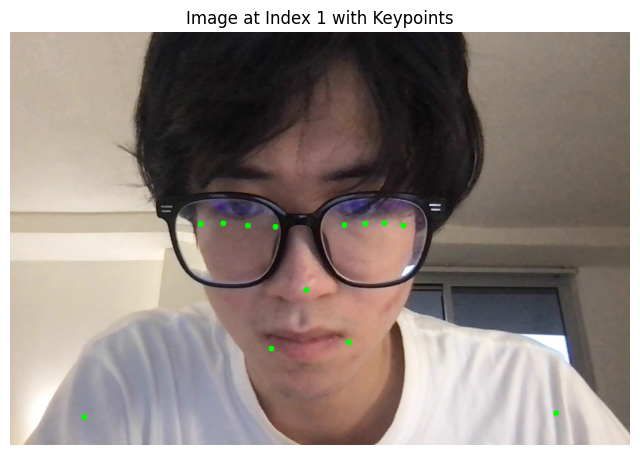

In [69]:
import matplotlib.pyplot as plt
import cv2
import numpy as np

def draw_keypoints_on_image(images, keypoints_list, index):
    """
    Draws predicted keypoints on the image at the specified index.

    Args:
    - images (list): List of PIL Image objects.
    - keypoints_list (list): List of keypoints for each image. Each element is a list of [x, y, z] keypoints.
    - index (int): Index of the image to draw keypoints on.

    Returns:
    None
    """
    if index < 0 or index >= len(images):
        print("Index out of range. Please provide a valid index.")
        return

    image = np.array(images[index])  # Convert PIL Image to numpy array
    keypoints = keypoints_list[index]

    image_bgr = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)

    for keypoint in keypoints:
        x, y, z = keypoint
        if x != 0 and y != 0:  # Skip if keypoint is [0, 0, 0]
            cv2.circle(image_bgr, (int(x), int(y)), radius=5, color=(0, 255, 0), thickness=-1)

    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(8, 8))
    plt.imshow(image_rgb)
    plt.axis("off")
    plt.title(f"Image at Index {index} with Keypoints")
    plt.show()

draw_keypoints_on_image(images, results_forward[-11:], 1)  # Replace '5' with the desired index


In [74]:
for i in range(3):
    print(f"Keypoint {i} type: {type(results_forward[i])}")
    print(f"Keypoint {i} shape/len: {np.shape(results_forward[i]) if isinstance(results_forward[i], np.ndarray) else len(results_forward[i])}")
    print(f"Keypoint {i} data: {results_forward[i]}\n")

Keypoint 0 type: <class 'list'>
Keypoint 0 shape/len: 0
Keypoint 0 data: []

Keypoint 1 type: <class 'list'>
Keypoint 1 shape/len: 33
Keypoint 1 data: [[458.85279178619385, 493.5075330734253, -1.5124504566192627], [518.9544010162354, 361.1637783050537, -1.4586881399154663], [560.1117396354675, 350.3157448768616, -1.4599939584732056], [591.4102864265442, 342.0261311531067, -1.4598335027694702], [398.53981375694275, 375.5417490005493, -1.435579538345337], [356.96353554725647, 373.4156370162964, -1.4379369020462036], [321.5355885028839, 369.6288728713989, -1.439437747001648], [641.6268396377563, 325.053927898407, -0.8870963454246521], [296.31115078926086, 351.0434818267822, -0.7806410193443298], [540.0435161590576, 572.2134590148926, -1.2570151090621948], [410.7398843765259, 579.9273204803467, -1.2390475273132324], [921.7227172851562, 666.8015813827515, -0.5076673626899719], [129.48950082063675, 677.3738193511963, -0.3339107036590576], [0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0], [0, 0, 0]

In [24]:
import json

def save_keypoints(results, save_path):
    """
    Save keypoints results handling empty lists and 33x3 keypoints
    """
    os.makedirs(save_path, exist_ok=True)
    json_serializable_results = []

    for keypoint in results:
        if len(keypoint) == 0:
            # Empty list of keypoints
            json_serializable_results.append([])  
        else:
            # Convert NumPy array (if any) to Python list
            # or assume keypoint is already a Python list of floats
            # If it's guaranteed to be a NumPy array, you can do:
            json_serializable_results.append(np.array(keypoint).tolist())

            
    # Save raw format as JSON
    with open(os.path.join(save_path, 'keypoints_img_coord.json'), 'w') as f:
         json.dump(json_serializable_results, f, indent=4)
    
    # Convert to numpy with consistent shape (N, 33, 3)
    uniform_results = []
    for keypoint in results:
        if len(keypoint) == 0:  # Empty list
            uniform_results.append(np.zeros((33, 3)))
        else:
            uniform_results.append(np.array(keypoint))
    
    keypoints_array = np.array(uniform_results)
    np.save(os.path.join(save_path, 'keypoints_img_coord.npy'), keypoints_array)
    
    print(f"Saved {len(results)} keypoints with shape {keypoints_array.shape}")

keypoints_path = "../keypoints/"
# Usage in main code:
save_path = os.path.join(keypoints_path, "forward_keypoints")
save_keypoints(results_forward, save_path)

Saved 6231 keypoints with shape (6231, 33, 3)


In [90]:
# Testing the function
data_path = "../../AI System Data/Backwards/frames"
image_files = [f for f in os.listdir(data_path) if os.path.isfile(os.path.join(data_path, f))]
batch_size = 20
counter = 0
results_backwards = []
model = None
# Initialize the model
initialize_model()

for i in range(len(image_files) // batch_size):
    # Load a batch of images
    images = [Image.open(os.path.join(data_path, image_file)) for image_file in image_files[counter:counter + batch_size]]
    
    # Perform posture detection on the batch
    batch_results = postureDetect(images)
    
    # Append batch results to the main results list
    results_backwards.extend(batch_results)

    # Print keypoints results for the current batch
    for idx, keypoints in enumerate(batch_results):
        print(f"Image {counter + idx}: Keypoints - {keypoints}")
    
    counter += batch_size

# Process remaining images
images = [Image.open(os.path.join(data_path, image_file)) for image_file in image_files[counter:]]
if images:
    batch_results = postureDetect(images)
    results_backwards.extend(batch_results)

#     # Print keypoints for remaining images
    for idx, keypoints in enumerate(batch_results):
        print(f"Image {counter + idx}: Keypoints - {keypoints}")
# 
# # Print final keypoints results
# for idx, keypoints in enumerate(results_backwards):
#     print(f"Image {idx}: Keypoints - {keypoints}")

Image 0: Keypoints - [[0.4681685268878937, 0.7625836133956909, -0.411825954914093], [0.4982684552669525, 0.6899054646492004, -0.3645061254501343], [0.5125200748443604, 0.6913266181945801, -0.36493128538131714], [0.5242316722869873, 0.6934058666229248, -0.3647163212299347], [0.44083669781684875, 0.6795787215232849, -0.3615879416465759], [0.4256250560283661, 0.677226722240448, -0.36215144395828247], [0.4130527675151825, 0.6756970882415771, -0.3625178635120392], [0.5431787967681885, 0.7096526622772217, -0.11823661625385284], [0.3913162350654602, 0.6798813343048096, -0.11039984226226807], [0.49666571617126465, 0.817071795463562, -0.3154473304748535], [0.43672168254852295, 0.8166399002075195, -0.3167255222797394], [0.6357117891311646, 0.9727411270141602, 0.01369467657059431], [0.31484007835388184, 0.9521872401237488, -0.052432045340538025], [nan, nan, nan], [nan, nan, nan], [0.6670277118682861, 0.8117147088050842, -0.1832411140203476], [0.3037067651748657, 0.7213621139526367, -0.49081590771

Image 20: Keypoints - [[0.5367206335067749, 0.6431360840797424, -0.010138276033103466], [0.5405367612838745, 0.637794554233551, -0.0190489050000906], [0.5414376854896545, 0.6380318999290466, -0.01909189112484455], [0.5422781705856323, 0.6384520530700684, -0.01910100132226944], [0.5397287011146545, 0.6375038623809814, -0.006347012706100941], [0.5399783849716187, 0.6377969980239868, -0.006480868440121412], [0.5402489900588989, 0.6380138397216797, -0.0065761953592300415], [0.5492867827415466, 0.6434419751167297, -0.04086880013346672], [0.5466192960739136, 0.6420880556106567, 0.017038242891430855], [0.5396155118942261, 0.6496484875679016, -0.015519397333264351], [0.5385801792144775, 0.6498377323150635, 0.0007746233022771776], [0.5531354546546936, 0.6736446022987366, -0.06700057536363602], [0.5516786575317383, 0.658926248550415, 0.04826834425330162], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 40: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 41: Keypoints - [[0.4497145414352417, 0.4885028302669525, -0.5261540412902832], [0.46545034646987915, 0.44063955545425415, -0.4985177516937256], [0.47860148549079895, 0.4424249529838562, -0.4989570379257202], [0.49017634987831116, 0.4439089894294739, -0.4989038109779358], [0.42773380875587463, 0.4371582269668579, -0.49648985266685486], [0.4142646789550781, 0.4375355839729309, -0.4970965087413788], [0.4037124216556549, 0.4384358525276184, -0.49751394987106323], [0.50662553

Image 60: Keypoints - [[0.4714517593383789, 0.4803639054298401, -0.5284718871116638], [0.4956223964691162, 0.4339834451675415, -0.49553462862968445], [0.5071473121643066, 0.4371582865715027, -0.495960533618927], [0.5213735699653625, 0.4401336908340454, -0.4957984685897827], [0.4534377157688141, 0.4265124797821045, -0.4877191185951233], [0.44185522198677063, 0.4269184470176697, -0.488462895154953], [0.4310470521450043, 0.4282231330871582, -0.4889250695705414], [0.5445632934570312, 0.46150386333465576, -0.28651171922683716], [0.41759949922561646, 0.45665329694747925, -0.25304585695266724], [0.5028607249259949, 0.534589946269989, -0.44256943464279175], [0.4480268061161041, 0.5353940725326538, -0.4372234344482422], [0.6559290289878845, 0.7628517746925354, -0.20645201206207275], [0.308466374874115, 0.7613881826400757, -0.137716144323349], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 80: Keypoints - [[0.5459165573120117, 0.5974807143211365, -0.29171741008758545], [0.548652708530426, 0.595179557800293, -0.30379489064216614], [0.5482712388038635, 0.5955539345741272, -0.3039134442806244], [0.5478323101997375, 0.5962821841239929, -0.30389127135276794], [0.5503438711166382, 0.5955281257629395, -0.29841575026512146], [0.5513383150100708, 0.596578061580658, -0.29859524965286255], [0.5523237586021423, 0.5974656939506531, -0.2986967861652374], [0.5485406517982483, 0.607526421546936, -0.301347941160202], [0.5555247068405151, 0.609125018119812, -0.2760225236415863], [0.5441126227378845, 0.6057984828948975, -0.28387966752052307], [0.5461342930793762, 0.606757640838623, -0.27741366624832153], [0.535854160785675, 0.6316362023353577, -0.26082372665405273], [0.5634569525718689, 0.6376137733459473, -0.22435051202774048], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 100: Keypoints - [[0.46302586793899536, 0.4780341684818268, -0.5198133587837219], [0.4829626679420471, 0.4285622835159302, -0.4893185794353485], [0.49643808603286743, 0.431448757648468, -0.4897293150424957], [0.5088596940040588, 0.4354686737060547, -0.4896787405014038], [0.44113361835479736, 0.42584484815597534, -0.48255425691604614], [0.4291531443595886, 0.42664992809295654, -0.48315587639808655], [0.41839009523391724, 0.42746466398239136, -0.48354479670524597], [0.5336230397224426, 0.4583466053009033, -0.308626264333725], [0.4025490880012512, 0.45223289728164673, -0.27791666984558105], [0.4925917983055115, 0.5356360673904419, -0.44679322838783264], [0.4377395212650299, 0.5349876880645752, -0.44109079241752625], [0.6305652856826782, 0.7508227825164795, -0.25677523016929626], [0.2897876501083374, 0.7629858255386353, -0.16838282346725464], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, n

Image 120: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 121: Keypoints - [[0.5014469623565674, 0.7039917707443237, -0.8251694440841675], [0.5384935140609741, 0.6687438488006592, -0.818627119064331], [0.5493056178092957, 0.6726586818695068, -0.8190625309944153], [0.5574543476104736, 0.6778700947761536, -0.8189486265182495], [0.4958336651325226, 0.6460235714912415, -0.8174068927764893], [0.4825756549835205, 0.6343486905097961, -0.8179783821105957], [0.4732936918735504, 0.6255671977996826, -0.8184323906898499], [0.57206046581268

Image 140: Keypoints - [[0.49225935339927673, 0.663827657699585, -0.6496251821517944], [0.5107026100158691, 0.6205773949623108, -0.617958664894104], [0.5207386612892151, 0.6160672903060913, -0.6182868480682373], [0.5279631614685059, 0.6161577701568604, -0.618249237537384], [0.4767848551273346, 0.6326284408569336, -0.6196786761283875], [0.46394914388656616, 0.6349010467529297, -0.6199825406074524], [0.45443692803382874, 0.6392009258270264, -0.6201810836791992], [0.5506137609481812, 0.6355406045913696, -0.4419601857662201], [0.4362758994102478, 0.6548751592636108, -0.45238009095191956], [0.5123772621154785, 0.7156257629394531, -0.5830188989639282], [0.47258177399635315, 0.7203619480133057, -0.5871798992156982], [0.5628948211669922, 0.801875114440918, -0.36447545886039734], [0.44371098279953003, 0.8050934076309204, -0.37083056569099426], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 160: Keypoints - [[0.5763428211212158, 0.8582459092140198, 0.003999276086688042], [0.5765929222106934, 0.8559516668319702, 0.00849199015647173], [0.5768381357192993, 0.8562349677085876, 0.008421631529927254], [0.5771548748016357, 0.8566713333129883, 0.008441650308668613], [0.5749891400337219, 0.8551376461982727, 0.003159003797918558], [0.5742897391319275, 0.8548203110694885, 0.0030800336971879005], [0.5735386610031128, 0.85442715883255, 0.0030340563971549273], [0.5748723149299622, 0.8579605221748352, 0.028252219781279564], [0.5696338415145874, 0.85526442527771, 0.003686383832246065], [0.5753502249717712, 0.8622044324874878, 0.012326691299676895], [0.5738555192947388, 0.8607699871063232, 0.004654092248529196], [0.5730757117271423, 0.8691904544830322, 0.04047008976340294], [0.5608498454093933, 0.8689019680023193, -0.003931829705834389], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, 

Image 180: Keypoints - [[0.545538067817688, 0.6380104422569275, -0.12879201769828796], [0.5483541488647461, 0.6347284913063049, -0.1405622512102127], [0.5486454367637634, 0.6346407532691956, -0.14061154425144196], [0.5488482117652893, 0.6347218751907349, -0.14059431850910187], [0.5485665202140808, 0.6359877586364746, -0.1319608837366104], [0.5490049719810486, 0.6371799111366272, -0.13209551572799683], [0.5494739413261414, 0.6382945775985718, -0.13218294084072113], [0.5521641969680786, 0.6429147124290466, -0.16155704855918884], [0.5536680817604065, 0.6479828357696533, -0.12162082642316818], [0.5462488532066345, 0.6450343728065491, -0.1319325864315033], [0.5462942123413086, 0.6471997499465942, -0.1208842322230339], [0.542883574962616, 0.6714665293693542, -0.1506262719631195], [0.5616286993026733, 0.6763579845428467, -0.08101634681224823], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 200: Keypoints - [[0.4523835778236389, 0.7590152025222778, -0.8484463095664978], [0.4852345287799835, 0.7089788913726807, -0.7978321313858032], [0.49900954961776733, 0.7099682092666626, -0.7982657551765442], [0.5105785727500916, 0.7124611139297485, -0.7981655597686768], [0.4361802339553833, 0.7038028240203857, -0.8011329770088196], [0.4248976409435272, 0.6999560594558716, -0.8015692234039307], [0.4126546084880829, 0.6957631707191467, -0.8019337058067322], [0.5382532477378845, 0.7234744429588318, -0.5306010246276855], [0.38767629861831665, 0.6927649974822998, -0.550162136554718], [0.4813118278980255, 0.809561014175415, -0.7458261847496033], [0.4315407872200012, 0.8026424646377563, -0.7538313865661621], [0.5949287414550781, 0.8715127110481262, -0.38369399309158325], [0.32506150007247925, 0.8587909936904907, -0.4407433271408081], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 220: Keypoints - [[0.5215890407562256, 0.5458651781082153, -0.4194358289241791], [0.5434749722480774, 0.5289737582206726, -0.41127464175224304], [0.5521533489227295, 0.5305889844894409, -0.4114639163017273], [0.5588674545288086, 0.5328776836395264, -0.4113437831401825], [0.5138600468635559, 0.5290725231170654, -0.40652233362197876], [0.5051711201667786, 0.532402753829956, -0.40681570768356323], [0.49824798107147217, 0.530601978302002, -0.4069935381412506], [0.574298620223999, 0.5336569547653198, -0.31791600584983826], [0.48723968863487244, 0.5235263109207153, -0.29786285758018494], [0.5350258350372314, 0.5742834806442261, -0.37860363721847534], [0.5170495510101318, 0.593307375907898, -0.37413132190704346], [0.578281044960022, 0.6056427955627441, -0.22833959758281708], [0.4911614656448364, 0.5722174048423767, -0.2233106642961502], [nan, nan, nan], [0.4932110905647278, 0.5441974401473999, -0.19138206541538239], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 240: Keypoints - [[0.5565198659896851, 0.568536639213562, -0.4313720464706421], [0.5689476132392883, 0.5427407026290894, -0.4189753830432892], [0.5774114727973938, 0.542129397392273, -0.4192022681236267], [0.5837468504905701, 0.5422488451004028, -0.41911131143569946], [0.5390956997871399, 0.5439428091049194, -0.4211445748806], [0.5298327207565308, 0.5456784963607788, -0.4214201867580414], [0.5228641629219055, 0.5466457605361938, -0.42156508564949036], [0.5940101146697998, 0.5413798093795776, -0.31125423312187195], [0.5038979649543762, 0.5457092523574829, -0.32110902667045593], [0.5762792229652405, 0.6028611063957214, -0.3855957090854645], [0.542451024055481, 0.5912888646125793, -0.38995105028152466], [0.6032149791717529, 0.6127479076385498, -0.23642735183238983], [0.49765273928642273, 0.5749310255050659, -0.2472362071275711], [0.6365249752998352, 0.6073254942893982, -0.24779169261455536], [0.48890000581741333, 0.5138450860977173, -0.26405981183052063], [nan, nan, nan], [nan, nan,

Image 260: Keypoints - [[0.45920470356941223, 0.4585071802139282, -0.9791686534881592], [0.4818556308746338, 0.4103531241416931, -0.9498642683029175], [0.4954688549041748, 0.4114515781402588, -0.9504043459892273], [0.5070399045944214, 0.4143848419189453, -0.950354278087616], [0.4361334443092346, 0.4061511754989624, -0.9407670497894287], [0.42161405086517334, 0.4071597456932068, -0.9413699507713318], [0.4086931645870209, 0.41061562299728394, -0.941852867603302], [0.5407330989837646, 0.43914633989334106, -0.7337716817855835], [0.3938155472278595, 0.4374675750732422, -0.6920250654220581], [0.49112406373023987, 0.525355339050293, -0.8911323547363281], [0.4306756556034088, 0.5294743776321411, -0.8823221921920776], [0.6476544141769409, 0.749467134475708, -0.6176460981369019], [0.27183544635772705, 0.7698670625686646, -0.5150606632232666], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 280: Keypoints - [[0.5338508486747742, 0.663369357585907, -0.7491138577461243], [0.5506172180175781, 0.6245192885398865, -0.7030998468399048], [0.5642067790031433, 0.6225094199180603, -0.703426718711853], [0.5755796432495117, 0.6243115067481995, -0.7033591866493225], [0.5101942420005798, 0.6244879961013794, -0.7081928849220276], [0.4982958436012268, 0.6251200437545776, -0.7084866166114807], [0.48957663774490356, 0.6294107437133789, -0.7085947394371033], [0.5911483764648438, 0.6438992023468018, -0.45834478735923767], [0.47174662351608276, 0.6552384495735168, -0.48454874753952026], [0.5612044334411621, 0.7258214950561523, -0.6572003364562988], [0.508659839630127, 0.7326056361198425, -0.6669479012489319], [0.6051106452941895, 0.8368978500366211, -0.34755825996398926], [0.44310101866722107, 0.8542084693908691, -0.36093801259994507], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [0.39861127734184265, 1.14187490940094, -0.860431969165802], [nan, nan, nan], [0.3763430714607239, 1.1

Image 300: Keypoints - [[0.6208813190460205, 0.6060341000556946, -0.3357737958431244], [0.6378346085548401, 0.609973132610321, -0.33904024958610535], [0.6405625343322754, 0.6160061359405518, -0.3391929864883423], [0.6429692506790161, 0.6221926212310791, -0.33912986516952515], [0.632392942905426, 0.5969938039779663, -0.33450233936309814], [0.630811333656311, 0.5926710963249207, -0.3347913920879364], [0.6292811036109924, 0.5883336067199707, -0.3349430561065674], [0.644618034362793, 0.6427132487297058, -0.3004889488220215], [0.6274566054344177, 0.5987508296966553, -0.27925190329551697], [0.6166543960571289, 0.628516674041748, -0.31326091289520264], [0.6095028519630432, 0.6104743480682373, -0.308550626039505], [0.6054253578186035, 0.6488025188446045, -0.23492875695228577], [0.6036659479141235, 0.6682987213134766, -0.22346241772174835], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 320: Keypoints - [[0.48884692788124084, 0.47548216581344604, -0.670158863067627], [0.5202057361602783, 0.4249866008758545, -0.6303579807281494], [0.5333384275436401, 0.42716073989868164, -0.6307686567306519], [0.5454872846603394, 0.42966198921203613, -0.6306006908416748], [0.4782203137874603, 0.42122483253479004, -0.6178354024887085], [0.46764570474624634, 0.42243367433547974, -0.6183691620826721], [0.4563857614994049, 0.424111545085907, -0.6188212037086487], [0.5753288269042969, 0.4498191475868225, -0.3957228362560272], [0.45059871673583984, 0.44414108991622925, -0.33905860781669617], [0.5250560641288757, 0.5275439620018005, -0.5770694613456726], [0.47148942947387695, 0.5269133448600769, -0.5641183853149414], [0.6869367361068726, 0.7396295666694641, -0.28824567794799805], [0.342648983001709, 0.7620062828063965, -0.20804645121097565], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, 

Image 340: Keypoints - [[0.4620305597782135, 0.47839948534965515, -0.5299909114837646], [0.4820559620857239, 0.4318224787712097, -0.50089031457901], [0.4950193166732788, 0.43379873037338257, -0.5013271570205688], [0.5051270723342896, 0.4364326596260071, -0.5012379288673401], [0.4413856863975525, 0.4274902939796448, -0.49410656094551086], [0.42904794216156006, 0.4278554916381836, -0.49467626214027405], [0.41757845878601074, 0.42821818590164185, -0.4950876533985138], [0.5298237204551697, 0.4560808539390564, -0.32197412848472595], [0.4043867290019989, 0.44992053508758545, -0.2913535237312317], [0.4909723103046417, 0.5349897146224976, -0.4570915699005127], [0.4352775812149048, 0.534298837184906, -0.45150455832481384], [0.634572446346283, 0.7457627058029175, -0.25966528058052063], [0.2898991107940674, 0.7584160566329956, -0.19272148609161377], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 360: Keypoints - [[0.5399927496910095, 0.6648343801498413, -0.8290193676948547], [0.558853268623352, 0.6273155808448792, -0.7901843786239624], [0.5710702538490295, 0.6266414523124695, -0.7904840707778931], [0.5801903009414673, 0.6284617185592651, -0.7903581857681274], [0.5159087181091309, 0.6269722580909729, -0.7918354272842407], [0.5037100315093994, 0.6288231015205383, -0.7920836210250854], [0.4956203103065491, 0.6349498629570007, -0.7922027707099915], [0.5966953039169312, 0.653581440448761, -0.5542718172073364], [0.4815879762172699, 0.6643495559692383, -0.5656462907791138], [0.5619285106658936, 0.7300409078598022, -0.7371744513511658], [0.5186651945114136, 0.7340298295021057, -0.7425857782363892], [0.6232810616493225, 0.8219955563545227, -0.4159401059150696], [0.4474206864833832, 0.839331328868866, -0.39881467819213867], [0.6840494871139526, 1.0186268091201782, -0.5520185232162476], [0.39515218138694763, 1.0732558965682983, -0.554150402545929], [nan, nan, nan], [nan, nan, nan],

Image 380: Keypoints - [[0.4739390015602112, 0.7545558214187622, -0.7012078166007996], [0.48487532138824463, 0.7218191623687744, -0.684712290763855], [0.49361154437065125, 0.7201040387153625, -0.6850283741950989], [0.5023383498191833, 0.7189226150512695, -0.6849777698516846], [0.4598543643951416, 0.7219018936157227, -0.6939162015914917], [0.45066431164741516, 0.7206544876098633, -0.6942028999328613], [0.44150927662849426, 0.7192938327789307, -0.69440096616745], [0.5112385153770447, 0.7124878168106079, -0.5326316952705383], [0.42459723353385925, 0.713700532913208, -0.5748124718666077], [0.4868220090866089, 0.7711070775985718, -0.6361591219902039], [0.4577876329421997, 0.7715132236480713, -0.6496454477310181], [0.5364053845405579, 0.7595401406288147, -0.415618896484375], [0.3852919638156891, 0.7581943273544312, -0.4793073236942291], [0.5681583285331726, 0.838089644908905, -0.45545780658721924], [0.33778315782546997, 0.8389767408370972, -0.5868967771530151], [nan, nan, nan], [nan, nan, na

Image 400: Keypoints - [[0.46641233563423157, 0.7341712713241577, -1.1673836708068848], [0.4916386306285858, 0.6861903667449951, -1.1659728288650513], [0.5032094120979309, 0.6847047209739685, -1.1664316654205322], [0.5118324756622314, 0.6825645565986633, -1.1663168668746948], [0.45014727115631104, 0.683761715888977, -1.1656241416931152], [0.43864569067955017, 0.6774433851242065, -1.1662490367889404], [0.42934754490852356, 0.6731652021408081, -1.1667981147766113], [0.5278409719467163, 0.6677653789520264, -0.9906817674636841], [0.4078911542892456, 0.6565576791763306, -0.9933567643165588], [0.4873962998390198, 0.7666324377059937, -1.08207368850708], [0.4415278732776642, 0.7621682286262512, -1.0855188369750977], [0.5908104777336121, 0.730952262878418, -0.7513829469680786], [0.32214152812957764, 0.7050642967224121, -0.777828574180603], [nan, nan, nan], [0.2061329185962677, 0.7781949639320374, -0.6245626211166382], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan

Image 420: Keypoints - [[0.49685609340667725, 0.4790878891944885, -0.7233099341392517], [0.5184957385063171, 0.43411749601364136, -0.6856674551963806], [0.5320103764533997, 0.4352337718009949, -0.6860701441764832], [0.5422218441963196, 0.4371030926704407, -0.6859405636787415], [0.47848957777023315, 0.43113088607788086, -0.6755625605583191], [0.4673127830028534, 0.43134647607803345, -0.6760905981063843], [0.45768171548843384, 0.4305909276008606, -0.6764906048774719], [0.569060206413269, 0.4582754373550415, -0.45643356442451477], [0.4420218765735626, 0.45522868633270264, -0.41032856702804565], [0.5271316170692444, 0.5363961458206177, -0.6314324140548706], [0.47612646222114563, 0.5355622172355652, -0.6212813258171082], [0.6726595759391785, 0.740333080291748, -0.34021878242492676], [0.3337832987308502, 0.7662360072135925, -0.26742151379585266], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, 

Image 440: Keypoints - [[0.4616204500198364, 0.7837145328521729, -1.0298160314559937], [0.48664987087249756, 0.7359302043914795, -1.015342354774475], [0.49642565846443176, 0.7344971299171448, -1.0157318115234375], [0.5041984915733337, 0.7336801886558533, -1.0155811309814453], [0.44464361667633057, 0.7301279902458191, -1.0209029912948608], [0.43212011456489563, 0.729155421257019, -1.0212726593017578], [0.42458733916282654, 0.7250428199768066, -1.021653652191162], [0.5284452438354492, 0.7255719304084778, -0.8218356966972351], [0.4081001877784729, 0.6999363899230957, -0.8450341820716858], [0.48204344511032104, 0.8099644184112549, -0.9422438144683838], [0.440972238779068, 0.7997850775718689, -0.9511097073554993], [0.5748259425163269, 0.762024462223053, -0.6248728036880493], [0.3631211817264557, 0.7357856035232544, -0.6691275835037231], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 460: Keypoints - [[0.4625568389892578, 0.4808354675769806, -0.5372337102890015], [0.4832201600074768, 0.43264901638031006, -0.5112418532371521], [0.4979790449142456, 0.43352627754211426, -0.5116980671882629], [0.5082372426986694, 0.4362213611602783, -0.5116134881973267], [0.44520431756973267, 0.4297717213630676, -0.5038368105888367], [0.4318094253540039, 0.42861855030059814, -0.5045148134231567], [0.4219801425933838, 0.4268300533294678, -0.5049301385879517], [0.5338709950447083, 0.4553337097167969, -0.3325628340244293], [0.4031405746936798, 0.44732266664505005, -0.301052063703537], [0.49145248532295227, 0.5365899205207825, -0.4626651406288147], [0.4394221305847168, 0.5361287593841553, -0.4573743939399719], [0.6347282528877258, 0.7495425343513489, -0.2657090723514557], [0.2908669114112854, 0.7585669755935669, -0.1836070865392685], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 480: Keypoints - [[0.4550437927246094, 0.45972245931625366, -0.7912169098854065], [0.4781736135482788, 0.4054046869277954, -0.744077205657959], [0.49481019377708435, 0.4062005877494812, -0.7445638179779053], [0.5053601264953613, 0.40745842456817627, -0.7444023489952087], [0.4360649585723877, 0.40330421924591064, -0.7361270189285278], [0.4222227931022644, 0.4043218493461609, -0.7367689609527588], [0.4118537902832031, 0.4049209952354431, -0.7372917532920837], [0.537479043006897, 0.42798781394958496, -0.45662420988082886], [0.39567461609840393, 0.42911994457244873, -0.4229613244533539], [0.49052929878234863, 0.5140071511268616, -0.6762597560882568], [0.43334633111953735, 0.5184770822525024, -0.6706535220146179], [0.6578690409660339, 0.7409270405769348, -0.3092786371707916], [0.27040737867355347, 0.7709755301475525, -0.2556929290294647], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, n

Image 500: Keypoints - [[0.4931107461452484, 0.6642699241638184, -0.49855393171310425], [0.5130026340484619, 0.620194673538208, -0.44820237159729004], [0.5249773263931274, 0.620287299156189, -0.4484825134277344], [0.5352028012275696, 0.6221349239349365, -0.4483834207057953], [0.4742349088191986, 0.6224088072776794, -0.4531846046447754], [0.46192556619644165, 0.6245945692062378, -0.4534188210964203], [0.45056262612342834, 0.6307536363601685, -0.45354899764060974], [0.5529330372810364, 0.6525318622589111, -0.2101147621870041], [0.43163543939590454, 0.6666816473007202, -0.2335406094789505], [0.5210282206535339, 0.7287833094596863, -0.4103129506111145], [0.4706808924674988, 0.7336267828941345, -0.41909176111221313], [0.5972287654876709, 0.8869397640228271, -0.10869269073009491], [0.39869236946105957, 0.8647655248641968, -0.18432995676994324], [nan, nan, nan], [nan, nan, nan], [0.6620761752128601, 1.0149927139282227, -0.7714591026306152], [0.38816219568252563, 1.0022318363189697, -0.8065527

Image 520: Keypoints - [[0.49642592668533325, 0.686374843120575, -0.9710835814476013], [0.523293137550354, 0.6693081855773926, -0.9889808893203735], [0.5322359800338745, 0.6747456789016724, -0.9893467426300049], [0.5409178137779236, 0.6809607744216919, -0.9892928600311279], [0.5004878640174866, 0.6468969583511353, -0.9947048425674438], [0.49368399381637573, 0.637762725353241, -0.9951279163360596], [0.4868197441101074, 0.6284818053245544, -0.9956846833229065], [0.5614793300628662, 0.674053430557251, -0.8690780997276306], [0.48220741748809814, 0.5963559746742249, -0.8949623703956604], [0.505557656288147, 0.7022963762283325, -0.9004637002944946], [0.48029112815856934, 0.6779009103775024, -0.9097289443016052], [0.5945226550102234, 0.6952499747276306, -0.6383582949638367], [0.4407450556755066, 0.5534143447875977, -0.7035523056983948], [nan, nan, nan], [0.46031829714775085, 0.4271717369556427, -0.48134681582450867], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, na

Image 540: Keypoints - [[0.45994120836257935, 0.48323556780815125, -0.47201067209243774], [0.4786202013492584, 0.4347802996635437, -0.4437898099422455], [0.4934667646884918, 0.43494707345962524, -0.44423696398735046], [0.5034462809562683, 0.43627631664276123, -0.4441583454608917], [0.4437292814254761, 0.4340478181838989, -0.4401578903198242], [0.42971959710121155, 0.4341299533843994, -0.44084692001342773], [0.4204743802547455, 0.43340808153152466, -0.4412841796875], [0.5275465846061707, 0.45343899726867676, -0.25702720880508423], [0.4010674059391022, 0.4514116644859314, -0.24154803156852722], [0.48905062675476074, 0.5342374444007874, -0.39432021975517273], [0.43687087297439575, 0.5341687798500061, -0.393921434879303], [0.6307631731033325, 0.7452038526535034, -0.19373153150081635], [0.28665614128112793, 0.754894495010376, -0.13478301465511322], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, na

Image 560: Keypoints - [[0.5448129773139954, 0.6559805274009705, -0.42287713289260864], [0.5644172430038452, 0.6150888800621033, -0.3758242130279541], [0.5764188170433044, 0.6170784831047058, -0.3761155903339386], [0.5884403586387634, 0.6220525503158569, -0.37598150968551636], [0.5256626605987549, 0.6141223907470703, -0.37446510791778564], [0.513648509979248, 0.614361047744751, -0.37481018900871277], [0.5022779107093811, 0.6169992089271545, -0.3750457465648651], [0.6087623834609985, 0.6539032459259033, -0.15998299419879913], [0.4830555021762848, 0.6513573527336121, -0.15477266907691956], [0.5721193552017212, 0.7248709797859192, -0.34381744265556335], [0.5177424550056458, 0.7257101535797119, -0.34502312541007996], [0.6764084100723267, 0.9381086826324463, -0.09432907402515411], [0.40394896268844604, 0.9466537237167358, -0.09189563989639282], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, n

Image 580: Keypoints - [[0.4540855884552002, 0.7673251032829285, -0.46227166056632996], [0.48753389716148376, 0.7033613324165344, -0.41795969009399414], [0.5022375583648682, 0.7057299017906189, -0.418350487947464], [0.5133400559425354, 0.7092161178588867, -0.41821232438087463], [0.4383428394794464, 0.7021979689598083, -0.415365606546402], [0.42565396428108215, 0.7029982209205627, -0.415850430727005], [0.41475626826286316, 0.7034196853637695, -0.4161406457424164], [0.5389368534088135, 0.7197436690330505, -0.199443057179451], [0.39083659648895264, 0.706384003162384, -0.19048982858657837], [0.4856588840484619, 0.8180030584335327, -0.37870103120803833], [0.4292754530906677, 0.8202372789382935, -0.3793589770793915], [0.6134364008903503, 0.9632327556610107, -0.10365256667137146], [0.3126748502254486, 0.950183093547821, -0.14582665264606476], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 600: Keypoints - [[0.5442231893539429, 0.646849513053894, -0.3347489535808563], [0.5657050013542175, 0.6092671155929565, -0.29214614629745483], [0.5775235891342163, 0.6102614998817444, -0.2924492061138153], [0.5878620743751526, 0.6134968996047974, -0.29232168197631836], [0.5263984799385071, 0.6098511219024658, -0.2910425662994385], [0.5142161250114441, 0.6103904247283936, -0.29132986068725586], [0.5038643479347229, 0.6146399974822998, -0.29148998856544495], [0.6083875894546509, 0.6531418561935425, -0.09681374579668045], [0.48338064551353455, 0.6508287191390991, -0.09354480355978012], [0.5740715265274048, 0.7176460027694702, -0.26170656085014343], [0.5216798782348633, 0.7194163203239441, -0.2634011507034302], [0.6583787202835083, 0.9110735654830933, -0.02950042486190796], [0.4255543351173401, 0.9145011305809021, -0.031142959371209145], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [0.4326649606227875, 1.0349704027175903, -0.40896135568618774]

Image 620: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 621: Keypoints - [[0.5564766526222229, 0.6184743046760559, -0.8386355042457581], [0.5769173502922058, 0.5677834153175354, -0.8204147815704346], [0.5898718237876892, 0.5700397491455078, -0.8208534121513367], [0.5994535088539124, 0.5713777542114258, -0.8208418488502502], [0.5420793890953064, 0.5564596652984619, -0.8184207677841187], [0.5317684412002563, 0.551823079586029, -0.8189364075660706], [0.5228789448738098, 0.5474820137023926, -0.8193290829658508], [0.61513680219650

Image 640: Keypoints - [[0.47688356041908264, 0.7135331630706787, -1.2058923244476318], [0.4908093512058258, 0.6654638648033142, -1.2122528553009033], [0.5001603364944458, 0.661758303642273, -1.2127605676651], [0.5064645409584045, 0.6586084365844727, -1.2128530740737915], [0.4587421715259552, 0.6683794856071472, -1.2204703092575073], [0.44837749004364014, 0.6660887598991394, -1.220914602279663], [0.43903928995132446, 0.6576587557792664, -1.22146475315094], [0.5160080194473267, 0.6349219083786011, -1.0451173782348633], [0.42288273572921753, 0.6368829011917114, -1.0841102600097656], [0.49128812551498413, 0.7266812920570374, -1.1202037334442139], [0.45312434434890747, 0.7327733635902405, -1.133409857749939], [0.5727089047431946, 0.6743736267089844, -0.8031068444252014], [0.33764535188674927, 0.6910749673843384, -0.8734753131866455], [0.6759393215179443, 0.6695812940597534, -0.5470031499862671], [0.2702864706516266, 0.6653777360916138, -0.7628350853919983], [nan, nan, nan], [nan, nan, nan]

Image 660: Keypoints - [[0.4393021762371063, 0.5373807549476624, -0.6285291314125061], [0.4572083652019501, 0.45906364917755127, -0.6214014291763306], [0.4744538366794586, 0.4520111083984375, -0.6218565106391907], [0.4891541004180908, 0.4464591145515442, -0.621735692024231], [0.41282981634140015, 0.47314733266830444, -0.6040319204330444], [0.3989248275756836, 0.4751160144805908, -0.6049439311027527], [0.386819064617157, 0.47600823640823364, -0.605399489402771], [0.5185239315032959, 0.4398253560066223, -0.4563814699649811], [0.3786505162715912, 0.4788244962692261, -0.37441372871398926], [0.47849589586257935, 0.5731818675994873, -0.5492373704910278], [0.4263727068901062, 0.5975692868232727, -0.5302355289459229], [0.6696692705154419, 0.7050884962081909, -0.3373911380767822], [0.2876442074775696, 0.7287874817848206, -0.22758807241916656], [0.807956337928772, 0.9769341349601746, -0.4261573255062103], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 680: Keypoints - [[0.6337437033653259, 0.6042822599411011, -0.28370213508605957], [0.6512126922607422, 0.6090633273124695, -0.287026584148407], [0.6537660956382751, 0.6149886250495911, -0.2871920168399811], [0.6560137271881104, 0.6211280822753906, -0.2871397137641907], [0.6461828351020813, 0.5964877605438232, -0.283586323261261], [0.6447935104370117, 0.5925323963165283, -0.28392651677131653], [0.6434329152107239, 0.5885015726089478, -0.28414949774742126], [0.6584564447402954, 0.6440595388412476, -0.25554054975509644], [0.6424030065536499, 0.6012191772460938, -0.23802882432937622], [0.6295090913772583, 0.6280737519264221, -0.2642953395843506], [0.6227297782897949, 0.6105177998542786, -0.26067879796028137], [0.6117609143257141, 0.6903310418128967, -0.19513580203056335], [0.6122764348983765, 0.6542537212371826, -0.20439980924129486], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 700: Keypoints - [[0.5425044298171997, 0.6435121297836304, -0.5636703968048096], [0.5601859092712402, 0.6043539047241211, -0.5177180767059326], [0.572573184967041, 0.6056875586509705, -0.5181064009666443], [0.584762454032898, 0.6089680790901184, -0.5179962515830994], [0.5230267643928528, 0.60627281665802, -0.5158423185348511], [0.512131929397583, 0.607973575592041, -0.5161657333374023], [0.5005664229393005, 0.6103187203407288, -0.5165212750434875], [0.6050201058387756, 0.6375633478164673, -0.28455960750579834], [0.4801000654697418, 0.6368173360824585, -0.27585485577583313], [0.570077121257782, 0.7206928730010986, -0.4759121537208557], [0.5157557129859924, 0.7211493849754333, -0.4759889543056488], [0.6871045827865601, 0.9346818923950195, -0.2001648247241974], [0.39663296937942505, 0.9451624751091003, -0.1839781105518341], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, na

Image 720: Keypoints - [[0.4698007106781006, 0.48222705721855164, -0.6209759712219238], [0.48786139488220215, 0.4329836964607239, -0.589265763759613], [0.5008571147918701, 0.43669670820236206, -0.5896953344345093], [0.5140916109085083, 0.4400922656059265, -0.589625358581543], [0.4453369379043579, 0.42820966243743896, -0.5828004479408264], [0.43215733766555786, 0.42934298515319824, -0.5833955407142639], [0.42191222310066223, 0.4312577247619629, -0.5838029384613037], [0.5349521636962891, 0.46225011348724365, -0.39427822828292847], [0.4043358564376831, 0.4592362642288208, -0.3660455644130707], [0.4962313175201416, 0.541115939617157, -0.5418952703475952], [0.44282180070877075, 0.5373761653900146, -0.5369154810905457], [0.6333576440811157, 0.7566701173782349, -0.32299280166625977], [0.2940245568752289, 0.767280101776123, -0.23379801213741302], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 740: Keypoints - [[0.5452960133552551, 0.6465467214584351, -0.412310928106308], [0.5646421313285828, 0.6057979464530945, -0.36820974946022034], [0.577816903591156, 0.6060392260551453, -0.3685038685798645], [0.5897196531295776, 0.6085295081138611, -0.36836761236190796], [0.5233854651451111, 0.6056971549987793, -0.36542239785194397], [0.5112505555152893, 0.6059401631355286, -0.36578384041786194], [0.5006285905838013, 0.6086950898170471, -0.36605188250541687], [0.6110793352127075, 0.6356501579284668, -0.1618589460849762], [0.48386573791503906, 0.6384239792823792, -0.15047889947891235], [0.5717825889587402, 0.7129238843917847, -0.3356866240501404], [0.517236590385437, 0.7170368432998657, -0.33519068360328674], [0.6806232929229736, 0.9277730584144592, -0.08733195811510086], [0.4086852967739105, 0.9342454075813293, -0.07088226079940796], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan

Image 760: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 761: Keypoints - [[0.49147915840148926, 0.4647110104560852, -0.6366737484931946], [0.513471782207489, 0.4184343218803406, -0.601463794708252], [0.526131272315979, 0.4204697608947754, -0.6019134521484375], [0.5389605164527893, 0.4218178987503052, -0.6018149852752686], [0.47040659189224243, 0.41069382429122925, -0.595302939414978], [0.45797914266586304, 0.4106670618057251, -0.5959569811820984], [0.44478559494018555, 0.41199737787246704, -0.5964208841323853], [0.55947726964

Image 780: Keypoints - [[0.5500654578208923, 0.5863041281700134, -0.7045473456382751], [0.5676751732826233, 0.5375143885612488, -0.6746612191200256], [0.5796082019805908, 0.537563681602478, -0.6750097870826721], [0.5882710814476013, 0.5379338264465332, -0.6749831438064575], [0.5346367955207825, 0.5300236344337463, -0.6748841404914856], [0.5239413976669312, 0.5266842246055603, -0.6753861904144287], [0.5134824514389038, 0.5241365432739258, -0.6757351756095886], [0.5978835225105286, 0.5469998717308044, -0.45686379075050354], [0.4945640563964844, 0.5296269655227661, -0.4534609019756317], [0.5667285323143005, 0.6352046728134155, -0.6145967245101929], [0.5293463468551636, 0.6320857405662537, -0.6163799166679382], [0.663800835609436, 0.783631443977356, -0.3071087598800659], [0.4096420705318451, 0.759549617767334, -0.29722973704338074], [0.7359093427658081, 1.0619385242462158, -0.3115251660346985], [0.32729893922805786, 0.9794831275939941, -0.3428563177585602], [nan, nan, nan], [nan, nan, nan]

Image 800: Keypoints - [[0.46788230538368225, 0.7017202377319336, -1.1026666164398193], [0.48810821771621704, 0.6612723469734192, -1.1020485162734985], [0.49777254462242126, 0.6578445434570312, -1.102512001991272], [0.5054335594177246, 0.655095100402832, -1.1025030612945557], [0.45658305287361145, 0.6636016368865967, -1.104221224784851], [0.4463448226451874, 0.6564048528671265, -1.1047314405441284], [0.4377165138721466, 0.6531599164009094, -1.1051846742630005], [0.5180171728134155, 0.6348509788513184, -0.9429107904434204], [0.4226812422275543, 0.6360503435134888, -0.9537674784660339], [0.4882250130176544, 0.7130851745605469, -1.0265116691589355], [0.4547518491744995, 0.7137035727500916, -1.0317533016204834], [0.5734081268310547, 0.6718952655792236, -0.7122710347175598], [0.3495650589466095, 0.723055362701416, -0.7669600248336792], [0.6746689677238464, 0.666975736618042, -0.4493241608142853], [0.2522258162498474, 0.8851640224456787, -0.7601469159126282], [nan, nan, nan], [nan, nan, nan]

Image 820: Keypoints - [[0.4629206359386444, 0.7308769226074219, -1.0974342823028564], [0.48962706327438354, 0.6877062916755676, -1.0767502784729004], [0.5012451410293579, 0.6894541382789612, -1.0771958827972412], [0.5104796290397644, 0.6908843517303467, -1.077020287513733], [0.4463043510913849, 0.6791757941246033, -1.078368067741394], [0.43415239453315735, 0.6757903099060059, -1.0789848566055298], [0.4244042932987213, 0.6720703840255737, -1.079467535018921], [0.530730128288269, 0.6869198083877563, -0.8535651564598083], [0.4027499854564667, 0.669465184211731, -0.8652434349060059], [0.4862692356109619, 0.7832653522491455, -1.0001565217971802], [0.4376146197319031, 0.7716136574745178, -1.0065568685531616], [0.6039147973060608, 0.776378870010376, -0.6111111044883728], [0.32392698526382446, 0.7765811681747437, -0.6789044737815857], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, n

Image 840: Keypoints - [[0.47264352440834045, 0.47684434056282043, -0.5538779497146606], [0.4943459928035736, 0.4295639395713806, -0.5209357142448425], [0.5066093802452087, 0.4319666624069214, -0.5213749408721924], [0.5186318755149841, 0.43419790267944336, -0.52122962474823], [0.45610636472702026, 0.42411959171295166, -0.5150290727615356], [0.44281649589538574, 0.42461860179901123, -0.5157065987586975], [0.4336056411266327, 0.4253345727920532, -0.516140878200531], [0.5420811772346497, 0.45462656021118164, -0.310697078704834], [0.4160994291305542, 0.45233428478240967, -0.28610125184059143], [0.5024722218513489, 0.5334042906761169, -0.4678977429866791], [0.4492262601852417, 0.5352508425712585, -0.4649093449115753], [0.6482272148132324, 0.7444719076156616, -0.2231055498123169], [0.3025273084640503, 0.7573751211166382, -0.1686210036277771], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 860: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 861: Keypoints - [[0.46189767122268677, 0.46227699518203735, -0.7257968187332153], [0.4850219488143921, 0.40501540899276733, -0.6811349391937256], [0.5006195902824402, 0.406882643699646, -0.6816025972366333], [0.5125431418418884, 0.40844810009002686, -0.6814841032028198], [0.43852534890174866, 0.40170949697494507, -0.6728371977806091], [0.4241769313812256, 0.4024244546890259, -0.6734736561775208], [0.4123239517211914, 0.40472477674484253, -0.6739342212677002], [0.5412690

Image 880: Keypoints - [[0.5880703926086426, 0.6358110308647156, -0.4855112135410309], [0.6085966229438782, 0.6012916564941406, -0.438218891620636], [0.6198429465293884, 0.6035705208778381, -0.4385778307914734], [0.6307397484779358, 0.6078376173973083, -0.43845096230506897], [0.5705010890960693, 0.5982770323753357, -0.4335394501686096], [0.5574880242347717, 0.5989229679107666, -0.43389955163002014], [0.5462560653686523, 0.6004493832588196, -0.43425512313842773], [0.6538825631141663, 0.6374526619911194, -0.20852141082286835], [0.5296685695648193, 0.6266570687294006, -0.18727047741413116], [0.6150559782981873, 0.7112312912940979, -0.39955735206604004], [0.5600371360778809, 0.7114765644073486, -0.39615893363952637], [0.7331098318099976, 0.949815034866333, -0.133843794465065], [0.43969735503196716, 0.9439695477485657, -0.09743987768888474], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 900: Keypoints - [[0.5377423167228699, 0.6564276814460754, -0.5982972383499146], [0.554398775100708, 0.6241440773010254, -0.5528643727302551], [0.5669394135475159, 0.6228324174880981, -0.5531176328659058], [0.5771832466125488, 0.6250998377799988, -0.5530555248260498], [0.514533281326294, 0.623132586479187, -0.5627573728561401], [0.5011314153671265, 0.6237072944641113, -0.5630224347114563], [0.4924606680870056, 0.6294249296188354, -0.5631130933761597], [0.5913759469985962, 0.6512574553489685, -0.3188275992870331], [0.47488993406295776, 0.6628073453903198, -0.3651842176914215], [0.5597544312477112, 0.7245752811431885, -0.5101600885391235], [0.5145789384841919, 0.7272700667381287, -0.5256211161613464], [0.6005531549453735, 0.8370888829231262, -0.22318318486213684], [0.42660975456237793, 0.8408843278884888, -0.27615511417388916], [nan, nan, nan], [0.3357454538345337, 1.0088860988616943, -0.44009876251220703], [nan, nan, nan], [0.3581894040107727, 1.2108681201934814, -0.62830734252929

Image 920: Keypoints - [[0.4562600255012512, 0.784201979637146, -1.1439028978347778], [0.4877796173095703, 0.7302325963973999, -1.1341228485107422], [0.500133216381073, 0.7302541732788086, -1.1345608234405518], [0.5106852650642395, 0.7318161725997925, -1.1344200372695923], [0.4367416501045227, 0.7207167744636536, -1.1378072500228882], [0.42541658878326416, 0.7146639227867126, -1.138216495513916], [0.41706374287605286, 0.7090777158737183, -1.1386253833770752], [0.5356433987617493, 0.7182705402374268, -0.9312065839767456], [0.3958945870399475, 0.6811792850494385, -0.9501163959503174], [0.4763703942298889, 0.8213447332382202, -1.0500736236572266], [0.42925360798835754, 0.8051378130912781, -1.0579321384429932], [0.572966456413269, 0.7784462571144104, -0.7392644286155701], [0.3429708480834961, 0.6947396993637085, -0.761909544467926], [0.6266428828239441, 0.9046391248703003, -0.8924651145935059], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, 

Image 940: Keypoints - [[0.4570949971675873, 0.4768430292606354, -0.5463908314704895], [0.47799181938171387, 0.43470025062561035, -0.5202061533927917], [0.490634948015213, 0.43597620725631714, -0.5206252336502075], [0.5014167428016663, 0.4387524724006653, -0.5205690860748291], [0.4401557743549347, 0.43198341131210327, -0.5147881507873535], [0.4269774556159973, 0.43152493238449097, -0.5154057741165161], [0.4134865701198578, 0.4325326085090637, -0.5157483816146851], [0.5258393287658691, 0.45713263750076294, -0.3495892584323883], [0.39377477765083313, 0.4605645537376404, -0.32573527097702026], [0.4839845299720764, 0.537808895111084, -0.47578367590904236], [0.4313710629940033, 0.5337073802947998, -0.47229358553886414], [0.6211377382278442, 0.7383583188056946, -0.29292890429496765], [0.2901868224143982, 0.75050950050354, -0.20623385906219482], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 960: Keypoints - [[0.4590446352958679, 0.7712523341178894, -1.3707222938537598], [0.4849990904331207, 0.7147830724716187, -1.336321473121643], [0.4989630877971649, 0.7153507471084595, -1.3368161916732788], [0.5098006129264832, 0.7219695448875427, -1.3366574048995972], [0.44364356994628906, 0.7083514928817749, -1.341079592704773], [0.433210551738739, 0.7030846476554871, -1.3416216373443604], [0.42389732599258423, 0.6929254531860352, -1.3420233726501465], [0.5333016514778137, 0.7124066948890686, -1.050587773323059], [0.4039432406425476, 0.6832760572433472, -1.0741037130355835], [0.4804893732070923, 0.8075121641159058, -1.2517309188842773], [0.4397431015968323, 0.8021196126937866, -1.2608402967453003], [0.5840754508972168, 0.8124865293502808, -0.813271701335907], [0.31482186913490295, 0.7567318677902222, -0.8734903931617737], [nan, nan, nan], [0.2261524498462677, 0.9019345641136169, -1.039494276046753], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, n

Image 980: Keypoints - [[0.4536506235599518, 0.4806615114212036, -0.44643768668174744], [0.47381630539894104, 0.43598419427871704, -0.41642072796821594], [0.4862620532512665, 0.4377010464668274, -0.41684383153915405], [0.49817895889282227, 0.43982285261154175, -0.4167855381965637], [0.43376535177230835, 0.4290844798088074, -0.414827823638916], [0.4213017225265503, 0.42785853147506714, -0.41549786925315857], [0.40881314873695374, 0.4286336898803711, -0.4159092903137207], [0.5212715268135071, 0.45909804105758667, -0.23768360912799835], [0.39142411947250366, 0.4562869071960449, -0.23208259046077728], [0.48164477944374084, 0.5373148322105408, -0.37323352694511414], [0.4287371337413788, 0.5402243137359619, -0.3753901720046997], [0.6249802112579346, 0.7403573989868164, -0.1807638704776764], [0.28199172019958496, 0.761917769908905, -0.13875657320022583], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 1000: Keypoints - [[0.5341232419013977, 0.4664974808692932, -0.44562143087387085], [0.5659486651420593, 0.4104617238044739, -0.40766337513923645], [0.5827598571777344, 0.41253215074539185, -0.40809088945388794], [0.5964095592498779, 0.4152187705039978, -0.40790891647338867], [0.5274844169616699, 0.4076020121574402, -0.395755797624588], [0.517312228679657, 0.40710389614105225, -0.3966929614543915], [0.5059742331504822, 0.40722012519836426, -0.3973046839237213], [0.6279783844947815, 0.44121724367141724, -0.17962490022182465], [0.5009003281593323, 0.43013083934783936, -0.1273076981306076], [0.5682670474052429, 0.5218667387962341, -0.351764053106308], [0.5197011232376099, 0.5175715684890747, -0.3417617380619049], [0.7328266501426697, 0.749653160572052, -0.08691508322954178], [0.400604784488678, 0.7352913022041321, -0.0037512609269469976], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, 

Image 1020: Keypoints - [[0.45622652769088745, 0.4672813415527344, -0.7854201793670654], [0.4808013141155243, 0.40588653087615967, -0.7434624433517456], [0.4956851601600647, 0.4077627658843994, -0.7439156770706177], [0.5080904960632324, 0.4117166996002197, -0.7438337802886963], [0.43281763792037964, 0.4053356647491455, -0.731476902961731], [0.42009469866752625, 0.4067413806915283, -0.7320989966392517], [0.4077189862728119, 0.40901660919189453, -0.7325881123542786], [0.5400293469429016, 0.4347779154777527, -0.4884471893310547], [0.3933619260787964, 0.43630701303482056, -0.43471652269363403], [0.4935548007488251, 0.528723955154419, -0.6834021210670471], [0.43175917863845825, 0.5327973365783691, -0.6714826226234436], [0.6546905040740967, 0.7580370903015137, -0.3826100528240204], [0.270046591758728, 0.7817771434783936, -0.2614011764526367], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 1040: Keypoints - [[0.5428975224494934, 0.6871447563171387, -0.6520504355430603], [0.5610779523849487, 0.6340875029563904, -0.6166066527366638], [0.5693115592002869, 0.6312466859817505, -0.6168912053108215], [0.5758528113365173, 0.6332263946533203, -0.6168066263198853], [0.518588125705719, 0.6389168500900269, -0.6195812225341797], [0.5063618421554565, 0.6378899812698364, -0.6198344230651855], [0.4992012083530426, 0.6419002413749695, -0.619940996170044], [0.5967977643013, 0.660214900970459, -0.4239130914211273], [0.4822535514831543, 0.6676204800605774, -0.4399949014186859], [0.5654010772705078, 0.7332980632781982, -0.5793558955192566], [0.5247880220413208, 0.7433545589447021, -0.5856041312217712], [0.6237144470214844, 0.819612979888916, -0.34237900376319885], [0.47801724076271057, 0.8365780115127563, -0.34332120418548584], [0.6651756763458252, 0.9555453658103943, -0.5315809845924377], [0.4330098628997803, 1.0167174339294434, -0.5329828858375549], [0.6542034149169922, 0.98231291770

Image 1060: Keypoints - [[0.5854065418243408, 0.5874598622322083, -0.7533508539199829], [0.5923524498939514, 0.5310269594192505, -0.7267478704452515], [0.5990050435066223, 0.5307214856147766, -0.7271713018417358], [0.6045134663581848, 0.5303030014038086, -0.7271889448165894], [0.5659400224685669, 0.5332104563713074, -0.7379676699638367], [0.5517053008079529, 0.5346601605415344, -0.7384143471717834], [0.5355226993560791, 0.5363381505012512, -0.7386967539787292], [0.5994220972061157, 0.5396639108657837, -0.5175785422325134], [0.5056605935096741, 0.547743558883667, -0.5640716552734375], [0.5914583206176758, 0.6378103494644165, -0.665167510509491], [0.5582343339920044, 0.6444361805915833, -0.6819992065429688], [0.6623930335044861, 0.77531898021698, -0.3727426826953888], [0.4099557101726532, 0.7648719549179077, -0.39579495787620544], [0.7422804236412048, 1.0488194227218628, -0.3724247217178345], [0.30124959349632263, 0.9686754941940308, -0.44352588057518005], [nan, nan, nan], [nan, nan, nan

Image 1080: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 1081: Keypoints - [[0.4720125198364258, 0.4759856164455414, -0.5472387075424194], [0.49286186695098877, 0.4254348874092102, -0.5147837400436401], [0.5059298872947693, 0.4256250262260437, -0.515220582485199], [0.5190208554267883, 0.42665529251098633, -0.5150774121284485], [0.45490559935569763, 0.4264500141143799, -0.5104695558547974], [0.44148823618888855, 0.42678821086883545, -0.511207640171051], [0.4316391050815582, 0.425561785697937, -0.5116426348686218], [0.541020572

Image 1100: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 1101: Keypoints - [[0.541130542755127, 0.6447945237159729, -0.58696049451828], [0.558184802532196, 0.6098228096961975, -0.5383931994438171], [0.5708014369010925, 0.6118065714836121, -0.5387787222862244], [0.5831191539764404, 0.6144368648529053, -0.5386349558830261], [0.5214263796806335, 0.6106722354888916, -0.5358052253723145], [0.5107607245445251, 0.6122208833694458, -0.5361340045928955], [0.500018298625946, 0.6143181920051575, -0.5364823341369629], [0.6050925254821777

Image 1120: Keypoints - [[0.4646988809108734, 0.7479900121688843, -1.3237760066986084], [0.49158787727355957, 0.7055346965789795, -1.3130611181259155], [0.5032122731208801, 0.704704761505127, -1.3135751485824585], [0.5124561786651611, 0.703116774559021, -1.3134584426879883], [0.4483349919319153, 0.695149302482605, -1.3138924837112427], [0.4340760409832001, 0.6888808608055115, -1.3144993782043457], [0.4244397282600403, 0.6829785108566284, -1.3149603605270386], [0.5314131379127502, 0.6898849010467529, -1.0857092142105103], [0.4056718647480011, 0.6642682552337646, -1.0946367979049683], [0.4842376112937927, 0.7885093092918396, -1.2191880941390991], [0.4368066191673279, 0.7764347791671753, -1.2243156433105469], [0.5968874096870422, 0.7687163352966309, -0.7974745035171509], [0.3238305449485779, 0.731429398059845, -0.835899293422699], [0.6682381629943848, 0.8593854904174805, -0.5805503726005554], [0.22377729415893555, 0.8087349534034729, -0.7574397325515747], [nan, nan, nan], [nan, nan, nan],

Image 1140: Keypoints - [[0.5428673624992371, 0.6440700888633728, -0.39338088035583496], [0.560521125793457, 0.601845920085907, -0.350862979888916], [0.5732995271682739, 0.6027474403381348, -0.3510827124118805], [0.5860397815704346, 0.6068817377090454, -0.35092201828956604], [0.5238975882530212, 0.6041908264160156, -0.34777531027793884], [0.5123167634010315, 0.6060713529586792, -0.3481017053127289], [0.5009945631027222, 0.6099463105201721, -0.3483147919178009], [0.6089311242103577, 0.6412060856819153, -0.159218430519104], [0.4832088351249695, 0.6420198678970337, -0.1446424275636673], [0.5706860423088074, 0.7137476801872253, -0.3227252960205078], [0.5163123607635498, 0.7194926738739014, -0.3207250237464905], [0.6835939288139343, 0.9222345948219299, -0.1093844622373581], [0.4097108840942383, 0.9255967140197754, -0.07783699780702591], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 1160: Keypoints - [[0.47684940695762634, 0.5811018347740173, -0.2524096369743347], [0.4738862216472626, 0.5713861584663391, -0.27375170588493347], [0.4706265926361084, 0.5716791152954102, -0.2739967703819275], [0.467475026845932, 0.5725045800209045, -0.27396756410598755], [0.4818853437900543, 0.5725380182266235, -0.2762715220451355], [0.4851221740245819, 0.5737621784210205, -0.2765076160430908], [0.48825904726982117, 0.5747624635696411, -0.27657896280288696], [0.4604445695877075, 0.5923296213150024, -0.30916479229927063], [0.49137619137763977, 0.5938084125518799, -0.3206240236759186], [0.47015848755836487, 0.599238395690918, -0.2549973428249359], [0.47982606291770935, 0.5998815894126892, -0.2599915862083435], [0.4289884865283966, 0.650888204574585, -0.2829805016517639], [0.5095670819282532, 0.6783875226974487, -0.293103963136673], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 1180: Keypoints - [[0.4706898033618927, 0.7075635194778442, -1.0099326372146606], [0.49016129970550537, 0.6694507002830505, -1.0181071758270264], [0.4985269010066986, 0.6671313047409058, -1.0185959339141846], [0.5054332613945007, 0.6651889085769653, -1.0185108184814453], [0.4611257016658783, 0.6683751344680786, -1.0211584568023682], [0.45075714588165283, 0.6627151966094971, -1.0217499732971191], [0.4422904849052429, 0.6574990749359131, -1.022283911705017], [0.5195215940475464, 0.6430994272232056, -0.874494731426239], [0.4267866015434265, 0.6313000917434692, -0.8922072052955627], [0.4898868203163147, 0.7143690586090088, -0.9349467754364014], [0.4570724368095398, 0.7186046242713928, -0.9423230290412903], [0.5734246373176575, 0.656623125076294, -0.6362766027450562], [0.36763235926628113, 0.6222509145736694, -0.7056859135627747], [0.6755412817001343, 0.6754789352416992, -0.35462239384651184], [0.28260543942451477, 0.7107539772987366, -0.563395619392395], [nan, nan, nan], [nan, nan, n

Image 1200: Keypoints - [[0.4575415551662445, 0.7914372682571411, -0.9844673275947571], [0.4852216839790344, 0.7432771325111389, -0.9707926511764526], [0.49728909134864807, 0.7417992353439331, -0.971175491809845], [0.5068316459655762, 0.7407838702201843, -0.9710982441902161], [0.43576931953430176, 0.7376316785812378, -0.974258303642273], [0.4243285357952118, 0.7345292568206787, -0.9746044278144836], [0.41389286518096924, 0.731017529964447, -0.9749490022659302], [0.5318363308906555, 0.7234801650047302, -0.7921690344810486], [0.3866966664791107, 0.709341287612915, -0.8066179156303406], [0.48037979006767273, 0.8285317420959473, -0.9038904309272766], [0.43097904324531555, 0.8219813108444214, -0.910717248916626], [0.5859028697013855, 0.7984966039657593, -0.629607081413269], [0.327218234539032, 0.773716926574707, -0.6442382335662842], [0.6680668592453003, 0.9212577939033508, -0.70607990026474], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 1220: Keypoints - [[0.5746734142303467, 0.5895346403121948, -0.68939608335495], [0.5917815566062927, 0.5284126996994019, -0.6460914015769958], [0.600609540939331, 0.5269649028778076, -0.6464377641677856], [0.6064926981925964, 0.5271684527397156, -0.6463538408279419], [0.5495574474334717, 0.5390039682388306, -0.6695987582206726], [0.5343103408813477, 0.5430667996406555, -0.6699079871177673], [0.5230140089988708, 0.543757438659668, -0.6701403856277466], [0.6105164289474487, 0.5302095413208008, -0.4128352999687195], [0.4984675943851471, 0.5424244999885559, -0.5205344557762146], [0.5859578847885132, 0.6353353261947632, -0.5984084606170654], [0.5442070364952087, 0.630234956741333, -0.6317329406738281], [0.5802055597305298, 0.7383537888526917, -0.25301164388656616], [0.4179725646972656, 0.7164889574050903, -0.4347343146800995], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, n

Image 1240: Keypoints - [[0.6347888708114624, 0.7031905651092529, -0.39684930443763733], [0.6517038345336914, 0.6951124668121338, -0.3954099118709564], [0.6554094552993774, 0.6991031169891357, -0.39564695954322815], [0.6587926149368286, 0.703384280204773, -0.3956010043621063], [0.6433727741241455, 0.6831892132759094, -0.4019787311553955], [0.6407120823860168, 0.6781944632530212, -0.4022854268550873], [0.638127326965332, 0.67313551902771, -0.4024776220321655], [0.6639739274978638, 0.7061797976493835, -0.32115915417671204], [0.636519730091095, 0.6650823950767517, -0.3493712544441223], [0.6343635320663452, 0.7174767255783081, -0.3596110939979553], [0.6239756345748901, 0.7024077773094177, -0.36935165524482727], [0.6361919045448303, 0.7251203656196594, -0.22609294950962067], [0.6124566197395325, 0.6827898621559143, -0.28465747833251953], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 1260: Keypoints - [[0.46688008308410645, 0.7161129713058472, -1.2865885496139526], [0.4883047640323639, 0.6768684387207031, -1.2915230989456177], [0.4985201358795166, 0.6755894422531128, -1.2920321226119995], [0.5066354870796204, 0.6713716983795166, -1.2920838594436646], [0.45361247658729553, 0.6711082458496094, -1.2952417135238647], [0.4428046643733978, 0.6668305397033691, -1.295813798904419], [0.4340057969093323, 0.6617560982704163, -1.2964472770690918], [0.5218006372451782, 0.6549512147903442, -1.103258728981018], [0.4189947545528412, 0.639228343963623, -1.1228052377700806], [0.48684391379356384, 0.739070475101471, -1.1925477981567383], [0.44645828008651733, 0.7405849099159241, -1.2005223035812378], [0.5827962756156921, 0.6798136234283447, -0.8067295551300049], [0.3156362473964691, 0.6983954906463623, -0.8849084973335266], [0.6660526394844055, 0.7267941236495972, -0.4416986405849457], [0.2159433662891388, 0.7866160869598389, -0.6999644041061401], [nan, nan, nan], [nan, nan, na

Image 1280: Keypoints - [[0.5497199296951294, 0.6302751302719116, -0.7917183637619019], [0.5681378245353699, 0.5757570266723633, -0.7567622065544128], [0.5787850022315979, 0.5748802423477173, -0.7570772171020508], [0.5863890051841736, 0.5751430988311768, -0.7569618225097656], [0.5257883667945862, 0.5709186792373657, -0.7654404044151306], [0.5164560079574585, 0.5702818632125854, -0.765736997127533], [0.5078586935997009, 0.5701789259910583, -0.765961229801178], [0.5999585390090942, 0.5755914449691772, -0.5393764972686768], [0.4873808026313782, 0.5651116967201233, -0.57599276304245], [0.5700790882110596, 0.674115777015686, -0.7052938342094421], [0.5295016765594482, 0.6666688919067383, -0.7178059816360474], [0.6033950448036194, 0.7702266573905945, -0.3744519352912903], [0.4267839789390564, 0.7272867560386658, -0.4738401174545288], [nan, nan, nan], [0.37807196378707886, 0.9292631149291992, -0.5863276124000549], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, n

Image 1300: Keypoints - [[0.5287733674049377, 0.679527997970581, -0.2893703877925873], [0.5377959609031677, 0.6631443500518799, -0.2808810770511627], [0.5421175956726074, 0.6643797755241394, -0.28111815452575684], [0.5464715361595154, 0.6659377813339233, -0.2811233401298523], [0.5271580815315247, 0.6593496799468994, -0.2805987000465393], [0.523693859577179, 0.6580703258514404, -0.28084275126457214], [0.5201978087425232, 0.6567461490631104, -0.2810257077217102], [0.5543468594551086, 0.6795068383216858, -0.21731603145599365], [0.5179615616798401, 0.6664611101150513, -0.21795687079429626], [0.5356724858283997, 0.7020664215087891, -0.2625637650489807], [0.5216617584228516, 0.6978803873062134, -0.2638467252254486], [0.5594726800918579, 0.7683563828468323, -0.17207296192646027], [0.5142800211906433, 0.7520177960395813, -0.1814219355583191], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 1320: Keypoints - [[0.5342995524406433, 0.6844362616539001, -0.520320475101471], [0.5543778538703918, 0.6406769156455994, -0.4843839704990387], [0.5631719827651978, 0.6380590200424194, -0.4846765398979187], [0.5706019997596741, 0.6385847926139832, -0.48462048172950745], [0.5195540189743042, 0.6513993144035339, -0.49109068512916565], [0.5073014497756958, 0.654566764831543, -0.4913250505924225], [0.4984789490699768, 0.6578601598739624, -0.49146634340286255], [0.590511679649353, 0.6668139100074768, -0.3041222095489502], [0.48319920897483826, 0.6747860908508301, -0.3375531733036041], [0.5579649209976196, 0.7351999282836914, -0.45388126373291016], [0.5180057883262634, 0.7383290529251099, -0.4649208188056946], [0.5916076302528381, 0.829708456993103, -0.22155997157096863], [0.47534140944480896, 0.8246447443962097, -0.27816256880760193], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 1340: Keypoints - [[0.4489678144454956, 0.48739540576934814, -0.6095748543739319], [0.4657016098499298, 0.43972891569137573, -0.5757550597190857], [0.4800916910171509, 0.4413726329803467, -0.5761808753013611], [0.4912218153476715, 0.4429519772529602, -0.5760799646377563], [0.42803555727005005, 0.4376460909843445, -0.5760473012924194], [0.41392746567726135, 0.4381290078163147, -0.5767069458961487], [0.4037635326385498, 0.4388309121131897, -0.57718825340271], [0.5085223913192749, 0.46144312620162964, -0.3584497272968292], [0.38417842984199524, 0.45900142192840576, -0.3609253168106079], [0.4738142192363739, 0.5375493764877319, -0.5198307633399963], [0.42465150356292725, 0.5369670987129211, -0.5244211554527283], [0.6148402690887451, 0.7529041767120361, -0.2526060938835144], [0.2724037766456604, 0.7585190534591675, -0.24072173237800598], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 1360: Keypoints - [[0.4670497179031372, 0.4696718454360962, -0.45288699865341187], [0.4846753180027008, 0.42575687170028687, -0.42651358246803284], [0.4971621334552765, 0.4278910160064697, -0.4269707202911377], [0.5091595649719238, 0.43031489849090576, -0.4269085228443146], [0.447396844625473, 0.42047303915023804, -0.4268304407596588], [0.43404343724250793, 0.42032164335250854, -0.4275146424770355], [0.42372268438339233, 0.42131394147872925, -0.4279507100582123], [0.5316988825798035, 0.45157432556152344, -0.25719237327575684], [0.4062516689300537, 0.44614607095718384, -0.2601524889469147], [0.49322518706321716, 0.5263870358467102, -0.3823927044868469], [0.44288623332977295, 0.5237100720405579, -0.38684526085853577], [0.633216142654419, 0.7420691847801208, -0.199258491396904], [0.29154789447784424, 0.7547563314437866, -0.16724972426891327], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 1380: Keypoints - [[0.47170013189315796, 0.8149338364601135, -0.7387629747390747], [0.501593291759491, 0.7665957808494568, -0.718821108341217], [0.5182995796203613, 0.7662081122398376, -0.719197690486908], [0.5306524634361267, 0.7670087814331055, -0.7190402746200562], [0.45894527435302734, 0.7550327777862549, -0.7224853038787842], [0.443692147731781, 0.7486715316772461, -0.7229587435722351], [0.4309634566307068, 0.7433561682701111, -0.723239004611969], [0.5456924438476562, 0.7614367008209229, -0.5298864245414734], [0.408054381608963, 0.7325133681297302, -0.5495767593383789], [0.4923980236053467, 0.8602291345596313, -0.654825747013092], [0.44269028306007385, 0.8430678248405457, -0.6640028357505798], [0.5994411110877991, 0.8130626082420349, -0.3815627098083496], [0.32430970668792725, 0.8272520899772644, -0.40797895193099976], [0.6803937554359436, 0.9173839092254639, -0.45696815848350525], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan

Image 1400: Keypoints - [[0.4720221161842346, 0.8206437230110168, -0.6247185468673706], [0.5049523115158081, 0.7682762742042542, -0.6095947623252869], [0.5219703316688538, 0.767361044883728, -0.6099278926849365], [0.5338037610054016, 0.767720639705658, -0.6097384691238403], [0.457807332277298, 0.7604897618293762, -0.614279568195343], [0.4411885738372803, 0.7546812891960144, -0.6148186922073364], [0.4278128147125244, 0.7482529282569885, -0.6151226758956909], [0.5483130216598511, 0.7624189853668213, -0.44181355834007263], [0.405973881483078, 0.736562192440033, -0.4670505225658417], [0.49410146474838257, 0.8640165328979492, -0.5478058457374573], [0.444394052028656, 0.8485564589500427, -0.5587082505226135], [0.5956580638885498, 0.8763284683227539, -0.30966687202453613], [0.3233644664287567, 0.8161235451698303, -0.3369210660457611], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, n

Image 1420: Keypoints - [[0.5881205797195435, 0.6356659531593323, -0.42736926674842834], [0.6067819595336914, 0.5968372821807861, -0.38512322306632996], [0.6187162399291992, 0.5980621576309204, -0.3854803144931793], [0.6299946308135986, 0.6010830998420715, -0.3853752613067627], [0.5700250864028931, 0.5970466136932373, -0.3800063133239746], [0.5583794713020325, 0.5988305807113647, -0.38049763441085815], [0.546192467212677, 0.6015298366546631, -0.380893349647522], [0.6548405885696411, 0.6276828646659851, -0.17076684534549713], [0.5294941663742065, 0.627708911895752, -0.14642325043678284], [0.6135465502738953, 0.7098665237426758, -0.345490962266922], [0.5602486729621887, 0.7080503106117249, -0.34172379970550537], [0.7379521131515503, 0.9573246240615845, -0.09826867282390594], [0.441532701253891, 0.9373214840888977, -0.0607273206114769], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 1440: Keypoints - [[0.4544021785259247, 0.5640510320663452, -0.6893457770347595], [0.47370821237564087, 0.48256802558898926, -0.6776531934738159], [0.49195703864097595, 0.4748443067073822, -0.6780871748924255], [0.5060862898826599, 0.46980854868888855, -0.6779947280883789], [0.42393478751182556, 0.49233704805374146, -0.6634135246276855], [0.4085378348827362, 0.49169793725013733, -0.6643127202987671], [0.39455753564834595, 0.49110573530197144, -0.6647818684577942], [0.5292035937309265, 0.4610899090766907, -0.47817912697792053], [0.38240110874176025, 0.4927676320075989, -0.41099080443382263], [0.49192014336586, 0.6022018790245056, -0.5958175659179688], [0.4348321557044983, 0.6234203577041626, -0.5810025334358215], [0.6700484752655029, 0.7106185555458069, -0.3364706039428711], [0.28590553998947144, 0.7401584386825562, -0.23722410202026367], [0.8029745817184448, 0.9821357131004333, -0.41690191626548767], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, n

Image 1460: Keypoints - [[0.503877580165863, 0.47197771072387695, -0.7743435502052307], [0.5339648723602295, 0.4218052625656128, -0.7249311804771423], [0.5481610298156738, 0.4225039482116699, -0.7253642678260803], [0.5614681243896484, 0.4248483180999756, -0.7252137064933777], [0.49219751358032227, 0.42049312591552734, -0.7106106877326965], [0.481376051902771, 0.4203861355781555, -0.7111923694610596], [0.4690689146518707, 0.4202724099159241, -0.7117132544517517], [0.5904533267021179, 0.4466080069541931, -0.4377579391002655], [0.4611591398715973, 0.441098690032959, -0.3723187744617462], [0.539296567440033, 0.5264459848403931, -0.6619402170181274], [0.48555824160575867, 0.5248628854751587, -0.646740198135376], [0.6937433481216431, 0.7434138059616089, -0.30051755905151367], [0.3536405861377716, 0.7526060342788696, -0.19533608853816986], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 1480: Keypoints - [[0.5418210625648499, 0.6491668820381165, -0.4490785002708435], [0.5605917572975159, 0.6123321652412415, -0.4055521488189697], [0.5741432905197144, 0.6128368377685547, -0.40582138299942017], [0.5869948863983154, 0.6154496073722839, -0.405686616897583], [0.5234043598175049, 0.611007571220398, -0.40549319982528687], [0.5109071731567383, 0.6117682456970215, -0.405815988779068], [0.49956434965133667, 0.6152915358543396, -0.40600985288619995], [0.60580974817276, 0.6464128494262695, -0.19806049764156342], [0.480578750371933, 0.6500053405761719, -0.2000085860490799], [0.5697756409645081, 0.7184081077575684, -0.3716963827610016], [0.5165492296218872, 0.7188612818717957, -0.3749275207519531], [0.6684707999229431, 0.9166176915168762, -0.10984412580728531], [0.4127657413482666, 0.919073760509491, -0.11405160278081894], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 1500: Keypoints - [[0.47760212421417236, 0.7118526697158813, -1.0880711078643799], [0.4937325417995453, 0.6649451851844788, -1.0914883613586426], [0.5030431747436523, 0.6610245704650879, -1.0919221639633179], [0.510054349899292, 0.6579459309577942, -1.0918793678283691], [0.46199464797973633, 0.6678580045700073, -1.0984079837799072], [0.451069176197052, 0.6650110483169556, -1.0989913940429688], [0.43617647886276245, 0.6550388336181641, -1.0994489192962646], [0.5213345289230347, 0.6383789777755737, -0.9327768683433533], [0.42055296897888184, 0.6364424824714661, -0.9652122259140015], [0.49262046813964844, 0.7258577346801758, -1.0085508823394775], [0.4583732485771179, 0.724008321762085, -1.0203114748001099], [0.5861823558807373, 0.6615463495254517, -0.7034235000610352], [0.34161660075187683, 0.7003765106201172, -0.7577923536300659], [0.6826602816581726, 0.6516866683959961, -0.4623939096927643], [0.24184130132198334, 0.837196946144104, -0.6882707476615906], [nan, nan, nan], [nan, nan,

Image 1520: Keypoints - [[0.46612027287483215, 0.651389479637146, -0.5647760033607483], [0.4878520965576172, 0.5753311514854431, -0.5547381043434143], [0.5043594241142273, 0.570020318031311, -0.5552016496658325], [0.5185588598251343, 0.5662121772766113, -0.5551087856292725], [0.4428424835205078, 0.5822867751121521, -0.5462859272956848], [0.4301625192165375, 0.5801644921302795, -0.5472335815429688], [0.418253630399704, 0.5769010782241821, -0.5477758646011353], [0.5442466139793396, 0.5602606534957886, -0.3695123791694641], [0.40477779507637024, 0.5701437592506409, -0.33159682154655457], [0.5018717050552368, 0.6861305236816406, -0.47649243474006653], [0.44837501645088196, 0.7019520998001099, -0.4704449474811554], [0.6605497598648071, 0.7747781276702881, -0.261251300573349], [0.30598580837249756, 0.7849419713020325, -0.18323242664337158], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 1540: Keypoints - [[0.5403514504432678, 0.6361392736434937, -0.40534496307373047], [0.5618628263473511, 0.5981969833374023, -0.3664737641811371], [0.5741581916809082, 0.6013813614845276, -0.366859495639801], [0.5860408544540405, 0.6070552468299866, -0.3667873442173004], [0.5217918753623962, 0.5959517359733582, -0.36208412051200867], [0.5108177065849304, 0.5958229303359985, -0.3625135123729706], [0.5003026127815247, 0.5982795357704163, -0.3628760874271393], [0.6099437475204468, 0.6421334147453308, -0.17676478624343872], [0.4830053448677063, 0.6310526728630066, -0.15624774992465973], [0.5691245198249817, 0.7107543349266052, -0.3331000506877899], [0.5143440365791321, 0.707554817199707, -0.3298810124397278], [0.6869794726371765, 0.9330344200134277, -0.10430190712213516], [0.39950352907180786, 0.9403266906738281, -0.08244096487760544], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 1560: Keypoints - [[0.49272844195365906, 0.6966497302055359, -0.9751047492027283], [0.505190908908844, 0.6625991463661194, -0.9752719402313232], [0.5144596099853516, 0.6574524641036987, -0.9756835103034973], [0.5196017026901245, 0.6530721187591553, -0.9757163524627686], [0.4734005033969879, 0.6630246639251709, -0.9854282140731812], [0.4618472754955292, 0.6540865898132324, -0.9858803153038025], [0.45355790853500366, 0.6499038338661194, -0.9862897992134094], [0.5295159816741943, 0.6357137560844421, -0.8282849192619324], [0.437956303358078, 0.6353061199188232, -0.8773977756500244], [0.5002294778823853, 0.7080755829811096, -0.9032692909240723], [0.47255006432533264, 0.7062771320343018, -0.9192472100257874], [0.5714425444602966, 0.6913082599639893, -0.6403253078460693], [0.36832037568092346, 0.691457986831665, -0.7130014300346375], [0.6407610177993774, 0.7452870011329651, -0.46044233441352844], [0.30050262808799744, 0.6931846141815186, -0.7139129042625427], [nan, nan, nan], [nan, nan,

Image 1580: Keypoints - [[0.48655542731285095, 0.6847580075263977, -0.9980961680412292], [0.4944595992565155, 0.647024393081665, -0.9882417917251587], [0.5020125508308411, 0.6447718143463135, -0.9886981844902039], [0.5066953301429749, 0.6425926685333252, -0.9887309670448303], [0.4724423289299011, 0.645751953125, -0.9998737573623657], [0.46307820081710815, 0.6438699960708618, -1.0003606081008911], [0.4494048058986664, 0.6356372833251953, -1.0007842779159546], [0.5167657136917114, 0.6360023021697998, -0.8159595727920532], [0.4331376850605011, 0.6288216710090637, -0.8682518005371094], [0.4946642220020294, 0.6990363597869873, -0.9193241596221924], [0.4687337279319763, 0.703488826751709, -0.9362710118293762], [0.5706591606140137, 0.6985012292861938, -0.6036902070045471], [0.3664953410625458, 0.727182149887085, -0.7102706432342529], [nan, nan, nan], [0.27243807911872864, 0.8730035424232483, -0.7366273403167725], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, n

Image 1600: Keypoints - [[0.45996254682540894, 0.8363462090492249, 0.0017522495472803712], [0.4618322253227234, 0.8208318948745728, -0.005642293952405453], [0.4636448323726654, 0.8173256516456604, -0.00573364831507206], [0.4655134677886963, 0.8141091465950012, -0.005719329230487347], [0.4595366418361664, 0.8280651569366455, 0.007815961726009846], [0.4596788287162781, 0.8300766944885254, 0.0076487986370921135], [0.4597248435020447, 0.8320308923721313, 0.007532626390457153], [0.481187641620636, 0.8052405714988708, -0.019541973248124123], [0.4724377989768982, 0.828458309173584, 0.042348917573690414], [0.47225531935691833, 0.8352607488632202, 0.0001355646236333996], [0.46977725625038147, 0.8448312282562256, 0.017209284007549286], [0.5261399149894714, 0.832429826259613, -0.009741012006998062], [0.4950942397117615, 0.8492584228515625, 0.026410803198814392], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 1620: Keypoints - [[0.5407635569572449, 0.6453766822814941, -0.3876815438270569], [0.5582234263420105, 0.6128240823745728, -0.34719014167785645], [0.5703105926513672, 0.6142073273658752, -0.34758931398391724], [0.5824219584465027, 0.6165999174118042, -0.34748533368110657], [0.520972728729248, 0.6136202812194824, -0.3448854386806488], [0.5099141597747803, 0.6148035526275635, -0.3452354669570923], [0.49877500534057617, 0.6172024011611938, -0.34555184841156006], [0.6025733947753906, 0.6430919766426086, -0.15680892765522003], [0.4797961115837097, 0.6442565321922302, -0.1467512995004654], [0.568127453327179, 0.7222775816917419, -0.31648412346839905], [0.5145768523216248, 0.7236719727516174, -0.31606820225715637], [0.6795122623443604, 0.9422014951705933, -0.10770095884799957], [0.406061589717865, 0.9420929551124573, -0.08299873769283295], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 1640: Keypoints - [[0.5130921006202698, 0.5399508476257324, -0.023073511198163033], [0.5216051340103149, 0.5304276943206787, -0.017512865364551544], [0.5254943370819092, 0.5309188365936279, -0.01764310523867607], [0.5293333530426025, 0.5318140983581543, -0.017646851018071175], [0.5125234723091125, 0.52890944480896, -0.00507100997492671], [0.5100274085998535, 0.528529167175293, -0.005279678385704756], [0.5075058937072754, 0.5279393196105957, -0.005371683742851019], [0.5426547527313232, 0.5414034128189087, 0.015579692088067532], [0.5116868615150452, 0.5343174934387207, 0.07375632226467133], [0.5257792472839355, 0.5469783544540405, -0.009457158856093884], [0.5098953247070312, 0.5551482439041138, 0.006044113542884588], [0.5693517923355103, 0.5872457027435303, 0.009111063554883003], [0.5013253688812256, 0.5858039259910583, 0.10537417232990265], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 1660: Keypoints - [[0.48140421509742737, 0.47741901874542236, -0.49715089797973633], [0.5059110522270203, 0.4274320602416992, -0.4625625014305115], [0.5184465050697327, 0.4301128387451172, -0.46300068497657776], [0.5326899886131287, 0.4330941438674927, -0.46284210681915283], [0.4660884141921997, 0.42282748222351074, -0.4548415541648865], [0.4535510838031769, 0.4236418604850769, -0.45556044578552246], [0.44433534145355225, 0.4249916672706604, -0.4560762643814087], [0.5556852221488953, 0.45340102910995483, -0.2500157356262207], [0.4285394251346588, 0.45226073265075684, -0.21562181413173676], [0.5123388767242432, 0.5319172143936157, -0.4099286198616028], [0.4587383270263672, 0.5315919518470764, -0.4043041169643402], [0.6644245386123657, 0.7513372302055359, -0.17045241594314575], [0.32553040981292725, 0.75208580493927, -0.10856977850198746], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, na

Image 1680: Keypoints - [[0.4639146327972412, 0.4796281158924103, -0.5681331157684326], [0.4826745390892029, 0.43087834119796753, -0.5315488576889038], [0.49676916003227234, 0.43183284997940063, -0.5319555401802063], [0.5059875845909119, 0.4330645799636841, -0.5318152904510498], [0.44454115629196167, 0.4281277656555176, -0.5267149806022644], [0.4310201406478882, 0.4284328818321228, -0.5273416638374329], [0.42121627926826477, 0.42875581979751587, -0.5277726054191589], [0.5346449613571167, 0.45368826389312744, -0.30704396963119507], [0.40416985750198364, 0.4520164132118225, -0.28754571080207825], [0.4929046928882599, 0.5320687890052795, -0.47717979550361633], [0.4405340254306793, 0.5330663919448853, -0.47546905279159546], [0.6392044425010681, 0.7460269331932068, -0.2082321047782898], [0.28770866990089417, 0.761612057685852, -0.1687263548374176], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, na

Image 1700: Keypoints - [[0.46142053604125977, 0.7610451579093933, -0.8608296513557434], [0.47487035393714905, 0.7273238897323608, -0.8582847118377686], [0.4841221570968628, 0.7249788045883179, -0.858651340007782], [0.49335503578186035, 0.723237931728363, -0.8586075901985168], [0.4484553039073944, 0.7276116013526917, -0.8624618053436279], [0.4369073212146759, 0.721006453037262, -0.8628301024436951], [0.43009597063064575, 0.7191364765167236, -0.8631719350814819], [0.5080631971359253, 0.7068283557891846, -0.7148805856704712], [0.4166942536830902, 0.7083740830421448, -0.7346245050430298], [0.47673770785331726, 0.7712734937667847, -0.7925223112106323], [0.447709321975708, 0.7724927067756653, -0.7997637391090393], [0.5455736517906189, 0.7340039014816284, -0.5393450856208801], [0.38404327630996704, 0.7241207361221313, -0.5884089469909668], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 1720: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 1721: Keypoints - [[0.5493128299713135, 0.44524580240249634, -0.7227869629859924], [0.5759884119033813, 0.3894597291946411, -0.6786285638809204], [0.5916913747787476, 0.39189398288726807, -0.6791550517082214], [0.6068593859672546, 0.3937942385673523, -0.679043710231781], [0.5298469066619873, 0.3863467574119568, -0.6709992289543152], [0.5151833891868591, 0.38705360889434814, -0.6716845631599426], [0.5034974813461304, 0.38779181241989136, -0.6722502708435059], [0.63425606

Image 1740: Keypoints - [[0.44663289189338684, 0.4937645196914673, -0.571108341217041], [0.46365809440612793, 0.4485718011856079, -0.5414863228797913], [0.4782674014568329, 0.4491586685180664, -0.5419204831123352], [0.4877264201641083, 0.44977957010269165, -0.5418705940246582], [0.4269094467163086, 0.44575124979019165, -0.5395428538322449], [0.4132184684276581, 0.4453086853027344, -0.5401709675788879], [0.4023609161376953, 0.44520002603530884, -0.540630042552948], [0.5087060928344727, 0.46524548530578613, -0.3504812717437744], [0.3827102780342102, 0.4652743339538574, -0.3424829840660095], [0.4723461866378784, 0.5460048317909241, -0.49206966161727905], [0.4194506108760834, 0.5470046997070312, -0.4933631122112274], [0.6150408983230591, 0.7522479295730591, -0.27604302763938904], [0.2699824571609497, 0.7621437311172485, -0.23219582438468933], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 1760: Keypoints - [[0.5061830282211304, 0.47957900166511536, -0.7292943596839905], [0.5272378325462341, 0.4312676787376404, -0.689720630645752], [0.541150689125061, 0.43333202600479126, -0.6901617646217346], [0.5511242151260376, 0.4351549744606018, -0.6900560259819031], [0.48732149600982666, 0.42629581689834595, -0.6821151971817017], [0.4744567573070526, 0.4256064295768738, -0.6826611757278442], [0.4640393555164337, 0.4255939722061157, -0.6830992698669434], [0.574108898639679, 0.4539541006088257, -0.4443717300891876], [0.4496040940284729, 0.44473767280578613, -0.410713791847229], [0.5362404584884644, 0.5327211022377014, -0.6309098601341248], [0.4836886525154114, 0.5277793407440186, -0.6246451735496521], [0.6716955900192261, 0.7423509359359741, -0.3175019323825836], [0.3343217372894287, 0.7498029470443726, -0.26744434237480164], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 1780: Keypoints - [[0.4790748953819275, 0.672270655632019, -0.799291729927063], [0.4908328056335449, 0.6378450393676758, -0.7842478156089783], [0.49991267919540405, 0.6370803117752075, -0.7845959067344666], [0.5088717937469482, 0.6369353532791138, -0.7845273613929749], [0.4651139974594116, 0.635911226272583, -0.7942187190055847], [0.4555152654647827, 0.634246826171875, -0.7945188879966736], [0.4459744393825531, 0.6325005292892456, -0.7948165535926819], [0.517829179763794, 0.6378669738769531, -0.6251218914985657], [0.4289191663265228, 0.630139172077179, -0.6689577102661133], [0.4926559031009674, 0.6957114934921265, -0.7297435998916626], [0.46210193634033203, 0.6940332055091858, -0.7438722848892212], [0.5395530462265015, 0.7091236114501953, -0.45886433124542236], [0.40760862827301025, 0.6746729016304016, -0.5307866930961609], [0.573079526424408, 0.7559770941734314, -0.36405786871910095], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan,

Image 1800: Keypoints - [[0.46530818939208984, 0.4811931550502777, -0.5282957553863525], [0.4844209551811218, 0.4325910806655884, -0.5025529861450195], [0.4983733892440796, 0.4357753396034241, -0.5029909014701843], [0.50953608751297, 0.4379287362098694, -0.502877950668335], [0.4448642432689667, 0.4268296957015991, -0.49894842505455017], [0.4317542314529419, 0.42757874727249146, -0.49970728158950806], [0.42113450169563293, 0.42861562967300415, -0.5001592040061951], [0.5326413512229919, 0.4569360017776489, -0.3163493871688843], [0.4043022394180298, 0.44922685623168945, -0.303254634141922], [0.4929027557373047, 0.5342527031898499, -0.44933217763900757], [0.43990737199783325, 0.5341974496841431, -0.4495958983898163], [0.6374829411506653, 0.7582013607025146, -0.24214403331279755], [0.28615641593933105, 0.761418342590332, -0.19477757811546326], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 1820: Keypoints - [[0.4624197781085968, 0.47997358441352844, -0.540023684501648], [0.4814057946205139, 0.43017667531967163, -0.5109977722167969], [0.49559545516967773, 0.4307965040206909, -0.511419415473938], [0.5051262378692627, 0.43277573585510254, -0.5112766027450562], [0.4438193738460541, 0.42945408821105957, -0.5069476962089539], [0.4303220808506012, 0.4296197295188904, -0.5076406002044678], [0.42020028829574585, 0.4291232228279114, -0.5080690979957581], [0.5308936834335327, 0.4508157968521118, -0.3134966194629669], [0.403090238571167, 0.4489327073097229, -0.2978276312351227], [0.4911843240261078, 0.5316177606582642, -0.45785945653915405], [0.43899431824684143, 0.5309954881668091, -0.45726194977760315], [0.632802426815033, 0.7388654947280884, -0.22921662032604218], [0.2896362245082855, 0.7559201717376709, -0.1825239360332489], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan

Image 1840: Keypoints - [[0.5445698499679565, 0.6850961446762085, -0.5249561667442322], [0.5623414516448975, 0.6428931355476379, -0.4912704825401306], [0.5721758008003235, 0.640760064125061, -0.491523802280426], [0.5798951387405396, 0.6422077417373657, -0.49144166707992554], [0.529384195804596, 0.6520164012908936, -0.4976256489753723], [0.518202006816864, 0.6544156074523926, -0.4978448748588562], [0.5085780620574951, 0.6568787097930908, -0.49794650077819824], [0.5999463796615601, 0.6609433889389038, -0.32108741998672485], [0.4902319312095642, 0.6743868589401245, -0.3524550795555115], [0.5637087821960449, 0.7364054918289185, -0.46181827783584595], [0.5286462903022766, 0.7312830686569214, -0.4722582697868347], [0.5944121479988098, 0.7999436855316162, -0.235952690243721], [0.4960711598396301, 0.8049309849739075, -0.2857544720172882], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 1860: Keypoints - [[0.5405381917953491, 0.6450912952423096, -0.481462299823761], [0.5586029291152954, 0.6064131259918213, -0.4401995539665222], [0.5709980726242065, 0.6074029803276062, -0.4406220316886902], [0.5827410221099854, 0.6102944612503052, -0.4405120313167572], [0.5210548639297485, 0.6095185875892639, -0.43723005056381226], [0.5100558400154114, 0.6113916039466858, -0.4375966489315033], [0.4986353814601898, 0.614149808883667, -0.43795856833457947], [0.6046968102455139, 0.6396390199661255, -0.23384873569011688], [0.48002177476882935, 0.6406995058059692, -0.2205733358860016], [0.5675784945487976, 0.7207251787185669, -0.40330857038497925], [0.514096736907959, 0.7220078110694885, -0.40205830335617065], [0.6848801374435425, 0.9358062148094177, -0.16544747352600098], [0.40134114027023315, 0.9434884190559387, -0.14052098989486694], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan

Image 1880: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 1881: Keypoints - [[0.44866710901260376, 0.49027201533317566, -0.5368499159812927], [0.46462294459342957, 0.44524580240249634, -0.5051828622817993], [0.47841745615005493, 0.44610416889190674, -0.5056200623512268], [0.4875488579273224, 0.4476143717765808, -0.505521833896637], [0.42734530568122864, 0.4424763321876526, -0.5041709542274475], [0.4123891592025757, 0.4428606629371643, -0.5048214197158813], [0.40272003412246704, 0.4430241584777832, -0.5052709579467773], [0.5077

Image 1900: Keypoints - [[0.48469671607017517, 0.48086807131767273, -0.5772351622581482], [0.5074051022529602, 0.4320198893547058, -0.538741946220398], [0.5198959708213806, 0.43412864208221436, -0.5391741394996643], [0.5330832600593567, 0.4355822801589966, -0.539032518863678], [0.4682499170303345, 0.430702269077301, -0.5335314869880676], [0.4556080996990204, 0.43173032999038696, -0.5341714024543762], [0.4447440207004547, 0.43246543407440186, -0.5346655249595642], [0.5590181946754456, 0.45631539821624756, -0.30844345688819885], [0.4286534786224365, 0.4543578028678894, -0.28642886877059937], [0.5170689821243286, 0.5371384620666504, -0.48416656255722046], [0.46043097972869873, 0.5373311638832092, -0.4817780554294586], [0.6642594933509827, 0.755186915397644, -0.2039252072572708], [0.3155653178691864, 0.7529526948928833, -0.173879936337471], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 1920: Keypoints - [[0.5347368121147156, 0.6985586881637573, -0.2552127242088318], [0.5430504083633423, 0.6821213364601135, -0.24038326740264893], [0.5478025674819946, 0.6824390292167664, -0.24057848751544952], [0.5526137948036194, 0.6830964088439941, -0.24057383835315704], [0.5304986238479614, 0.689852237701416, -0.24204108119010925], [0.5293440818786621, 0.6898090839385986, -0.24227352440357208], [0.5218391418457031, 0.6793054342269897, -0.24248215556144714], [0.5613046884536743, 0.6936985850334167, -0.15651178359985352], [0.5181609392166138, 0.6887438893318176, -0.16636061668395996], [0.5438483357429504, 0.7188625931739807, -0.22260984778404236], [0.5276351571083069, 0.7175828814506531, -0.22651180624961853], [0.5846759080886841, 0.7809078693389893, -0.10436682403087616], [0.5022211074829102, 0.7759302854537964, -0.14011666178703308], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan

Image 1940: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 1941: Keypoints - [[0.4495287239551544, 0.737200140953064, -1.3929110765457153], [0.48056188225746155, 0.6889647245407104, -1.3819119930267334], [0.49437153339385986, 0.6892787218093872, -1.3823527097702026], [0.5049567222595215, 0.6884329319000244, -1.3822349309921265], [0.42725127935409546, 0.6830317974090576, -1.3851991891860962], [0.41598019003868103, 0.6795824766159058, -1.385660171508789], [0.40580108761787415, 0.6753003001213074, -1.386186122894287], [0.529569029

Image 1960: Keypoints - [[0.4580446481704712, 0.7727647423744202, -1.0599229335784912], [0.47982925176620483, 0.7296923995018005, -1.0388493537902832], [0.4930473566055298, 0.7288422584533691, -1.0392125844955444], [0.5062047243118286, 0.7286288738250732, -1.0391287803649902], [0.4432981014251709, 0.7256886959075928, -1.0412276983261108], [0.4306199252605438, 0.7224159240722656, -1.0415899753570557], [0.4179724454879761, 0.7190744876861572, -1.0418883562088013], [0.5269092917442322, 0.7212944626808167, -0.83146071434021], [0.40036603808403015, 0.7093335390090942, -0.8431993722915649], [0.4751737117767334, 0.8006603717803955, -0.9716118574142456], [0.4364956021308899, 0.7957796454429626, -0.9768189787864685], [0.563439130783081, 0.7806947231292725, -0.6548418998718262], [0.34666308760643005, 0.7706713080406189, -0.6832841634750366], [0.6134973764419556, 0.8563924431800842, -0.7101756930351257], [0.26141345500946045, 0.8781840205192566, -0.8084660172462463], [nan, nan, nan], [nan, nan, n

Image 1980: Keypoints - [[0.5490087270736694, 0.6357722282409668, -0.7949201464653015], [0.5677311420440674, 0.5831458568572998, -0.7582007050514221], [0.5768092274665833, 0.5816819667816162, -0.7584962844848633], [0.5833049416542053, 0.579822301864624, -0.7584660053253174], [0.5285645723342896, 0.5810872316360474, -0.7710146307945251], [0.5184042453765869, 0.5826447010040283, -0.7712498307228088], [0.5079193115234375, 0.582720160484314, -0.7714396119117737], [0.5958854556083679, 0.5716512203216553, -0.5345286726951599], [0.4838577210903168, 0.5622345805168152, -0.594383955001831], [0.5669776201248169, 0.6725589036941528, -0.7065712213516235], [0.5223260521888733, 0.6672661304473877, -0.7253898978233337], [0.5788555145263672, 0.7275253534317017, -0.3675061762332916], [0.4294285476207733, 0.7231645584106445, -0.48494312167167664], [0.5622795224189758, 0.9072808027267456, -0.35060593485832214], [0.3901577293872833, 0.9114115834236145, -0.5888835191726685], [nan, nan, nan], [0.38292700052

Image 2000: Keypoints - [[0.5920850038528442, 0.4441991448402405, -0.631072998046875], [0.629623532295227, 0.38469618558883667, -0.5897542238235474], [0.6473580598831177, 0.38506752252578735, -0.5902482867240906], [0.6633390188217163, 0.3874424695968628, -0.5900407433509827], [0.5857894420623779, 0.3796992301940918, -0.5641831755638123], [0.5739763975143433, 0.3779226541519165, -0.565137505531311], [0.5618150234222412, 0.37698638439178467, -0.5657930970191956], [0.7051242589950562, 0.41257673501968384, -0.3281298577785492], [0.5629993081092834, 0.4000886082649231, -0.2141738384962082], [0.6312821507453918, 0.5114132761955261, -0.5249326229095459], [0.5732346773147583, 0.5072004795074463, -0.4977587163448334], [0.8195353746414185, 0.7740762233734131, -0.22455820441246033], [0.490156352519989, 0.7477312684059143, -0.041830360889434814], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 2020: Keypoints - [[0.6498314142227173, 0.6167538166046143, -0.374027281999588], [0.6628125905990601, 0.6202430725097656, -0.3734970688819885], [0.6649191975593567, 0.6250916719436646, -0.37365904450416565], [0.666761040687561, 0.6301355957984924, -0.3736545741558075], [0.6577310562133789, 0.6103898286819458, -0.37369218468666077], [0.6559111475944519, 0.6075109243392944, -0.3740442395210266], [0.6541089415550232, 0.6045370697975159, -0.37429672479629517], [0.6628667712211609, 0.6498571038246155, -0.32326748967170715], [0.6469237208366394, 0.6176124811172485, -0.3225123882293701], [0.6433383822441101, 0.6385669112205505, -0.3479447066783905], [0.6364781260490417, 0.6231599450111389, -0.349142462015152], [0.6100220680236816, 0.673774778842926, -0.23040597140789032], [0.604066014289856, 0.6856719255447388, -0.282269686460495], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 2040: Keypoints - [[0.4811781048774719, 0.8176411986351013, -0.8577081561088562], [0.5260189771652222, 0.7656720280647278, -0.8313570022583008], [0.5402631759643555, 0.7697229385375977, -0.831752598285675], [0.5508110523223877, 0.7738921046257019, -0.8316085934638977], [0.4731338322162628, 0.7421149611473083, -0.8322629928588867], [0.4590979516506195, 0.7327159643173218, -0.8327793478965759], [0.44637277722358704, 0.723444938659668, -0.8331998586654663], [0.5728796720504761, 0.7812954187393188, -0.6185579299926758], [0.4219324290752411, 0.7036255598068237, -0.621526837348938], [0.5047899484634399, 0.8714704513549805, -0.7675260305404663], [0.4482535421848297, 0.8477333784103394, -0.7714481353759766], [0.610444188117981, 0.9566824436187744, -0.41699936985969543], [0.33871161937713623, 0.9172422885894775, -0.4969441592693329], [nan, nan, nan], [0.20398306846618652, 1.017510175704956, -0.5765008926391602], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan

Image 2060: Keypoints - [[0.5669694542884827, 0.5748644471168518, -0.8566024899482727], [0.5765663385391235, 0.524689793586731, -0.8289454579353333], [0.5860241055488586, 0.5232222080230713, -0.8293318152427673], [0.5934919714927673, 0.5214278101921082, -0.8293407559394836], [0.5448744893074036, 0.5261020660400391, -0.837334394454956], [0.5320520401000977, 0.5269911885261536, -0.8377463817596436], [0.5203858017921448, 0.5284410715103149, -0.8380476236343384], [0.5938758254051208, 0.5279651284217834, -0.6146551370620728], [0.49429967999458313, 0.5379772782325745, -0.6481546759605408], [0.5785345435142517, 0.6275113821029663, -0.7673426270484924], [0.5441200137138367, 0.6342324614524841, -0.7798885107040405], [0.6511479616165161, 0.7533711194992065, -0.4564472436904907], [0.40257376432418823, 0.76866614818573, -0.4765436053276062], [0.7384145259857178, 0.9891565442085266, -0.4792639911174774], [0.31376126408576965, 0.9887173175811768, -0.5103917121887207], [nan, nan, nan], [nan, nan, nan

Image 2080: Keypoints - [[0.46564000844955444, 0.7766069769859314, -1.1028668880462646], [0.48811131715774536, 0.7326561212539673, -1.0738126039505005], [0.49902090430259705, 0.7306265830993652, -1.0741454362869263], [0.5087342262268066, 0.7277852296829224, -1.0740233659744263], [0.43973174691200256, 0.7280741930007935, -1.0786844491958618], [0.42704322934150696, 0.7247194647789001, -1.0790581703186035], [0.41669735312461853, 0.7174789309501648, -1.0793147087097168], [0.5320627093315125, 0.7043269872665405, -0.8389976024627686], [0.394658625125885, 0.6954485177993774, -0.8599719405174255], [0.48861926794052124, 0.8087924718856812, -1.005826711654663], [0.4359842538833618, 0.8065346479415894, -1.0138951539993286], [0.5764346122741699, 0.7985286116600037, -0.6776806116104126], [0.3433837890625, 0.780487596988678, -0.7074137926101685], [0.6212373971939087, 0.915407657623291, -0.8801876902580261], [0.22910302877426147, 0.9128820896148682, -0.8993489146232605], [nan, nan, nan], [nan, nan, n

Image 2100: Keypoints - [[0.5396868586540222, 0.5487084984779358, -0.6920434236526489], [0.5562204718589783, 0.5031229853630066, -0.6588114500045776], [0.5664680004119873, 0.5035635232925415, -0.6591649651527405], [0.5753487348556519, 0.505649745464325, -0.6591089963912964], [0.5220448970794678, 0.4999905526638031, -0.6520341038703918], [0.5121439695358276, 0.4998287558555603, -0.6524918079376221], [0.5047045946121216, 0.5010066628456116, -0.6528971195220947], [0.5871477127075195, 0.5190566778182983, -0.43846818804740906], [0.48799875378608704, 0.5240292549133301, -0.4029844105243683], [0.5594364404678345, 0.6037160158157349, -0.6032044291496277], [0.5212941765785217, 0.6018427014350891, -0.5956418514251709], [0.6661338806152344, 0.7667730450630188, -0.28999871015548706], [0.419342041015625, 0.7519965171813965, -0.25251346826553345], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 2120: Keypoints - [[0.4457586705684662, 0.4933231472969055, -0.5673490166664124], [0.46185198426246643, 0.4443519115447998, -0.5392192602157593], [0.47632482647895813, 0.4449065327644348, -0.539667010307312], [0.484944611787796, 0.4469098448753357, -0.5395948886871338], [0.4256174862384796, 0.4418237805366516, -0.5371333360671997], [0.4110680818557739, 0.4413020610809326, -0.5377781391143799], [0.40143582224845886, 0.44040369987487793, -0.5382224917411804], [0.5067896246910095, 0.46061867475509644, -0.3488338589668274], [0.3797069489955902, 0.45971161127090454, -0.34119683504104614], [0.47019925713539124, 0.5453794598579407, -0.48767998814582825], [0.4199361801147461, 0.5482903122901917, -0.4892444610595703], [0.6130930185317993, 0.7483383417129517, -0.2697595953941345], [0.27013635635375977, 0.7598837614059448, -0.2317391335964203], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, n

Image 2140: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 2141: Keypoints - [[0.47084346413612366, 0.7601184248924255, -0.3609008193016052], [0.4989834725856781, 0.696459174156189, -0.32222801446914673], [0.5129315257072449, 0.6974179744720459, -0.32258841395378113], [0.5252548456192017, 0.6991932392120361, -0.32253605127334595], [0.44828012585639954, 0.6903707981109619, -0.32275137305259705], [0.429962694644928, 0.6870599389076233, -0.3233495354652405], [0.4173041582107544, 0.6835397481918335, -0.32375165820121765], [0.542968

Image 2160: Keypoints - [[0.4721820056438446, 0.7182243466377258, -1.0409151315689087], [0.4865015149116516, 0.6737081408500671, -1.0401496887207031], [0.49637371301651, 0.6687177419662476, -1.0404984951019287], [0.5047717094421387, 0.6641311645507812, -1.0404731035232544], [0.45897436141967773, 0.6750384569168091, -1.0430930852890015], [0.4487288296222687, 0.6726397275924683, -1.0436478853225708], [0.4384659230709076, 0.6702141761779785, -1.0440281629562378], [0.5191031694412231, 0.6507514119148254, -0.8882120251655579], [0.42491164803504944, 0.6555995941162109, -0.9022889137268066], [0.4869692623615265, 0.7312055230140686, -0.9689781069755554], [0.4556322991847992, 0.7349854111671448, -0.9749547839164734], [0.5786131024360657, 0.7025108337402344, -0.6818010807037354], [0.3579818308353424, 0.740311324596405, -0.7312923073768616], [0.6515359878540039, 0.762302041053772, -0.4815743863582611], [0.2478315830230713, 0.8975258469581604, -0.7723886370658875], [nan, nan, nan], [0.164164245128

Image 2180: Keypoints - [[0.47415998578071594, 0.8159087300300598, -0.5160860419273376], [0.5007940530776978, 0.7483258843421936, -0.48895692825317383], [0.5151230096817017, 0.7486975193023682, -0.4893281161785126], [0.5274989008903503, 0.7500510215759277, -0.48926296830177307], [0.44801199436187744, 0.7390740513801575, -0.486695796251297], [0.4325992166996002, 0.7362213730812073, -0.4872908890247345], [0.4199298918247223, 0.7344624996185303, -0.48766565322875977], [0.5466510653495789, 0.7563542127609253, -0.2988429069519043], [0.3874591290950775, 0.7374823093414307, -0.2901560664176941], [0.4972987473011017, 0.8733400702476501, -0.43670132756233215], [0.44011667370796204, 0.8642025589942932, -0.43763160705566406], [0.6147400140762329, 0.966673731803894, -0.18742680549621582], [0.29179129004478455, 0.9660568833351135, -0.21726956963539124], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, 

Image 2200: Keypoints - [[0.4989554286003113, 0.6584179401397705, -0.6448123455047607], [0.5181766152381897, 0.6168750524520874, -0.5983744859695435], [0.5293862819671631, 0.6168674230575562, -0.5987496376037598], [0.5395237803459167, 0.6193206906318665, -0.5986301898956299], [0.47907575964927673, 0.6196199059486389, -0.600685179233551], [0.4675576090812683, 0.6203777194023132, -0.6009804010391235], [0.45765018463134766, 0.6227210164070129, -0.6012327075004578], [0.5583504438400269, 0.6508024334907532, -0.3551398515701294], [0.43758624792099, 0.6500657796859741, -0.3657466173171997], [0.5251497626304626, 0.7250886559486389, -0.5524422526359558], [0.4730681777000427, 0.7269620895385742, -0.5578840374946594], [0.6233322620391846, 0.9109715819358826, -0.2067616730928421], [0.38188156485557556, 0.9202710390090942, -0.276350200176239], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [0.4013003706932068, 0.9732929468154907, -0.8198552131652832], [0.6521131992340088, 1.0262360572814941, -0

Image 2220: Keypoints - [[0.5458786487579346, 0.6457529664039612, -0.04993898421525955], [0.5499929785728455, 0.6442778706550598, -0.053039662539958954], [0.5507515072822571, 0.6451969146728516, -0.0531102791428566], [0.5514938831329346, 0.6462787389755249, -0.05311962217092514], [0.5488714575767517, 0.6424059271812439, -0.04601896181702614], [0.5488662719726562, 0.642070472240448, -0.04610634222626686], [0.5488405823707581, 0.6416547894477844, -0.04616129398345947], [0.5550838112831116, 0.6530053019523621, -0.054542917758226395], [0.5514799952507019, 0.6461218595504761, -0.022544097155332565], [0.5462998747825623, 0.6531801223754883, -0.049105122685432434], [0.5450736284255981, 0.6509174108505249, -0.04034027084708214], [0.5524815917015076, 0.6796231269836426, -0.06367108225822449], [0.5451487898826599, 0.6676389575004578, 0.0008244281634688377], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 2240: Keypoints - [[0.47089073061943054, 0.7244120836257935, -0.6988664269447327], [0.48536381125450134, 0.6650826930999756, -0.6880466341972351], [0.4979768395423889, 0.6616133451461792, -0.6885287165641785], [0.5106616616249084, 0.6590287685394287, -0.6885393857955933], [0.4484970271587372, 0.6671562194824219, -0.6930181980133057], [0.43496787548065186, 0.6659584045410156, -0.6934852600097656], [0.42141324281692505, 0.6644920110702515, -0.6939604878425598], [0.49957823753356934, 0.6608421802520752, -0.5447514057159424], [0.3971376121044159, 0.6572647094726562, -0.5709311366081238], [0.4826080799102783, 0.7452688217163086, -0.6335324645042419], [0.44883260130882263, 0.7544106245040894, -0.6440604329109192], [0.5668677687644958, 0.7241637110710144, -0.4336479902267456], [0.3261507749557495, 0.7587680220603943, -0.4427555501461029], [0.6496309638023376, 0.9882687926292419, -0.45014646649360657], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 2260: Keypoints - [[0.5764847993850708, 0.5959737300872803, -0.783490777015686], [0.5909827351570129, 0.5398654937744141, -0.7413351535797119], [0.6000370383262634, 0.5371689796447754, -0.7416784167289734], [0.605958878993988, 0.5359020829200745, -0.7416256070137024], [0.5507568120956421, 0.5490622520446777, -0.7653533816337585], [0.5362657308578491, 0.5509244799613953, -0.7656069993972778], [0.5237281918525696, 0.5496140718460083, -0.7657734751701355], [0.6105843782424927, 0.5342493057250977, -0.5043444037437439], [0.4975890815258026, 0.5507919192314148, -0.6145272850990295], [0.5848999619483948, 0.6441752910614014, -0.6914865970611572], [0.5428577661514282, 0.6432613134384155, -0.7251351475715637], [0.5872229337692261, 0.7159740924835205, -0.35205766558647156], [0.42859023809432983, 0.7118308544158936, -0.5264197587966919], [nan, nan, nan], [0.3740299344062805, 0.8843070864677429, -0.6894964575767517], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, na

Image 2280: Keypoints - [[0.4667434096336365, 0.7215058207511902, -1.109501600265503], [0.4865228831768036, 0.6703255772590637, -1.104198932647705], [0.4966968595981598, 0.6678304672241211, -1.104634404182434], [0.5062763690948486, 0.6658751964569092, -1.1045535802841187], [0.4501126706600189, 0.6772883534431458, -1.1117290258407593], [0.43864905834198, 0.6759573221206665, -1.112379550933838], [0.428607314825058, 0.6671156883239746, -1.112923502922058], [0.5230556130409241, 0.6491951942443848, -0.9044332504272461], [0.408468633890152, 0.6501105427742004, -0.9434817433357239], [0.4888070523738861, 0.7403064966201782, -1.0146576166152954], [0.4436660408973694, 0.7468751072883606, -1.028519630432129], [0.5935690999031067, 0.7002974152565002, -0.6305932402610779], [0.31524908542633057, 0.6897368431091309, -0.7200817465782166], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, n

Image 2300: Keypoints - [[0.4831090569496155, 0.48176121711730957, -0.5685345530509949], [0.5044385194778442, 0.43526244163513184, -0.5325512290000916], [0.517814576625824, 0.4367228150367737, -0.5329903364181519], [0.5303493142127991, 0.43836385011672974, -0.5328506827354431], [0.46606874465942383, 0.4331725835800171, -0.5298101902008057], [0.4528573155403137, 0.43324559926986694, -0.5304822325706482], [0.44354507327079773, 0.43390488624572754, -0.5309845209121704], [0.5545656681060791, 0.45773690938949585, -0.3133317828178406], [0.42741888761520386, 0.45539140701293945, -0.3033061623573303], [0.5131993889808655, 0.537437915802002, -0.4792242646217346], [0.459857314825058, 0.5374492406845093, -0.4803556799888611], [0.6595838665962219, 0.754059374332428, -0.2134215235710144], [0.31338217854499817, 0.7656681537628174, -0.1933697611093521], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 2320: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 2321: Keypoints - [[0.4898041784763336, 0.4665452241897583, -0.6266838908195496], [0.5053811073303223, 0.4210362434387207, -0.5960413217544556], [0.5178869962692261, 0.4227243661880493, -0.5964759588241577], [0.5292230844497681, 0.4248093366622925, -0.596397876739502], [0.46550995111465454, 0.41617172956466675, -0.5959147214889526], [0.4533447027206421, 0.4162216782569885, -0.5964568853378296], [0.44016727805137634, 0.41871505975723267, -0.5968685150146484], [0.54884326

Image 2340: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 2341: Keypoints - [[0.4934121072292328, 0.47107112407684326, -0.5882831811904907], [0.5102495551109314, 0.4199123978614807, -0.5542096495628357], [0.5237625241279602, 0.42193078994750977, -0.5546504855155945], [0.5352036952972412, 0.4247169494628906, -0.5545965433120728], [0.4704459011554718, 0.4154927730560303, -0.5515841841697693], [0.4579654335975647, 0.4161571264266968, -0.5521261096000671], [0.44552645087242126, 0.41773056983947754, -0.5525380373001099], [0.5558335

Image 2360: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 2361: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan 

Image 2380: Keypoints - [[0.5572411417961121, 0.6569439768791199, -0.36916211247444153], [0.578179121017456, 0.6168458461761475, -0.327009379863739], [0.5893789529800415, 0.6178359985351562, -0.32726553082466125], [0.5998210906982422, 0.620538592338562, -0.32716506719589233], [0.5389954447746277, 0.6150681376457214, -0.32502490282058716], [0.52679044008255, 0.6158746480941772, -0.3253931403160095], [0.515630841255188, 0.619104266166687, -0.32555487751960754], [0.6222663521766663, 0.6516445279121399, -0.11988712847232819], [0.49754828214645386, 0.6478928923606873, -0.11298762261867523], [0.582618236541748, 0.7263270020484924, -0.2908003032207489], [0.5294506549835205, 0.7257814407348633, -0.2916284203529358], [0.6850910186767578, 0.9283255934715271, -0.024798201397061348], [0.4276758134365082, 0.9168493747711182, -0.0416877306997776], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [0.4378482699394226, 1.0739586353302002, -0.4674774706363678], [0.7001344561576843, 1.071304202079773, 

Image 2400: Keypoints - [[0.5419808626174927, 0.6524904370307922, -0.44433149695396423], [0.5607916712760925, 0.6099302768707275, -0.3991796672344208], [0.57374107837677, 0.6102713346481323, -0.39945775270462036], [0.5853231549263, 0.6135294437408447, -0.3993092477321625], [0.5212428569793701, 0.6123308539390564, -0.39929527044296265], [0.5092793703079224, 0.6144123673439026, -0.39960747957229614], [0.49859556555747986, 0.6177915930747986, -0.39982202649116516], [0.605956494808197, 0.6464643478393555, -0.1895536631345749], [0.479595422744751, 0.6508352756500244, -0.19030556082725525], [0.5690744519233704, 0.723923921585083, -0.3669463098049164], [0.5148144960403442, 0.7266203761100769, -0.36968764662742615], [0.6755490899085999, 0.9297038316726685, -0.10981561988592148], [0.4087375998497009, 0.9399062395095825, -0.12493199110031128], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 2420: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 2421: Keypoints - [[0.5849072337150574, 0.6338765025138855, -0.4235988259315491], [0.6054919362068176, 0.5974804162979126, -0.38605254888534546], [0.6170995235443115, 0.5986049771308899, -0.38633543252944946], [0.6275948286056519, 0.6018069982528687, -0.3862181603908539], [0.5628546476364136, 0.5985164046287537, -0.3866114020347595], [0.5495997071266174, 0.6009102463722229, -0.3869283199310303], [0.5394325256347656, 0.6058290004730225, -0.3871018588542938], [0.651551067

Image 2440: Keypoints - [[0.5864949822425842, 0.6360933780670166, -0.4481460154056549], [0.6056642532348633, 0.5988262891769409, -0.39946550130844116], [0.6186643838882446, 0.6008782982826233, -0.3998291492462158], [0.6309497356414795, 0.6042788028717041, -0.39969974756240845], [0.5675966143608093, 0.5987226963043213, -0.3930489420890808], [0.5562652349472046, 0.5999472141265869, -0.3934173882007599], [0.5448580384254456, 0.6012870073318481, -0.39374950528144836], [0.6531596183776855, 0.630328357219696, -0.16818200051784515], [0.5285162925720215, 0.6284819841384888, -0.13907140493392944], [0.613932728767395, 0.712224006652832, -0.3622412383556366], [0.5601530075073242, 0.7107370495796204, -0.3566986918449402], [0.7326405644416809, 0.9485477209091187, -0.11057387292385101], [0.4402064383029938, 0.940933883190155, -0.047417525202035904], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 2460: Keypoints - [[0.6378792524337769, 0.6210536956787109, -0.2877762019634247], [0.6529733538627625, 0.6218553185462952, -0.2842823565006256], [0.6555972695350647, 0.6273278594017029, -0.28444790840148926], [0.6579087972640991, 0.63299959897995, -0.28445735573768616], [0.6471328735351562, 0.6084799766540527, -0.2868221402168274], [0.6452235579490662, 0.6035751700401306, -0.2871227264404297], [0.643373966217041, 0.5986164808273315, -0.28728029131889343], [0.656951904296875, 0.6456953883171082, -0.22601525485515594], [0.6385235786437988, 0.6013772487640381, -0.23566098511219025], [0.6325087547302246, 0.6403456330299377, -0.25935259461402893], [0.6249480843544006, 0.6219717264175415, -0.2635915279388428], [0.6078957915306091, 0.6564092636108398, -0.1470542848110199], [0.604495644569397, 0.6610636711120605, -0.19274915754795074], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 2480: Keypoints - [[0.5653329491615295, 0.46394962072372437, -0.8576789498329163], [0.5964512825012207, 0.4062976837158203, -0.8085541725158691], [0.611433744430542, 0.4062316417694092, -0.8090413212776184], [0.6267473697662354, 0.40824341773986816, -0.8089680075645447], [0.5473781824111938, 0.4096604585647583, -0.7965152859687805], [0.5314659476280212, 0.40960097312927246, -0.7972590923309326], [0.5173569917678833, 0.4102245569229126, -0.7978463768959045], [0.6558398604393005, 0.4277241826057434, -0.513322114944458], [0.5025482177734375, 0.4332100749015808, -0.4595130383968353], [0.6038617491722107, 0.5266141295433044, -0.7402658462524414], [0.5410377979278564, 0.5267147421836853, -0.728861927986145], [0.7603318691253662, 0.7646654844284058, -0.3757082223892212], [0.40048789978027344, 0.7534369230270386, -0.252108097076416], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 2500: Keypoints - [[0.538971483707428, 0.6674150228500366, -0.45011940598487854], [0.5484924912452698, 0.636207103729248, -0.4191253185272217], [0.5573434829711914, 0.6313493847846985, -0.4193771481513977], [0.5659697651863098, 0.6293907165527344, -0.4193150997161865], [0.5254887938499451, 0.6548048257827759, -0.42666158080101013], [0.5159288048744202, 0.6616849303245544, -0.42689648270606995], [0.5076411962509155, 0.6662387847900391, -0.4270402789115906], [0.5856987237930298, 0.6388982534408569, -0.26443949341773987], [0.5018152594566345, 0.671488881111145, -0.2987782955169678], [0.5577048063278198, 0.6977143287658691, -0.39255496859550476], [0.5306946635246277, 0.7175575494766235, -0.40372976660728455], [0.5891305208206177, 0.7691483497619629, -0.1763163059949875], [0.5073424577713013, 0.7925015091896057, -0.261454313993454], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 2520: Keypoints - [[0.4581972360610962, 0.7560970783233643, -0.5745753645896912], [0.49205920100212097, 0.7044292092323303, -0.5167094469070435], [0.506125271320343, 0.7067739963531494, -0.5170780420303345], [0.5172727108001709, 0.7099337577819824, -0.5170236825942993], [0.4398766756057739, 0.6981490850448608, -0.5247003436088562], [0.4273429214954376, 0.6944077610969543, -0.5250710248947144], [0.41641804575920105, 0.6915659308433533, -0.5253866314888], [0.5380681157112122, 0.7209548354148865, -0.252105712890625], [0.3868914842605591, 0.6961000561714172, -0.2962445318698883], [0.4857615828514099, 0.8040287494659424, -0.47602763772010803], [0.4328438341617584, 0.7953045964241028, -0.4916204512119293], [0.593288004398346, 0.913318395614624, -0.15466202795505524], [0.31422972679138184, 0.9059395790100098, -0.21104028820991516], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 2540: Keypoints - [[0.4874480068683624, 0.48456162214279175, -0.5933942794799805], [0.5092186331748962, 0.437086820602417, -0.5573784112930298], [0.5234105587005615, 0.43965065479278564, -0.5578423142433167], [0.5354207158088684, 0.4413605332374573, -0.5577116012573242], [0.47080332040786743, 0.4341660737991333, -0.5536818504333496], [0.4571385085582733, 0.434650719165802, -0.5543526411056519], [0.44788140058517456, 0.4351639747619629, -0.5548678636550903], [0.5574752688407898, 0.4613879323005676, -0.3344525396823883], [0.42948976159095764, 0.45707231760025024, -0.3192279636859894], [0.517831563949585, 0.5402032732963562, -0.5022677183151245], [0.4622153341770172, 0.5408695340156555, -0.5019106864929199], [0.6657171845436096, 0.7610264420509338, -0.2320789247751236], [0.3180009722709656, 0.7650389671325684, -0.20731894671916962], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 2560: Keypoints - [[0.4650421440601349, 0.6487874388694763, -0.9463868141174316], [0.4948257505893707, 0.5751037001609802, -0.9544374942779541], [0.5115844011306763, 0.5672355890274048, -0.9550979137420654], [0.52711421251297, 0.5603662133216858, -0.9551301002502441], [0.45023053884506226, 0.5775997638702393, -0.9449378252029419], [0.43486905097961426, 0.5702416300773621, -0.9460603594779968], [0.42035675048828125, 0.5615793466567993, -0.9467352628707886], [0.5619233250617981, 0.5224065780639648, -0.7617195844650269], [0.40624135732650757, 0.5204645991325378, -0.7138362526893616], [0.4982309341430664, 0.6833147406578064, -0.8423482179641724], [0.44403743743896484, 0.6813141107559204, -0.8345405459403992], [0.6916165947914124, 0.7171481847763062, -0.5688812732696533], [0.2931872606277466, 0.6732599139213562, -0.4341789186000824], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 2580: Keypoints - [[0.4579456150531769, 0.4675460457801819, -0.764197826385498], [0.4824761152267456, 0.41221702098846436, -0.7168973088264465], [0.4983603358268738, 0.4131038188934326, -0.7173749208450317], [0.5085890293121338, 0.4152282476425171, -0.7172574996948242], [0.43723151087760925, 0.4092733860015869, -0.7060091495513916], [0.42266014218330383, 0.4090712070465088, -0.7066328525543213], [0.41036754846572876, 0.4098622798919678, -0.7071244120597839], [0.5401607155799866, 0.43603605031967163, -0.43728724122047424], [0.393335223197937, 0.4347684979438782, -0.3902933895587921], [0.4934580624103546, 0.5273401737213135, -0.6533924341201782], [0.43247929215431213, 0.530375063419342, -0.6438354253768921], [0.6523025035858154, 0.7569162845611572, -0.3172034025192261], [0.269961416721344, 0.7774429321289062, -0.21916240453720093], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 2600: Keypoints - [[0.46379855275154114, 0.47656017541885376, -0.5698080062866211], [0.4849305748939514, 0.42897242307662964, -0.5397495031356812], [0.4999414384365082, 0.43024492263793945, -0.5401912331581116], [0.5102956295013428, 0.433366060256958, -0.5400691628456116], [0.4451846182346344, 0.4268617033958435, -0.5334439873695374], [0.43145743012428284, 0.42688828706741333, -0.5341238379478455], [0.42064982652664185, 0.42605215311050415, -0.5345699787139893], [0.5353235006332397, 0.4528422951698303, -0.3398768901824951], [0.40324464440345764, 0.4476184844970703, -0.3132874369621277], [0.4941697120666504, 0.5351315140724182, -0.4873614013195038], [0.43738052248954773, 0.534386932849884, -0.4834337830543518], [0.6373324990272522, 0.7479271292686462, -0.2600380480289459], [0.29237091541290283, 0.761696457862854, -0.18763285875320435], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, 

Image 2620: Keypoints - [[0.5546696186065674, 0.6191760897636414, -0.9048725962638855], [0.5753506422042847, 0.567635178565979, -0.8868135213851929], [0.587332010269165, 0.569136917591095, -0.8872319459915161], [0.5969724655151367, 0.5709304213523865, -0.8871638178825378], [0.539073646068573, 0.5556125640869141, -0.8875606656074524], [0.5292972922325134, 0.5516455173492432, -0.888024091720581], [0.5200039744377136, 0.5488467216491699, -0.8884163498878479], [0.6151801347732544, 0.5756081938743591, -0.6930141448974609], [0.502376914024353, 0.5504063963890076, -0.6930408477783203], [0.5731013417243958, 0.6667829751968384, -0.8209216594696045], [0.5317214131355286, 0.6524835824966431, -0.8236218094825745], [0.6545268297195435, 0.7875922918319702, -0.48542773723602295], [0.42549994587898254, 0.7311084270477295, -0.5440219640731812], [nan, nan, nan], [0.3539096713066101, 0.9557629823684692, -0.5671384334564209], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, n

Image 2640: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 2641: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan 

Image 2660: Keypoints - [[0.5912041664123535, 0.43377041816711426, -0.7219592928886414], [0.6268476843833923, 0.3794909715652466, -0.6802219152450562], [0.6450856328010559, 0.3794769048690796, -0.6806966066360474], [0.6587409377098083, 0.3818399906158447, -0.6804451942443848], [0.58738112449646, 0.3726767301559448, -0.6529626250267029], [0.5753763318061829, 0.3704444169998169, -0.6539188623428345], [0.563177227973938, 0.3691638708114624, -0.654587984085083], [0.7033318877220154, 0.40905898809432983, -0.4050886631011963], [0.562712550163269, 0.3962170481681824, -0.2825096547603607], [0.6240336894989014, 0.4996313154697418, -0.6091865301132202], [0.5724729895591736, 0.4936620593070984, -0.5794655680656433], [0.822795569896698, 0.7741188406944275, -0.27184322476387024], [0.48765552043914795, 0.747157871723175, -0.07961609214544296], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan,

Image 2680: Keypoints - [[0.462256520986557, 0.7806934118270874, -0.9227585792541504], [0.4803141951560974, 0.7442178726196289, -0.9108529090881348], [0.4909099340438843, 0.7439395189285278, -0.9112632274627686], [0.5014491677284241, 0.7442753314971924, -0.911238968372345], [0.4503423273563385, 0.7394772171974182, -0.9160699844360352], [0.4401445686817169, 0.7362533807754517, -0.9164150357246399], [0.4299798905849457, 0.7329238653182983, -0.9167552590370178], [0.5170427560806274, 0.7372130751609802, -0.75191330909729], [0.414085328578949, 0.7226300835609436, -0.7774423360824585], [0.4776509702205658, 0.8034183979034424, -0.8517293930053711], [0.4437510073184967, 0.7981078028678894, -0.8606662750244141], [0.5512227416038513, 0.7951151728630066, -0.5785336494445801], [0.36247318983078003, 0.7757288813591003, -0.6380253434181213], [0.5779288411140442, 0.8765086531639099, -0.510379433631897], [0.29995056986808777, 0.8708959817886353, -0.6695519089698792], [nan, nan, nan], [nan, nan, nan], 

Image 2700: Keypoints - [[0.4489223062992096, 0.4847942292690277, -0.5420114398002625], [0.4660450220108032, 0.4370279312133789, -0.5121414065361023], [0.4812574088573456, 0.4386540651321411, -0.5125911235809326], [0.49112939834594727, 0.44105303287506104, -0.5125337839126587], [0.42951563000679016, 0.4344531297683716, -0.5116473436355591], [0.41482192277908325, 0.43465304374694824, -0.5123341083526611], [0.40468794107437134, 0.43522417545318604, -0.5128362774848938], [0.5086411833763123, 0.46018803119659424, -0.3141752779483795], [0.38474783301353455, 0.45425236225128174, -0.3132728934288025], [0.4733854830265045, 0.5375757813453674, -0.459359735250473], [0.42437058687210083, 0.5360592007637024, -0.4630834460258484], [0.6151317358016968, 0.7571313381195068, -0.2317219078540802], [0.2719825506210327, 0.7614588141441345, -0.20509324967861176], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan

Image 2720: Keypoints - [[0.46638351678848267, 0.7194177508354187, -1.0124801397323608], [0.49122121930122375, 0.674622654914856, -1.0109354257583618], [0.5001198053359985, 0.6738375425338745, -1.0113862752914429], [0.5077083110809326, 0.6735472679138184, -1.0113712549209595], [0.4618643522262573, 0.6725231409072876, -1.0146838426589966], [0.4439660906791687, 0.6639919281005859, -1.0151302814483643], [0.43672940135002136, 0.6588178873062134, -1.0155606269836426], [0.5263329744338989, 0.6587268114089966, -0.8483323454856873], [0.4230043888092041, 0.6355258226394653, -0.8689680099487305], [0.48923397064208984, 0.7365632057189941, -0.9338747262954712], [0.4465630054473877, 0.734157919883728, -0.9418118000030518], [0.5675870776176453, 0.6881197690963745, -0.6309851408004761], [0.35898974537849426, 0.6877386569976807, -0.6892541646957397], [0.6621793508529663, 0.714242696762085, -0.4191761612892151], [0.2826864719390869, 0.7100426554679871, -0.5874794721603394], [nan, nan, nan], [nan, nan, 

Image 2740: Keypoints - [[0.4867612421512604, 0.6423259377479553, -0.701504111289978], [0.4925089478492737, 0.6122926473617554, -0.6967105269432068], [0.49910709261894226, 0.6102182865142822, -0.6970633268356323], [0.5058358907699585, 0.6086920499801636, -0.6970309615135193], [0.4707038998603821, 0.6149702072143555, -0.7037829756736755], [0.4628351926803589, 0.6150093078613281, -0.7040985822677612], [0.4549599885940552, 0.6149455308914185, -0.7044025659561157], [0.5090132355690002, 0.6032971739768982, -0.583420991897583], [0.43570080399513245, 0.6136877536773682, -0.6167274117469788], [0.49622678756713867, 0.6568601727485657, -0.648591160774231], [0.4717726707458496, 0.659987211227417, -0.6600689888000488], [0.5459661483764648, 0.6619138717651367, -0.48184406757354736], [0.3912593722343445, 0.6807344555854797, -0.47984743118286133], [0.6215593814849854, 0.7397477626800537, -0.42574551701545715], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 2760: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 2761: Keypoints - [[0.4866822361946106, 0.485629677772522, -0.6770042777061462], [0.5086731910705566, 0.4377850294113159, -0.6404292583465576], [0.5230472683906555, 0.43858033418655396, -0.6408897042274475], [0.53458172082901, 0.44043081998825073, -0.6407667994499207], [0.4710761308670044, 0.43572860956192017, -0.6346286535263062], [0.4577512741088867, 0.43511271476745605, -0.635265052318573], [0.4475940465927124, 0.4330853819847107, -0.6357666850090027], [0.55831700563

Image 2780: Keypoints - [[0.48699384927749634, 0.4897175431251526, -0.5698322653770447], [0.5098692774772644, 0.44141972064971924, -0.536516547203064], [0.5233789086341858, 0.4430272579193115, -0.5369848012924194], [0.5356491804122925, 0.44499361515045166, -0.5368738174438477], [0.46904078125953674, 0.43730515241622925, -0.5304957032203674], [0.4567607641220093, 0.4366908669471741, -0.5311492085456848], [0.4468466639518738, 0.4369801878929138, -0.5316570401191711], [0.5583705306053162, 0.4632866382598877, -0.32678332924842834], [0.4307284653186798, 0.4562385678291321, -0.3001828193664551], [0.5160596370697021, 0.5442392230033875, -0.4836990237236023], [0.46420782804489136, 0.5431143045425415, -0.4800204336643219], [0.6642821431159973, 0.758040189743042, -0.2348359078168869], [0.314736008644104, 0.7648935914039612, -0.1864629089832306], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 2800: Keypoints - [[0.4596420228481293, 0.46053212881088257, -0.6643226146697998], [0.48425719141960144, 0.40683287382125854, -0.6210908889770508], [0.5012556314468384, 0.406968355178833, -0.6215540170669556], [0.5123482942581177, 0.4087011218070984, -0.6213960647583008], [0.4398237466812134, 0.4069545865058899, -0.6122980713844299], [0.42538028955459595, 0.4073539972305298, -0.6129186153411865], [0.41335612535476685, 0.40639883279800415, -0.6134105920791626], [0.542917788028717, 0.42989426851272583, -0.36614349484443665], [0.3944678008556366, 0.43072718381881714, -0.3280974328517914], [0.4965490698814392, 0.5184774398803711, -0.5621587634086609], [0.436454176902771, 0.5246789455413818, -0.5551589131355286], [0.664870023727417, 0.7525683045387268, -0.25601688027381897], [0.2721594572067261, 0.7733826637268066, -0.19481518864631653], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 2820: Keypoints - [[0.4819788336753845, 0.4719848036766052, -0.46601080894470215], [0.5069023370742798, 0.42341136932373047, -0.4289112091064453], [0.5205693244934082, 0.42601799964904785, -0.42936089634895325], [0.5340816378593445, 0.4285639524459839, -0.4292251765727997], [0.46744006872177124, 0.42137521505355835, -0.42266520857810974], [0.45459941029548645, 0.42186373472213745, -0.42336827516555786], [0.44525793194770813, 0.42111027240753174, -0.4238661527633667], [0.5575039982795715, 0.4488651156425476, -0.21231259405612946], [0.42924460768699646, 0.4460916519165039, -0.18601806461811066], [0.5144838094711304, 0.526043176651001, -0.3783179521560669], [0.45748478174209595, 0.5246731042861938, -0.3751486837863922], [0.6619111895561218, 0.7478874325752258, -0.1381838172674179], [0.31152963638305664, 0.7647088766098022, -0.08354160934686661], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 2840: Keypoints - [[0.4630768299102783, 0.476398766040802, -0.48763230443000793], [0.48325493931770325, 0.4282662272453308, -0.4514217674732208], [0.49826672673225403, 0.42992424964904785, -0.4518429934978485], [0.5092271566390991, 0.432918906211853, -0.45170456171035767], [0.44637593626976013, 0.42736268043518066, -0.448053240776062], [0.4327414929866791, 0.42725515365600586, -0.44877728819847107], [0.4220120310783386, 0.4271238446235657, -0.44922107458114624], [0.532719612121582, 0.451637864112854, -0.23154832422733307], [0.40331336855888367, 0.449043333530426, -0.2193586379289627], [0.49308937788009644, 0.5321251749992371, -0.39844265580177307], [0.4386634826660156, 0.5328014492988586, -0.3992844820022583], [0.6362935900688171, 0.7492499947547913, -0.14205040037631989], [0.29502710700035095, 0.7555146217346191, -0.11962547153234482], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan

Image 2860: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 2861: Keypoints - [[0.48137545585632324, 0.5999303460121155, -1.2266865968704224], [0.5141404271125793, 0.501972496509552, -1.2342668771743774], [0.5319576263427734, 0.5003095865249634, -1.2350053787231445], [0.5459774732589722, 0.5005505084991455, -1.2350960969924927], [0.46507686376571655, 0.5006309151649475, -1.228715419769287], [0.4475122392177582, 0.49465879797935486, -1.229697585105896], [0.4312875270843506, 0.48831456899642944, -1.2303223609924316], [0.5672791600

Image 2880: Keypoints - [[0.5296578407287598, 0.46614497900009155, -0.8136738538742065], [0.5646342039108276, 0.41464072465896606, -0.7627218961715698], [0.5793469548225403, 0.417411208152771, -0.7631871104240417], [0.5934762358665466, 0.420488178730011, -0.763019323348999], [0.5225843191146851, 0.4124301075935364, -0.7442885637283325], [0.5096691846847534, 0.413301944732666, -0.744925856590271], [0.499117374420166, 0.4142512083053589, -0.7454240322113037], [0.6218250393867493, 0.44536346197128296, -0.45999661087989807], [0.4926016628742218, 0.43226510286331177, -0.3770384192466736], [0.5630830526351929, 0.5272806286811829, -0.6943211555480957], [0.5133584141731262, 0.5205283761024475, -0.6745905876159668], [0.7249938249588013, 0.7554720044136047, -0.3275337815284729], [0.3769330382347107, 0.7526476979255676, -0.16341806948184967], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 2900: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 2901: Keypoints - [[0.4519191384315491, 0.47843119502067566, -1.3263581991195679], [0.4690272808074951, 0.4414898753166199, -1.2989146709442139], [0.48244938254356384, 0.44214415550231934, -1.2995212078094482], [0.4952508211135864, 0.44437217712402344, -1.2995189428329468], [0.42988455295562744, 0.43908756971359253, -1.2980860471725464], [0.4183081090450287, 0.43889546394348145, -1.2986373901367188], [0.40495461225509644, 0.44127339124679565, -1.2991068363189697], [0.51

Image 2920: Keypoints - [[0.44578149914741516, 0.4900413751602173, -0.4649181365966797], [0.4649093449115753, 0.4446988105773926, -0.43666407465934753], [0.4787302017211914, 0.44543951749801636, -0.4370742738246918], [0.4882638454437256, 0.4472644329071045, -0.43702051043510437], [0.425678551197052, 0.44263142347335815, -0.4344046115875244], [0.41223645210266113, 0.4422153830528259, -0.43502727150917053], [0.39958688616752625, 0.4422263503074646, -0.43543195724487305], [0.5104910135269165, 0.4627109169960022, -0.2639922499656677], [0.37975338101387024, 0.46214377880096436, -0.25514641404151917], [0.47051483392715454, 0.5493976473808289, -0.39409777522087097], [0.4192553758621216, 0.5449032187461853, -0.3949755132198334], [0.6089902520179749, 0.7502278089523315, -0.206470787525177], [0.27506956458091736, 0.7508434653282166, -0.16922025382518768], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 2940: Keypoints - [[0.486411452293396, 0.48311930894851685, -0.6440508961677551], [0.5093497633934021, 0.4337308406829834, -0.5998082756996155], [0.5236401557922363, 0.43504029512405396, -0.6002509593963623], [0.536503255367279, 0.4371979236602783, -0.6000945568084717], [0.4711611270904541, 0.4325699806213379, -0.5937752723693848], [0.45720136165618896, 0.4330974817276001, -0.5944910049438477], [0.4489240348339081, 0.433107852935791, -0.59501713514328], [0.5533953905105591, 0.4578588604927063, -0.3339538872241974], [0.43088799715042114, 0.4540223479270935, -0.30677708983421326], [0.5150293707847595, 0.5353014469146729, -0.5371665954589844], [0.46288493275642395, 0.5310144424438477, -0.5337047576904297], [0.6617943048477173, 0.7516952157020569, -0.20889122784137726], [0.319696307182312, 0.7587279677391052, -0.16663788259029388], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 2960: Keypoints - [[0.4634336233139038, 0.4791775047779083, -0.5037861466407776], [0.4831632375717163, 0.4317699670791626, -0.46934449672698975], [0.498092383146286, 0.4330703020095825, -0.4697663486003876], [0.5073593854904175, 0.4348894953727722, -0.4696532189846039], [0.44614076614379883, 0.42819881439208984, -0.46442094445228577], [0.432638019323349, 0.42801231145858765, -0.46506232023239136], [0.4226274788379669, 0.4275892376899719, -0.4655183255672455], [0.5331022143363953, 0.4533393383026123, -0.2578617334365845], [0.4055064022541046, 0.44752925634384155, -0.23747190833091736], [0.4927927255630493, 0.5292686820030212, -0.4176429510116577], [0.4402850866317749, 0.5277978181838989, -0.4157775640487671], [0.6356643438339233, 0.7382655739784241, -0.17727605998516083], [0.287879079580307, 0.7550151348114014, -0.12739033997058868], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 2980: Keypoints - [[0.4928266108036041, 0.7214800715446472, -0.4877234101295471], [0.5200269222259521, 0.6635051965713501, -0.4518222212791443], [0.5345926880836487, 0.6658263802528381, -0.4523203372955322], [0.5443832278251648, 0.6672728657722473, -0.45226746797561646], [0.470246821641922, 0.6498643159866333, -0.44891831278800964], [0.454410582780838, 0.6441163420677185, -0.44950735569000244], [0.4421418607234955, 0.6387511491775513, -0.44999074935913086], [0.557729959487915, 0.6805374026298523, -0.24534259736537933], [0.42262059450149536, 0.6405589580535889, -0.23093625903129578], [0.5181721448898315, 0.7782338261604309, -0.40449056029319763], [0.4567529559135437, 0.7688509821891785, -0.4038555324077606], [0.6570470333099365, 0.9547513127326965, -0.1716485470533371], [0.2831060290336609, 0.9616607427597046, -0.15356828272342682], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan

Image 3000: Keypoints - [[0.48251625895500183, 0.8412248492240906, 0.14474409818649292], [0.4817762076854706, 0.849625289440155, 0.1493154764175415], [0.48080021142959595, 0.8513473272323608, 0.14919760823249817], [0.47972655296325684, 0.8527727723121643, 0.1491866409778595], [0.4850638508796692, 0.8466014266014099, 0.15455417335033417], [0.486069917678833, 0.8460550308227539, 0.15443874895572662], [0.4871923327445984, 0.8456308245658875, 0.15432395040988922], [0.4757911264896393, 0.8611062169075012, 0.16517610847949982], [0.4883996546268463, 0.8518149256706238, 0.18946777284145355], [0.47926217317581177, 0.8421245813369751, 0.1524009257555008], [0.48183491826057434, 0.8386482000350952, 0.15816649794578552], [0.447976291179657, 0.8574017286300659, 0.12223710119724274], [0.5047154426574707, 0.8399184346199036, 0.18118251860141754], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [0.45527470111846924, 0.7800848484039307, -0.0748697891831398], [nan, nan, nan], [0.45723

Image 3020: Keypoints - [[0.5659264326095581, 0.5957989692687988, -0.7548905611038208], [0.5843091607093811, 0.5391716957092285, -0.7233000993728638], [0.5941633582115173, 0.5370299816131592, -0.7236595749855042], [0.6004462838172913, 0.5356742143630981, -0.723633885383606], [0.5420053005218506, 0.5483678579330444, -0.7400976419448853], [0.529521107673645, 0.5495487451553345, -0.7404059171676636], [0.5194901823997498, 0.5484147071838379, -0.7406683564186096], [0.6075649261474609, 0.5320831537246704, -0.5242241621017456], [0.49692079424858093, 0.5463998317718506, -0.6019544005393982], [0.5786949396133423, 0.6372257471084595, -0.6745054125785828], [0.5417112708091736, 0.6373772025108337, -0.6986247897148132], [0.594955563545227, 0.6703841090202332, -0.37077608704566956], [0.43340975046157837, 0.7052791118621826, -0.5046176314353943], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 3040: Keypoints - [[0.5401118993759155, 0.6483364105224609, -0.3505169749259949], [0.5557977557182312, 0.6075716614723206, -0.30637943744659424], [0.5678015947341919, 0.606300950050354, -0.3066323697566986], [0.5800455808639526, 0.6082409620285034, -0.3065235912799835], [0.5206223130226135, 0.6120839715003967, -0.30466532707214355], [0.5092769265174866, 0.6136248111724854, -0.30500274896621704], [0.4983023703098297, 0.6174067258834839, -0.3052695691585541], [0.602698564529419, 0.641209065914154, -0.11345098912715912], [0.4798497259616852, 0.65071040391922, -0.10673360526561737], [0.5668963193893433, 0.7148457765579224, -0.2801944613456726], [0.5136853456497192, 0.7205557227134705, -0.28059741854667664], [0.6630226373672485, 0.923052191734314, -0.05628179758787155], [0.4153364300727844, 0.9304213523864746, -0.0521920807659626], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 3060: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 3061: Keypoints - [[0.4440979063510895, 0.49294421076774597, -0.6044865846633911], [0.46257591247558594, 0.4446994662284851, -0.5705389976501465], [0.47646862268447876, 0.44587504863739014, -0.5709784626960754], [0.4869578182697296, 0.4476770758628845, -0.5708842873573303], [0.42376255989074707, 0.44429445266723633, -0.5670677423477173], [0.40991872549057007, 0.44483911991119385, -0.5676711797714233], [0.3983559012413025, 0.44535505771636963, -0.5681203603744507], [0.50

Image 3080: Keypoints - [[0.4499458372592926, 0.7222565412521362, -1.2094361782073975], [0.47341394424438477, 0.6835298538208008, -1.182348608970642], [0.48598724603652954, 0.6822808980941772, -1.1827784776687622], [0.49555540084838867, 0.6812691688537598, -1.1826393604278564], [0.4296427369117737, 0.6756199598312378, -1.1834477186203003], [0.41809317469596863, 0.6725151538848877, -1.1838840246200562], [0.4085080027580261, 0.6690536737442017, -1.1842296123504639], [0.5171991586685181, 0.6770615577697754, -0.9490141868591309], [0.3899194300174713, 0.6539770364761353, -0.9558842182159424], [0.47674041986465454, 0.7658864259719849, -1.112052321434021], [0.4271787703037262, 0.7570600509643555, -1.1160922050476074], [0.5573276281356812, 0.7770290970802307, -0.7591484189033508], [0.33404943346977234, 0.7463051676750183, -0.7763417959213257], [nan, nan, nan], [0.2455560714006424, 0.8368971943855286, -0.9165034890174866], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 3100: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 3101: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan 

Image 3120: Keypoints - [[0.49541303515434265, 0.6423291563987732, -0.7522380948066711], [0.5039746761322021, 0.6103018522262573, -0.7459082007408142], [0.5112815499305725, 0.6087045669555664, -0.7462644577026367], [0.5185467600822449, 0.6073383092880249, -0.7462420463562012], [0.48037782311439514, 0.6108120083808899, -0.753150463104248], [0.47197631001472473, 0.609707236289978, -0.7534485459327698], [0.46358489990234375, 0.6085172891616821, -0.7537104487419128], [0.5223013162612915, 0.6003922820091248, -0.6243905425071716], [0.44363924860954285, 0.6037929058074951, -0.657463014125824], [0.5121586322784424, 0.673646867275238, -0.6961838603019714], [0.4780499041080475, 0.6581258773803711, -0.7074676156044006], [0.5512818098068237, 0.6543505191802979, -0.5067143440246582], [0.39393267035484314, 0.6755216121673584, -0.5109875202178955], [0.6221897006034851, 0.7353495359420776, -0.43302127718925476], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan,

Image 3140: Keypoints - [[0.4470401704311371, 0.489958256483078, -0.5606420636177063], [0.4648463726043701, 0.44217950105667114, -0.5316455960273743], [0.47970297932624817, 0.44319474697113037, -0.5320879220962524], [0.48954588174819946, 0.44402456283569336, -0.5320009589195251], [0.42854735255241394, 0.4391568899154663, -0.5305715799331665], [0.4136098623275757, 0.43875569105148315, -0.5312277674674988], [0.4036054313182831, 0.43832290172576904, -0.5316941142082214], [0.5097174048423767, 0.4611026644706726, -0.3343978822231293], [0.38269585371017456, 0.45613914728164673, -0.33039864897727966], [0.4727255702018738, 0.5389134883880615, -0.4778108596801758], [0.4194524586200714, 0.5392253994941711, -0.4805907905101776], [0.6183027029037476, 0.7568590641021729, -0.25399476289749146], [0.27089041471481323, 0.7554148435592651, -0.2165783792734146], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, na

Image 3160: Keypoints - [[0.5418577790260315, 0.6451287269592285, -0.3881853222846985], [0.560889482498169, 0.6077407598495483, -0.34054452180862427], [0.572833240032196, 0.6082878708839417, -0.3408581614494324], [0.583500325679779, 0.6101428866386414, -0.3406866192817688], [0.5231580138206482, 0.6050487756729126, -0.3413371741771698], [0.5098114609718323, 0.6056288480758667, -0.3415854871273041], [0.4979937672615051, 0.6101251840591431, -0.34170982241630554], [0.6040327548980713, 0.6412891745567322, -0.126930370926857], [0.47954779863357544, 0.6437195539474487, -0.1320035457611084], [0.5697957873344421, 0.7129015326499939, -0.30891987681388855], [0.5172184705734253, 0.7138980627059937, -0.3131937086582184], [0.6599602699279785, 0.9016369581222534, -0.056568097323179245], [0.41308921575546265, 0.9113564491271973, -0.06510262936353683], [0.7225572466850281, 1.0461554527282715, -0.19903500378131866], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [0.6504847407341003, 1.02293360233306

Image 3180: Keypoints - [[0.6127428412437439, 0.6177691221237183, -0.41001132130622864], [0.634052574634552, 0.6184756755828857, -0.41272905468940735], [0.6378482580184937, 0.625151515007019, -0.4128924310207367], [0.6412493586540222, 0.6320499777793884, -0.412820041179657], [0.6263039112091064, 0.6026967167854309, -0.41180339455604553], [0.6240671873092651, 0.5969291925430298, -0.4121776819229126], [0.6218980550765991, 0.5911182761192322, -0.4124008119106293], [0.6467254161834717, 0.650454580783844, -0.3553978502750397], [0.6217823624610901, 0.5968160629272461, -0.34963154792785645], [0.6102443337440491, 0.6427112221717834, -0.37842291593551636], [0.6002293825149536, 0.6214103102684021, -0.3784155249595642], [0.5986628532409668, 0.6854763627052307, -0.26143667101860046], [0.5999752283096313, 0.6490127444267273, -0.2726888060569763], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 3200: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 3201: Keypoints - [[0.5429702401161194, 0.5655243992805481, -0.39636820554733276], [0.5369718074798584, 0.5766405463218689, -0.3936411440372467], [0.5336031317710876, 0.5766034722328186, -0.3939053416252136], [0.5302284955978394, 0.5760642290115356, -0.39393073320388794], [0.547057569026947, 0.5785673260688782, -0.3969462513923645], [0.5506356358528137, 0.5795392990112305, -0.3971404433250427], [0.5542324185371399, 0.5807398557662964, -0.3973027467727661], [0.5280374288

Image 3220: Keypoints - [[0.5616795420646667, 0.6870598793029785, -0.5564981698989868], [0.5777884721755981, 0.647722601890564, -0.5305132865905762], [0.5863386392593384, 0.6439099311828613, -0.5307639241218567], [0.5938845276832581, 0.6429343223571777, -0.5306960344314575], [0.5450526475906372, 0.6660932302474976, -0.5265032649040222], [0.5333374738693237, 0.6699057221412659, -0.5268003344535828], [0.5256469249725342, 0.6720726490020752, -0.5270414352416992], [0.6176989674568176, 0.6638870239257812, -0.37930983304977417], [0.5116409063339233, 0.6833865642547607, -0.3622971475124359], [0.5831515789031982, 0.7206770777702332, -0.4986650049686432], [0.54972243309021, 0.7345695495605469, -0.4948117136955261], [0.6530264019966125, 0.8038603663444519, -0.2881852686405182], [0.528645932674408, 0.8163586854934692, -0.2899092733860016], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 3240: Keypoints - [[0.4541846215724945, 0.7940884828567505, -0.5159825086593628], [0.48101377487182617, 0.7355382442474365, -0.4723236560821533], [0.4954424798488617, 0.7330741286277771, -0.4726129174232483], [0.5073238015174866, 0.7316283583641052, -0.4724286198616028], [0.4327738583087921, 0.7327216863632202, -0.4718910753726959], [0.4207534193992615, 0.7300775051116943, -0.4723610579967499], [0.40957653522491455, 0.727874219417572, -0.4726247191429138], [0.5344099402427673, 0.7266486883163452, -0.24501246213912964], [0.3826908469200134, 0.7248557806015015, -0.24519045650959015], [0.48187118768692017, 0.8391233682632446, -0.4268162250518799], [0.4297650158405304, 0.8365392684936523, -0.4297000467777252], [0.5920609831809998, 0.9212461113929749, -0.15088067948818207], [0.3172897696495056, 0.9453209638595581, -0.18109558522701263], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan

Image 3260: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 3261: Keypoints - [[0.5315793752670288, 0.6566253900527954, -0.6454039216041565], [0.5538592338562012, 0.6202535629272461, -0.6070488691329956], [0.5640937089920044, 0.6189832091331482, -0.6073812246322632], [0.5716910362243652, 0.6204914450645447, -0.6073293089866638], [0.5182328820228577, 0.6274287700653076, -0.6174960136413574], [0.506687581539154, 0.6295114755630493, -0.6178189516067505], [0.49729007482528687, 0.6301674842834473, -0.618019700050354], [0.590104997158

Image 3280: Keypoints - [[0.4632370173931122, 0.7428731918334961, -1.3378355503082275], [0.49306678771972656, 0.6906321048736572, -1.3153544664382935], [0.5063298344612122, 0.6918808221817017, -1.3158444166183472], [0.5165668725967407, 0.6936691999435425, -1.315781831741333], [0.44916626811027527, 0.6862626075744629, -1.3186383247375488], [0.4377909302711487, 0.6836633682250977, -1.3191457986831665], [0.42798280715942383, 0.6797279119491577, -1.3195832967758179], [0.5357353687286377, 0.6799159646034241, -1.0719517469406128], [0.4075697958469391, 0.6609982252120972, -1.0872427225112915], [0.48649144172668457, 0.7795887589454651, -1.232628345489502], [0.44264018535614014, 0.7705056071281433, -1.2395871877670288], [0.6013925671577454, 0.7741610407829285, -0.8302498459815979], [0.3247660994529724, 0.7361998558044434, -0.8768668174743652], [0.6558744311332703, 0.910186231136322, -0.8971276879310608], [0.2028605043888092, 0.9104230403900146, -0.950273871421814], [nan, nan, nan], [nan, nan, n

Image 3300: Keypoints - [[0.5339904427528381, 0.6538883447647095, -0.6162528991699219], [0.5516451597213745, 0.6185332536697388, -0.5729272365570068], [0.5631142854690552, 0.6150588989257812, -0.5732089877128601], [0.5723373889923096, 0.6171523928642273, -0.5731602311134338], [0.5145955681800842, 0.6270279884338379, -0.5812596082687378], [0.5029858350753784, 0.6283631324768066, -0.5815134048461914], [0.4935376048088074, 0.6322870850563049, -0.5816421508789062], [0.5883642435073853, 0.6539103984832764, -0.3616456985473633], [0.475821316242218, 0.6625649929046631, -0.402453750371933], [0.5564003586769104, 0.7192975282669067, -0.5377654433250427], [0.5132458806037903, 0.7236851453781128, -0.5512987375259399], [0.587949812412262, 0.8423925042152405, -0.28148147463798523], [0.44325169920921326, 0.844632625579834, -0.31447461247444153], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 3320: Keypoints - [[0.47740355134010315, 0.6148644685745239, -0.18891127407550812], [0.47351083159446716, 0.6142693758010864, -0.1940840482711792], [0.47125864028930664, 0.6143379211425781, -0.19420060515403748], [0.4690282344818115, 0.6146746873855591, -0.19416065514087677], [0.4787304401397705, 0.6167356967926025, -0.1990957260131836], [0.48021918535232544, 0.6186785101890564, -0.19928519427776337], [0.4816708564758301, 0.6204924583435059, -0.1993909478187561], [0.4610283076763153, 0.6327924728393555, -0.17535550892353058], [0.4818960726261139, 0.6407387256622314, -0.1971691995859146], [0.47402575612068176, 0.6298276782035828, -0.17443880438804626], [0.47840616106987, 0.63023841381073, -0.18197578191757202], [0.4271462559700012, 0.7041738629341125, -0.13032740354537964], [0.5060390830039978, 0.7177312970161438, -0.15677864849567413], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan,

Image 3340: Keypoints - [[0.4571436643600464, 0.6182522177696228, -0.6552925705909729], [0.4640759825706482, 0.5865119695663452, -0.6568930745124817], [0.47056683897972107, 0.583808183670044, -0.6572024822235107], [0.4770928919315338, 0.5817230343818665, -0.657238245010376], [0.44486203789711, 0.5898633003234863, -0.6627934575080872], [0.4381570816040039, 0.5902449488639832, -0.6631121635437012], [0.4314098656177521, 0.5905479192733765, -0.6634513735771179], [0.48598140478134155, 0.5765265822410583, -0.561262309551239], [0.4206090569496155, 0.5887477397918701, -0.5862842202186584], [0.4696201682090759, 0.6315034627914429, -0.6063197255134583], [0.4470519423484802, 0.6364333629608154, -0.6148998141288757], [0.5270619988441467, 0.6400954723358154, -0.4219042956829071], [0.3902805745601654, 0.6330574750900269, -0.4593496322631836], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 3360: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 3361: Keypoints - [[0.5124562978744507, 0.4445807933807373, -0.8980821967124939], [0.5391567945480347, 0.39521580934524536, -0.8592699766159058], [0.5528847575187683, 0.39723342657089233, -0.8597749471664429], [0.5669739842414856, 0.4015018343925476, -0.8596980571746826], [0.49205103516578674, 0.39201080799102783, -0.8523550033569336], [0.47868016362190247, 0.3928643465042114, -0.8529378175735474], [0.46561199426651, 0.39592963457107544, -0.8534330129623413], [0.5979002

Image 3380: Keypoints - [[0.46173664927482605, 0.4761490523815155, -0.5562250018119812], [0.4815923869609833, 0.4299331307411194, -0.5223010778427124], [0.49577459692955017, 0.43106573820114136, -0.5227362513542175], [0.5062466859817505, 0.43264561891555786, -0.5226298570632935], [0.44637197256088257, 0.4240635633468628, -0.5175551772117615], [0.43250975012779236, 0.4227195978164673, -0.518229067325592], [0.4226202070713043, 0.4215424060821533, -0.518693208694458], [0.53083336353302, 0.4517989754676819, -0.30996763706207275], [0.40445226430892944, 0.44234490394592285, -0.2905448377132416], [0.4896508753299713, 0.5274444222450256, -0.46931329369544983], [0.43682214617729187, 0.5241259336471558, -0.46780747175216675], [0.6384624242782593, 0.7523873448371887, -0.2268688976764679], [0.2882273197174072, 0.7604970932006836, -0.17219166457653046], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, 

Image 3400: Keypoints - [[0.5467715859413147, 0.6003036499023438, 0.03379804641008377], [0.5442451238632202, 0.610701322555542, 0.0418773852288723], [0.5424649715423584, 0.611283540725708, 0.041729506105184555], [0.5406178832054138, 0.6114845871925354, 0.041712403297424316], [0.5495436787605286, 0.6103581786155701, 0.0419585257768631], [0.5513346791267395, 0.6104236245155334, 0.04184175655245781], [0.5531945824623108, 0.6107342839241028, 0.04177297651767731], [0.5386562347412109, 0.6114301681518555, 0.07529302686452866], [0.5576056241989136, 0.6105102300643921, 0.07518711686134338], [0.544809103012085, 0.5916122794151306, 0.04707415774464607], [0.550219714641571, 0.5913680195808411, 0.04599202424287796], [0.5220789909362793, 0.5789209008216858, 0.04772116616368294], [0.5800232291221619, 0.5747016072273254, 0.07533500343561172], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, n

Image 3420: Keypoints - [[0.5069588422775269, 0.544693112373352, -0.4423953592777252], [0.515106737613678, 0.5192202925682068, -0.4409424662590027], [0.523434042930603, 0.5159428715705872, -0.44116973876953125], [0.5325203537940979, 0.513067364692688, -0.44110411405563354], [0.49759966135025024, 0.5241776704788208, -0.4306747615337372], [0.4925551414489746, 0.5237160921096802, -0.4309658408164978], [0.48650985956192017, 0.5217397212982178, -0.43117204308509827], [0.5531755685806274, 0.5415717959403992, -0.36944398283958435], [0.4932427406311035, 0.5162640810012817, -0.32345595955848694], [0.5210431814193726, 0.5665609240531921, -0.4087797999382019], [0.4960731565952301, 0.5658807754516602, -0.39691323041915894], [0.5767815709114075, 0.6072665452957153, -0.2853979766368866], [0.4917830228805542, 0.5718217492103577, -0.24205821752548218], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 3440: Keypoints - [[0.5537049174308777, 0.7562741041183472, -0.014211675152182579], [0.5550819635391235, 0.7527154684066772, -0.0059348507784307], [0.5562497973442078, 0.752152144908905, -0.0060313912108540535], [0.5574719905853271, 0.7517873048782349, -0.0060296435840427876], [0.5516818165779114, 0.7548223733901978, -0.007187737617641687], [0.5507346391677856, 0.7557722926139832, -0.007308444939553738], [0.5497451424598694, 0.7566239833831787, -0.007398697081953287], [0.5612742304801941, 0.7570235133171082, 0.02284109964966774], [0.5502477288246155, 0.763543426990509, 0.017751330509781837], [0.5578212738037109, 0.762668251991272, -0.004236083012074232], [0.55400550365448, 0.7652814984321594, -0.006315275095403194], [0.5787540078163147, 0.7939920425415039, 0.0357147678732872], [0.5483307242393494, 0.8021627068519592, 0.006353015545755625], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 3460: Keypoints - [[0.5348527431488037, 0.5477951765060425, 0.34274131059646606], [0.5311692357063293, 0.5530998706817627, 0.3688293993473053], [0.528691828250885, 0.5532401204109192, 0.36870670318603516], [0.5261467695236206, 0.5528631806373596, 0.36873963475227356], [0.5397539734840393, 0.5523510575294495, 0.3657301664352417], [0.5425428152084351, 0.5518301129341125, 0.3655443787574768], [0.5453246235847473, 0.5516794323921204, 0.36549365520477295], [0.5242534279823303, 0.5459414720535278, 0.4311942160129547], [0.5527627468109131, 0.5454446077346802, 0.41550320386886597], [0.5301958322525024, 0.5369428992271423, 0.36219528317451477], [0.5412290096282959, 0.5371428728103638, 0.3564397096633911], [0.51080322265625, 0.5231877565383911, 0.3540225327014923], [0.57687908411026, 0.4951774775981903, 0.351057231426239], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 3480: Keypoints - [[0.4797787368297577, 0.46844977140426636, -0.6980032920837402], [0.49853605031967163, 0.4274705648422241, -0.662756621837616], [0.511425256729126, 0.4278297424316406, -0.6631612777709961], [0.5228596329689026, 0.4285393953323364, -0.6630901098251343], [0.45623233914375305, 0.4201313257217407, -0.6602161526679993], [0.4412172734737396, 0.4199219346046448, -0.6607704162597656], [0.4282863140106201, 0.4220101833343506, -0.6611602306365967], [0.5329248905181885, 0.4431784152984619, -0.44464734196662903], [0.4056607186794281, 0.4423385262489319, -0.43400511145591736], [0.5029358863830566, 0.5331248641014099, -0.6092188358306885], [0.45348796248435974, 0.5314362049102783, -0.6091756224632263], [0.6425248384475708, 0.7469837665557861, -0.3574281632900238], [0.2936396598815918, 0.765288770198822, -0.2798515558242798], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 3500: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 3501: Keypoints - [[0.5392211675643921, 0.6562212705612183, -0.7226084470748901], [0.5574866533279419, 0.624169111251831, -0.6804395318031311], [0.5700406432151794, 0.6229479312896729, -0.6807026863098145], [0.5799278020858765, 0.6254919171333313, -0.6805543303489685], [0.5131765604019165, 0.6218822598457336, -0.6830639839172363], [0.5015602707862854, 0.6206818222999573, -0.6833314299583435], [0.4931107461452484, 0.6234003305435181, -0.6834352016448975], [0.595292568206

Image 3520: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 3521: Keypoints - [[0.5257550477981567, 0.6586886048316956, -0.5404210686683655], [0.5424270629882812, 0.6171114444732666, -0.49106496572494507], [0.5548459887504578, 0.6173433661460876, -0.49137625098228455], [0.5665857791900635, 0.6197871565818787, -0.49125951528549194], [0.5054187178611755, 0.6179831624031067, -0.49432095885276794], [0.4933715760707855, 0.6197139620780945, -0.49464669823646545], [0.48194313049316406, 0.6234050989151001, -0.49480319023132324], [0.5860

Image 3540: Keypoints - [[0.5295811295509338, 0.6595958471298218, -0.7081027030944824], [0.5485487580299377, 0.6169377565383911, -0.6719444990158081], [0.5578650236129761, 0.6148830056190491, -0.6722448468208313], [0.5662360787391663, 0.6159131526947021, -0.6721896529197693], [0.513224720954895, 0.627048134803772, -0.6785376071929932], [0.49852633476257324, 0.630932629108429, -0.6788465976715088], [0.488619327545166, 0.6350040435791016, -0.6790374517440796], [0.5904421806335449, 0.6365880370140076, -0.47321391105651855], [0.47261977195739746, 0.6524090766906738, -0.5042330622673035], [0.5535598397254944, 0.7098463177680969, -0.6324940919876099], [0.5107249021530151, 0.7244579792022705, -0.6427528262138367], [0.6082183122634888, 0.788178026676178, -0.3591318726539612], [0.4700837731361389, 0.8004884719848633, -0.4326102137565613], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan,

Image 3560: Keypoints - [[0.537209689617157, 0.601398229598999, -0.050954535603523254], [0.5324578285217285, 0.6163052916526794, -0.042566586285829544], [0.5292304754257202, 0.6172462701797485, -0.04269243776798248], [0.5259485840797424, 0.617852509021759, -0.042686786502599716], [0.54111647605896, 0.616003692150116, -0.040862999856472015], [0.5442849397659302, 0.6164459586143494, -0.04099748283624649], [0.5474963784217834, 0.6170228123664856, -0.04107866808772087], [0.5208419561386108, 0.6193804144859314, 0.003046396654099226], [0.5515784025192261, 0.6183872222900391, 0.009893806651234627], [0.5320478677749634, 0.5916525721549988, -0.032492224127054214], [0.5421160459518433, 0.5913734436035156, -0.03137138858437538], [0.5085413455963135, 0.5844759941101074, -0.005090839695185423], [0.5646165609359741, 0.5887582302093506, 0.025081180036067963], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, n

Image 3580: Keypoints - [[0.5842346549034119, 0.6376447081565857, -0.3570076823234558], [0.6054973006248474, 0.6000429391860962, -0.3137919008731842], [0.6174933910369873, 0.6020082235336304, -0.3140629529953003], [0.6285057663917542, 0.6068052053451538, -0.31395331025123596], [0.5657424926757812, 0.6028124690055847, -0.31360986828804016], [0.5518853068351746, 0.6044521927833557, -0.3139702379703522], [0.5402263402938843, 0.6083117127418518, -0.3141199052333832], [0.6494614481925964, 0.6435116529464722, -0.11350537836551666], [0.5236673951148987, 0.6410399675369263, -0.11495774984359741], [0.613720715045929, 0.7164769768714905, -0.2821802794933319], [0.555818498134613, 0.7164155840873718, -0.2855307459831238], [0.7094625234603882, 0.9286819696426392, -0.050364792346954346], [0.4484638273715973, 0.9181936383247375, -0.04754158481955528], [0.7847148180007935, 1.0207217931747437, -0.21278712153434753], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [0.7407214045524597, 1.0619515180587

Image 3600: Keypoints - [[0.46764427423477173, 0.8161347508430481, -0.7679158449172974], [0.49851498007774353, 0.7696976661682129, -0.7419389486312866], [0.5119702816009521, 0.7719212770462036, -0.7423365712165833], [0.5241082310676575, 0.773480236530304, -0.7422084212303162], [0.447746604681015, 0.7499377131462097, -0.7444083094596863], [0.43505042791366577, 0.7426140904426575, -0.7448680996894836], [0.4248357117176056, 0.7364916205406189, -0.7452129125595093], [0.5458576679229736, 0.7714894413948059, -0.5443001389503479], [0.3990081548690796, 0.7270374894142151, -0.5584368705749512], [0.4891938269138336, 0.8607566952705383, -0.6846998929977417], [0.4373096525669098, 0.8453651666641235, -0.6916412711143494], [0.6014519929885864, 0.960176408290863, -0.3725128471851349], [0.30361226201057434, 0.9489142298698425, -0.4253409504890442], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 3620: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 3621: Keypoints - [[0.5638925433158875, 0.45831531286239624, -0.6504054069519043], [0.595841646194458, 0.39876115322113037, -0.6001553535461426], [0.6104307770729065, 0.39940232038497925, -0.6005468964576721], [0.6250767111778259, 0.4006422162055969, -0.6004067659378052], [0.5500259399414062, 0.3993421196937561, -0.5875096917152405], [0.5376307964324951, 0.3995278477668762, -0.5882735848426819], [0.5255733728408813, 0.40023791790008545, -0.5889647603034973], [0.65645724

Image 3640: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 3641: Keypoints - [[0.5399037003517151, 0.5634371638298035, -0.6387890577316284], [0.5555399060249329, 0.5183008909225464, -0.6032362580299377], [0.566540002822876, 0.5174074769020081, -0.6035555601119995], [0.5760896801948547, 0.5169891119003296, -0.6034738421440125], [0.5213903188705444, 0.5147179961204529, -0.5981770157814026], [0.511435329914093, 0.5136728286743164, -0.5986221432685852], [0.5030083656311035, 0.5137357711791992, -0.5990412831306458], [0.5865030884742

Image 3660: Keypoints - [[0.4469021260738373, 0.49040624499320984, -0.5257569551467896], [0.46481484174728394, 0.44416338205337524, -0.49895039200782776], [0.4795905649662018, 0.4445773959159851, -0.4994056224822998], [0.48785918951034546, 0.4462089538574219, -0.4993634521961212], [0.4265771508216858, 0.4430200457572937, -0.49778956174850464], [0.4129199981689453, 0.44313204288482666, -0.49843814969062805], [0.4024321436882019, 0.4421042203903198, -0.4988930821418762], [0.5094811320304871, 0.4609185457229614, -0.31769686937332153], [0.38430145382881165, 0.4604504704475403, -0.31308096647262573], [0.47327154874801636, 0.5433052182197571, -0.44961249828338623], [0.42161932587623596, 0.5452513098716736, -0.45200130343437195], [0.6127958297729492, 0.745816707611084, -0.2537854313850403], [0.2744483947753906, 0.7562243938446045, -0.20266839861869812], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan,

Image 3680: Keypoints - [[0.5656174421310425, 0.445148766040802, -0.7178589105606079], [0.5997540950775146, 0.3929203748703003, -0.6637807488441467], [0.6185175776481628, 0.3930855393409729, -0.664268970489502], [0.6339269280433655, 0.39526134729385376, -0.6640408039093018], [0.5613784790039062, 0.3883970379829407, -0.6423229575157166], [0.5501111149787903, 0.3872452974319458, -0.643151044845581], [0.5384598970413208, 0.38698697090148926, -0.6438822150230408], [0.6752960681915283, 0.42101168632507324, -0.3507261276245117], [0.5399097204208374, 0.409492552280426, -0.25368544459342957], [0.599968433380127, 0.506872296333313, -0.5943808555603027], [0.5490837097167969, 0.5043338537216187, -0.571334183216095], [0.8002706170082092, 0.7709829211235046, -0.2047796994447708], [0.4432935416698456, 0.7408724427223206, -0.05489544942975044], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan,

Image 3700: Keypoints - [[0.5065353512763977, 0.45220333337783813, -0.8236914873123169], [0.5330831408500671, 0.39653462171554565, -0.7777042984962463], [0.5469776391983032, 0.39733195304870605, -0.7781519293785095], [0.5605794787406921, 0.39918553829193115, -0.7780269384384155], [0.4860283434391022, 0.39552271366119385, -0.7642406225204468], [0.4728078842163086, 0.39515846967697144, -0.7647700309753418], [0.4601615369319916, 0.3956971764564514, -0.7652469873428345], [0.5947356224060059, 0.4283069372177124, -0.5122367739677429], [0.4432384967803955, 0.42195606231689453, -0.4511541724205017], [0.5423587560653687, 0.5227388739585876, -0.7194826602935791], [0.48202139139175415, 0.5234999656677246, -0.7050969004631042], [0.7055767774581909, 0.7476781606674194, -0.39299362897872925], [0.3307570219039917, 0.7707739472389221, -0.2893523871898651], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, 

Image 3720: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 3721: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan 

Image 3740: Keypoints - [[0.4893147349357605, 0.7499979734420776, -0.7233728766441345], [0.5070295333862305, 0.7204005718231201, -0.7053799033164978], [0.5163633227348328, 0.7234947085380554, -0.7056795358657837], [0.5255498886108398, 0.72711181640625, -0.7056397199630737], [0.48162344098091125, 0.7079864740371704, -0.7155631184577942], [0.47204867005348206, 0.7023413181304932, -0.7158918380737305], [0.46253952383995056, 0.6966779232025146, -0.7161939740180969], [0.5318030118942261, 0.7338738441467285, -0.5430059432983398], [0.4442440867424011, 0.6916404962539673, -0.5901877284049988], [0.4974081516265869, 0.7804762125015259, -0.6528348326683044], [0.46584001183509827, 0.7657557129859924, -0.6680256128311157], [0.5129013061523438, 0.8143005967140198, -0.3871195614337921], [0.41691479086875916, 0.7568190693855286, -0.4541330337524414], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 3760: Keypoints - [[0.5833783745765686, 0.6468028426170349, -0.39414796233177185], [0.6057791709899902, 0.6039034128189087, -0.3470088839530945], [0.6175715923309326, 0.6053664088249207, -0.3472997844219208], [0.628745973110199, 0.6103869676589966, -0.34713613986968994], [0.5639837384223938, 0.6040966510772705, -0.3437001407146454], [0.5511206984519958, 0.6043521761894226, -0.3440109193325043], [0.5398373007774353, 0.6066913604736328, -0.3443140387535095], [0.649397611618042, 0.6440100073814392, -0.1320587694644928], [0.5238314867019653, 0.639365553855896, -0.11707659810781479], [0.609639048576355, 0.7163000106811523, -0.3152201473712921], [0.5559201240539551, 0.7173588871955872, -0.3134114146232605], [0.7214633226394653, 0.9423255324363708, -0.06611530482769012], [0.44649410247802734, 0.9362303018569946, -0.06075543910264969], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 3780: Keypoints - [[0.5564713478088379, 0.6536235213279724, -0.46685996651649475], [0.5772338509559631, 0.6147695183753967, -0.4259718954563141], [0.5867272615432739, 0.6155502796173096, -0.42620009183883667], [0.5960180759429932, 0.6183728575706482, -0.42603832483291626], [0.5363810062408447, 0.6147894263267517, -0.42276835441589355], [0.524571418762207, 0.6160581111907959, -0.42304354906082153], [0.513668417930603, 0.6205940246582031, -0.4231606423854828], [0.6207103729248047, 0.6474096775054932, -0.22684840857982635], [0.49747776985168457, 0.6516466736793518, -0.2150682657957077], [0.5846759676933289, 0.7179547548294067, -0.39228197932243347], [0.5330862998962402, 0.722726583480835, -0.39129653573036194], [0.6672415137290955, 0.8833049535751343, -0.14401677250862122], [0.46748560667037964, 0.8439827561378479, -0.11117266118526459], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [0.39844080805778503, 1.1211462020874023, -0.3726893961429596]

Image 3800: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 3801: Keypoints - [[0.4517975449562073, 0.7942408323287964, -1.1690635681152344], [0.48191261291503906, 0.74293452501297, -1.1603490114212036], [0.4933534860610962, 0.7411646246910095, -1.1607215404510498], [0.5032656788825989, 0.7355787754058838, -1.1605618000030518], [0.4271741211414337, 0.7434612512588501, -1.1666265726089478], [0.415393203496933, 0.7393522262573242, -1.1670511960983276], [0.40563154220581055, 0.7350412011146545, -1.1674461364746094], [0.527254581451

Image 3820: Keypoints - [[0.5396124720573425, 0.648432195186615, -0.3505135178565979], [0.5571965575218201, 0.6102628707885742, -0.30297690629959106], [0.5697669982910156, 0.6097113490104675, -0.3032456338405609], [0.5815393924713135, 0.6118115186691284, -0.3031083047389984], [0.5200604200363159, 0.6078281402587891, -0.303924560546875], [0.5072109699249268, 0.6086012721061707, -0.3042069375514984], [0.4962335228919983, 0.6136876940727234, -0.3043483793735504], [0.6012086272239685, 0.6444362998008728, -0.09337437897920609], [0.4780212938785553, 0.650077223777771, -0.10013029724359512], [0.5668365955352783, 0.7166402339935303, -0.273707777261734], [0.5134209394454956, 0.7181301712989807, -0.2783369719982147], [0.6518098711967468, 0.9070017337799072, -0.027371224015951157], [0.4194994568824768, 0.9110799431800842, -0.0376293808221817], [0.722554087638855, 0.9832221269607544, -0.1185302883386612], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [0.3437482714653015, 1.23

Image 3840: Keypoints - [[0.4662095606327057, 0.6505588889122009, -0.5402582287788391], [0.4871278405189514, 0.5718501806259155, -0.5247354507446289], [0.5025081038475037, 0.5673016309738159, -0.5251573324203491], [0.514986515045166, 0.5634733438491821, -0.525039553642273], [0.44122666120529175, 0.5777429342269897, -0.5191469192504883], [0.4276197850704193, 0.5759145021438599, -0.5201035141944885], [0.41568058729171753, 0.572735607624054, -0.520627498626709], [0.5349167585372925, 0.5611724853515625, -0.32456034421920776], [0.39918220043182373, 0.5651999115943909, -0.29978036880493164], [0.49883344769477844, 0.6864937543869019, -0.44708165526390076], [0.44570544362068176, 0.6970338225364685, -0.4450652599334717], [0.6505026817321777, 0.7717781662940979, -0.22799910604953766], [0.30031684041023254, 0.78184574842453, -0.14327724277973175], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 3860: Keypoints - [[0.4792320728302002, 0.47361159324645996, -0.5380985736846924], [0.49661773443222046, 0.4275469183921814, -0.504853367805481], [0.5107377171516418, 0.4298074245452881, -0.5052768588066101], [0.5201927423477173, 0.43225646018981934, -0.5052129030227661], [0.4576857089996338, 0.4234069585800171, -0.5017578601837158], [0.4428434669971466, 0.42333167791366577, -0.502423882484436], [0.43043726682662964, 0.4233868718147278, -0.5028825998306274], [0.5392881631851196, 0.44705861806869507, -0.30124491453170776], [0.4073716104030609, 0.4440835118293762, -0.28903645277023315], [0.5027090311050415, 0.5345486998558044, -0.4545734226703644], [0.44892311096191406, 0.5344656705856323, -0.454666405916214], [0.6428898572921753, 0.7508851885795593, -0.2187858372926712], [0.2919241786003113, 0.7623959183692932, -0.17209875583648682], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 3880: Keypoints - [[0.5399278998374939, 0.5729410648345947, -0.41319510340690613], [0.5642922520637512, 0.5568926334381104, -0.3982638120651245], [0.5701419711112976, 0.5637814402580261, -0.3984704613685608], [0.5754348635673523, 0.5693607330322266, -0.39838817715644836], [0.5467031002044678, 0.5403481125831604, -0.40200895071029663], [0.5411816835403442, 0.534108579158783, -0.40223127603530884], [0.5357040762901306, 0.5278191566467285, -0.4023580849170685], [0.5876120924949646, 0.5737564563751221, -0.2868311107158661], [0.5270989537239075, 0.5236992835998535, -0.30534717440605164], [0.548266589641571, 0.6060339212417603, -0.3668513298034668], [0.5317468643188477, 0.5803849101066589, -0.3733423054218292], [0.5732155442237854, 0.6236151456832886, -0.1973462551832199], [0.5061283111572266, 0.5772290229797363, -0.2474006861448288], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 3900: Keypoints - [[0.5638931393623352, 0.5886518955230713, -0.9043272733688354], [0.5781029462814331, 0.534201443195343, -0.8717309832572937], [0.5868828296661377, 0.5325701236724854, -0.8720628023147583], [0.5935329794883728, 0.5321957468986511, -0.8719872832298279], [0.5424995422363281, 0.535675048828125, -0.8787133693695068], [0.5271382927894592, 0.5382639169692993, -0.8790250420570374], [0.5147313475608826, 0.5430299043655396, -0.8792587518692017], [0.597935676574707, 0.539463996887207, -0.6455263495445251], [0.4871717095375061, 0.5507413744926453, -0.6742063760757446], [0.5771250128746033, 0.6343992948532104, -0.8125816583633423], [0.5417144894599915, 0.6386447548866272, -0.8228245377540588], [0.6456805467605591, 0.7599995136260986, -0.465408056974411], [0.4225192666053772, 0.7299895882606506, -0.5420367121696472], [0.6565285921096802, 0.9940212965011597, -0.4839792847633362], [0.3799944519996643, 0.9618740677833557, -0.6413223147392273], [nan, nan, nan], [nan, nan, nan], [

Image 3920: Keypoints - [[0.5361521244049072, 0.5547456741333008, 0.05189947783946991], [0.5290176868438721, 0.565310537815094, 0.06732664257287979], [0.5258718729019165, 0.5649501085281372, 0.06717640906572342], [0.522737443447113, 0.5642006397247314, 0.06717702001333237], [0.5383214950561523, 0.5669074058532715, 0.06630128622055054], [0.5416077375411987, 0.5672131776809692, 0.06618677079677582], [0.5449127554893494, 0.5677779316902161, 0.06612017750740051], [0.5186891555786133, 0.5553460121154785, 0.12054042518138885], [0.5509980916976929, 0.560714066028595, 0.11498791724443436], [0.5313111543655396, 0.5437888503074646, 0.07091037184000015], [0.5402465462684631, 0.5460647344589233, 0.06827657669782639], [0.504828929901123, 0.5069968104362488, 0.08485325425863266], [0.5693202614784241, 0.5245137810707092, 0.09888111054897308], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [0.5872890949249268, 0.5558143854141235, -0.07968287914991379], [nan, nan, 

Image 3940: Keypoints - [[0.5504371523857117, 0.5919250249862671, -0.11522597819566727], [0.5521200895309448, 0.5871750116348267, -0.12829460203647614], [0.5510222911834717, 0.5874764919281006, -0.1283545196056366], [0.5498946905136108, 0.5880372524261475, -0.1283694952726364], [0.5556766390800476, 0.5874419212341309, -0.1231517568230629], [0.5572553277015686, 0.5881789326667786, -0.12329636514186859], [0.5588253736495972, 0.5887751579284668, -0.12333760410547256], [0.5488821268081665, 0.5968833565711975, -0.15092900395393372], [0.5621171593666077, 0.5975044965744019, -0.12713344395160675], [0.5467217564582825, 0.6003795862197876, -0.11834638565778732], [0.5510422587394714, 0.6008527278900146, -0.1120639219880104], [0.5286751389503479, 0.6273598670959473, -0.13553914427757263], [0.5631087422370911, 0.6335635185241699, -0.09177759289741516], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, 

Image 3960: Keypoints - [[0.6228844523429871, 0.7440839409828186, -0.0241903904825449], [0.6223204135894775, 0.731545090675354, -0.010785895399749279], [0.6236618161201477, 0.7305687069892883, -0.010865313932299614], [0.625037431716919, 0.7299319505691528, -0.010807747021317482], [0.6172711253166199, 0.7335434556007385, -0.02436186373233795], [0.6149577498435974, 0.7341887354850769, -0.024511706084012985], [0.6126000285148621, 0.7346748113632202, -0.024609044194221497], [0.6221542358398438, 0.7342643141746521, 0.047746870666742325], [0.605743408203125, 0.7404615879058838, -0.013098755851387978], [0.6248612999916077, 0.7550281286239624, -0.0010555472690612078], [0.6184950470924377, 0.757764458656311, -0.019518045708537102], [0.6193968653678894, 0.7957845330238342, 0.097318634390831], [0.6049661636352539, 0.7928469181060791, -0.04785863310098648], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 3980: Keypoints - [[0.46972358226776123, 0.8008832931518555, -0.8134434819221497], [0.5045520067214966, 0.7584097385406494, -0.7790618538856506], [0.5178044438362122, 0.7602981328964233, -0.7794265151023865], [0.5292491912841797, 0.7625550031661987, -0.7793142795562744], [0.4466371238231659, 0.7448565363883972, -0.779959499835968], [0.4323939085006714, 0.7400456666946411, -0.7803156971931458], [0.41960301995277405, 0.7345031499862671, -0.7805553674697876], [0.5499007105827332, 0.770143449306488, -0.5643386244773865], [0.39504769444465637, 0.725622832775116, -0.5712136626243591], [0.49441224336624146, 0.8513717651367188, -0.727446436882019], [0.4400070309638977, 0.8370150923728943, -0.7316854596138], [0.5867433547973633, 0.9507114887237549, -0.3931165039539337], [0.3264073431491852, 0.930233359336853, -0.43767446279525757], [nan, nan, nan], [0.21295084059238434, 1.0477125644683838, -0.5156763195991516], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan,

Image 4000: Keypoints - [[0.4636826515197754, 0.4760766625404358, -0.5058821439743042], [0.48531457781791687, 0.43195241689682007, -0.47466111183166504], [0.4980969727039337, 0.4350798726081848, -0.4750657081604004], [0.5095417499542236, 0.43674957752227783, -0.47496557235717773], [0.44703155755996704, 0.4262872338294983, -0.46987447142601013], [0.43314677476882935, 0.42621171474456787, -0.470561683177948], [0.42285311222076416, 0.42598438262939453, -0.4710069000720978], [0.5336645841598511, 0.4576638340950012, -0.2778157591819763], [0.40506523847579956, 0.4494590759277344, -0.2586948573589325], [0.4929983913898468, 0.538677453994751, -0.4247708022594452], [0.43837621808052063, 0.5356131196022034, -0.4232003390789032], [0.6398743391036987, 0.7532632350921631, -0.20320871472358704], [0.29035454988479614, 0.7562836408615112, -0.1424308717250824], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, n

Image 4020: Keypoints - [[0.4728530943393707, 0.4815676212310791, -0.5054596066474915], [0.48875725269317627, 0.4387354254722595, -0.477569580078125], [0.5015165209770203, 0.4400039315223694, -0.47799408435821533], [0.5106168389320374, 0.4425815939903259, -0.4779307544231415], [0.45219776034355164, 0.43525105714797974, -0.47523796558380127], [0.4379335343837738, 0.43532735109329224, -0.47587981820106506], [0.42817097902297974, 0.43542271852493286, -0.47629648447036743], [0.5302237868309021, 0.45824289321899414, -0.2988755702972412], [0.40530991554260254, 0.45839565992355347, -0.28924715518951416], [0.4951149523258209, 0.5397710800170898, -0.4312920868396759], [0.4449172019958496, 0.5404208898544312, -0.4320355951786041], [0.6277074813842773, 0.7443290948867798, -0.23698917031288147], [0.3007017970085144, 0.7504168748855591, -0.1815568208694458], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 4040: Keypoints - [[0.4706728756427765, 0.48072826862335205, -0.5372630953788757], [0.4841819405555725, 0.43607836961746216, -0.5081382393836975], [0.49664220213890076, 0.4372185468673706, -0.5085702538490295], [0.5046846866607666, 0.4392712116241455, -0.5085071921348572], [0.4502149820327759, 0.4343259334564209, -0.508888840675354], [0.4365626275539398, 0.4344850182533264, -0.5095265507698059], [0.42532187700271606, 0.43515950441360474, -0.5099945068359375], [0.5231898427009583, 0.4547390937805176, -0.31944307684898376], [0.4038273096084595, 0.4545195698738098, -0.32273274660110474], [0.4919939935207367, 0.5301626324653625, -0.45832329988479614], [0.4463683068752289, 0.5331334471702576, -0.46298497915267944], [0.6249940991401672, 0.7373444437980652, -0.2427922636270523], [0.29814815521240234, 0.7439040541648865, -0.21124964952468872], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan,

Image 4060: Keypoints - [[0.5444716215133667, 0.6701924800872803, -0.4390473961830139], [0.562288224697113, 0.6330347061157227, -0.39421334862709045], [0.573539674282074, 0.6332754492759705, -0.3945411443710327], [0.5850362777709961, 0.6354158520698547, -0.39441943168640137], [0.5262548327445984, 0.6334237456321716, -0.39535945653915405], [0.5140063762664795, 0.6332767605781555, -0.39564257860183716], [0.5025184154510498, 0.6361539363861084, -0.3957643508911133], [0.6077117323875427, 0.6629351377487183, -0.17863446474075317], [0.4865911900997162, 0.6670858860015869, -0.1866571456193924], [0.5723153948783875, 0.7363214492797852, -0.35849279165267944], [0.5191972851753235, 0.7453666925430298, -0.3638140857219696], [0.6506007313728333, 0.9197640419006348, -0.12440671026706696], [0.4198964238166809, 0.9298021197319031, -0.11667969077825546], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan

Image 4080: Keypoints - [[0.5499701499938965, 0.666140615940094, -0.6294369101524353], [0.5698328614234924, 0.6316245198249817, -0.5896078944206238], [0.5821096301078796, 0.6302947402000427, -0.5899062752723694], [0.5914661288261414, 0.6335617899894714, -0.589837372303009], [0.5258530378341675, 0.6316258311271667, -0.5917127132415771], [0.5148288607597351, 0.6298229098320007, -0.5919973850250244], [0.5068867802619934, 0.6307445764541626, -0.592158854007721], [0.6091383099555969, 0.6598778963088989, -0.3733212351799011], [0.48765382170677185, 0.6603040099143982, -0.38592958450317383], [0.5751878619194031, 0.7317701578140259, -0.5474731922149658], [0.5262001156806946, 0.7384285926818848, -0.5529444813728333], [0.6118283867835999, 0.840397834777832, -0.2957093417644501], [0.4564284384250641, 0.8381391763687134, -0.27986934781074524], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 4100: Keypoints - [[0.4711037576198578, 0.48211511969566345, -0.4865734279155731], [0.48678913712501526, 0.4361277222633362, -0.4570520222187042], [0.498835951089859, 0.4381293058395386, -0.45747798681259155], [0.5111488103866577, 0.4397382140159607, -0.4574252963066101], [0.44922906160354614, 0.43328261375427246, -0.45773962140083313], [0.4361760914325714, 0.4336416721343994, -0.4582674503326416], [0.42579254508018494, 0.4346470236778259, -0.4586527645587921], [0.5219733715057373, 0.45796942710876465, -0.2801057696342468], [0.40359535813331604, 0.4557532072067261, -0.2834562063217163], [0.4928114414215088, 0.5331756472587585, -0.4137912690639496], [0.44405415654182434, 0.5323596000671387, -0.41816386580467224], [0.6196445226669312, 0.7282860279083252, -0.22145231068134308], [0.30089637637138367, 0.7443638443946838, -0.18964678049087524], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, n

Image 4120: Keypoints - [[0.4754450023174286, 0.475519597530365, -0.5091437101364136], [0.48784753680229187, 0.43430477380752563, -0.47994568943977356], [0.4995308816432953, 0.43602508306503296, -0.48038002848625183], [0.510369062423706, 0.43870919942855835, -0.4803375005722046], [0.4498859941959381, 0.4267444610595703, -0.48317667841911316], [0.43759870529174805, 0.42449283599853516, -0.48375535011291504], [0.42577534914016724, 0.4246091842651367, -0.48413366079330444], [0.5283145308494568, 0.4609546661376953, -0.3147784173488617], [0.4025765359401703, 0.45882219076156616, -0.33010637760162354], [0.4960067868232727, 0.5357496738433838, -0.44315245747566223], [0.44781556725502014, 0.5363357663154602, -0.4506109654903412], [0.6246978640556335, 0.7383103370666504, -0.26408568024635315], [0.29502567648887634, 0.7604079246520996, -0.2510038912296295], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 4140: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 4141: Keypoints - [[0.4664624333381653, 0.8205289840698242, -1.1756970882415771], [0.5033442974090576, 0.7561691403388977, -1.1435736417770386], [0.5194184184074402, 0.754338264465332, -1.1440385580062866], [0.5304745435714722, 0.7540434002876282, -1.143950343132019], [0.445645809173584, 0.750958263874054, -1.1557986736297607], [0.4281572699546814, 0.7451232671737671, -1.15620756149292], [0.4153137505054474, 0.7414522171020508, -1.156556487083435], [0.5485596656799316, 

Image 4160: Keypoints - [[0.4696885049343109, 0.8225003480911255, -0.7456397414207458], [0.4991738796234131, 0.7582883834838867, -0.7172428369522095], [0.513876736164093, 0.7578656673431396, -0.7176734209060669], [0.5258141160011292, 0.7580078840255737, -0.7176167964935303], [0.4484739303588867, 0.7447118759155273, -0.7177497148513794], [0.4359118938446045, 0.7377759218215942, -0.7181987762451172], [0.4247235655784607, 0.7314991354942322, -0.7185685634613037], [0.5471240282058716, 0.7586928606033325, -0.5047267079353333], [0.396146297454834, 0.7220584154129028, -0.5087399482727051], [0.4926695227622986, 0.8710806369781494, -0.6566101312637329], [0.43676429986953735, 0.8592185378074646, -0.6609256267547607], [0.6109848022460938, 0.9673764705657959, -0.33918023109436035], [0.29265764355659485, 0.948173463344574, -0.3712553381919861], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 4180: Keypoints - [[0.4833211898803711, 0.47681015729904175, -0.46622568368911743], [0.5064222812652588, 0.42603373527526855, -0.43475621938705444], [0.5200061202049255, 0.42841923236846924, -0.4352063536643982], [0.5339016914367676, 0.4307168126106262, -0.4350733757019043], [0.46760785579681396, 0.4241618514060974, -0.43045440316200256], [0.4544368386268616, 0.4246910810470581, -0.43123888969421387], [0.4458324909210205, 0.4257171154022217, -0.4317578673362732], [0.5573386549949646, 0.45156604051589966, -0.23619456589221954], [0.430308997631073, 0.4515342116355896, -0.21892331540584564], [0.5161715149879456, 0.529552698135376, -0.38413339853286743], [0.4610992670059204, 0.5318431854248047, -0.383646160364151], [0.6675852537155151, 0.749936580657959, -0.1590016931295395], [0.322931170463562, 0.7547325491905212, -0.12386668473482132], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, n

Image 4200: Keypoints - [[0.4612974226474762, 0.47477754950523376, -0.5426443815231323], [0.4817674160003662, 0.4287651777267456, -0.5116423964500427], [0.494230180978775, 0.431108295917511, -0.5120885372161865], [0.5063356161117554, 0.43294447660446167, -0.5119715332984924], [0.4462505578994751, 0.4272773265838623, -0.506614625453949], [0.4333401918411255, 0.42787373065948486, -0.5072513818740845], [0.42402365803718567, 0.4285605549812317, -0.5077205896377563], [0.5327144265174866, 0.454567015171051, -0.31349095702171326], [0.40597397089004517, 0.4516444802284241, -0.29182910919189453], [0.49143877625465393, 0.5324376225471497, -0.4609927833080292], [0.4374992847442627, 0.5338255763053894, -0.45865193009376526], [0.6400355100631714, 0.7459070682525635, -0.2259608507156372], [0.29276710748672485, 0.7555422782897949, -0.18711085617542267], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 4220: Keypoints - [[0.5627760291099548, 0.5628582239151001, -0.4171845018863678], [0.5700188875198364, 0.5360745191574097, -0.40609434247016907], [0.5758796334266663, 0.5353017449378967, -0.4063509404659271], [0.5840350389480591, 0.5420794486999512, -0.4062802195549011], [0.5448696613311768, 0.5453222990036011, -0.4115590751171112], [0.5368232727050781, 0.5523614883422852, -0.4118605852127075], [0.5301492810249329, 0.551935613155365, -0.41208988428115845], [0.588311493396759, 0.536331295967102, -0.30638107657432556], [0.514539897441864, 0.5500491261482239, -0.33078378438949585], [0.5745978951454163, 0.5895998477935791, -0.37377896904945374], [0.5494067072868347, 0.5840944051742554, -0.38237836956977844], [0.5898486375808716, 0.615986704826355, -0.22795720398426056], [0.5035194754600525, 0.572357714176178, -0.2532140016555786], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [n

Image 4240: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 4241: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan 

Image 4260: Keypoints - [[0.47161173820495605, 0.777178168296814, -0.19303475320339203], [0.49916380643844604, 0.723284125328064, -0.15338891744613647], [0.5109697580337524, 0.720737099647522, -0.15374964475631714], [0.5200313925743103, 0.7201550006866455, -0.1536242812871933], [0.45157015323638916, 0.7293219566345215, -0.15487711131572723], [0.43747439980506897, 0.7281070351600647, -0.15526334941387177], [0.4270220994949341, 0.7254923582077026, -0.15558631718158722], [0.5308159589767456, 0.72064208984375, 0.02833418920636177], [0.4131327271461487, 0.7185845375061035, 0.020620690658688545], [0.4928254783153534, 0.8157805800437927, -0.12284144759178162], [0.4482467770576477, 0.8170852065086365, -0.12798282504081726], [0.6052381992340088, 0.9562466740608215, 0.09935106337070465], [0.33385777473449707, 0.9312150478363037, 0.032981567084789276], [0.6969591379165649, 0.991691529750824, -0.029280489310622215], [0.1983838975429535, 0.9365588426589966, -0.24161091446876526], [0.678456306457519

Image 4280: Keypoints - [[0.5481277108192444, 0.6334660649299622, -0.4833132326602936], [0.5658845901489258, 0.5932742953300476, -0.44169092178344727], [0.5789730548858643, 0.596091091632843, -0.44210085272789], [0.5898357033729553, 0.5993150472640991, -0.4419955611228943], [0.5303399562835693, 0.5911824107170105, -0.4360365867614746], [0.5192664861679077, 0.5921838283538818, -0.43646591901779175], [0.507574200630188, 0.5949022173881531, -0.4368172287940979], [0.6122149229049683, 0.6251101493835449, -0.22280049324035645], [0.4889279901981354, 0.6218629479408264, -0.19842256605625153], [0.572389543056488, 0.7059293985366821, -0.39989086985588074], [0.5214963555335999, 0.7067885398864746, -0.3961305618286133], [0.6938542723655701, 0.9423962235450745, -0.1446877121925354], [0.40311184525489807, 0.9389222264289856, -0.11317877471446991], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 4300: Keypoints - [[0.4536494314670563, 0.7433997392654419, -0.595809280872345], [0.48616859316825867, 0.6923438906669617, -0.5437608361244202], [0.4993535280227661, 0.6936786770820618, -0.5440946221351624], [0.509100615978241, 0.6950103044509888, -0.5440523624420166], [0.4299628734588623, 0.6894427537918091, -0.5481529831886292], [0.41622838377952576, 0.6887229681015015, -0.5485599040985107], [0.40479186177253723, 0.6877989768981934, -0.5488610863685608], [0.5292441844940186, 0.7049569487571716, -0.2956102192401886], [0.37729063630104065, 0.7001122832298279, -0.31920579075813293], [0.48038607835769653, 0.8006556034088135, -0.5023712515830994], [0.42701512575149536, 0.7913409471511841, -0.5120181441307068], [0.6018582582473755, 0.8966817855834961, -0.21615023910999298], [0.30739152431488037, 0.9169880151748657, -0.251647025346756], [0.6961579322814941, 0.9810913801193237, -0.3410250246524811], [0.16271263360977173, 1.0796571969985962, -0.4036587178707123], [nan, nan, nan], [nan, 

Image 4320: Keypoints - [[0.539892315864563, 0.6520124077796936, -0.4145175516605377], [0.5589339137077332, 0.6115847229957581, -0.3710795044898987], [0.5723925232887268, 0.6121559739112854, -0.3713655173778534], [0.5847957730293274, 0.6155154705047607, -0.3712419867515564], [0.5195488333702087, 0.611282467842102, -0.3689775764942169], [0.5068216919898987, 0.6119475364685059, -0.36936935782432556], [0.49613863229751587, 0.6153760552406311, -0.3695838153362274], [0.6065031290054321, 0.6459410190582275, -0.16623380780220032], [0.48026520013809204, 0.646304190158844, -0.15882542729377747], [0.567643404006958, 0.7225098609924316, -0.33822980523109436], [0.5131053924560547, 0.7239239811897278, -0.3390595614910126], [0.6787671446800232, 0.9276553392410278, -0.0893796905875206], [0.41072267293930054, 0.9325752854347229, -0.08398518711328506], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 4340: Keypoints - [[0.4814692735671997, 0.4733033776283264, -0.7169685959815979], [0.5062888264656067, 0.427171528339386, -0.6767314672470093], [0.5199910998344421, 0.4296739101409912, -0.6771585941314697], [0.5326577425003052, 0.43287062644958496, -0.6770156025886536], [0.4638018310070038, 0.42358773946762085, -0.6662934422492981], [0.45280659198760986, 0.4239919185638428, -0.6668832898139954], [0.44119343161582947, 0.42439472675323486, -0.6673389077186584], [0.5592444539070129, 0.45628929138183594, -0.43502768874168396], [0.4296533167362213, 0.44794732332229614, -0.389408141374588], [0.513713002204895, 0.5326482653617859, -0.6205869317054749], [0.45964691042900085, 0.5314128994941711, -0.6108245253562927], [0.6620495915412903, 0.7501052618026733, -0.30800920724868774], [0.31719404458999634, 0.7668816447257996, -0.2467338889837265], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, n

Image 4360: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 4361: Keypoints - [[0.480061799287796, 0.432475745677948, -0.7533872127532959], [0.5020377039909363, 0.3838040828704834, -0.7018897533416748], [0.5185686349868774, 0.3859657645225525, -0.702333927154541], [0.5306727290153503, 0.38994860649108887, -0.7022010087966919], [0.4594095051288605, 0.3796173930168152, -0.6956168413162231], [0.4432115852832794, 0.38011491298675537, -0.696357011795044], [0.43216395378112793, 0.38008248805999756, -0.6968823671340942], [0.55600529909

Image 4380: Keypoints - [[0.4294089674949646, 0.4526348114013672, -0.7338128685951233], [0.46174269914627075, 0.3839690685272217, -0.6907662153244019], [0.4770643413066864, 0.38187700510025024, -0.6912559866905212], [0.4941021502017975, 0.383017361164093, -0.6911055445671082], [0.4072207510471344, 0.39003312587738037, -0.6743028163909912], [0.3911031484603882, 0.3915652632713318, -0.6750282049179077], [0.37995263934135437, 0.39279717206954956, -0.6756129860877991], [0.5210154056549072, 0.4067564010620117, -0.4263530671596527], [0.36758333444595337, 0.4166722297668457, -0.34934380650520325], [0.47287216782569885, 0.5185911655426025, -0.6268280148506165], [0.4112531244754791, 0.5247370600700378, -0.6089373826980591], [0.6668696403503418, 0.7410544157028198, -0.32569605112075806], [0.2651978135108948, 0.7891436219215393, -0.18483054637908936], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, 

Image 4400: Keypoints - [[0.5851467251777649, 0.6387771368026733, -0.35449427366256714], [0.6040030121803284, 0.6010200381278992, -0.307543009519577], [0.616087019443512, 0.6021246910095215, -0.3077531158924103], [0.627819299697876, 0.6059682369232178, -0.3075939118862152], [0.566186785697937, 0.6025248765945435, -0.30986279249191284], [0.5530028939247131, 0.6028268337249756, -0.31023088097572327], [0.5415148138999939, 0.6050618290901184, -0.3103310763835907], [0.6487309336662292, 0.6421544551849365, -0.09252506494522095], [0.5247129797935486, 0.6408376693725586, -0.10564187914133072], [0.6129108667373657, 0.7122927904129028, -0.2744162976741791], [0.5576706528663635, 0.715507447719574, -0.2812439501285553], [0.7131837606430054, 0.9285330772399902, -0.026829838752746582], [0.45528000593185425, 0.9213125705718994, -0.04017848148941994], [0.787906289100647, 1.0270659923553467, -0.2323898822069168], [nan, nan, nan], [0.7463080883026123, 1.0450308322906494, -0.4671099781990051], [nan, nan,

Image 4420: Keypoints - [[0.4860955774784088, 0.48540356755256653, -0.651608407497406], [0.5088350176811218, 0.43530815839767456, -0.6119962334632874], [0.5227862000465393, 0.43590784072875977, -0.6124616861343384], [0.5355713963508606, 0.43675267696380615, -0.6123422980308533], [0.46991485357284546, 0.4332132339477539, -0.6043321490287781], [0.4572780132293701, 0.4325105547904968, -0.6049937605857849], [0.4481229782104492, 0.4303976893424988, -0.6054933667182922], [0.5552669763565063, 0.4546077847480774, -0.3681870698928833], [0.430142879486084, 0.44960254430770874, -0.3333437442779541], [0.5166136622428894, 0.5335949063301086, -0.552960991859436], [0.4633234441280365, 0.531645655632019, -0.547065019607544], [0.6639198064804077, 0.7561207413673401, -0.25478672981262207], [0.31604671478271484, 0.7644338607788086, -0.1973903775215149], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 4440: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 4441: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan 

Image 4460: Keypoints - [[0.46995237469673157, 0.7446315288543701, -1.4502490758895874], [0.4963655173778534, 0.6961904168128967, -1.4462321996688843], [0.5059103965759277, 0.6953542232513428, -1.4467816352844238], [0.5131049156188965, 0.699210524559021, -1.4468843936920166], [0.4501327574253082, 0.6920608282089233, -1.4472386837005615], [0.43526047468185425, 0.6871045827865601, -1.44772207736969], [0.42768755555152893, 0.681795060634613, -1.448289394378662], [0.5284734964370728, 0.6838812828063965, -1.2317421436309814], [0.40631961822509766, 0.6669430732727051, -1.2392245531082153], [0.48774707317352295, 0.7805401086807251, -1.347637414932251], [0.44409286975860596, 0.7788588404655457, -1.3512916564941406], [0.5972055792808533, 0.7731910943984985, -0.929499626159668], [0.3159297704696655, 0.7530949115753174, -0.9831581115722656], [0.675678551197052, 0.7804821729660034, -0.6445163488388062], [0.1598832905292511, 0.7885475754737854, -0.8589141368865967], [nan, nan, nan], [nan, nan, nan]

Image 4480: Keypoints - [[0.5182473063468933, 0.45973795652389526, -0.5781443119049072], [0.5495175123214722, 0.4147615432739258, -0.5436021685600281], [0.5638945698738098, 0.4183414578437805, -0.5440049767494202], [0.5761488080024719, 0.4210963249206543, -0.5438744425773621], [0.5132867097854614, 0.4098935127258301, -0.5263625979423523], [0.5015299320220947, 0.4108780026435852, -0.5269326567649841], [0.49079668521881104, 0.41298675537109375, -0.5273067951202393], [0.6117562055587769, 0.4467698931694031, -0.3452950417995453], [0.4869450330734253, 0.4347495436668396, -0.26714006066322327], [0.5507293343544006, 0.530727207660675, -0.49973708391189575], [0.5010581612586975, 0.5213004350662231, -0.4807537794113159], [0.7132563591003418, 0.7372496128082275, -0.27788245677948], [0.3733351230621338, 0.7497293949127197, -0.15034613013267517], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 4500: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 4501: Keypoints - [[0.5338647365570068, 0.5384887456893921, -0.5294236540794373], [0.5452837347984314, 0.5179255604743958, -0.5174508094787598], [0.5541693568229675, 0.5182034969329834, -0.5176982879638672], [0.5596346259117126, 0.5061169266700745, -0.5176050066947937], [0.5191017389297485, 0.5194008350372314, -0.5205903053283691], [0.510123610496521, 0.5212692022323608, -0.5208956003189087], [0.5011682510375977, 0.5266774296760559, -0.521169900894165], [0.5754461884498

Image 4520: Keypoints - [[0.579677939414978, 0.6353558897972107, -0.7353184223175049], [0.6015499830245972, 0.6011970043182373, -0.6893435716629028], [0.6118587851524353, 0.6007736921310425, -0.689650297164917], [0.6210136413574219, 0.6029002666473389, -0.6895653009414673], [0.5596338510513306, 0.6040249466896057, -0.6945846676826477], [0.545651376247406, 0.6044374108314514, -0.6948097944259644], [0.5350184440612793, 0.6092395186424255, -0.6949698328971863], [0.6450089812278748, 0.6334981918334961, -0.4428585171699524], [0.5161804556846619, 0.6438198089599609, -0.47039705514907837], [0.6103922128677368, 0.7093496918678284, -0.6402978301048279], [0.5523824095726013, 0.7172695398330688, -0.65074223279953], [0.6620405912399292, 0.8383538126945496, -0.29933175444602966], [0.4541817605495453, 0.8745044469833374, -0.3135651648044586], [0.7394893169403076, 1.0327121019363403, -0.3090049624443054], [0.39450424909591675, 1.0266624689102173, -0.3728164732456207], [0.6906834244728088, 1.031594634

Image 4540: Keypoints - [[0.4999135136604309, 0.6512730717658997, -0.6185155510902405], [0.5175151824951172, 0.6138120889663696, -0.573144257068634], [0.5287829637527466, 0.613875687122345, -0.5735217332839966], [0.5386303663253784, 0.6156886219978333, -0.5734076499938965], [0.4794682562351227, 0.617932915687561, -0.5775845050811768], [0.4669148325920105, 0.620449960231781, -0.5778685212135315], [0.4560539126396179, 0.6250898241996765, -0.5780594944953918], [0.5559995174407959, 0.6468986868858337, -0.33915284276008606], [0.4347665309906006, 0.6578558683395386, -0.3595306873321533], [0.5269107818603516, 0.7159093022346497, -0.5301492810249329], [0.4753272533416748, 0.7263295650482178, -0.5386579036712646], [0.6245948672294617, 0.9140952229499817, -0.22126838564872742], [0.36733293533325195, 0.9282025694847107, -0.2687290906906128], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [0.3704008162021637, 1.0869226455688477, -0.819268524646759], [0.6495311856269836, 1.027202844619751, -0.8

Image 4560: Keypoints - [[0.4702933132648468, 0.44687795639038086, -0.8954197764396667], [0.4960896074771881, 0.394988477230072, -0.8552751541137695], [0.5091960430145264, 0.3974758982658386, -0.8557867407798767], [0.5220777988433838, 0.4005812406539917, -0.8557115197181702], [0.4483126103878021, 0.3908979892730713, -0.8476295471191406], [0.43376773595809937, 0.39211374521255493, -0.8481922149658203], [0.41916701197624207, 0.3960551619529724, -0.8486952185630798], [0.5546358823776245, 0.43092894554138184, -0.6164738535881042], [0.3973464071750641, 0.43425315618515015, -0.5812947750091553], [0.503608226776123, 0.5138655304908752, -0.8012722730636597], [0.44018128514289856, 0.5183335542678833, -0.794266402721405], [0.6626952290534973, 0.7537686824798584, -0.5085728764533997], [0.2774081230163574, 0.769889235496521, -0.42429348826408386], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 4580: Keypoints - [[0.5912747383117676, 0.4444563388824463, -0.630786657333374], [0.629806637763977, 0.38556480407714844, -0.5948858857154846], [0.6474446058273315, 0.3864879608154297, -0.5953845381736755], [0.6612930297851562, 0.38867664337158203, -0.5951634645462036], [0.5864499807357788, 0.3796505928039551, -0.5646563768386841], [0.5749880075454712, 0.3780186176300049, -0.5656126737594604], [0.5626232624053955, 0.3770606517791748, -0.5662317276000977], [0.7049782872200012, 0.41630709171295166, -0.35006657242774963], [0.5653154850006104, 0.39979374408721924, -0.2126205563545227], [0.6289064884185791, 0.5086943507194519, -0.5303016901016235], [0.5755904912948608, 0.5053122043609619, -0.4964703619480133], [0.8256027698516846, 0.7804825901985168, -0.25409361720085144], [0.4874602258205414, 0.732617199420929, -0.032406169921159744], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 4600: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 4601: Keypoints - [[0.4685264229774475, 0.693266749382019, -0.7646472454071045], [0.480197936296463, 0.6624701619148254, -0.760215163230896], [0.487593412399292, 0.6626600027084351, -0.7606357932090759], [0.49503836035728455, 0.6634407639503479, -0.7606596946716309], [0.45769014954566956, 0.658191442489624, -0.7657734751701355], [0.449980229139328, 0.655762791633606, -0.7661541104316711], [0.4422633647918701, 0.6532430052757263, -0.7664831280708313], [0.5028709173202515

Image 4620: Keypoints - [[0.4615757465362549, 0.4695373773574829, -1.2370638847351074], [0.47780540585517883, 0.4232858419418335, -1.2042558193206787], [0.49053752422332764, 0.42375612258911133, -1.204764723777771], [0.5009618401527405, 0.4258873462677002, -1.2047008275985718], [0.43883195519447327, 0.41994619369506836, -1.2066043615341187], [0.4255569875240326, 0.42010998725891113, -1.2070876359939575], [0.4101785123348236, 0.42513394355773926, -1.2074579000473022], [0.5219785571098328, 0.4497309923171997, -0.9468585252761841], [0.3804456889629364, 0.4564893841743469, -0.9566490650177002], [0.48329558968544006, 0.5378825664520264, -1.1307445764541626], [0.4313727915287018, 0.5405852794647217, -1.1366968154907227], [0.6134952902793884, 0.7216743230819702, -0.777282178401947], [0.29412922263145447, 0.7214481830596924, -0.7350684404373169], [0.6402765512466431, 1.0010461807250977, -0.7919832468032837], [0.25688105821609497, 1.0049391984939575, -0.8209754228591919], [nan, nan, nan], [nan,

Image 4640: Keypoints - [[0.5360708236694336, 0.6688997745513916, -0.710778534412384], [0.554524302482605, 0.6219277381896973, -0.6746063828468323], [0.5651288628578186, 0.6199454069137573, -0.6749060750007629], [0.573472261428833, 0.6210631132125854, -0.674881100654602], [0.5181607604026794, 0.6263173818588257, -0.6767069697380066], [0.5066052675247192, 0.626591682434082, -0.6770289540290833], [0.4984978139400482, 0.6295658946037292, -0.677268922328949], [0.5923702716827393, 0.6455597877502441, -0.47311657667160034], [0.48282939195632935, 0.65565025806427, -0.48544222116470337], [0.5602608323097229, 0.7234458327293396, -0.6341807246208191], [0.5148354172706604, 0.7114005088806152, -0.6391221880912781], [0.6214476227760315, 0.8169834613800049, -0.36031144857406616], [0.46361297369003296, 0.8155679702758789, -0.3919227123260498], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 4660: Keypoints - [[0.5353267192840576, 0.6936401128768921, -0.21124044060707092], [0.5418708324432373, 0.6824582815170288, -0.20161135494709015], [0.5452038049697876, 0.6838293671607971, -0.2018199861049652], [0.5486291646957397, 0.6855285167694092, -0.20182469487190247], [0.5328882932662964, 0.6787768006324768, -0.20463232696056366], [0.5298224091529846, 0.6777127981185913, -0.2048453539609909], [0.5267003178596497, 0.676579475402832, -0.2049911916255951], [0.5527610778808594, 0.6987965106964111, -0.14293242990970612], [0.5219500660896301, 0.6864539384841919, -0.15861572325229645], [0.5396769046783447, 0.7131494879722595, -0.18769747018814087], [0.5277811288833618, 0.7091718912124634, -0.19343304634094238], [0.5621788501739502, 0.7692694664001465, -0.1246156096458435], [0.5046056509017944, 0.7611441016197205, -0.139702707529068], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan

Image 4680: Keypoints - [[nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [0.5720088481903076, 0.9438665509223938, 0.062421344220638275], [0.5141193866729736, 0.9207765460014343, 0.03159315139055252], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [0.5538417100906372, 0.9556455612182617, 0.010579809546470642], [0.5238946676254272, 0.9517412185668945, -0.010837443172931671], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]]
Image 4681: Keypoints - [[0.47053995728492737, 0.6538479924201965, -0.5784509181976318], [0.49391475319862366, 0.5783615112304688, -0.569887638092041], [0.5095514059066772, 0.5742759108543396, -0.5703665614128113], [0.52226722

Image 4700: Keypoints - [[0.4499650299549103, 0.4923052191734314, -0.5669938325881958], [0.4665469229221344, 0.4464608430862427, -0.53935307264328], [0.48136430978775024, 0.4472689628601074, -0.5398226380348206], [0.490492582321167, 0.44807714223861694, -0.5397646427154541], [0.42961233854293823, 0.44274717569351196, -0.5382614135742188], [0.4151039719581604, 0.44212210178375244, -0.5388858914375305], [0.40437012910842896, 0.4413148760795593, -0.5393792390823364], [0.5108821392059326, 0.4647511839866638, -0.35280996561050415], [0.38356149196624756, 0.4599180221557617, -0.34852367639541626], [0.4742610454559326, 0.5449489951133728, -0.48879268765449524], [0.42271214723587036, 0.5453939437866211, -0.4910951554775238], [0.6159467697143555, 0.7594853043556213, -0.26913589239120483], [0.2714868187904358, 0.7574621438980103, -0.24948205053806305], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan,

Image 4720: Keypoints - [[0.39937931299209595, 0.4449753761291504, -0.5675581097602844], [0.4263657033443451, 0.3902682662010193, -0.5299080014228821], [0.4371577203273773, 0.39164984226226807, -0.5303118228912354], [0.4512457251548767, 0.3929433226585388, -0.5301828384399414], [0.37982743978500366, 0.3919472098350525, -0.5199292898178101], [0.3660812973976135, 0.39435988664627075, -0.5206372737884521], [0.3550242781639099, 0.39722728729248047, -0.5211198329925537], [0.48108455538749695, 0.41671234369277954, -0.3048560321331024], [0.3457150161266327, 0.42298460006713867, -0.2605149447917938], [0.4349402189254761, 0.5034492611885071, -0.47715702652931213], [0.37925824522972107, 0.5061798095703125, -0.46851903200149536], [0.6138006448745728, 0.728340208530426, -0.21707715094089508], [0.23881752789020538, 0.7524626851081848, -0.1438138484954834], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, na

Image 4740: Keypoints - [[0.4502933919429779, 0.4554060697555542, -0.6943285465240479], [0.47380709648132324, 0.4020537734031677, -0.6526548266410828], [0.4896141290664673, 0.402451753616333, -0.6530953645706177], [0.502241849899292, 0.4043390154838562, -0.6529772281646729], [0.43088847398757935, 0.40173572301864624, -0.6426615118980408], [0.41850554943084717, 0.4034830927848816, -0.6433067321777344], [0.4085588753223419, 0.4037654399871826, -0.6438319683074951], [0.5341312885284424, 0.4257378578186035, -0.4050169885158539], [0.39318418502807617, 0.4283503293991089, -0.3609176576137543], [0.4874802827835083, 0.5177868604660034, -0.5951932668685913], [0.42957139015197754, 0.5203855633735657, -0.5863848924636841], [0.6619917750358582, 0.759855329990387, -0.29586660861968994], [0.2697991728782654, 0.7764936089515686, -0.22505271434783936], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 4760: Keypoints - [[0.6187116503715515, 0.7283636927604675, -0.6585223078727722], [0.6344654560089111, 0.712314248085022, -0.6467201113700867], [0.641026496887207, 0.7208868265151978, -0.6470515727996826], [0.6455491781234741, 0.7266667485237122, -0.646959125995636], [0.6233581900596619, 0.6972934007644653, -0.6592695116996765], [0.6186306476593018, 0.6897560954093933, -0.659658670425415], [0.6139942407608032, 0.6820993423461914, -0.6599491238594055], [0.6456089019775391, 0.7276814579963684, -0.5129074454307556], [0.6020714640617371, 0.6647781729698181, -0.5717489123344421], [0.6137043833732605, 0.7351564764976501, -0.598171055316925], [0.5991235971450806, 0.7254504561424255, -0.6171571016311646], [0.6141104698181152, 0.7732076644897461, -0.35965004563331604], [0.551929771900177, 0.6708866357803345, -0.4432213008403778], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, na

Image 4780: Keypoints - [[0.4621633291244507, 0.4749406576156616, -0.5819447636604309], [0.48231858015060425, 0.4273383617401123, -0.5484214425086975], [0.4973515272140503, 0.42807626724243164, -0.5488340258598328], [0.5069854855537415, 0.4303096532821655, -0.548687756061554], [0.44506174325942993, 0.4254593849182129, -0.5454149842262268], [0.4309975206851959, 0.42550724744796753, -0.5461306571960449], [0.42166295647621155, 0.42458146810531616, -0.5465462803840637], [0.5325623750686646, 0.4506756663322449, -0.33254724740982056], [0.40413838624954224, 0.44502192735671997, -0.3226713538169861], [0.49242454767227173, 0.5277559757232666, -0.49336525797843933], [0.43847426772117615, 0.5276753902435303, -0.49461981654167175], [0.637657105922699, 0.7526472210884094, -0.2361682653427124], [0.2875448763370514, 0.7570634484291077, -0.20102199912071228], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, na

Image 4800: Keypoints - [[0.4552587866783142, 0.4799000024795532, -0.5820654034614563], [0.47625452280044556, 0.4328659772872925, -0.5492614507675171], [0.4905180335044861, 0.4352964162826538, -0.5496570467948914], [0.5006924867630005, 0.4385724663734436, -0.549547553062439], [0.43661603331565857, 0.4260649085044861, -0.5439980030059814], [0.42384883761405945, 0.4261309504508972, -0.5445752143859863], [0.4126018285751343, 0.4276934266090393, -0.5450005531311035], [0.5247059464454651, 0.45702672004699707, -0.34952324628829956], [0.3959738314151764, 0.4517230987548828, -0.3267185688018799], [0.4847826659679413, 0.5339738130569458, -0.5008251667022705], [0.4301813244819641, 0.5337285995483398, -0.49748533964157104], [0.6251157522201538, 0.7374637722969055, -0.2617649435997009], [0.2863943874835968, 0.7619036436080933, -0.21043527126312256], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan

Image 4820: Keypoints - [[0.536780834197998, 0.6934301853179932, -0.1438751071691513], [0.543545663356781, 0.679151713848114, -0.14103670418262482], [0.5466234683990479, 0.6790320873260498, -0.1412191092967987], [0.5497312545776367, 0.679234504699707, -0.14120391011238098], [0.536216676235199, 0.6784468293190002, -0.13586190342903137], [0.5342258214950562, 0.6779378652572632, -0.13608801364898682], [0.5321885943412781, 0.6773681640625, -0.13626103103160858], [0.5583058595657349, 0.6829324960708618, -0.10767485201358795], [0.5337557792663574, 0.6795690655708313, -0.08546752482652664], [0.5432628989219666, 0.7057609558105469, -0.12896262109279633], [0.5344279408454895, 0.7049154043197632, -0.12346722185611725], [0.5708494186401367, 0.7443981766700745, -0.08540446311235428], [0.5286446213722229, 0.7389765381813049, -0.05662371590733528], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 4840: Keypoints - [[0.5788432955741882, 0.5897230505943298, -0.6086716055870056], [0.5911892652511597, 0.5293980240821838, -0.576273500919342], [0.5986118316650391, 0.5281468629837036, -0.5766373872756958], [0.6041315197944641, 0.5265413522720337, -0.5766233205795288], [0.5643787384033203, 0.5285433530807495, -0.5913002490997314], [0.5520783066749573, 0.5275905728340149, -0.5917697548866272], [0.5374227166175842, 0.5261407494544983, -0.5920411944389343], [0.6018788814544678, 0.5348737835884094, -0.35297176241874695], [0.5050182938575745, 0.5369647145271301, -0.41781705617904663], [0.5872631669044495, 0.636279284954071, -0.5154978632926941], [0.5556402206420898, 0.6394590139389038, -0.5375107526779175], [0.6695736646652222, 0.7778505086898804, -0.22128111124038696], [0.40709400177001953, 0.7609802484512329, -0.2729739248752594], [0.7496076822280884, 1.0299919843673706, -0.2358604371547699], [0.31967857480049133, 0.9923431277275085, -0.3410605490207672], [nan, nan, nan], [nan, nan,

Image 4860: Keypoints - [[0.5241712927818298, 0.5733754634857178, 0.06237493455410004], [0.522193431854248, 0.5832308530807495, 0.07416088879108429], [0.5208179354667664, 0.5829463005065918, 0.07396327704191208], [0.519400954246521, 0.5821558237075806, 0.07393845915794373], [0.5273334980010986, 0.5855547189712524, 0.06672118604183197], [0.529299795627594, 0.5864286422729492, 0.06655797362327576], [0.5313018560409546, 0.5876544713973999, 0.06644991040229797], [0.5221354365348816, 0.5813785791397095, 0.12340931594371796], [0.5393707752227783, 0.5891093015670776, 0.08809535950422287], [0.5251414179801941, 0.5644018054008484, 0.08196376264095306], [0.5305054187774658, 0.5669217705726624, 0.07052581757307053], [0.5178635120391846, 0.5416700839996338, 0.10641676932573318], [0.5771834850311279, 0.5587936043739319, 0.06306198984384537], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 4880: Keypoints - [[0.5426309108734131, 0.5921399593353271, -0.21552525460720062], [0.5463944673538208, 0.5852416753768921, -0.21814602613449097], [0.5479698181152344, 0.5851343274116516, -0.21823357045650482], [0.5494917631149292, 0.5853392481803894, -0.21822355687618256], [0.5425752401351929, 0.5861685276031494, -0.21225738525390625], [0.5415362119674683, 0.5870357751846313, -0.21245022118091583], [0.5405018329620361, 0.587777853012085, -0.2126002162694931], [0.5545607805252075, 0.5951884388923645, -0.19598831236362457], [0.5424918532371521, 0.597653865814209, -0.1675901561975479], [0.5463642477989197, 0.602921724319458, -0.20309706032276154], [0.5416650176048279, 0.6044142246246338, -0.19563554227352142], [0.5553901195526123, 0.6401210427284241, -0.15285946428775787], [0.5468010306358337, 0.6319210529327393, -0.11722733080387115], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, n

Image 4900: Keypoints - [[0.5347809791564941, 0.670255184173584, -0.7654615640640259], [0.5529014468193054, 0.6354393362998962, -0.7226068377494812], [0.5633254051208496, 0.6348794102668762, -0.7229142189025879], [0.5710110068321228, 0.6369321346282959, -0.7228642702102661], [0.5164378881454468, 0.638717770576477, -0.7273304462432861], [0.5050826668739319, 0.6398773193359375, -0.7276033759117126], [0.4947517514228821, 0.6436962485313416, -0.7277306914329529], [0.5912582278251648, 0.669364869594574, -0.48574525117874146], [0.4800742268562317, 0.6695535182952881, -0.5102666020393372], [0.5603463649749756, 0.7301510572433472, -0.6755209565162659], [0.5142176747322083, 0.7402291297912598, -0.6843807697296143], [0.6002261638641357, 0.8379353284835815, -0.36548104882240295], [0.44614332914352417, 0.8507057428359985, -0.3865774869918823], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [0.4563068747520447, 1.0140053033828735, -0.9743631482124329], [0.611940324306488, 0.9792876243591309, -1

Image 4920: Keypoints - [[0.49592477083206177, 0.6567620635032654, -0.3602759838104248], [0.5140464901924133, 0.6155986189842224, -0.3095525801181793], [0.5255916714668274, 0.6157622933387756, -0.3097355365753174], [0.535959005355835, 0.6180059909820557, -0.30965083837509155], [0.4738239347934723, 0.6194412112236023, -0.3135504424571991], [0.4616389870643616, 0.6221415996551514, -0.3138100802898407], [0.45114269852638245, 0.6277667880058289, -0.31391915678977966], [0.5549933910369873, 0.6488527655601501, -0.0849790945649147], [0.43074145913124084, 0.664524495601654, -0.10369040817022324], [0.5231091976165771, 0.7250977158546448, -0.2782985270023346], [0.4725431799888611, 0.7314186692237854, -0.28578129410743713], [0.6008462905883789, 0.9034101963043213, -0.009317253716289997], [0.40140366554260254, 0.8691223859786987, -0.07208400219678879], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [0.39885109663009644, 1.0394024848937988, -0.6289656758308411], [0.6605502367019653, 1.026626586

Image 4940: Keypoints - [[0.4673023521900177, 0.7082915306091309, -1.292069435119629], [0.4893294870853424, 0.6612954139709473, -1.2997932434082031], [0.49683859944343567, 0.6584924459457397, -1.3002986907958984], [0.5045573711395264, 0.6561537981033325, -1.3003708124160767], [0.45868679881095886, 0.6666274070739746, -1.3022476434707642], [0.44796833395957947, 0.6654030680656433, -1.302772045135498], [0.43889713287353516, 0.6575368642807007, -1.3033668994903564], [0.5164628624916077, 0.639153003692627, -1.1264348030090332], [0.42369407415390015, 0.6399455070495605, -1.1403857469558716], [0.4853496849536896, 0.7220340967178345, -1.2031139135360718], [0.4565018117427826, 0.7307167053222656, -1.2091403007507324], [0.5727709531784058, 0.6797376871109009, -0.8611994385719299], [0.36125868558883667, 0.653300404548645, -0.9010025262832642], [0.6712971329689026, 0.675890326499939, -0.5943545699119568], [0.26596689224243164, 0.6840610504150391, -0.773938000202179], [nan, nan, nan], [nan, nan, n

Image 4960: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 4961: Keypoints - [[0.5541605949401855, 0.8825304508209229, -0.1049036979675293], [0.5545415282249451, 0.8788397312164307, -0.10415593534708023], [0.5550797581672668, 0.8784092664718628, -0.10423654317855835], [0.5556607842445374, 0.8781200647354126, -0.10423383861780167], [0.55269455909729, 0.8799389600753784, -0.10563983023166656], [0.5521236658096313, 0.8803513646125793, -0.10573224723339081], [0.5515199303627014, 0.880700409412384, -0.10581134259700775], [0.55606436

Image 4980: Keypoints - [[0.4506458044052124, 0.5826195478439331, -0.2150605022907257], [0.4462677240371704, 0.5792189240455627, -0.23655445873737335], [0.44123223423957825, 0.5813087224960327, -0.2367127239704132], [0.439605176448822, 0.5821757316589355, -0.23670238256454468], [0.4574328660964966, 0.5799225568771362, -0.23540516197681427], [0.46149808168411255, 0.5811265707015991, -0.23561939597129822], [0.46546512842178345, 0.5821523666381836, -0.23569512367248535], [0.4341382682323456, 0.6032435894012451, -0.26967230439186096], [0.4742337167263031, 0.6015464067459106, -0.2632070481777191], [0.4454789459705353, 0.5989466309547424, -0.21573424339294434], [0.45682641863822937, 0.5991027355194092, -0.21536889672279358], [0.39500996470451355, 0.6936722993850708, -0.23149473965168], [0.52005535364151, 0.6861317157745361, -0.22704017162322998], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, 

Image 5000: Keypoints - [[0.5468156933784485, 0.6440526247024536, -0.5221374034881592], [0.5642752647399902, 0.604469358921051, -0.4755294919013977], [0.5776845812797546, 0.6040467619895935, -0.4758090376853943], [0.5900014638900757, 0.6064868569374084, -0.4756662845611572], [0.5273234248161316, 0.6043415069580078, -0.47370782494544983], [0.5139181017875671, 0.6051632761955261, -0.47402268648147583], [0.5021085739135742, 0.6093119382858276, -0.4742550253868103], [0.6082747578620911, 0.6362159252166748, -0.24856969714164734], [0.4840329587459564, 0.6475180387496948, -0.24186253547668457], [0.5726885795593262, 0.7080833911895752, -0.4376704692840576], [0.5189122557640076, 0.7171147465705872, -0.43826228380203247], [0.675096869468689, 0.9165977239608765, -0.14818869531154633], [0.41723769903182983, 0.9188429117202759, -0.14041997492313385], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan

Image 5020: Keypoints - [[0.4867938756942749, 0.48173806071281433, -0.6088038682937622], [0.5108377933502197, 0.43472421169281006, -0.578283429145813], [0.5254932045936584, 0.4353629946708679, -0.578738272190094], [0.5377679467201233, 0.4374402165412903, -0.5786381959915161], [0.46989697217941284, 0.43355852365493774, -0.5724250674247742], [0.45765870809555054, 0.4336482882499695, -0.5730521082878113], [0.44667699933052063, 0.4330279231071472, -0.5735191106796265], [0.5634859204292297, 0.4588560461997986, -0.3794247806072235], [0.43042609095573425, 0.4548625946044922, -0.35468482971191406], [0.5208107829093933, 0.5375623106956482, -0.5267795324325562], [0.46567144989967346, 0.5383881330490112, -0.5231937766075134], [0.6644600033760071, 0.7479543685913086, -0.28023597598075867], [0.31876340508461, 0.7587651014328003, -0.24618235230445862], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 5040: Keypoints - [[0.48848041892051697, 0.6802282333374023, -0.8044094443321228], [0.5017384886741638, 0.6515604853630066, -0.8003401160240173], [0.511309802532196, 0.6459394097328186, -0.8007469773292542], [0.5185894966125488, 0.6403659582138062, -0.8006908893585205], [0.4753377139568329, 0.6563223600387573, -0.8127777576446533], [0.46928852796554565, 0.6518478393554688, -0.8133043050765991], [0.4624134302139282, 0.6502562761306763, -0.8137050867080688], [0.5270588994026184, 0.6399392485618591, -0.645453929901123], [0.4505102336406708, 0.6351388096809387, -0.7070968747138977], [0.501470148563385, 0.6883915066719055, -0.7300454378128052], [0.4701485335826874, 0.6849689483642578, -0.7497124671936035], [0.5409672260284424, 0.665158212184906, -0.44519832730293274], [0.3912010192871094, 0.6839953660964966, -0.5638816356658936], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 5060: Keypoints - [[0.44873949885368347, 0.4912753105163574, -0.5361055731773376], [0.4667661190032959, 0.4462571144104004, -0.50765061378479], [0.48093748092651367, 0.4472997784614563, -0.5080747604370117], [0.4922357201576233, 0.4483374357223511, -0.5080230236053467], [0.4280138313770294, 0.4413785934448242, -0.5040857791900635], [0.41453057527542114, 0.4402955174446106, -0.5046676397323608], [0.40356582403182983, 0.4403386116027832, -0.5050879716873169], [0.5099265575408936, 0.4649937152862549, -0.32771170139312744], [0.3820977210998535, 0.46087729930877686, -0.3117581903934479], [0.4714832007884979, 0.5445473790168762, -0.4620072841644287], [0.4207574427127838, 0.543367862701416, -0.4607996344566345], [0.6115540862083435, 0.7507427334785461, -0.2620595693588257], [0.27183884382247925, 0.7546427249908447, -0.21051616966724396], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 5080: Keypoints - [[0.4682403802871704, 0.72407466173172, -1.1736282110214233], [0.49073880910873413, 0.6719554662704468, -1.1743069887161255], [0.5015403628349304, 0.6693362593650818, -1.1748014688491821], [0.5097706913948059, 0.6676406860351562, -1.174813985824585], [0.4546256959438324, 0.6772981882095337, -1.1753273010253906], [0.44106325507164, 0.6771095395088196, -1.1758837699890137], [0.4324178993701935, 0.6678849458694458, -1.1763421297073364], [0.5237506031990051, 0.6467550992965698, -1.0089988708496094], [0.41410574316978455, 0.6581932902336121, -1.013452410697937], [0.48706185817718506, 0.7446022033691406, -1.0937893390655518], [0.4515192210674286, 0.7426227927207947, -1.0970985889434814], [0.5789333581924438, 0.6668457388877869, -0.7633521556854248], [0.3454831540584564, 0.7467755675315857, -0.8157808780670166], [0.6784855723381042, 0.6670743823051453, -0.4930470883846283], [0.23448237776756287, 0.9074833393096924, -0.780994176864624], [nan, nan, nan], [nan, nan, nan],

Image 5100: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 5101: Keypoints - [[0.4597652554512024, 0.7703114748001099, -1.161362886428833], [0.4857703745365143, 0.7223014831542969, -1.1718419790267944], [0.4985179901123047, 0.7203076481819153, -1.1723265647888184], [0.5090826749801636, 0.7180852890014648, -1.1723191738128662], [0.44276875257492065, 0.7188078761100769, -1.1747928857803345], [0.43119728565216064, 0.71402907371521, -1.1752673387527466], [0.42260751128196716, 0.7042946815490723, -1.1757599115371704], [0.52966392040

Image 5120: Keypoints - [[0.45104748010635376, 0.45923542976379395, -0.8039299845695496], [0.4763994514942169, 0.4040820002555847, -0.7523925304412842], [0.49316635727882385, 0.40377509593963623, -0.752876341342926], [0.5043925046920776, 0.4056646227836609, -0.7527139782905579], [0.43302884697914124, 0.4034702777862549, -0.7418465614318848], [0.41927826404571533, 0.4031504988670349, -0.7425084114074707], [0.40737155079841614, 0.4019506573677063, -0.7430797219276428], [0.5380910038948059, 0.4260963201522827, -0.44870680570602417], [0.391195148229599, 0.4263785481452942, -0.4023413062095642], [0.48910531401634216, 0.5146812796592712, -0.6832203269004822], [0.4289330244064331, 0.5209458470344543, -0.6740795969963074], [0.6636336445808411, 0.7530016899108887, -0.2974444627761841], [0.2658737301826477, 0.7805444598197937, -0.21783678233623505], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, n

Image 5140: Keypoints - [[0.5541043877601624, 0.6274359226226807, -0.4503560960292816], [0.5731353163719177, 0.590032696723938, -0.41158682107925415], [0.5854363441467285, 0.591668426990509, -0.41207456588745117], [0.5949969291687012, 0.5954025387763977, -0.41202884912490845], [0.5357899069786072, 0.5896726846694946, -0.40963825583457947], [0.5247940421104431, 0.5906412601470947, -0.4100914001464844], [0.5129646062850952, 0.5925542116165161, -0.41040587425231934], [0.6144644021987915, 0.626737117767334, -0.1998651772737503], [0.49190276861190796, 0.6205236315727234, -0.19217386841773987], [0.5771952867507935, 0.6985803842544556, -0.367271363735199], [0.5269178152084351, 0.6973239779472351, -0.368958055973053], [0.6912029981613159, 0.932684063911438, -0.09579548984766006], [0.40686267614364624, 0.926546037197113, -0.09281353652477264], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 5160: Keypoints - [[0.5361135005950928, 0.6898107528686523, -0.235303595662117], [0.5423182845115662, 0.6828965544700623, -0.2246253490447998], [0.5468689799308777, 0.682382345199585, -0.2248154580593109], [0.5527907609939575, 0.6772319674491882, -0.22480985522270203], [0.5323259234428406, 0.6736994981765747, -0.2254229485988617], [0.5282954573631287, 0.6726987957954407, -0.22564463317394257], [0.5242430567741394, 0.6716480851173401, -0.22579160332679749], [0.5590826869010925, 0.6856893301010132, -0.15720349550247192], [0.5188930630683899, 0.6783774495124817, -0.16331173479557037], [0.5432112812995911, 0.7110579013824463, -0.20862385630607605], [0.5284743309020996, 0.7085562944412231, -0.21144697070121765], [0.5680626630783081, 0.7478551864624023, -0.1327144205570221], [0.5052198171615601, 0.7531894445419312, -0.13506442308425903], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan

Image 5180: Keypoints - [[0.5317559242248535, 0.6614874601364136, -0.36151376366615295], [0.5529879927635193, 0.6204711198806763, -0.31230777502059937], [0.5637592673301697, 0.6199281811714172, -0.3124864399433136], [0.572990894317627, 0.6212949156761169, -0.31235039234161377], [0.5123773813247681, 0.6236266493797302, -0.3130986988544464], [0.5009903311729431, 0.625372588634491, -0.3133184313774109], [0.4901370108127594, 0.6310096979141235, -0.3133784830570221], [0.5931310653686523, 0.6528505682945251, -0.09243278205394745], [0.47381335496902466, 0.6684647798538208, -0.09661237895488739], [0.5601937174797058, 0.7258053421974182, -0.2812977731227875], [0.5105948448181152, 0.7294878363609314, -0.28479647636413574], [0.6344007253646851, 0.8973410725593567, -0.026364127174019814], [0.4390680193901062, 0.858884871006012, -0.053452979773283005], [nan, nan, nan], [0.34343281388282776, 1.0001466274261475, -0.2726518213748932], [0.6630298495292664, 1.0102009773254395, -0.6259778738021851], [0.3

Image 5200: Keypoints - [[0.5346581935882568, 0.4684147834777832, -0.4540032744407654], [0.5684008002281189, 0.4118380546569824, -0.41831129789352417], [0.5828192234039307, 0.4135615825653076, -0.4187728464603424], [0.5951803922653198, 0.41579294204711914, -0.4186423718929291], [0.5274788737297058, 0.4103413224220276, -0.40889281034469604], [0.5173085331916809, 0.4105253219604492, -0.4098357856273651], [0.5060105919837952, 0.4113852381706238, -0.4104412794113159], [0.6236467957496643, 0.4385143518447876, -0.19775360822677612], [0.5013216733932495, 0.43170255422592163, -0.15717452764511108], [0.570719838142395, 0.5251897573471069, -0.36271336674690247], [0.5187315344810486, 0.5179240703582764, -0.35619285702705383], [0.7293496131896973, 0.7431654334068298, -0.11478597670793533], [0.3942130506038666, 0.739863932132721, -0.03440112620592117], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, n

Image 5220: Keypoints - [[0.4815886616706848, 0.4596535563468933, -0.6418858766555786], [0.5088931322097778, 0.40037035942077637, -0.6102461814880371], [0.5267131328582764, 0.4002743363380432, -0.6107261180877686], [0.5392230749130249, 0.40301525592803955, -0.610569417476654], [0.4658631384372711, 0.4008699059486389, -0.6035250425338745], [0.450758695602417, 0.40129703283309937, -0.6043331027030945], [0.4398547112941742, 0.40007543563842773, -0.6048622727394104], [0.5671486854553223, 0.42384058237075806, -0.38502001762390137], [0.4205993711948395, 0.42149651050567627, -0.3580310344696045], [0.5163061618804932, 0.5232837796211243, -0.5473384261131287], [0.4557768404483795, 0.5243121385574341, -0.5441765189170837], [0.6872547268867493, 0.751647412776947, -0.27067264914512634], [0.3059617877006531, 0.7344990372657776, -0.22414688766002655], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan

Image 5240: Keypoints - [[0.44800084829330444, 0.4891033470630646, -0.5056143403053284], [0.4646012783050537, 0.44152766466140747, -0.47455745935440063], [0.47794994711875916, 0.4430580735206604, -0.47499674558639526], [0.4899774491786957, 0.44397246837615967, -0.4749428331851959], [0.42414337396621704, 0.4377893805503845, -0.4735654592514038], [0.4109847843647003, 0.43800145387649536, -0.47414249181747437], [0.4011407792568207, 0.43938714265823364, -0.47457557916641235], [0.5063596367835999, 0.4624313712120056, -0.28374800086021423], [0.3831483721733093, 0.4616519808769226, -0.27933067083358765], [0.47348105907440186, 0.5407299399375916, -0.42700570821762085], [0.4222763478755951, 0.538227915763855, -0.4292793869972229], [0.6090046167373657, 0.7495972514152527, -0.2087675929069519], [0.26821961998939514, 0.7629827857017517, -0.1791003793478012], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan,

Image 5260: Keypoints - [[0.45764508843421936, 0.7828702926635742, -1.147682785987854], [0.4884263277053833, 0.7385892271995544, -1.1355823278427124], [0.5000247359275818, 0.7362220883369446, -1.1359201669692993], [0.5095382928848267, 0.7346627116203308, -1.1358412504196167], [0.4386250078678131, 0.734626829624176, -1.138756513595581], [0.4286082983016968, 0.7284049987792969, -1.1392662525177002], [0.42039167881011963, 0.7214136719703674, -1.139707326889038], [0.533026933670044, 0.7251119613647461, -0.9319372177124023], [0.40100887417793274, 0.6911302804946899, -0.9483684301376343], [0.4799211323261261, 0.8170416355133057, -1.0558216571807861], [0.4345322549343109, 0.8034800887107849, -1.0625996589660645], [0.5914697051048279, 0.7852342128753662, -0.7007814049720764], [0.34528642892837524, 0.7305210828781128, -0.7485934495925903], [0.6434053182601929, 0.8515788316726685, -0.5749348998069763], [0.22961537539958954, 0.8205246925354004, -0.7086908221244812], [nan, nan, nan], [nan, nan, na

Image 5280: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 5281: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan 

Image 5300: Keypoints - [[0.5345954298973083, 0.6661973595619202, -0.35819077491760254], [0.552562952041626, 0.6195560097694397, -0.3127385079860687], [0.5629124641418457, 0.6176684498786926, -0.31292518973350525], [0.572581946849823, 0.6184723377227783, -0.3127712607383728], [0.5137432217597961, 0.6246171593666077, -0.31312763690948486], [0.5022316575050354, 0.6261100769042969, -0.31334879994392395], [0.4915235638618469, 0.6312445998191833, -0.31336984038352966], [0.5940764546394348, 0.6407820582389832, -0.11025127023458481], [0.47277408838272095, 0.6634649634361267, -0.11291347444057465], [0.5601606965065002, 0.7264796495437622, -0.2849626839160919], [0.51166170835495, 0.7319161891937256, -0.288115918636322], [0.6345609426498413, 0.8910881280899048, -0.060916732996702194], [0.44492706656455994, 0.8480483889579773, -0.06727930158376694], [0.6729379892349243, 1.0143201351165771, -0.3393073081970215], [0.34335875511169434, 0.9981677532196045, -0.23836281895637512], [0.6537274122238159, 

Image 5320: Keypoints - [[0.474680632352829, 0.698555588722229, -1.0889309644699097], [0.49067777395248413, 0.6619845032691956, -1.1014736890792847], [0.49926745891571045, 0.6576653122901917, -1.101913332939148], [0.5062192678451538, 0.6532094478607178, -1.1018590927124023], [0.46027201414108276, 0.6628221869468689, -1.1076128482818604], [0.4495471119880676, 0.6591182947158813, -1.1081255674362183], [0.44108742475509644, 0.6544833183288574, -1.10870361328125], [0.5194365978240967, 0.6299039125442505, -0.9606930017471313], [0.4233987331390381, 0.6313738822937012, -0.988838255405426], [0.49230483174324036, 0.712928831577301, -1.0120670795440674], [0.45584428310394287, 0.7179234623908997, -1.0221396684646606], [0.5843239426612854, 0.6742503643035889, -0.7130699753761292], [0.36508649587631226, 0.6665987968444824, -0.7711197733879089], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 5340: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 5341: Keypoints - [[0.5311039686203003, 0.675765872001648, -0.558219313621521], [0.5468188524246216, 0.6342031955718994, -0.5095385313034058], [0.5582877993583679, 0.6328644156455994, -0.509797215461731], [0.5695344805717468, 0.6345072388648987, -0.5097126364707947], [0.5090075135231018, 0.6364076137542725, -0.514742374420166], [0.49697011709213257, 0.6369560360908508, -0.5149552226066589], [0.4876050055027008, 0.6390294432640076, -0.5150319933891296], [0.58958059549331

Image 5360: Keypoints - [[0.6077236533164978, 0.7275509238243103, -0.4545629918575287], [0.6239180564880371, 0.7196415662765503, -0.45222482085227966], [0.628433108329773, 0.7241309881210327, -0.4524684250354767], [0.6326220035552979, 0.7289008498191833, -0.45238566398620605], [0.6135777235031128, 0.7052063941955566, -0.46290454268455505], [0.6102932691574097, 0.6989673376083374, -0.46315714716911316], [0.6071100831031799, 0.6926854252815247, -0.46328380703926086], [0.639899492263794, 0.727495551109314, -0.35986563563346863], [0.6058810353279114, 0.6782310009002686, -0.4063766896724701], [0.609522819519043, 0.7399548888206482, -0.40833818912506104], [0.5969268083572388, 0.7227587103843689, -0.42355865240097046], [0.6208557486534119, 0.719490647315979, -0.23823821544647217], [0.5955052375793457, 0.7116705179214478, -0.3207082152366638], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan],

Image 5380: Keypoints - [[0.5635987520217896, 0.5544446110725403, -0.6603162288665771], [0.5726579427719116, 0.5041826963424683, -0.6177359223365784], [0.5817186832427979, 0.5042635202407837, -0.6180461645126343], [0.589470624923706, 0.5045390129089355, -0.6180059909820557], [0.5457708239555359, 0.5017966628074646, -0.6286244988441467], [0.5333306789398193, 0.500389575958252, -0.6290817260742188], [0.5216429829597473, 0.5003980994224548, -0.6294847726821899], [0.5908984541893005, 0.5199610590934753, -0.355949729681015], [0.4967966377735138, 0.5225595831871033, -0.40258708596229553], [0.5746473670005798, 0.6029079556465149, -0.5535436272621155], [0.5454713106155396, 0.6018012166023254, -0.5701627731323242], [0.6656936407089233, 0.7688060998916626, -0.17409148812294006], [0.4033510386943817, 0.7666417360305786, -0.2323358803987503], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 5400: Keypoints - [[0.4760452210903168, 0.6544199585914612, -0.5101308822631836], [0.4987160563468933, 0.5743381381034851, -0.4989638030529022], [0.5142885446548462, 0.5681857466697693, -0.4994322657585144], [0.5270494222640991, 0.5632413029670715, -0.49937400221824646], [0.4509763717651367, 0.5825566649436951, -0.4939495027065277], [0.43693143129348755, 0.5799652934074402, -0.49483320116996765], [0.4239220917224884, 0.5758910179138184, -0.4953341484069824], [0.5458278059959412, 0.5574256777763367, -0.3204698860645294], [0.4070630967617035, 0.5708782076835632, -0.2988116443157196], [0.5098356008529663, 0.6924208402633667, -0.4255058467388153], [0.45473623275756836, 0.7090104222297668, -0.42404085397720337], [0.6566797494888306, 0.7710773944854736, -0.22041897475719452], [0.2990332543849945, 0.7854176759719849, -0.17426718771457672], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 5420: Keypoints - [[0.5484949350357056, 0.5903242826461792, -0.7415308356285095], [0.5673503875732422, 0.538361132144928, -0.7007334232330322], [0.5778045654296875, 0.5386286377906799, -0.7010301947593689], [0.5852711200714111, 0.5402529239654541, -0.700959324836731], [0.5288252234458923, 0.5332058668136597, -0.7203161716461182], [0.5177839994430542, 0.5343183875083923, -0.720558226108551], [0.5091952085494995, 0.5366978645324707, -0.7207034826278687], [0.5941473245620728, 0.5467697381973267, -0.4701264202594757], [0.48509925603866577, 0.5398146510124207, -0.5612558126449585], [0.5650051236152649, 0.6416378021240234, -0.6518049836158752], [0.5249230861663818, 0.6310099363327026, -0.6798031330108643], [0.5669447779655457, 0.7138529419898987, -0.3084251582622528], [0.4246436655521393, 0.7020478844642639, -0.4743180274963379], [nan, nan, nan], [0.3741280734539032, 0.8666767477989197, -0.597542405128479], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, 

Image 5440: Keypoints - [[0.4591347575187683, 0.7018751502037048, -0.9010213613510132], [0.478151798248291, 0.6745451092720032, -0.9048516154289246], [0.4893052875995636, 0.672633945941925, -0.905221164226532], [0.49878087639808655, 0.6691604852676392, -0.9051433801651001], [0.4469471871852875, 0.664107084274292, -0.9060816764831543], [0.43624451756477356, 0.6570770144462585, -0.9065491557121277], [0.4283645749092102, 0.6495055556297302, -0.9069304466247559], [0.5188448429107666, 0.6395207047462463, -0.772723376750946], [0.4154982566833496, 0.6283685564994812, -0.7813628911972046], [0.47938457131385803, 0.7158968448638916, -0.8346594572067261], [0.43675824999809265, 0.7098824977874756, -0.8389914631843567], [0.5600382089614868, 0.6718536615371704, -0.5760199427604675], [0.3598392605781555, 0.6880427002906799, -0.6094056367874146], [0.6756993532180786, 0.670313835144043, -0.3986496031284332], [0.3041221499443054, 0.765891969203949, -0.5146327018737793], [nan, nan, nan], [nan, nan, nan],

Image 5460: Keypoints - [[0.44929030537605286, 0.49056142568588257, -0.5004680156707764], [0.46589940786361694, 0.44110459089279175, -0.47042420506477356], [0.4806933104991913, 0.4427136778831482, -0.47084763646125793], [0.4910399913787842, 0.44459068775177, -0.4707980453968048], [0.4274274408817291, 0.4369053244590759, -0.47058799862861633], [0.4141407012939453, 0.43687260150909424, -0.47118109464645386], [0.40331408381462097, 0.4382418394088745, -0.47161510586738586], [0.5088935494422913, 0.4634556770324707, -0.28718242049217224], [0.3826647102832794, 0.4609207510948181, -0.2886676788330078], [0.47401732206344604, 0.541548490524292, -0.42496415972709656], [0.42152079939842224, 0.5421105027198792, -0.42887845635414124], [0.6108217239379883, 0.7479949593544006, -0.22327756881713867], [0.27027273178100586, 0.7594246864318848, -0.1906501054763794], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan,

Image 5480: Keypoints - [[0.6243538856506348, 0.6027867794036865, -0.41439807415008545], [0.6396628618240356, 0.6056439876556396, -0.422585129737854], [0.6420208811759949, 0.6100807189941406, -0.42278197407722473], [0.6440421342849731, 0.6147211790084839, -0.42270129919052124], [0.6348450779914856, 0.596997082233429, -0.41921091079711914], [0.633351743221283, 0.5947391986846924, -0.41954123973846436], [0.6319136619567871, 0.5924460887908936, -0.4197373688220978], [0.6446475982666016, 0.6323295831680298, -0.39191627502441406], [0.6296590566635132, 0.6048076748847961, -0.3770436644554138], [0.6192808151245117, 0.6213425993919373, -0.3931172788143158], [0.613048791885376, 0.6094476580619812, -0.3903118371963501], [0.6001325249671936, 0.6352072954177856, -0.31377100944519043], [0.5979623198509216, 0.6724948287010193, -0.2972014844417572], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], 

Image 5500: Keypoints - [[0.46747511625289917, 0.4718259572982788, -0.47038206458091736], [0.48836034536361694, 0.42514073848724365, -0.4402424395084381], [0.5024226903915405, 0.42908185720443726, -0.4406459331512451], [0.5135374665260315, 0.43286997079849243, -0.4405898451805115], [0.44618433713912964, 0.4187237620353699, -0.4366583228111267], [0.43362802267074585, 0.4196924567222595, -0.4372755289077759], [0.4216403067111969, 0.4223145842552185, -0.43767592310905457], [0.5359949469566345, 0.45648062229156494, -0.26531460881233215], [0.4064245820045471, 0.44855034351348877, -0.2501147985458374], [0.4960603415966034, 0.5289484858512878, -0.39958223700523376], [0.44088584184646606, 0.5283327698707581, -0.39856159687042236], [0.6322646141052246, 0.744383692741394, -0.21266242861747742], [0.2943459749221802, 0.7498714923858643, -0.15555663406848907], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 5520: Keypoints - [[0.6163343191146851, 0.6127313375473022, -0.3476572632789612], [0.6372780203819275, 0.6165708303451538, -0.35168328881263733], [0.640658974647522, 0.6237664818763733, -0.3518357574939728], [0.6436824798583984, 0.6311212182044983, -0.3517478108406067], [0.6305228471755981, 0.6000999212265015, -0.3497163653373718], [0.6285998225212097, 0.594272792339325, -0.3500635325908661], [0.6267268657684326, 0.5884153842926025, -0.35025858879089355], [0.6476396322250366, 0.6521035432815552, -0.31052547693252563], [0.6259016990661621, 0.5957355499267578, -0.3008166253566742], [0.6122798919677734, 0.6382839679718018, -0.32253968715667725], [0.6034753322601318, 0.615900993347168, -0.32128211855888367], [0.6015146374702454, 0.6794402003288269, -0.234697625041008], [0.599315881729126, 0.6524129509925842, -0.2394014149904251], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 5540: Keypoints - [[0.5446244478225708, 0.6206248998641968, -0.18785139918327332], [0.5499951243400574, 0.6169187426567078, -0.19716981053352356], [0.5511986613273621, 0.6176586747169495, -0.19724294543266296], [0.5523394346237183, 0.6186255812644958, -0.19724860787391663], [0.5482378005981445, 0.616556704044342, -0.1845530867576599], [0.5481549501419067, 0.6172908544540405, -0.18474629521369934], [0.5480717420578003, 0.6179203987121582, -0.18488487601280212], [0.5593242645263672, 0.6315569877624512, -0.2019915133714676], [0.5539345145225525, 0.6299472451210022, -0.14376965165138245], [0.5473589301109314, 0.6324677467346191, -0.18555764853954315], [0.5449722409248352, 0.6324979066848755, -0.16925211250782013], [0.5591673254966736, 0.6835219264030457, -0.18012771010398865], [0.5546493530273438, 0.6588971614837646, -0.0878138616681099], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, 

Image 5560: Keypoints - [[0.48710379004478455, 0.7156394720077515, -0.4607052803039551], [0.5137268304824829, 0.6586560010910034, -0.42485472559928894], [0.529125452041626, 0.661115288734436, -0.4253584146499634], [0.5397359132766724, 0.662863552570343, -0.42532995343208313], [0.4656192362308502, 0.6481197476387024, -0.4234625995159149], [0.45111405849456787, 0.6432963609695435, -0.4241209030151367], [0.43818405270576477, 0.6390420794487, -0.4247072637081146], [0.5500882267951965, 0.6794681549072266, -0.21793103218078613], [0.41845786571502686, 0.6594526171684265, -0.21265017986297607], [0.5107078552246094, 0.774164080619812, -0.3769133388996124], [0.4497736692428589, 0.7678887844085693, -0.37896132469177246], [0.6507790088653564, 0.9641504287719727, -0.14106284081935883], [0.28612959384918213, 0.9609167575836182, -0.14166751503944397], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 5580: Keypoints - [[0.5425853133201599, 0.5812830924987793, -1.000205636024475], [0.5577715635299683, 0.5333689451217651, -0.979945182800293], [0.5681595206260681, 0.5339013934135437, -0.980326235294342], [0.5773990154266357, 0.5344401001930237, -0.9802893400192261], [0.5247066020965576, 0.5273962616920471, -0.9771333336830139], [0.5154902338981628, 0.5267782211303711, -0.9775755405426025], [0.5050502419471741, 0.5278534293174744, -0.9779470562934875], [0.591546356678009, 0.5402143597602844, -0.7672775983810425], [0.4852882921695709, 0.5413394570350647, -0.7494561672210693], [0.5628211498260498, 0.6275174617767334, -0.9095155596733093], [0.5213624238967896, 0.6234429478645325, -0.9068028330802917], [0.6543090343475342, 0.7590162754058838, -0.5600156784057617], [0.42177289724349976, 0.7441327571868896, -0.5647937655448914], [0.7015993595123291, 0.9997848868370056, -0.6036909222602844], [0.3698236346244812, 0.9654098153114319, -0.5853917002677917], [nan, nan, nan], [nan, nan, nan],

Image 5600: Keypoints - [[0.45578113198280334, 0.4801909327507019, -0.5394289493560791], [0.47574782371520996, 0.4328734874725342, -0.5074728727340698], [0.48972639441490173, 0.43371349573135376, -0.507908046245575], [0.501144528388977, 0.43562257289886475, -0.5078107118606567], [0.4399047791957855, 0.43090522289276123, -0.500863790512085], [0.4266771078109741, 0.4306221008300781, -0.5015164613723755], [0.4164328873157501, 0.42950767278671265, -0.5019537806510925], [0.5252030491828918, 0.45489639043807983, -0.3019072115421295], [0.3969239294528961, 0.4503365755081177, -0.2727154493331909], [0.48465701937675476, 0.5328488349914551, -0.4548129141330719], [0.43176984786987305, 0.5350049734115601, -0.45041021704673767], [0.6283089518547058, 0.7461565732955933, -0.2195242941379547], [0.2855290174484253, 0.7515730857849121, -0.14655722677707672], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, 

Image 5620: Keypoints - [[0.5771402716636658, 0.5835637450218201, -0.7303981781005859], [0.5891848802566528, 0.528903603553772, -0.6963950991630554], [0.5974259972572327, 0.5271259546279907, -0.6967855095863342], [0.6037545800209045, 0.5248259902000427, -0.696786105632782], [0.5633168816566467, 0.5274960994720459, -0.7087423801422119], [0.5527082681655884, 0.525195837020874, -0.7092686891555786], [0.5397264361381531, 0.5227600336074829, -0.7095931172370911], [0.6014949083328247, 0.5325459241867065, -0.4475145637989044], [0.5071572661399841, 0.5335652828216553, -0.49986588954925537], [0.5869433879852295, 0.629909336566925, -0.6253934502601624], [0.5548975467681885, 0.6280096769332886, -0.6441538333892822], [0.6727556586265564, 0.7811172604560852, -0.28719860315322876], [0.4045099914073944, 0.77457195520401, -0.30447205901145935], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 5640: Keypoints - [[0.5428532958030701, 0.6493897438049316, -0.42397651076316833], [0.562215268611908, 0.6090978980064392, -0.3771968483924866], [0.5739339590072632, 0.6097336411476135, -0.37745586037635803], [0.5843180418014526, 0.6119554042816162, -0.37731674313545227], [0.5250127911567688, 0.6101114749908447, -0.37797826528549194], [0.5121545195579529, 0.6114356517791748, -0.37827786803245544], [0.5012848377227783, 0.6156413555145264, -0.37845706939697266], [0.6072291135787964, 0.6472104787826538, -0.1570456475019455], [0.4832136631011963, 0.6529467701911926, -0.16227471828460693], [0.5713672041893005, 0.7158929705619812, -0.34235477447509766], [0.5194148421287537, 0.7181485295295715, -0.34639984369277954], [0.6631766557693481, 0.9126499891281128, -0.06316609680652618], [0.4180804193019867, 0.9213801622390747, -0.08930535614490509], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan,

Image 5660: Keypoints - [[0.5431837439537048, 0.5727756023406982, -0.9430969953536987], [0.5583025217056274, 0.5300264358520508, -0.9174188375473022], [0.569070041179657, 0.5291878581047058, -0.9177367687225342], [0.5780074000358582, 0.5293974876403809, -0.9176853895187378], [0.523884654045105, 0.5274336338043213, -0.9184176921844482], [0.5125585794448853, 0.527004063129425, -0.9187612533569336], [0.5019426345825195, 0.5283935070037842, -0.919014573097229], [0.5925889611244202, 0.5390502214431763, -0.7059611082077026], [0.4807462990283966, 0.534610390663147, -0.7065828442573547], [0.5621969103813171, 0.6284520626068115, -0.8558319807052612], [0.5207937359809875, 0.6257480382919312, -0.8578908443450928], [0.6405960321426392, 0.7406899929046631, -0.5191410779953003], [0.4212992787361145, 0.7269339561462402, -0.5595299005508423], [0.6770923137664795, 0.9691101908683777, -0.5867236852645874], [0.36862096190452576, 0.9393747448921204, -0.6399492621421814], [nan, nan, nan], [nan, nan, nan], 

Image 5680: Keypoints - [[0.45536407828330994, 0.7360071539878845, -1.419628381729126], [0.47993865609169006, 0.6851475238800049, -1.4212284088134766], [0.4927220642566681, 0.6847348213195801, -1.4217733144760132], [0.5035234093666077, 0.6847819089889526, -1.4218183755874634], [0.4414006471633911, 0.6846834421157837, -1.419880986213684], [0.42897579073905945, 0.6740950345993042, -1.4204233884811401], [0.41952580213546753, 0.66937255859375, -1.4210602045059204], [0.5249422788619995, 0.6767494678497314, -1.2199478149414062], [0.40118634700775146, 0.6533890962600708, -1.216992974281311], [0.47913721203804016, 0.7702484130859375, -1.3206628561019897], [0.43666768074035645, 0.7631994485855103, -1.321783423423767], [0.5952191352844238, 0.7453418970108032, -0.9143490791320801], [0.3273138999938965, 0.7211583256721497, -0.9562106728553772], [nan, nan, nan], [0.21308770775794983, 0.7248225808143616, -0.7834876775741577], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 5700: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 5701: Keypoints - [[0.49389657378196716, 0.6565811634063721, -0.4987088739871979], [0.5151753425598145, 0.616391122341156, -0.4500123858451843], [0.5262974500656128, 0.6172799468040466, -0.45031800866127014], [0.5358642339706421, 0.619563639163971, -0.4501863121986389], [0.47397860884666443, 0.6155072450637817, -0.45245057344436646], [0.46136587858200073, 0.6166619658470154, -0.452720582485199], [0.4504570960998535, 0.6220270395278931, -0.4529000222682953], [0.553683578

Image 5720: Keypoints - [[0.5445353984832764, 0.6313744187355042, -0.48256176710128784], [0.5646905303001404, 0.6000205278396606, -0.44341593980789185], [0.5770756602287292, 0.6038390398025513, -0.44386500120162964], [0.5886390805244446, 0.6081807613372803, -0.4438033699989319], [0.5258359909057617, 0.592598557472229, -0.4419267177581787], [0.5145989656448364, 0.5929381251335144, -0.4423477053642273], [0.503491997718811, 0.5954354405403137, -0.4427090585231781], [0.6087626814842224, 0.6382390856742859, -0.24062278866767883], [0.48520714044570923, 0.6257180571556091, -0.23464524745941162], [0.5720190405845642, 0.7091831564903259, -0.4044075906276703], [0.5180988907814026, 0.7027618288993835, -0.4058768153190613], [0.6804235577583313, 0.9289636611938477, -0.14990030229091644], [0.40523117780685425, 0.9333779811859131, -0.1527925580739975], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan

Image 5740: Keypoints - [[0.4883918762207031, 0.49002593755722046, -0.6394844055175781], [0.5109691619873047, 0.4396775960922241, -0.6038864254951477], [0.5245086550712585, 0.44102388620376587, -0.6043534278869629], [0.5365992188453674, 0.442483127117157, -0.6042784452438354], [0.47054293751716614, 0.4334319829940796, -0.5978281497955322], [0.45811277627944946, 0.43188726902008057, -0.5984745621681213], [0.44504550099372864, 0.43116313219070435, -0.5989779233932495], [0.5572564005851746, 0.459173321723938, -0.37762296199798584], [0.429255872964859, 0.44851577281951904, -0.35068172216415405], [0.5181300640106201, 0.5405017733573914, -0.5473456978797913], [0.4639083445072174, 0.5389670729637146, -0.5433923006057739], [0.6595268845558167, 0.751602828502655, -0.27218830585479736], [0.3148481249809265, 0.7550289630889893, -0.21422572433948517], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, n

Image 5760: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]]
Image 5761: Keypoints - [[0.46717697381973267, 0.6386979818344116, -0.5550537109375], [0.489790678024292, 0.5622573494911194, -0.5442941188812256], [0.5053871870040894, 0.5585374236106873, -0.5447880029678345], [0.5183700919151306, 0.5566332340240479, -0.5447120070457458], [0.4441024959087372, 0.5698651075363159, -0.5377289056777954], [0.4307321012020111, 0.5678824186325073, -0.5386112928390503], [0.4186350703239441, 0.5644768476486206, -0.5391415357589722], [0.53896194696426

Image 5780: Keypoints - [[0.4440602660179138, 0.49465858936309814, -0.5076000690460205], [0.46259188652038574, 0.44471269845962524, -0.4793086051940918], [0.476889967918396, 0.44587135314941406, -0.479755699634552], [0.48751842975616455, 0.44766664505004883, -0.4797089993953705], [0.4235621988773346, 0.44107794761657715, -0.4737728536128998], [0.4113960862159729, 0.44116437435150146, -0.4743606150150299], [0.40006187558174133, 0.4428706169128418, -0.47481074929237366], [0.5084617137908936, 0.466352641582489, -0.304686576128006], [0.3821706473827362, 0.4665974974632263, -0.2799350619316101], [0.47026780247688293, 0.5446864366531372, -0.43564894795417786], [0.41798388957977295, 0.5468233823776245, -0.43184658885002136], [0.611517071723938, 0.75668865442276, -0.23569665849208832], [0.26993200182914734, 0.7646468877792358, -0.18771031498908997], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan,

Image 5800: Keypoints - [[0.4490634500980377, 0.4932025969028473, -0.6944034695625305], [0.468517929315567, 0.44423049688339233, -0.6646902561187744], [0.4810854196548462, 0.4450846314430237, -0.6651843190193176], [0.49272915720939636, 0.44698500633239746, -0.6651360392570496], [0.4281793534755707, 0.440329909324646, -0.6630420088768005], [0.4157297909259796, 0.44008296728134155, -0.6635556221008301], [0.40216565132141113, 0.4421924948692322, -0.6639901399612427], [0.5112654566764832, 0.46571189165115356, -0.4704076945781708], [0.37696707248687744, 0.46900254487991333, -0.4627920389175415], [0.473514586687088, 0.5474241971969604, -0.6155603528022766], [0.4225340187549591, 0.5493245720863342, -0.616757333278656], [0.6090472936630249, 0.7445753216743469, -0.3774598240852356], [0.2754306197166443, 0.7484187483787537, -0.35076895356178284], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 5820: Keypoints - [[0.5270206332206726, 0.5358505249023438, 0.15818092226982117], [0.5228577852249146, 0.5388250350952148, 0.1767481118440628], [0.5207183361053467, 0.538573145866394, 0.17655812203884125], [0.5185338854789734, 0.5378036499023438, 0.17654374241828918], [0.5305537581443787, 0.540911078453064, 0.16893897950649261], [0.5331515073776245, 0.5417038202285767, 0.1687278002500534], [0.5358061194419861, 0.5428259968757629, 0.16861386597156525], [0.5186244249343872, 0.5393631458282471, 0.24127575755119324], [0.5452795028686523, 0.5463590025901794, 0.20365534722805023], [0.5274235010147095, 0.5302400588989258, 0.18219245970249176], [0.5345631241798401, 0.5325124263763428, 0.1700105220079422], [0.5087212920188904, 0.5245535373687744, 0.20868965983390808], [0.5772122144699097, 0.5402805209159851, 0.15732933580875397], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, na

Image 5840: Keypoints - [[0.4779295325279236, 0.712327241897583, -0.5872060656547546], [0.4852926731109619, 0.6899795532226562, -0.5820924043655396], [0.4909788966178894, 0.6886540055274963, -0.5824568271636963], [0.49670761823654175, 0.6878916025161743, -0.5824213027954102], [0.4675009250640869, 0.6903122663497925, -0.5897818803787231], [0.46113720536231995, 0.6896293759346008, -0.5901089906692505], [0.45477885007858276, 0.6887773871421814, -0.590400755405426], [0.5001963376998901, 0.6836318969726562, -0.4752660095691681], [0.43934524059295654, 0.6842925548553467, -0.5118721127510071], [0.4844280779361725, 0.7242361903190613, -0.5366571545600891], [0.4649018943309784, 0.7247354388237, -0.5488658547401428], [0.5132908225059509, 0.7159087061882019, -0.3675248622894287], [0.40520283579826355, 0.7138709425926208, -0.4093165397644043], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [na

Image 5860: Keypoints - [[nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [0.5019091367721558, 0.7832375168800354, -0.1685655564069748], [0.47286635637283325, 0.7674888372421265, -0.19371362030506134], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [0.4931369423866272, 0.9625418186187744, 0.008773190900683403], [0.47898000478744507, 0.9606797099113464, -0.008987472392618656], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]]
Image 5861: Keypoints - [[nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan nan nan]
 [nan

Image 5880: Keypoints - [[0.5444856286048889, 0.6433199644088745, -0.09729959815740585], [0.5392059087753296, 0.6562614440917969, -0.08637313544750214], [0.5357885956764221, 0.6565675735473633, -0.08652660250663757], [0.5323197841644287, 0.6565156579017639, -0.08653939515352249], [0.5486936569213867, 0.6565258502960205, -0.08467166125774384], [0.5520219206809998, 0.6567661166191101, -0.0848170667886734], [0.5554030537605286, 0.6571635603904724, -0.0848906859755516], [0.5271321535110474, 0.6514480710029602, -0.02733040787279606], [0.55979323387146, 0.6526136994361877, -0.020645558834075928], [0.5389230251312256, 0.6285811066627502, -0.07416658848524094], [0.5499910116195679, 0.6288505792617798, -0.07325080782175064], [0.5120301246643066, 0.5951427817344666, -0.024174626916646957], [0.5747698545455933, 0.5995083451271057, 0.0033083076123148203], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, na

Image 5900: Keypoints - [[0.391770601272583, 0.45630842447280884, -0.5822767019271851], [0.40563151240348816, 0.4080502390861511, -0.5431316494941711], [0.42003148794174194, 0.4081832766532898, -0.5435371994972229], [0.4305030107498169, 0.4094831347465515, -0.543417751789093], [0.36914879083633423, 0.40524375438690186, -0.5393255352973938], [0.35542377829551697, 0.40636247396469116, -0.5399255752563477], [0.34308964014053345, 0.40929508209228516, -0.5403358340263367], [0.45069772005081177, 0.42722415924072266, -0.31587836146354675], [0.3194690942764282, 0.4424975514411926, -0.2995203733444214], [0.41869765520095825, 0.5046679973602295, -0.4924447238445282], [0.3681015968322754, 0.5162192583084106, -0.49071553349494934], [0.5655217170715332, 0.719976544380188, -0.22563675045967102], [0.23778018355369568, 0.7326120138168335, -0.18440668284893036], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, 

Image 5920: Keypoints - [[0.33207157254219055, 0.4315594434738159, -1.237513780593872], [0.36345627903938293, 0.3510533571243286, -1.173423409461975], [0.3811190128326416, 0.3496994972229004, -1.174147367477417], [0.40143725275993347, 0.34737563133239746, -1.1739641427993774], [0.3028000593185425, 0.357877254486084, -1.1578476428985596], [0.2859058082103729, 0.3563802242279053, -1.158923864364624], [0.2696647346019745, 0.3567317724227905, -1.159853219985962], [0.43027907609939575, 0.3569951057434082, -0.7385321259498596], [0.2603636682033539, 0.37679004669189453, -0.6655034422874451], [0.37784260511398315, 0.492031455039978, -1.060590386390686], [0.31081622838974, 0.5070321559906006, -1.0456701517105103], [0.6096910238265991, 0.7176346182823181, -0.4506301283836365], [0.1557106375694275, 0.8010436296463013, -0.37122413516044617], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan,

Image 5940: Keypoints - [[0.5313252806663513, 0.5675678849220276, 0.03898698091506958], [0.528957724571228, 0.5818292498588562, 0.06196825951337814], [0.525405764579773, 0.5836486220359802, 0.06181519106030464], [0.5217993855476379, 0.5849601030349731, 0.06183759868144989], [0.5404700040817261, 0.578123927116394, 0.05030016228556633], [0.544849157333374, 0.5769150257110596, 0.05016292259097099], [0.5492838621139526, 0.5760289430618286, 0.05010346695780754], [0.5216554403305054, 0.5828626751899719, 0.15365347266197205], [0.561496376991272, 0.5701033473014832, 0.09953571856021881], [0.5271540284156799, 0.5570276379585266, 0.07369711250066757], [0.5396705269813538, 0.5526575446128845, 0.05673874914646149], [0.5115764141082764, 0.5424312353134155, 0.16599158942699432], [0.5813428163528442, 0.5309355854988098, 0.07518159598112106], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, na

Image 5960: Keypoints - [[0.46747419238090515, 0.8272550702095032, -0.9509849548339844], [0.49933409690856934, 0.775626540184021, -0.9233107566833496], [0.5125446915626526, 0.7731050848960876, -0.9236771464347839], [0.5230848789215088, 0.771475076675415, -0.9236043691635132], [0.44440117478370667, 0.7777882814407349, -0.9251030087471008], [0.43041878938674927, 0.77333003282547, -0.9254608750343323], [0.41816920042037964, 0.7664533853530884, -0.9257336258888245], [0.5440362691879272, 0.7652904987335205, -0.7058039307594299], [0.39311766624450684, 0.7482264041900635, -0.7153904438018799], [0.49295446276664734, 0.8616310358047485, -0.8610023856163025], [0.4456862211227417, 0.8608262538909912, -0.8659057021141052], [0.5788474082946777, 0.9380728602409363, -0.504949688911438], [0.3433733582496643, 0.9311041235923767, -0.5556378960609436], [0.6333920955657959, 1.0195883512496948, -0.3604999780654907], [0.22794866561889648, 1.0314972400665283, -0.6605157256126404], [nan, nan, nan], [nan, nan,

Image 5980: Keypoints - [[0.4670357406139374, 0.8242773413658142, -0.7244705557823181], [0.49629291892051697, 0.7785542607307434, -0.7072619199752808], [0.5117495059967041, 0.7785699367523193, -0.7076117396354675], [0.5237871408462524, 0.7786871790885925, -0.7074127197265625], [0.4506157338619232, 0.7627283930778503, -0.7096608281135559], [0.43518203496932983, 0.7558627724647522, -0.7101469039916992], [0.4234888553619385, 0.7501822710037231, -0.7104101777076721], [0.5419840812683105, 0.768980860710144, -0.5279710292816162], [0.4026767611503601, 0.7362218499183655, -0.5449823141098022], [0.4866272509098053, 0.8612254858016968, -0.6442980766296387], [0.4368145167827606, 0.8430081605911255, -0.6526311635971069], [0.6007270812988281, 0.8213964104652405, -0.3807751536369324], [0.3137585520744324, 0.7951590418815613, -0.40237969160079956], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 6000: Keypoints - [[0.5351425409317017, 0.699927568435669, -0.26304540038108826], [0.5410748720169067, 0.6865206956863403, -0.25042977929115295], [0.5451535582542419, 0.6861071586608887, -0.2506307363510132], [0.5494251251220703, 0.6883043050765991, -0.2506355047225952], [0.5290142893791199, 0.684280276298523, -0.25354573130607605], [0.5246620178222656, 0.6839561462402344, -0.25374355912208557], [0.5183875560760498, 0.6855998039245605, -0.2538791298866272], [0.5563362836837769, 0.6935063600540161, -0.1730528026819229], [0.5106298923492432, 0.6907070875167847, -0.19002412259578705], [0.5387784242630005, 0.7209826707839966, -0.2327248752117157], [0.5218985676765442, 0.714107871055603, -0.23865064978599548], [0.5624901652336121, 0.7606518268585205, -0.13646309077739716], [0.4994227886199951, 0.7608805894851685, -0.16081951558589935], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan]

Image 6020: Keypoints - [[0.5816128253936768, 0.580757737159729, -0.6598328351974487], [0.5930265188217163, 0.5264454483985901, -0.625840425491333], [0.6007891893386841, 0.525446891784668, -0.6262136697769165], [0.6067745685577393, 0.5240569710731506, -0.6262345910072327], [0.5677982568740845, 0.5252388715744019, -0.6384450197219849], [0.557168185710907, 0.5230919718742371, -0.6389517188072205], [0.543597936630249, 0.5204420685768127, -0.6393021941184998], [0.6021657586097717, 0.5333388447761536, -0.388711541891098], [0.5094425082206726, 0.5314590930938721, -0.44173464179039], [0.590362012386322, 0.6286558508872986, -0.5605534315109253], [0.558946430683136, 0.628912627696991, -0.5792489647865295], [0.6721092462539673, 0.7802530527114868, -0.24475905299186707], [0.40676742792129517, 0.7665452361106873, -0.266449511051178], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, na

Image 6040: Keypoints - [[0.5428466200828552, 0.5765498876571655, -0.9034934639930725], [0.5596667528152466, 0.5279306173324585, -0.8822289109230042], [0.5696229338645935, 0.5268582105636597, -0.8825886845588684], [0.5781456232070923, 0.5278027057647705, -0.8825196027755737], [0.5249344110488892, 0.5285032987594604, -0.8785932660102844], [0.5148977637290955, 0.5287595391273499, -0.8790260553359985], [0.5047997236251831, 0.5299311280250549, -0.879379153251648], [0.5921887755393982, 0.5378530025482178, -0.6793991923332214], [0.4863780736923218, 0.5441663861274719, -0.6581872701644897], [0.5644569993019104, 0.6267204284667969, -0.8175187706947327], [0.5228239297866821, 0.6247224807739258, -0.8138272762298584], [0.6555092930793762, 0.7710316777229309, -0.48416784405708313], [0.42316871881484985, 0.7355226874351501, -0.5019281506538391], [0.6947028636932373, 1.009905457496643, -0.5037709474563599], [0.36958467960357666, 0.9617367386817932, -0.5367854833602905], [nan, nan, nan], [nan, nan, n

Image 6060: Keypoints - [[0.5298143625259399, 0.6574907898902893, -0.4208707809448242], [0.5524342060089111, 0.6186875700950623, -0.3745715916156769], [0.5640625357627869, 0.619425892829895, -0.37478336691856384], [0.5734350085258484, 0.6221333146095276, -0.3746795952320099], [0.5127556324005127, 0.6211938261985779, -0.37497958540916443], [0.5010679960250854, 0.623105525970459, -0.3752250671386719], [0.4907766282558441, 0.6287587285041809, -0.3753056526184082], [0.5925577282905579, 0.6552898287773132, -0.1611238420009613], [0.4738745093345642, 0.6617321372032166, -0.16315481066703796], [0.5596127510070801, 0.7275620102882385, -0.3423190116882324], [0.5085005760192871, 0.7254607081413269, -0.3451292812824249], [0.6399277448654175, 0.9051716923713684, -0.08870618790388107], [0.4432576298713684, 0.8690472841262817, -0.11499585956335068], [nan, nan, nan], [nan, nan, nan], [0.6715400815010071, 1.0198078155517578, -0.6662375926971436], [0.41759175062179565, 1.0485731363296509, -0.58482301235

Image 6080: Keypoints - [[0.547971785068512, 0.6565681099891663, -0.6932146549224854], [0.5632444620132446, 0.6525321006774902, -0.6991441249847412], [0.5664960145950317, 0.6540895104408264, -0.6995366215705872], [0.5747413039207458, 0.6541350483894348, -0.6994624733924866], [0.5497875213623047, 0.6357147693634033, -0.7078574895858765], [0.5450022220611572, 0.6281132698059082, -0.7082746028900146], [0.5402286052703857, 0.6203259229660034, -0.7086935639381409], [0.587105393409729, 0.6567045450210571, -0.6005523800849915], [0.5348014235496521, 0.586377739906311, -0.6428772807121277], [0.5451605319976807, 0.6686019897460938, -0.6394233703613281], [0.5304200053215027, 0.6445478796958923, -0.6538698077201843], [0.6011002063751221, 0.6854507923126221, -0.4519346356391907], [0.48268428444862366, 0.5546945929527283, -0.5211324691772461], [nan, nan, nan], [0.46825215220451355, 0.474783331155777, -0.4234318435192108], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan,

Image 6100: Keypoints - [[0.5880334377288818, 0.6376293301582336, -0.47426119446754456], [0.6083499193191528, 0.6009917259216309, -0.42129001021385193], [0.6206635236740112, 0.6053896546363831, -0.4216095805168152], [0.6321165561676025, 0.6102378368377686, -0.42146843671798706], [0.5694431662559509, 0.5950890183448792, -0.4191712439060211], [0.5584656596183777, 0.5962857604026794, -0.4195041060447693], [0.54753577709198, 0.5996673107147217, -0.41984304785728455], [0.6548428535461426, 0.6397081613540649, -0.17615050077438354], [0.5301319360733032, 0.6331329345703125, -0.16599184274673462], [0.6142430305480957, 0.7069420218467712, -0.38333725929260254], [0.561383843421936, 0.7061953544616699, -0.38304129242897034], [0.7317965626716614, 0.9511475563049316, -0.08677374571561813], [0.4464375376701355, 0.9398801326751709, -0.0926235243678093], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan

Image 6120: Keypoints - [[0.5777948498725891, 0.6310827136039734, -0.3985842168331146], [0.5980557799339294, 0.5946342945098877, -0.3579097390174866], [0.609497606754303, 0.5978644490242004, -0.3582876920700073], [0.620342493057251, 0.6035983562469482, -0.358244925737381], [0.5591039061546326, 0.5911954641342163, -0.3551047742366791], [0.5470877885818481, 0.591288149356842, -0.35554805397987366], [0.5354945063591003, 0.5937950015068054, -0.35582607984542847], [0.6435614228248596, 0.6381641626358032, -0.15326763689517975], [0.5162106156349182, 0.6292365193367004, -0.14138510823249817], [0.6033763885498047, 0.7040939927101135, -0.3205398917198181], [0.5502476692199707, 0.7039956450462341, -0.3204081058502197], [0.7148022055625916, 0.9433585405349731, -0.06962435692548752], [0.4344141483306885, 0.9342778325080872, -0.05592911317944527], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [

Image 6140: Keypoints - [[0.3970772325992584, 0.4481337070465088, -0.5671517252922058], [0.4152575433254242, 0.39312565326690674, -0.5247099995613098], [0.42988282442092896, 0.39403194189071655, -0.5251100063323975], [0.44108471274375916, 0.39599376916885376, -0.5250359773635864], [0.37326520681381226, 0.39222919940948486, -0.520954430103302], [0.3606528341770172, 0.3940402865409851, -0.5215983390808105], [0.3486361801624298, 0.39795994758605957, -0.5220603346824646], [0.46947503089904785, 0.4163355827331543, -0.29176822304725647], [0.3302774429321289, 0.4288790822029114, -0.2744217813014984], [0.4287920594215393, 0.5040808916091919, -0.47613954544067383], [0.3711828589439392, 0.5119379162788391, -0.47449004650115967], [0.5832431316375732, 0.7263329029083252, -0.194247305393219], [0.22784478962421417, 0.7456667423248291, -0.17757391929626465], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, na

Image 6160: Keypoints - [[0.4707074761390686, 0.7385756373405457, -1.18545663356781], [0.4974081516265869, 0.6864624619483948, -1.1759053468704224], [0.5086607336997986, 0.6862907409667969, -1.176415205001831], [0.5173128247261047, 0.6861064434051514, -1.1763395071029663], [0.45565780997276306, 0.6815090775489807, -1.1821638345718384], [0.44327443838119507, 0.6799147129058838, -1.182774543762207], [0.43282103538513184, 0.6777865290641785, -1.1833252906799316], [0.5299712419509888, 0.6719801425933838, -0.9692423343658447], [0.41108113527297974, 0.6657590866088867, -1.0030806064605713], [0.4899914264678955, 0.777034342288971, -1.0894255638122559], [0.44635918736457825, 0.7665127515792847, -1.101908564567566], [0.6120694875717163, 0.7449483871459961, -0.7140559554100037], [0.3041190803050995, 0.7251285314559937, -0.7924706935882568], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan

Image 6180: Keypoints - [[0.44776955246925354, 0.492836058139801, -0.6475992202758789], [0.4654397964477539, 0.44371914863586426, -0.6150679588317871], [0.4810578227043152, 0.44435572624206543, -0.6155348420143127], [0.49043193459510803, 0.44507646560668945, -0.6154672503471375], [0.42924562096595764, 0.4413854479789734, -0.6114506125450134], [0.4143897294998169, 0.4407007098197937, -0.6120858788490295], [0.4051376283168793, 0.44032013416290283, -0.6125807166099548], [0.5078736543655396, 0.4620780348777771, -0.39808639883995056], [0.38497838377952576, 0.45763272047042847, -0.3812662363052368], [0.47379791736602783, 0.5412465333938599, -0.5577268004417419], [0.42237669229507446, 0.5415222644805908, -0.556736409664154], [0.6170336604118347, 0.7611432075500488, -0.3038845360279083], [0.2719399333000183, 0.759661078453064, -0.24504604935646057], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan,

Image 6200: Keypoints - [[0.5417131185531616, 0.6986596584320068, -0.061731867492198944], [0.5470706820487976, 0.6896036863327026, -0.05464215204119682], [nan, nan, nan], [0.5516414046287537, 0.6920779943466187, -0.05483562871813774], [0.5412431955337524, 0.6864789724349976, -0.05472695082426071], [0.5394240617752075, 0.6854256987571716, -0.05489093065261841], [0.53754723072052, 0.6842843294143677, -0.05502108857035637], [0.5545250773429871, 0.7013813853263855, -0.021936887875199318], [0.5349938273429871, 0.690464437007904, -0.024770691990852356], [0.5439651012420654, 0.7139229774475098, -0.04923081025481224], [0.5363750457763672, 0.7101866006851196, -0.05098361894488335], [0.5590289831161499, 0.761109471321106, -0.016442378982901573], [0.5181973576545715, 0.7647911310195923, -0.020753441378474236], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [nan, nan, nan], [0.5569674372673035

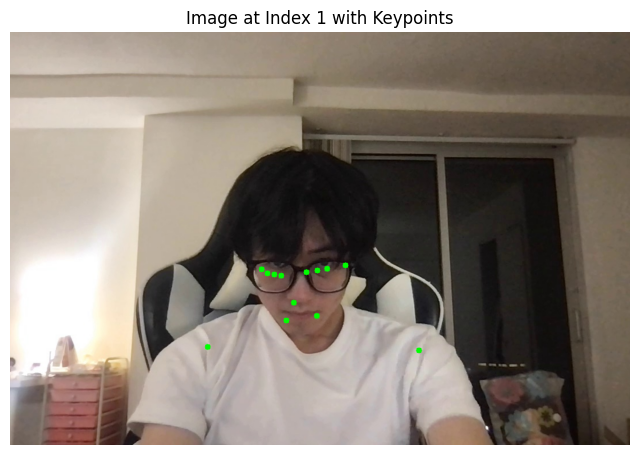

In [84]:
draw_keypoints_on_image(images, results_backwards[-7:], 1)  # Replace '1' with the desired index

In [91]:
# Usage in main code:
save_path = os.path.join(keypoints_path, "backward_keypoints")
save_keypoints(results_backwards, save_path)

Saved 6207 keypoints with shape (6207, 33, 3)


In [140]:
# Testing the function
data_path = "../../AI System Data/Normal posture/frames"
image_files = [f for f in os.listdir(data_path) if os.path.isfile(os.path.join(data_path, f))]
batch_size = 20
counter = 0
results_normal_1 = []

# Initialize the model
initialize_model()
images = [Image.open(os.path.join(data_path, image_file)) for image_file in image_files[0:0 + batch_size]]

# Perform posture detection on the batch
batch_results = postureDetect(images)

# Append batch results to the main results list
results_normal_1.extend(batch_results)

In [92]:
# Testing the function
data_path = "../../AI System Data/Normal posture/frames"
image_files = [f for f in os.listdir(data_path) if os.path.isfile(os.path.join(data_path, f))]
batch_size = 20
counter = 0
results_normal = []

# Initialize the model
initialize_model()

for i in range(len(image_files) // batch_size):
    # Load a batch of images
    images = [Image.open(os.path.join(data_path, image_file)) for image_file in image_files[counter:counter + batch_size]]
    
    # Perform posture detection on the batch
    batch_results = postureDetect(images)
    
    # Append batch results to the main results list
    results_normal.extend(batch_results)

    # Print keypoints results for the current batch
    # for idx, keypoints in enumerate(batch_results):
    #     print(f"Image {counter + idx}: Keypoints - {keypoints}")
    
    counter += batch_size

# Process remaining images
images = [Image.open(os.path.join(data_path, image_file)) for image_file in image_files[counter:]]
if images:
    batch_results = postureDetect(images)
    results_normal.extend(batch_results)

In [143]:
results_normal = np.load('../keypoints/normal_keypoints/keypoints_img_coord.npy')

In [141]:
results_normal_1

[[[0.4810239374637604, 0.4263211488723755, -1.312601089477539],
  [0.5117692351341248, 0.37046289443969727, -1.2127946615219116],
  [0.5311048626899719, 0.3727109134197235, -1.2137553691864014],
  [0.5496996641159058, 0.37548986077308655, -1.213503122329712],
  [0.4634150564670563, 0.3685190975666046, -1.2145049571990967],
  [0.44848179817199707, 0.3686850965023041, -1.2157224416732788],
  [0.43118131160736084, 0.36817634105682373, -1.2165812253952026],
  [0.5663148760795593, 0.41475212574005127, -0.6605740785598755],
  [0.40291810035705566, 0.39914795756340027, -0.6634425520896912],
  [0.5138615369796753, 0.5052450895309448, -1.0954986810684204],
  [0.4570496380329132, 0.49329981207847595, -1.1055279970169067],
  [0.7478675842285156, 0.9216839075088501, -0.3130840063095093],
  [0.23247593641281128, 0.9289233088493347, -0.40526410937309265],
  [nan, nan, nan],
  [nan, nan, nan],
  [nan, nan, nan],
  [nan, nan, nan],
  [nan, nan, nan],
  [nan, nan, nan],
  [nan, nan, nan],
  [nan, nan, 

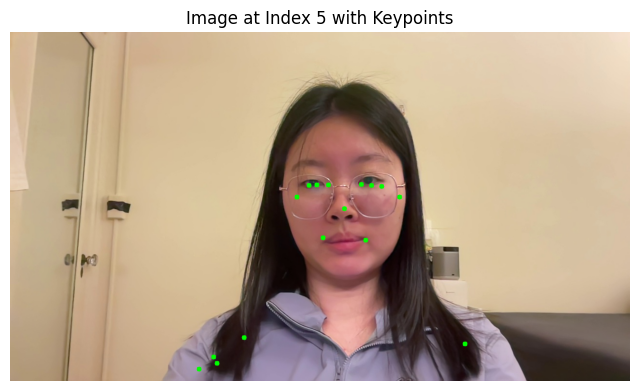

In [92]:
draw_keypoints_on_image(images, results_normal[-6:], 5)  # Replace '1' with the desired index

In [93]:
# keypoints_path = "/Users/idrissunmola/Library/CloudStorage/OneDrive-JohnsHopkins/AI System Data/keypoints/"
# Usage in main code
save_path = os.path.join(keypoints_path, "normal_keypoints")
save_keypoints(results_normal, save_path)

Saved 7426 keypoints with shape (7426, 33, 3)


In [ ]:

# testing
# local storage path
data_path = "../../AI System Data/Backwards/frames/"
# Get all files in the data_path folder
image_files = [f for f in os.listdir(data_path) if os.path.isfile(os.path.join(data_path, f))]

batch_size = 20
counter = 0

for i in tqdm(np.arange(1000)):    
    
    images = [Image.open(os.path.join(data_path, image_files[i]))]

    if i == 0:
        results_backwards = postureDetect(images)

    else:
        results_backwards = np.concatenate((results_backwards, postureDetect(images)), axis = 0)

  # assert len(results) == len(images)

# Print keypoints results
for idx, keypoints in enumerate(results):
    print(f"Image {idx}: Keypoints - {keypoints}")
counter += batch_size

# assert len(results) == len(images)

# Print keypoints results
for idx, keypoints in enumerate(results):
    print(f"Image {idx}: Keypoints - {keypoints}")

In [17]:
np.save('results_forwards.npy',results_forward)

In [ ]:
results_backward = np.load('../../AI System Data/results_backwards.npy')
results_normal = np.load('../../AI System Data/results_normal.npy')

In [ ]:
results_forward = results_forward[:,:7, :]
results_backward =  results_backward[:,:7, :]
results_normal =  results_normal[:,:7, :]

In [67]:
for i in range(len(results_forward)):
    results_forward[i,:,1] = results_forward[i,:, 1] - results_forward[i,0, 1]
    results_forward[i,:,0] = results_forward[i,:, 0] - results_forward[i,0, 0]
    results_backward[i,:,1] = results_backward[i,:, 1] - results_backward[i,0, 1]
    results_backward[i,:,0] = results_backward[i,:, 0] - results_backward[i,0, 0]
    results_normal[i,:,1] = results_normal[i,:, 1] - results_normal[i,0, 1]
    results_normal[i,:,0] = results_normal[i,:, 0] - results_normal[i,0, 0]

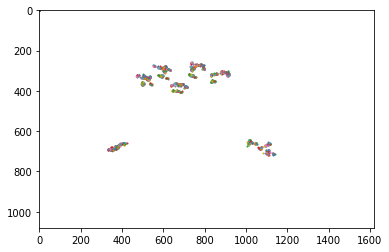

In [40]:
for i in range(1000):
    if int(image_files[i][-8:-4])<1269:
        plt.scatter(results_forward[i, :, 0],results_forward[i, :, 1], s = 1)
plt.xlim(0,1620)
plt.ylim(1080,0)
plt.show()

In [94]:
data_path = "../../AI System Data/Backwards/frames/"
# Get all files in the data_path folder
image_files = [f for f in os.listdir(data_path) if os.path.isfile(os.path.join(data_path, f))]
arr = []
for i in range(1000):
     if int(image_files[i][-8:-4])<1265:
            arr.append(i)

In [95]:
arr

[3,
 6,
 13,
 18,
 24,
 25,
 26,
 33,
 38,
 39,
 40,
 64,
 69,
 77,
 78,
 83,
 90,
 91,
 98,
 102,
 103,
 105,
 113,
 114,
 117,
 122,
 123,
 132,
 137,
 139,
 140,
 147,
 153,
 160,
 163,
 167,
 174,
 175,
 176,
 182,
 217,
 218,
 226,
 228,
 229,
 232,
 239,
 247,
 251,
 254,
 255,
 262,
 268,
 269,
 276,
 277,
 280,
 286,
 287,
 288,
 295,
 297,
 302,
 310,
 315,
 316,
 323,
 324,
 337,
 352,
 353,
 360,
 364,
 365,
 367,
 375,
 376,
 379,
 388,
 396,
 406,
 407,
 408,
 417,
 419,
 426,
 427,
 434,
 438,
 454,
 466,
 468,
 475,
 476,
 482,
 483,
 487,
 493,
 500,
 502,
 504,
 509,
 512,
 513,
 521,
 522,
 523,
 529,
 534,
 544,
 545,
 546,
 559,
 560,
 567,
 569,
 574,
 595,
 600,
 605,
 607,
 616,
 619,
 620,
 630,
 635,
 644,
 646,
 653,
 654,
 655,
 661,
 664,
 666,
 673,
 674,
 676,
 681,
 686,
 692,
 693,
 698,
 700,
 707,
 711,
 730,
 739,
 740,
 749,
 751,
 756,
 759,
 770,
 771,
 775,
 782,
 785,
 791,
 794,
 805,
 806,
 814,
 823,
 824,
 829,
 830,
 838,
 843,
 859,
 865,
 

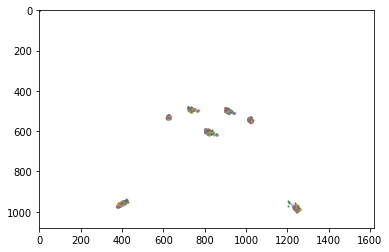

In [44]:
for i in range(1000):
    if 1269<=int(image_files[i][-8:-4])<3029:
        plt.scatter(results_forward[i, :, 0],results_forward[i, :, 1], s = 1)
plt.xlim(0,1620)
plt.ylim(1080, 0)
plt.show()

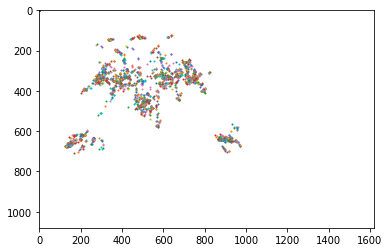

In [42]:
for i in range(1000):
    if 3029<=int(image_files[i][-8:-4])<5007:
        plt.scatter(results_forward[i, :, 0],results_forward[i, :, 1], s = 1)
plt.xlim(0,1620)
plt.ylim(1080, 0)
plt.show()

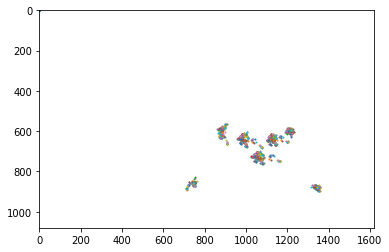

In [45]:
for i in range(1000):
    if int(image_files[i][-8:-4])>=5007:
        plt.scatter(results_forward[i, :, 0],results_forward[i, :, 1], s = 1)
plt.xlim(0,1620)
plt.ylim(1080, 0)
plt.show()

In [ ]:
for i in range(1000):
    if int(image_files[i][-8:-4])<1269:
        plt.scatter(results_forward[i, :, 0],results_forward[i, :, 1], s = 1)
plt.xlim(0,1620)
plt.ylim(1080, 0)
plt.show()

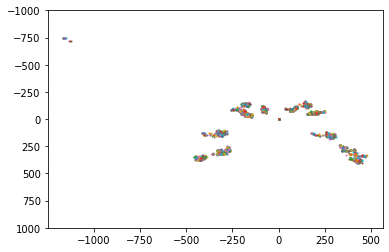

In [86]:
for i in range(1000):
#     if int(image_files[i][-8:-4])<1269:
    if not 3029<=int(image_files[i][-8:-4])<5007:
        plt.scatter(results_forward[i, :, 0],results_forward[i, :, 1], s = 1)
# plt.xlim(0,1620)
plt.ylim(1000, -1000)
plt.show()

In [81]:
results_backward =  results_backward[:,:7, :]
results_normal =  results_normal[:,:7, :]

In [82]:
for i in range(len(results_forward)):
    results_backward[i,:,1] = results_backward[i,:, 1] - results_backward[i,0, 1]
    results_backward[i,:,0] = results_backward[i,:, 0] - results_backward[i,0, 0]
    results_normal[i,:,1] = results_normal[i,:, 1] - results_normal[i,0, 1]
    results_normal[i,:,0] = results_normal[i,:, 0] - results_normal[i,0, 0]

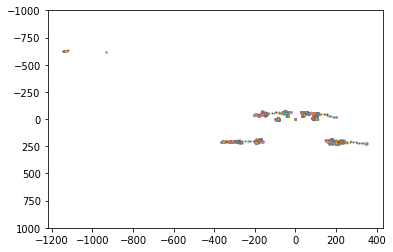

In [83]:
for i in range(1000):
#     if int(image_files[i][-8:-4])<1269:
    plt.scatter(results_backward[i, :, 0],results_backward[i, :, 1], s = 1)
# plt.xlim(0,1620)
plt.ylim(1000, -1000)
plt.show()

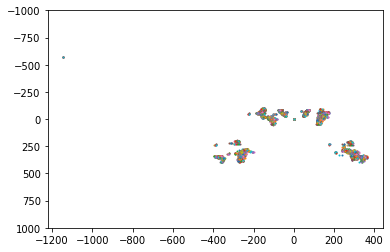

In [84]:
for i in range(1000):
#     if int(image_files[i][-8:-4])<1269:
    plt.scatter(results_normal[i, :, 0],results_normal[i, :, 1], s = 1)
# plt.xlim(0,1620)
plt.ylim(1000, -1000)
plt.show()

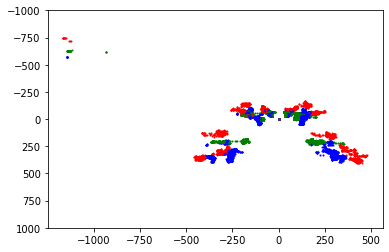

In [87]:
for i in range(1000):
#     if int(image_files[i][-8:-4])<1269:
    plt.scatter(results_normal[i, :, 0],results_normal[i, :, 1], s = 1, color = 'blue')
    plt.scatter(results_backward[i, :, 0],results_backward[i, :, 1], s = 1, color = 'green')
    if not 3029<=int(image_files[i][-8:-4])<5007:
        plt.scatter(results_forward[i, :, 0],results_forward[i, :, 1], s = 1, color = 'red')
        
# plt.xlim(0,1620)
plt.ylim(1000, -1000)
plt.show()

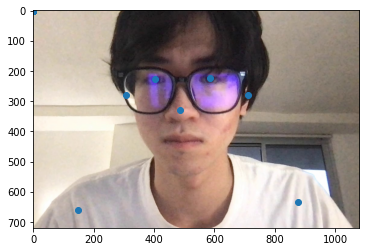

In [32]:
plt.imshow(images[1])
plt.scatter(results[1,:,0], results[1, :, 1])

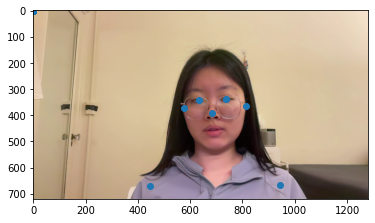

In [20]:
plt.imshow(images[0])
plt.scatter(results[0,:,0], results[0, :, 1])

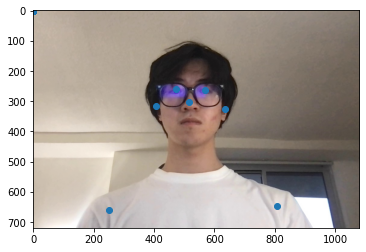

In [21]:
plt.imshow(images[1])
plt.scatter(results[1,:,0], results[1, :, 1])

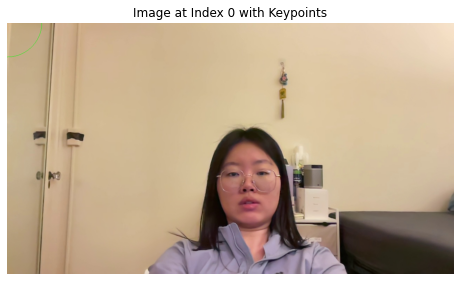

In [126]:
import matplotlib.pyplot as plt
import cv2
import numpy as np

def draw_keypoints_on_image(images, keypoints_list, index):
    """
    Draws predicted keypoints on the image at the specified index.

    Args:
    - images (list): List of PIL Image objects.
    - keypoints_list (list): List of keypoints for each image. Each element is a list of [x, y, z] keypoints.
    - index (int): Index of the image to draw keypoints on.

    Returns:
    None
    """
    if index < 0 or index >= len(images):
        print("Index out of range. Please provide a valid index.")
        return

    image = np.array(images[index])  # Convert PIL Image to numpy array
    keypoints = keypoints_list[index]

    image_bgr = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)

    for keypoint in keypoints:
        x, y, z = keypoint
        if not np.isnan(x):
            if x != 0 and y != 0:  # Skip if keypoint is [0, 0, 0]
                cv2.circle(image_bgr, (int(x)*image.shape[0], int(y)*image.shape[1]), radius=5, color=(0, 255, 0))

    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

    plt.figure(figsize=(8, 8))
    plt.imshow(image_rgb)
    plt.axis("off")
    plt.title(f"Image at Index {index} with Keypoints")
    plt.show()
image_path = '../../AI System Data/Backwards/frames/frame_00018.jpg'  # Example using the first image from normal posture
images = [Image.open(image_path)]
draw_keypoints_on_image(images, test, 0)  # Replace '5' with the desired index


In [121]:
test = np.array([[[0.5417767763137817, 0.6495572328567505, -0.37978923320770264], [0.5579082369804382, 0.6103389263153076, -0.3343847990036011], [0.5699975490570068, 0.6098371744155884, -0.3346273899078369], [0.5814318656921387, 0.6123526692390442, -0.3344891667366028], [0.5220439434051514, 0.6139732003211975, -0.33176150918006897], [0.5098857283592224, 0.6155508160591125, -0.3320748507976532], [0.49869561195373535, 0.6192394495010376, -0.332326740026474], [0.6029415726661682, 0.6465146541595459, -0.13384835422039032], [0.48033618927001953, 0.6507847905158997, -0.12257558107376099], [0.567570686340332, 0.7185506820678711, -0.3066278100013733], [0.5137836337089539, 0.7239771485328674, -0.30566322803497314], [0.6650015115737915, 0.9262430667877197, -0.07647768408060074], [0.4184072017669678, 0.9364722967147827, -0.057871829718351364], [np.nan, np.nan, np.nan], [np.nan, np.nan, np.nan], [np.nan, np.nan, np.nan], [np.nan, np.nan, np.nan], [np.nan, np.nan, np.nan], [np.nan, np.nan, np.nan], [np.nan, np.nan, np.nan], [np.nan, np.nan, np.nan], [np.nan, np.nan, np.nan], [np.nan, np.nan, np.nan], [np.nan, np.nan, np.nan], [np.nan, np.nan, np.nan], [np.nan, np.nan, np.nan], [np.nan, np.nan, np.nan], [np.nan, np.nan, np.nan], [np.nan, np.nan, np.nan], [np.nan, np.nan, np.nan], [np.nan, np.nan, np.nan], [np.nan, np.nan, np.nan], [np.nan, np.nan, np.nan]]])



In [104]:
images[0].size

(1280, 720)

In [123]:
test.shape

(1, 33, 3)

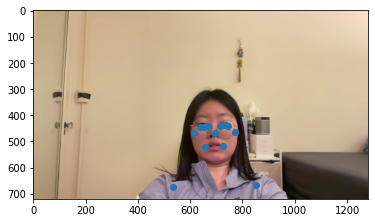

In [130]:
plt.scatter(test[0,:,0]*images[0].size[0], test[0,:,1]*images[0].size[1])
plt.imshow(images[0])